### Introduction

#### Motivation
Our aim here is to try to understand the data, gain insights from it and through the analysis try to analyse the obesity trends that are prevalent in Mexico, Peru and Columbia

#### Methods
- Data Cleaning
- High Level Statistics
    - Correlation
    - Data Distribution
- Univariate Analysis
    - Maximum, Minimum and Mean Analysis
    - Variance Analysis
    - Standard Deviation Analysis
    - Histogram Visualizations
    - Box Plot Visualizations
- Bivariate Analysis
    - Linear Regression
    - ANOVA
- Multivariate Analysis
    - K-Means Clustering
    - Multiple Linear Regression

### The Dataset

#### Description
The dataset describes obesity levels as seen in Mexico, Peru, Columbia

#### Data Overview
- **File(s)**: ObesityDataSet_raw_and_data_sinthetic.csv
- **Table(s)**: ObesityDataSet_raw_and_data_sin
- **Variables in the table**: Gender, Age, Height, Weight, family_history_with_overweight, FAVC, FCVC, NCP, CAEC, SMOKE, CH2O, SCC, FAF, TUE, CALC, MTRANS, NObeyesdad

#### Attribute Overview
- **Gender**: What is the gender of the person
- **Age**: What is the age of the person
- **Height**: What is the height of the person
- **Weight**: What is the weight of the person
- **family_history_with_overweight**: Was anyone else in the person's family overweight
- **FAVC**: Does the person frequently eat high calorific food
- **FCVC**: Frequency of consumption of vegetables
- **NCP**: Number of main meals
- **CAEC**: How often does the person eat food between meals
- **SMOKE**: Does the person smoke or not
- **CH2O**: Daily water consumption
- **SCC**: Was the person monitoring how many calories they consumed
- **FAF**: Physical activity frequency
- **TUE**: Time spent with technological devices
- **CALC**: How often does the person consume alcohol
- **MTRANS**: Mode of transportation used
- **NObeyesdad**: What is the person's weight type/ classification

### Importing Python libraries and Loading the dataset

In [2]:
from mpl_toolkits import mplot3d
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from statsmodels.formula.api import ols

import collections
import math
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import statsmodels.api as sm

df = pd.read_csv("ObesityDataSet_raw_and_data_sinthetic.csv")

### Structure Based Data Exploration

#### Purpose of EDA
- Finding missing and erroneous data
- Gain deep and insights from the dataset
- Identify the important features in your dataset
- Perform hypothesis testing for the specific model
- Estimate the parameters and associated intervals

#### EDA Tools
- Classification and dimensionality reduction techniques
- Univariate analysis
- Bivariate analysis
- Multivariate analysis
- Predictive analysis

#### Displaying the first 5 observations

In [3]:
df.head()

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
0,Female,21.0,1.62,64.0,yes,no,2.0,3.0,Sometimes,no,2.0,no,0.0,1.0,no,Public_Transportation,Normal_Weight
1,Female,21.0,1.52,56.0,yes,no,3.0,3.0,Sometimes,yes,3.0,yes,3.0,0.0,Sometimes,Public_Transportation,Normal_Weight
2,Male,23.0,1.80,77.0,yes,no,2.0,3.0,Sometimes,no,2.0,no,2.0,1.0,Frequently,Public_Transportation,Normal_Weight
3,Male,27.0,1.80,87.0,no,no,3.0,3.0,Sometimes,no,2.0,no,2.0,0.0,Frequently,Walking,Overweight_Level_I
4,Male,22.0,1.78,89.8,no,no,2.0,1.0,Sometimes,no,2.0,no,0.0,0.0,Sometimes,Public_Transportation,Overweight_Level_II


#### Displaying the last 5 observations

In [4]:
df.tail()

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
2106,Female,20.976842,1.710730,131.408528,yes,yes,3.0,3.0,Sometimes,no,1.728139,no,1.676269,0.906247,Sometimes,Public_Transportation,Obesity_Type_III
2107,Female,21.982942,1.748584,133.742943,yes,yes,3.0,3.0,Sometimes,no,2.005130,no,1.341390,0.599270,Sometimes,Public_Transportation,Obesity_Type_III
2108,Female,22.524036,1.752206,133.689352,yes,yes,3.0,3.0,Sometimes,no,2.054193,no,1.414209,0.646288,Sometimes,Public_Transportation,Obesity_Type_III
2109,Female,24.361936,1.739450,133.346641,yes,yes,3.0,3.0,Sometimes,no,2.852339,no,1.139107,0.586035,Sometimes,Public_Transportation,Obesity_Type_III
2110,Female,23.664709,1.738836,133.472641,yes,yes,3.0,3.0,Sometimes,no,2.863513,no,1.026452,0.714137,Sometimes,Public_Transportation,Obesity_Type_III


#### Displaying the number of observations(rows) and variables(columns)

In [5]:
df.shape

(2111, 17)

#### Displaying the variable names and data types

In [6]:
df.dtypes

Gender                             object
Age                               float64
Height                            float64
Weight                            float64
family_history_with_overweight     object
FAVC                               object
FCVC                              float64
NCP                               float64
CAEC                               object
SMOKE                              object
CH2O                              float64
SCC                                object
FAF                               float64
TUE                               float64
CALC                               object
MTRANS                             object
NObeyesdad                         object
dtype: object

#### Descriptive statistics

Descriptive statistics summarizes a given data set, which can be either a representation of the entire population or a sample of the population. Descriptive statistics can be broken down into measures of central tendency and measures of variability/ spread. Measures of central tendency include mean, median and mode whereas measures of variability include standard deviation, variance, minimum and maximum variables, kurtosis and skewness

- **count**: Count of non-empty values
- **mean**: The mean(average) value
- **std**: Standard deviation
- **min**: Minimum value
- **25%**: The 25% percentile value
- **50%**: The 50% percentile value
- **75%**: The 75% percentile value
- **max**: Maximum value

In [7]:
df.describe()

,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE
count,2111.000000,2111.000000,2111.000000,2111.000000,2111.000000,2111.000000,2111.000000,2111.000000
mean,24.312600,1.701677,86.586058,2.419043,2.685628,2.008011,1.010298,0.657866
std,6.345968,0.093305,26.191172,0.533927,0.778039,0.612953,0.850592,0.608927
min,14.000000,1.450000,39.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,19.947192,1.630000,65.473343,2.000000,2.658738,1.584812,0.124505,0.000000
50%,22.777890,1.700499,83.000000,2.385502,3.000000,2.000000,1.000000,0.625350
75%,26.000000,1.768464,107.430682,3.000000,3.000000,2.477420,1.666678,1.000000
max,61.000000,1.980000,173.000000,3.000000,4.000000,3.000000,3.000000,2.000000


#### Summarizing the dataframe

A short summary of the dataframe which consists of information such as RangeIndex, Data columns, dtypes and memory usage

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2111 entries, 0 to 2110
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Gender                          2111 non-null   object 
 1   Age                             2111 non-null   float64
 2   Height                          2111 non-null   float64
 3   Weight                          2111 non-null   float64
 4   family_history_with_overweight  2111 non-null   object 
 5   FAVC                            2111 non-null   object 
 6   FCVC                            2111 non-null   float64
 7   NCP                             2111 non-null   float64
 8   CAEC                            2111 non-null   object 
 9   SMOKE                           2111 non-null   object 
 10  CH2O                            2111 non-null   float64
 11  SCC                             2111 non-null   object 
 12  FAF                             21

#### Data Cleaning

Data cleaning is the process of fixing or removing incorrect, corrupted, incorrectly formatted, duplicate or incomplete data within a dataset. If data is incorrect, outcomes and algorithms become unreliable, even though they may be implemented correctly because of this it becomes crucial to perform data cleaning

The most common data cleaning practices include:

<ul style="list-style-type:square">
    <li>Removing duplicate or irrelevant observations</li>
    <li>Fixing structural errors such as strange naming conventions, typos or incorrect capitalization</li>
    <li>Filtering unwanted outliers (if needed)</li>
    <li>Handling missing data</li>
</ul>

- Count of non-missing values for each variable

In [9]:
df.count()

Gender                            2111
Age                               2111
Height                            2111
Weight                            2111
family_history_with_overweight    2111
FAVC                              2111
FCVC                              2111
NCP                               2111
CAEC                              2111
SMOKE                             2111
CH2O                              2111
SCC                               2111
FAF                               2111
TUE                               2111
CALC                              2111
MTRANS                            2111
NObeyesdad                        2111
dtype: int64

- Detecting Missing Values 

In [10]:
df.isnull().sum()

Gender                            0
Age                               0
Height                            0
Weight                            0
family_history_with_overweight    0
FAVC                              0
FCVC                              0
NCP                               0
CAEC                              0
SMOKE                             0
CH2O                              0
SCC                               0
FAF                               0
TUE                               0
CALC                              0
MTRANS                            0
NObeyesdad                        0
dtype: int64

- Detecting redundant data

In [11]:
df.duplicated().sum()

24

- Removing redundant data

In [12]:
df.drop_duplicates()

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
0,Female,21.000000,1.620000,64.000000,yes,no,2.0,3.0,Sometimes,no,2.000000,no,0.000000,1.000000,no,Public_Transportation,Normal_Weight
1,Female,21.000000,1.520000,56.000000,yes,no,3.0,3.0,Sometimes,yes,3.000000,yes,3.000000,0.000000,Sometimes,Public_Transportation,Normal_Weight
2,Male,23.000000,1.800000,77.000000,yes,no,2.0,3.0,Sometimes,no,2.000000,no,2.000000,1.000000,Frequently,Public_Transportation,Normal_Weight
3,Male,27.000000,1.800000,87.000000,no,no,3.0,3.0,Sometimes,no,2.000000,no,2.000000,0.000000,Frequently,Walking,Overweight_Level_I
4,Male,22.000000,1.780000,89.800000,no,no,2.0,1.0,Sometimes,no,2.000000,no,0.000000,0.000000,Sometimes,Public_Transportation,Overweight_Level_II
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2106,Female,20.976842,1.710730,131.408528,yes,yes,3.0,3.0,Sometimes,no,1.728139,no,1.676269,0.906247,Sometimes,Public_Transportation,Obesity_Type_III
2107,Female,21.982942,1.748584,133.742943,yes,yes,3.0,3.0,Sometimes,no,2.005130,no,1.341390,0.599270,Sometimes,Public_Transportation,Obesity_Type_III
2108,Female,22.524036,1.752206,133.689352,yes,yes,3.0,3.0,Sometimes,no,2.054193,no,1.414209,0.646288,Sometimes,Public_Transportation,Obesity_Type_III
2109,Female,24.361936,1.739450,133.346641,yes,yes,3.0,3.0,Sometimes,no,2.852339,no,1.139107,0.586035,Sometimes,Public_Transportation,Obesity_Type_III


#### High Level Statistics

High level statistics describes those operations that are more abstract in nature, wherein the overall goals and systemic features are typically more concerned with the wider, macro system as a whole

- Correlation Matrix

A correlation matrix is a table which shows the correlation coefficients between continuous variables. Each cell in the table shows the correlation between the two concerned variables. A correlation matrix is used to summarize data, as an input into a more advanced analysis and as a diagnostic for advanced analysis

A correlation coefficient of zero indicates that no linear relationship exists between the two variables. A correlation coefficient of −1 or +1 indicates a perfect linear relationship. The stronger the correlation, the closer the correlation coefficient is to ±1. If the coefficient is a positive number, the variables are directly related (i.e. as the value of one variable goes up the value of the other also tends to go up). But if the coefficient is a negative number, the variables are inversely related (i.e. as the value of one variable goes up the value of the other tends to go down)

<AxesSubplot: >

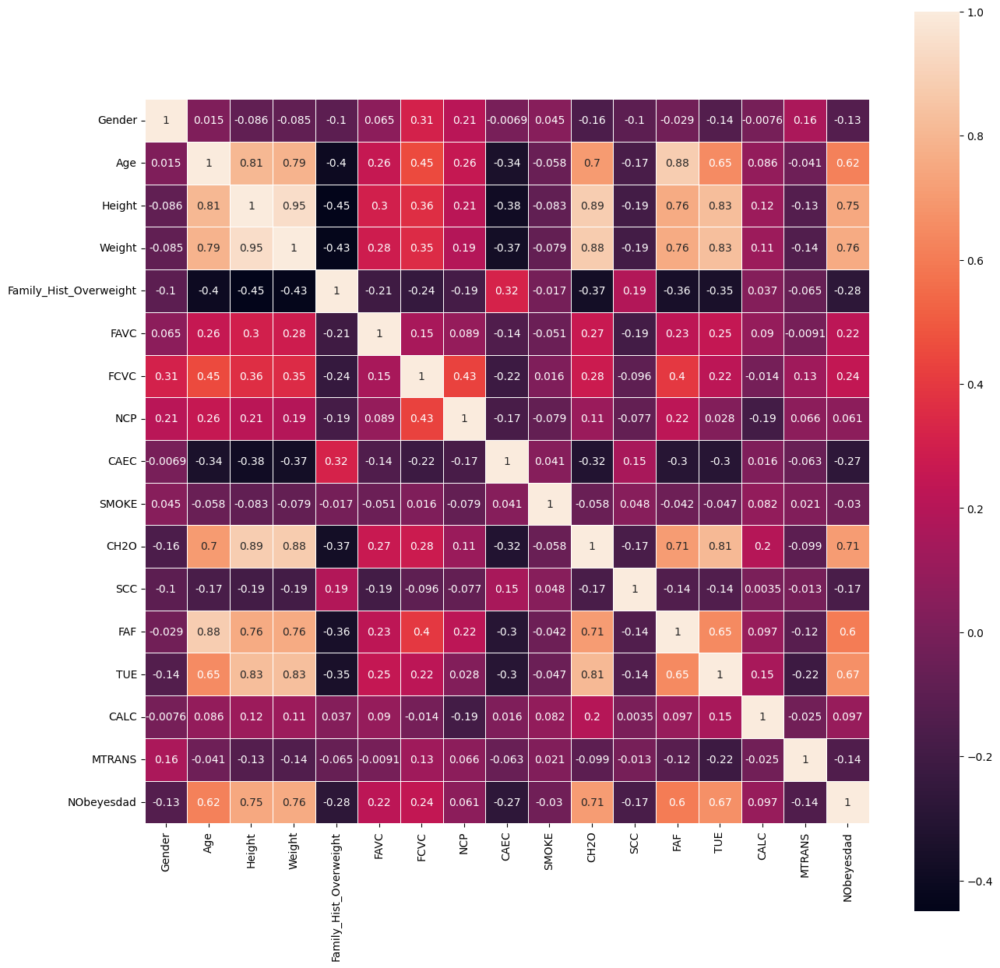

In [13]:
# Obtaining a numeric representation for distinct non-numeric values
df2 = df.apply(lambda x: x.factorize()[0])

# Computing pairwise correlation of columns by using Pearson method
corr = df2.corr()
title = list(df.columns)
title[4] = 'Family_Hist_Overweight'

fig, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(corr, annot=True, square=True, linewidth=0.5, xticklabels=title, yticklabels=title, ax=ax)

Since our analysis focuses on obesity the main pairs that we want to keep an eye out for are the ones which involve weight

<ul style="list-style-type:square">
    <li>Height and Weight have the strongest correlation that of 0.95</li>
    <li>The second highest correlation of 0.88 exists between the pair of Weight and CH2O</li>
    <li>The third highest correlation of 0.79 exists between the pair of Weight and Age</li>
</ul>

Apart from Weight significant correlation can be seen between:

<ul style="list-style-type:square">
    <li>Height and CH2O: 0.89</li>
    <li>Age and FAF: 0.88</li>
    <li>Height and TUE: 0.83</li>
    <li>CH2O and TUE: 0.81</li>
</ul>

- Distributions

Statistical distribution or probability distribution, describes how values are distributed for an attribute. In other words, statistical distribution shows which values are common and uncommon

In [14]:
for col in df.columns:
    data = collections.Counter(df[col])
    print('\nDistributions: ' + str(col))
    print(data)


Distributions: Gender
Counter({'Male': 1068, 'Female': 1043})

Distributions: Age
Counter({18.0: 128, 26.0: 101, 21.0: 96, 23.0: 89, 19.0: 59, 20.0: 48, 22.0: 39, 17.0: 30, 24.0: 18, 25.0: 16, 27.0: 14, 33.0: 13, 29.0: 11, 16.0: 9, 30.0: 8, 41.0: 7, 38.0: 7, 40.0: 6, 34.0: 5, 31.0: 4, 39.0: 3, 36.0: 3, 32.0: 3, 35.0: 3, 45.0: 3, 37.0: 3, 55.0: 2, 21.962426: 2, 21.81119: 2, 16.30687: 2, 25.902283: 2, 25.540865: 2, 25.930376: 2, 25.653233: 2, 25.783865: 2, 52.0: 1, 15.0: 1, 61.0: 1, 44.0: 1, 51.0: 1, 56.0: 1, 28.0: 1, 14.0: 1, 25.196214: 1, 18.503343: 1, 21.853826: 1, 21.90012: 1, 18.306615: 1, 21.849705: 1, 19.799054: 1, 17.188754: 1, 22.285024: 1, 21.02497: 1, 22.038327: 1, 21.243142: 1, 22.142432: 1, 21.491055: 1, 22.717943: 1, 23.501249: 1, 18.535075: 1, 20.254534: 1, 20.225396: 1, 19.86997: 1, 20.147114: 1, 21.996523: 1, 21.376426: 1, 19.724106: 1, 22.851834: 1, 18.216032: 1, 18.164768: 1, 18.871794: 1, 18.766033: 1, 18.540535: 1, 19.88036: 1, 19.717249: 1, 19.633898: 1, 20.406871:

#### Univariate Analysis

‘Uni’ refers to one and ‘variate’ means variable thus, univariate analysis refers to the analysis which involves a single variable. This type of analysis includes summarization, measurements of dispersion and central tendencies

- Maximum, Minimum and Mean(Average) Analysis

Minimum shows you the least, Maximum shows you the highest and Mean which is also known as average shows the sum of all the values, divided by the total number of values in the column. Apart from this Maximum, Minimum and Mean Analysis also helps in identifying how the data is distributed

In [15]:
df.describe().loc[['min', 'max', 'mean']]

,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE
min,14.0000,1.450000,39.000000,1.000000,1.000000,1.000000,0.000000,0.000000
max,61.0000,1.980000,173.000000,3.000000,4.000000,3.000000,3.000000,2.000000
mean,24.3126,1.701677,86.586058,2.419043,2.685628,2.008011,1.010298,0.657866


A conclusion that can be drawn from the table above is that the Age of the people is distributed within the range of 14 - 61 which means that the data covers teenagers and elderly alike with a mean value of 24.3126

- Variance Analysis

Variance is the expected value of the squared variation of a random variable from its mean. In other words, variance estimates how far the data points are spread out from their mean

In [16]:
df.var(numeric_only=True)

Age        40.271313
Height      0.008706
Weight    685.977477
FCVC        0.285078
NCP         0.605344
CH2O        0.375712
FAF         0.723507
TUE         0.370792
dtype: float64

- Standard Deviation Analysis

Standard deviation (or σ) is a measure of how dispersed the data is in relation to the mean. A standard deviation close to zero indicates that data points are close to the mean, whereas a high or low standard deviation indicates data points are respectively above or below the mean

In [17]:
df.std(numeric_only=True)

Age        6.345968
Height     0.093305
Weight    26.191172
FCVC       0.533927
NCP        0.778039
CH2O       0.612953
FAF        0.850592
TUE        0.608927
dtype: float64

From the analysis of Variance and Standard Deviation it can be concluded that:

<ul style="list-style-type:square">
    <li>The data points of Age and Weight are quite spread out, away from the mean and from one another becuase these two attributes have the highest variance and standard deviation</li>
    <li>The other attributes however are not so spread out and are more closer to the mean becuase of a low variance and standard deviation</li>
</ul>

- Histograms

A histogram is a graphical representation of data points organized into user-specified ranges. Similar in appearance to a bar graph, the histogram condenses a data series into an easily interpreted visual by taking many data points and grouping them into logical ranges or bins

A histogram can be used whenever there is a need to display a comparison of the distribution of certain numerical data in various range of intervals. Histograms can help the audience understand essential meanings and patterns related to a large amount of data

Histograms can be classified as:

<ul style="list-style-type:square">
    <li><b>Uniformly Distributed</b>: A uniform distribution reveals that the number of classes is too small and that each class has the same number of elements. It may involve a distribution that has several peaks</li>
    <li><b>Positively Skewed (Right-skewed)</b>: A positively skewed histogram has a right-skewed distribution. In a right-skewed distribution, most of the data points occur on the left side as compared to the right</li>
    <li><b>Negatively Skewed (Left-skewed)</b>: A negatively skewed histogram has a left-skewed distribution. In a left-skewed distribution, most of the data points occur on the right side as compared to the left</li>
    <li><b>Symmetric (Bell-shaped)</b>: A symmetric histogram has a bell-shaped distribution. When you draw the vertical line down the center of the histogram and the two sides are identical in size and shape, the histogram is said to be symmetric</li>
    <li><b>Randomly Distributed</b>: A random distribution lacks an apparent pattern and has several peaks. The case may be that different data properties were combined. Therefore, the data should be analyzed separately</li>
</ul>

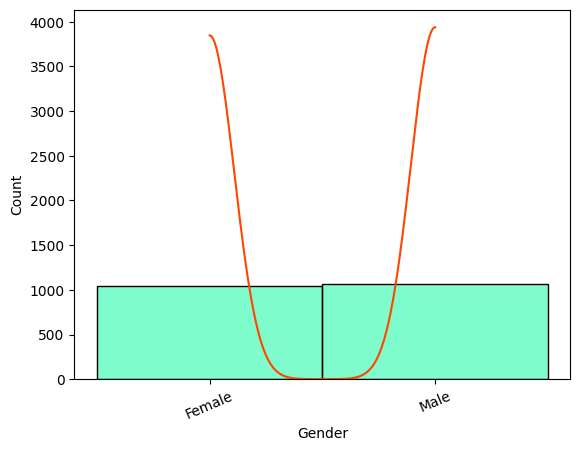

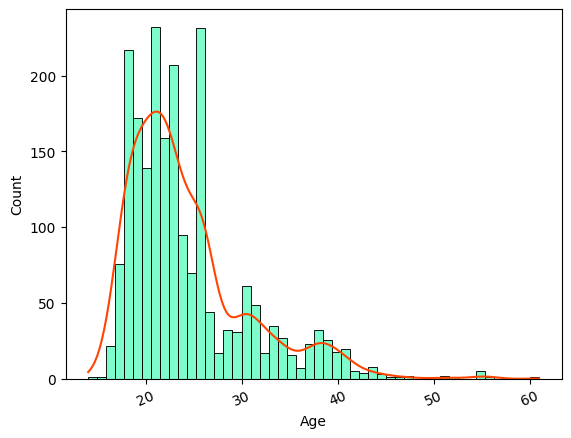

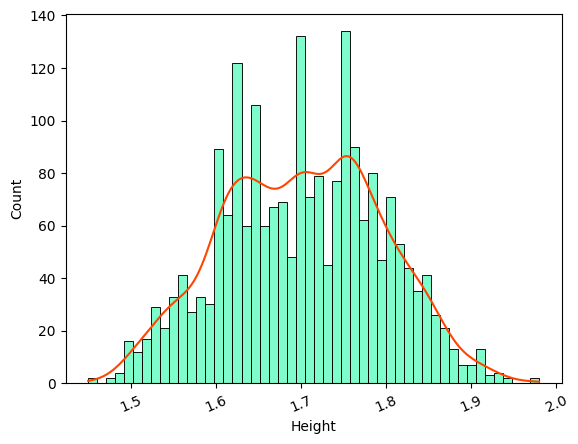

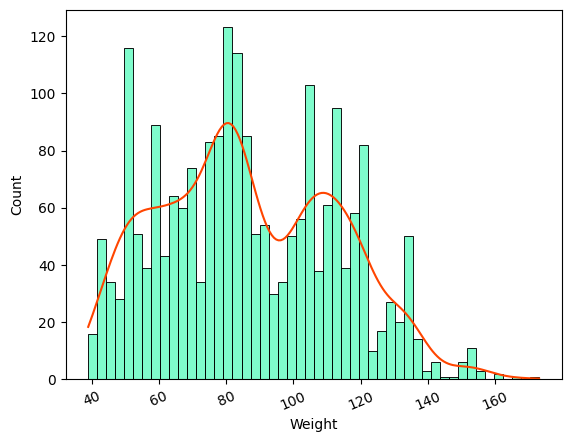

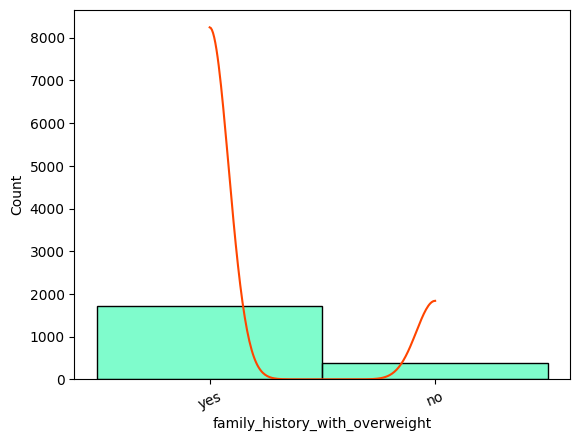

...

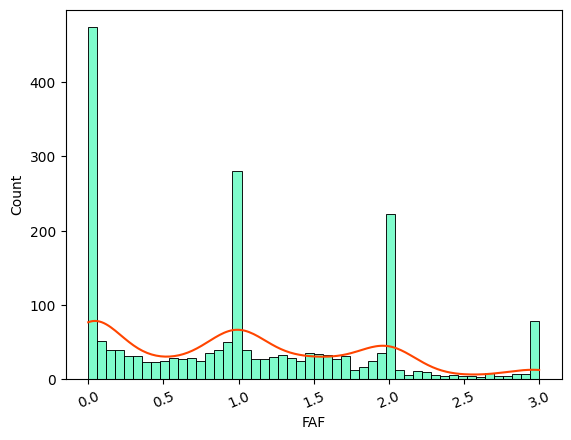

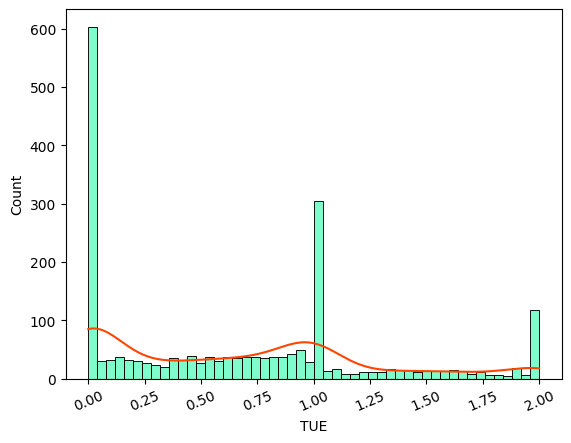

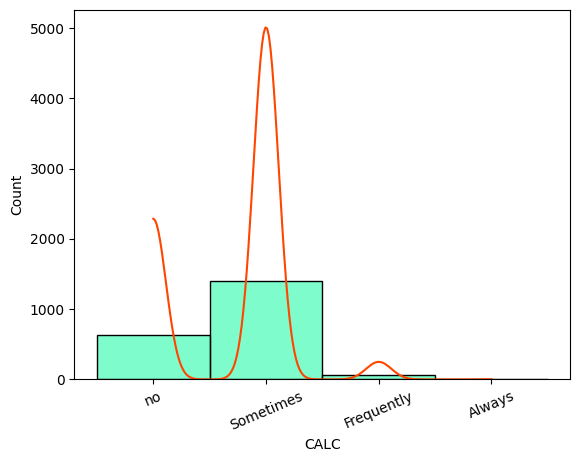

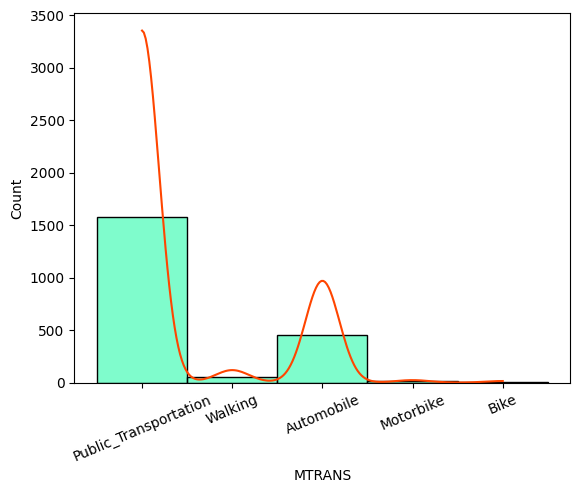

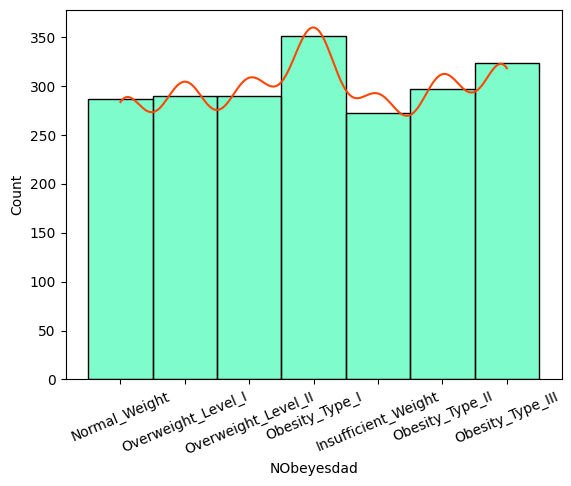

In [32]:
for col in df.columns:
    ax = sns.histplot(data=df, x=col, kde=True, bins=50, color="mediumspringgreen")
    ax.lines[0].set_color('orangered')
    plt.xticks(rotation=23)
    plt.show()

The histograms above can be classified as:

<ul style="list-style-type:square">
    <li><b>Uniformly Distributed</b>: Gender, NObeyesdad</li>
    <li><b>Positively Skewed (Right-skewed)</b>: Age, family_history_with_overweight, CAEC, SMOKE, SCC, FAF, TUE, CALC, MTRANS</li>
    <li><b>Negatively Skewed (Left-skewed)</b>: FAVC</li>
    <li><b>Symmetric (Bell-shaped)</b>: Height, CH2O</li>
    <li><b>Randomly Distributed</b>: Weight, FCVC, NCP</li>
</ul>

Kernel Density Estimation which is a mathematical process of finding an estimate probability density function of a random variable has also been implemented and showcased in the histograms above. The estimation attempts to infer characteristics of a population, based on a finite set of data. The data smoothing problem is a powerful way to estimate probability density. In short, the technique allows one to create a smooth curve against a set of random values

The histograms of Weight, FCVC and NCP are Randomly Distributed so they need to analysed by considering the various categorical variables available to us so that we can draw proper conclusions from the data

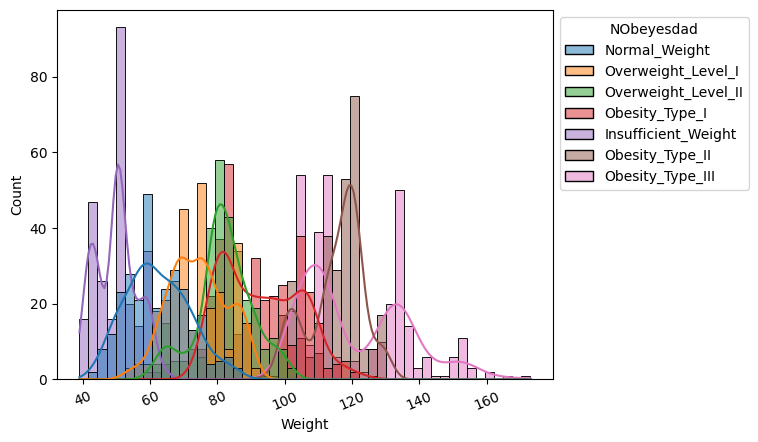

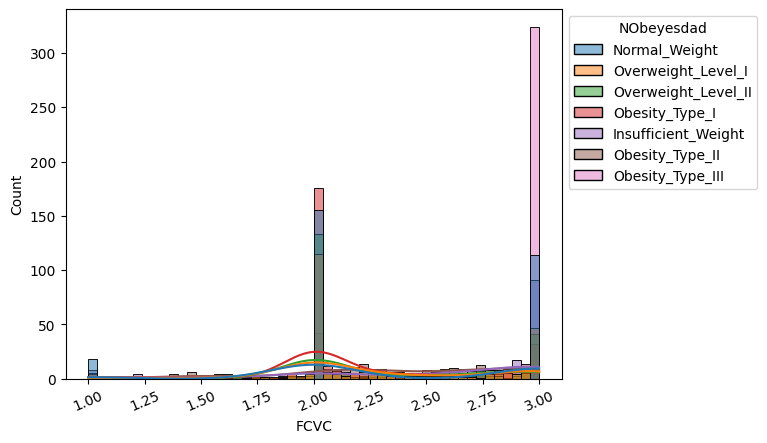

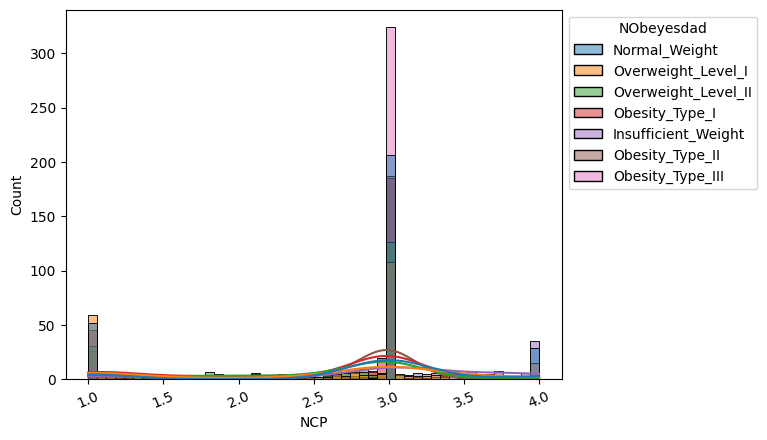

In [33]:
for col in ['Weight', 'FCVC', 'NCP']:
    ax = sns.histplot(data=df, x=col, kde=True, bins=50, hue='NObeyesdad')
    sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
    plt.xticks(rotation=23)
    plt.show()

After considering the various categorical variables available to us the best results are obtained by the categorization of NObeyesdad which allows the histograms of Weight and FCVC to be properly classified. The other categorical variables Gender, FAVC, CAEC etc. were unable to provide any fruitful results for the same

The histograms above can thus be classified as:

<ul style="list-style-type:square">
    <li><b>Positively Skewed (Right-skewed)</b>: Weight(Every categorization except Obesity_Type_II)</li>
    <li><b>Negatively Skewed (Left-skewed)</b>: Weight(Obesity_Type_II), FCVC(Obesity_Type_III)</li>
    <li><b>Symmetric (Bell-shaped)</b>: FCVC(Every categorization except Obesity_Type_III)</li>
    <li><b>Randomly Distributed</b>: NCP</li>
</ul>

Sadly the histogram of NCP is still classified as Randomly Distributed despite being tested aginst all the categorical variables that are available to us

- Box Plots

Box plots visualize the data in a standardized way using 5 summaries – Minimum, First Quartile (Q1), Median, Third Quartile (Q3) and Maximum. Box plot is also termed as box and whisker plot

<ul style="list-style-type:square">
    <li><b>Minimum</b>: The minimum value from the data</li>
    <li><b>First Quartile (Q1)</b>: The first quartile is the median of the lower half of the data. Also known as lower quartile</li>
    <li><b>Median</b>: The median is the middle value of the data, which divides the data into two equal parts. The median is considered as the second quartile</li>
    <li><b>Third Quartile (Q3)</b>: The third quartile is the median of the upper half of the data. Also known as upper quartile</li>
    <li><b>Maximum</b>: The maximum value from the data</li>
</ul>

Box Plots can be classified as:

<ul style="list-style-type:square">
    <li><b>Positively Skewed</b>: If the distance from the median to the maximum is greater than the distance from the median to the minimum, then the box plot is positively skewed</li>
    <li><b>Negatively Skewed</b>: If the distance from the median to minimum is greater than the distance from the median to the maximum, then the box plot is negatively skewed</li>
    <li><b>Symmetric</b>: The box plot is said to be symmetric if the median is equidistant from the maximum and minimum values</li>
</ul>

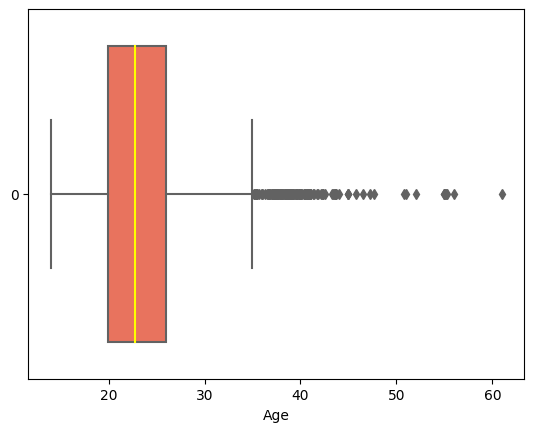

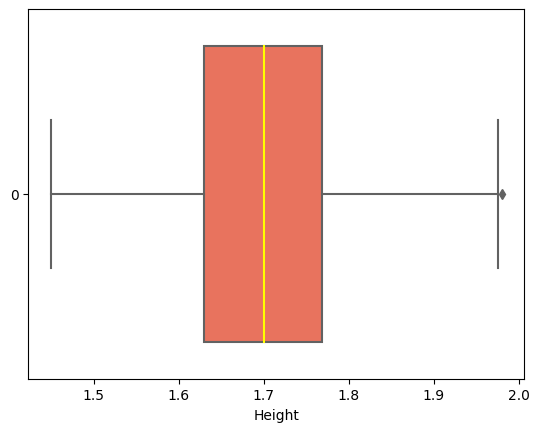

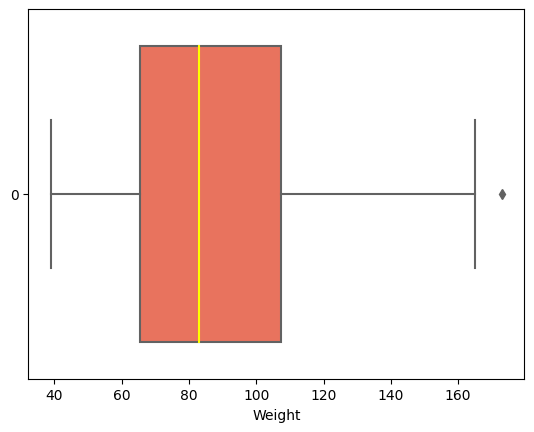

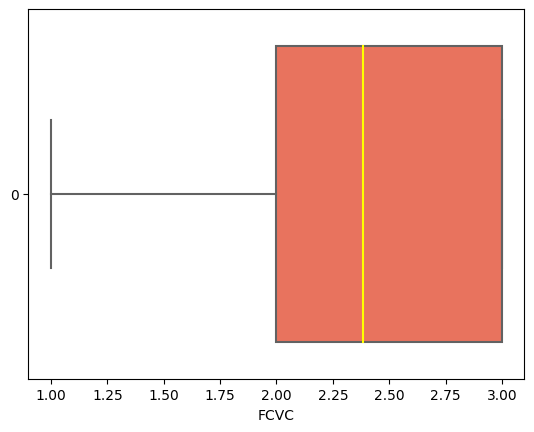

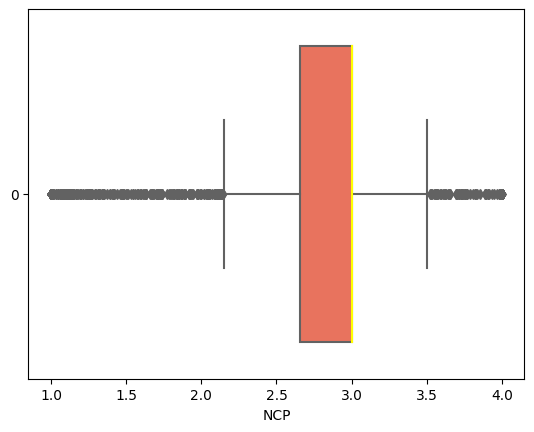

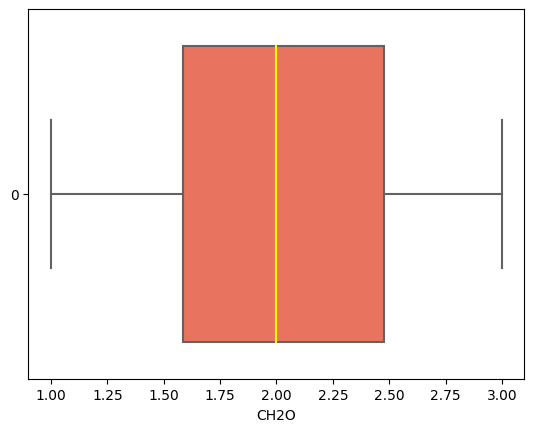

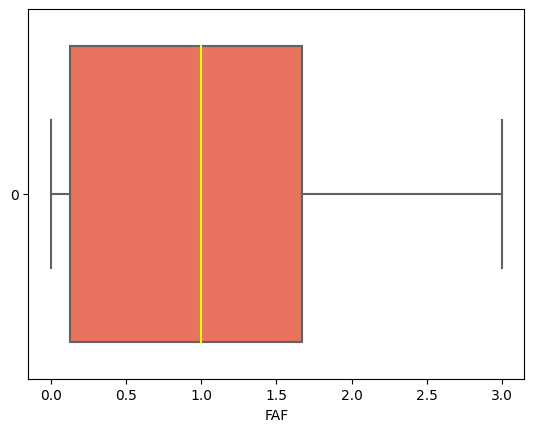

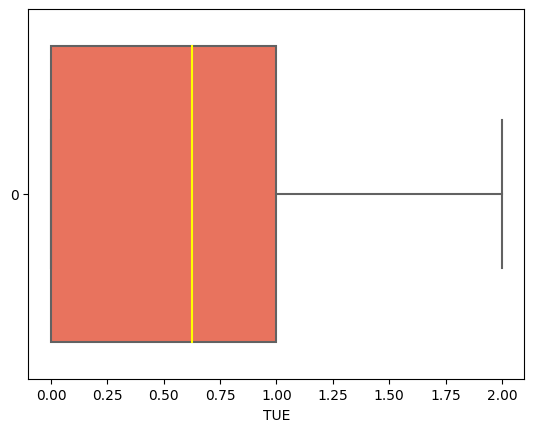

In [18]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.boxplot(data=df[col], color="tomato", orient='h', medianprops={"color": "yellow"})
    plt.xlabel(col)
    plt.show()

From the box plots above we can conclude that:

<ul style="list-style-type:square">
    <li>The plots of Age and NCP have many outliers that could not be mapped in the Quartile range</li>
    <li>For the plot of TUE the minimum value is equal to the lower quartile and thus it has a single whisker</li>
    <li>For the plot of FCVC the maximum value is equal to the upper quartile and it also has a single whisker</li>
    <li>For the plot of NCP the median is equal to the upper quartile</li>
    <li>The rest of the plots showcase the same behaviour as shown by Histograms when talking about the nature of how the data is distributed with the only difference here being that the data has been divided into Quartile ranges</li>
</ul>

The box plots above can be classified as:

<ul style="list-style-type:square">
    <li><b>Positively Skewed</b>: Age, Weight, FAF, TUE</li>
    <li><b>Negatively Skewed</b>: FCVC, NCP</li>
    <li><b>Symmetric</b>: Height, CH2O</li>
</ul>

#### Bivariate Analysis

‘Bi’ means two and ‘variate’ means variable thus, bivariate analysis refers to the analysis between two variables. Bivariate analysis helps in studying the relationship between two variables and if the two are related, we can comment on the strength of that relationship.

- Linear Regression (Based on Gender)
    - Weight

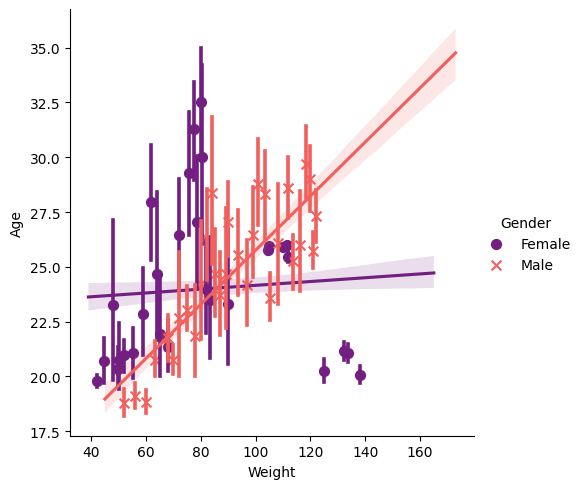

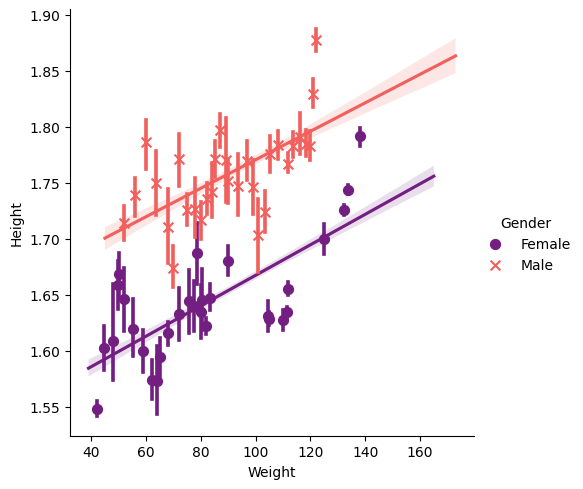

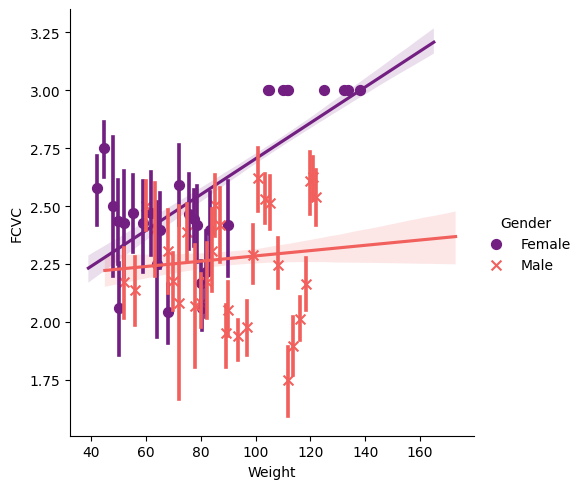

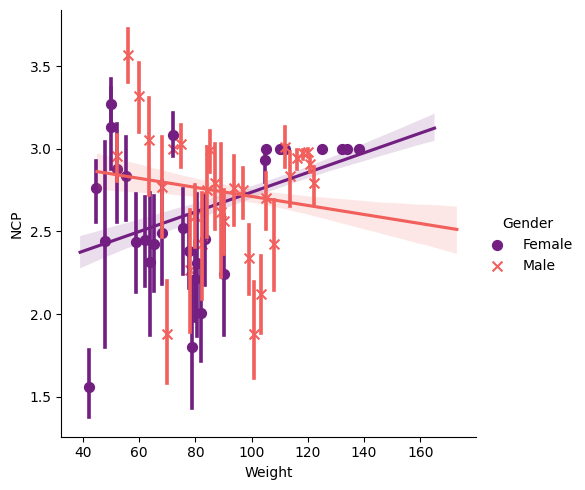

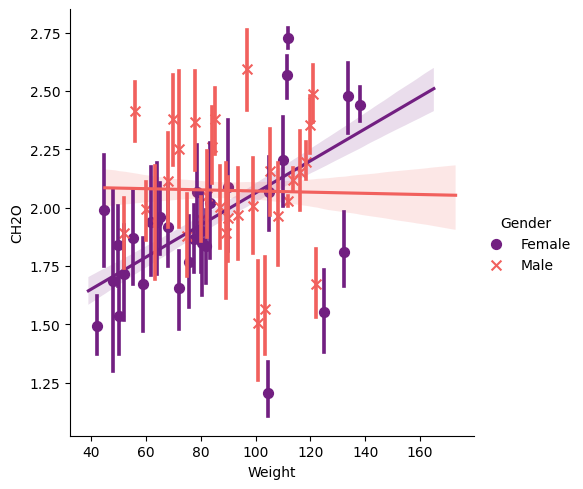

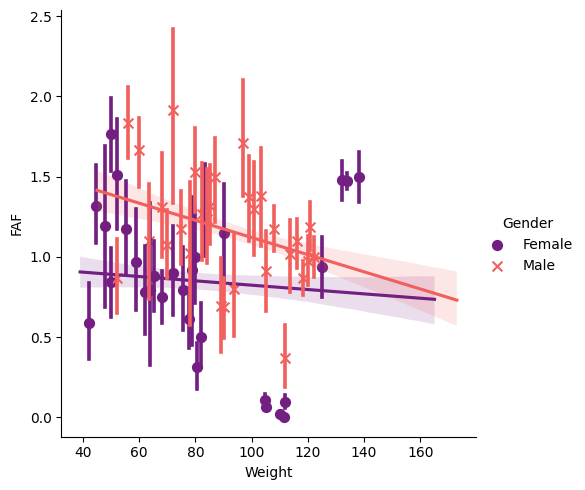

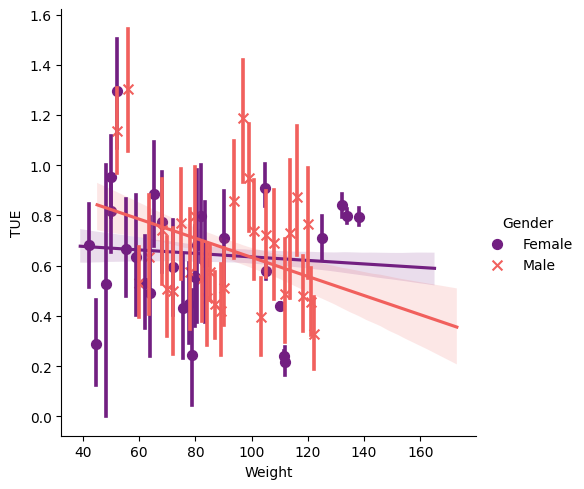

In [77]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="Gender", data=df, x_bins=30, palette="magma", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on Gender)
    - Frequency of Consumption of Vegetables (FCVC)

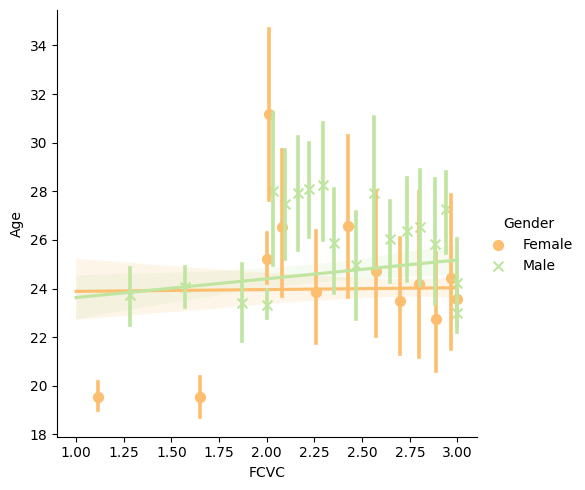

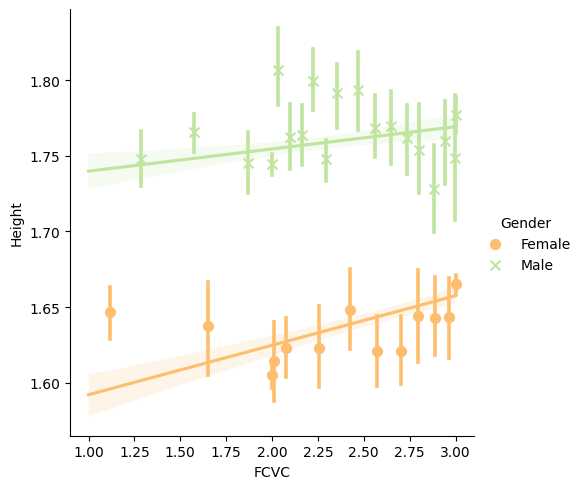

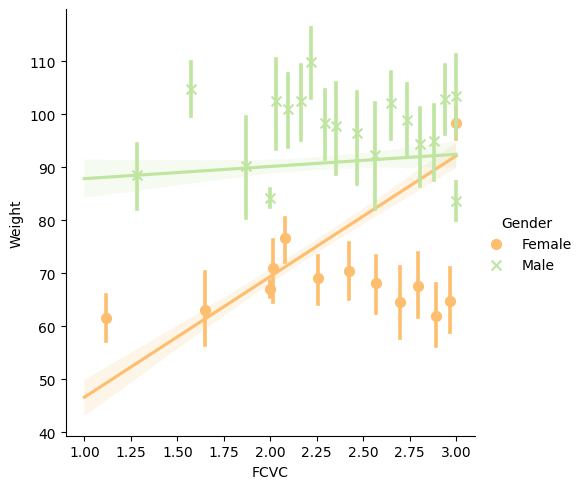

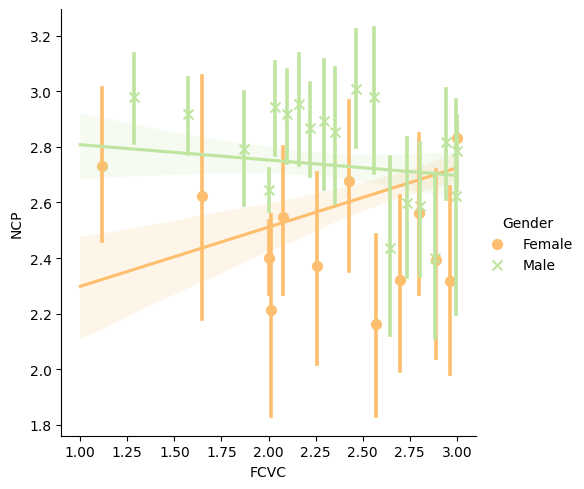

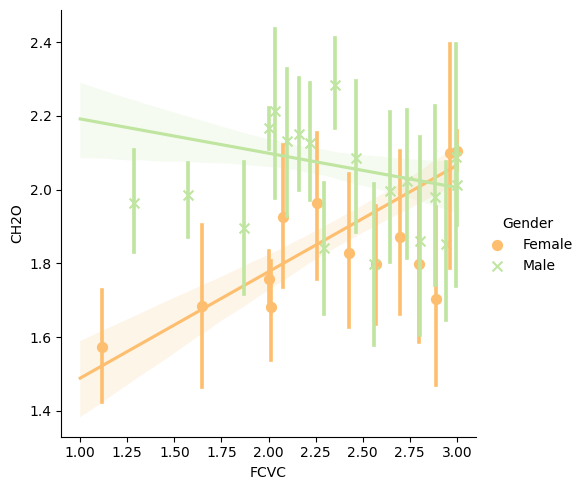

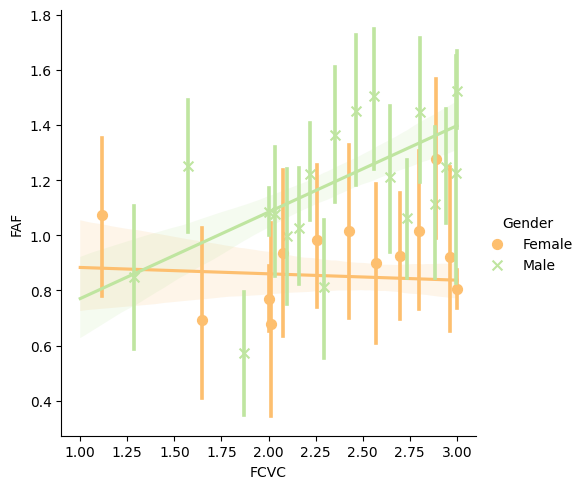

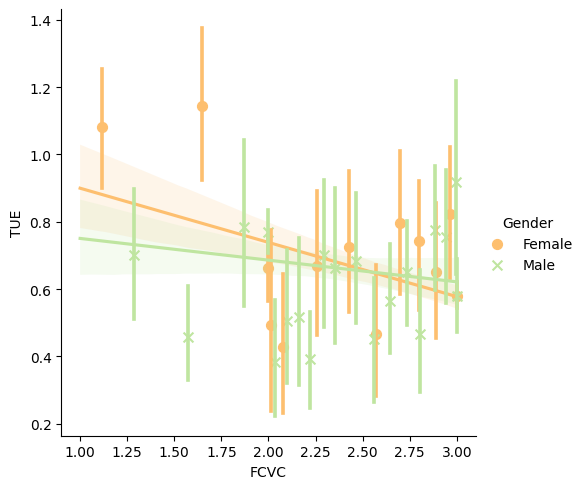

In [67]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="Gender", data=df, x_bins=35, palette="Spectral", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on Gender)
    - Number of Main Meals (NCP)

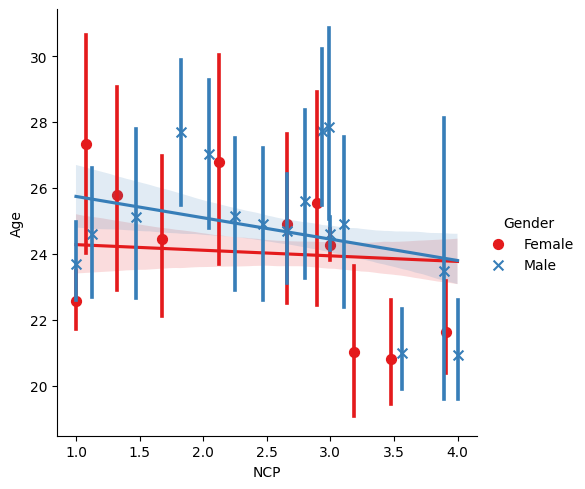

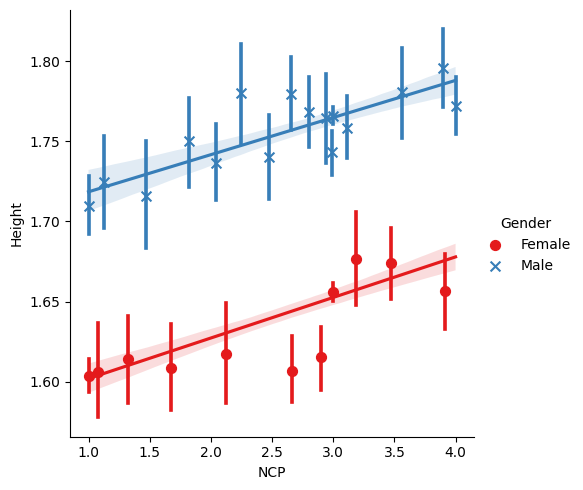

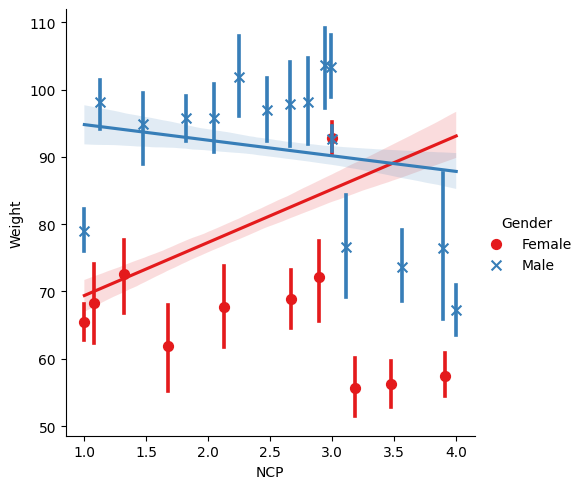

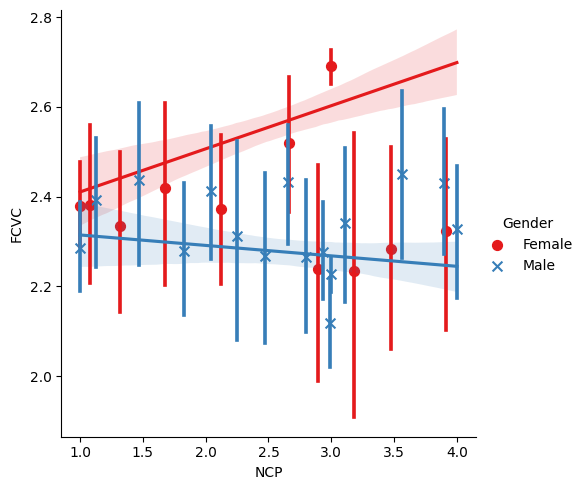

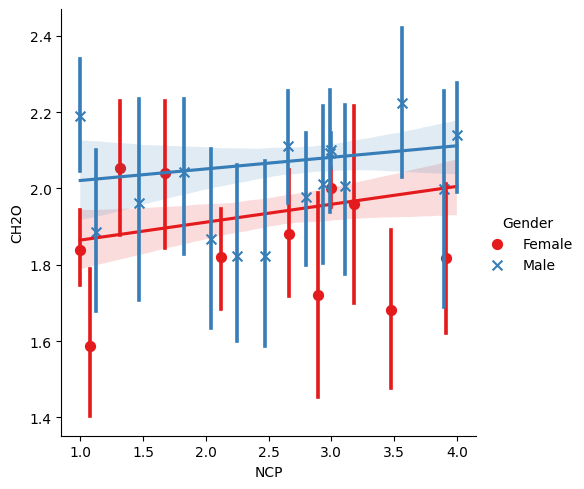

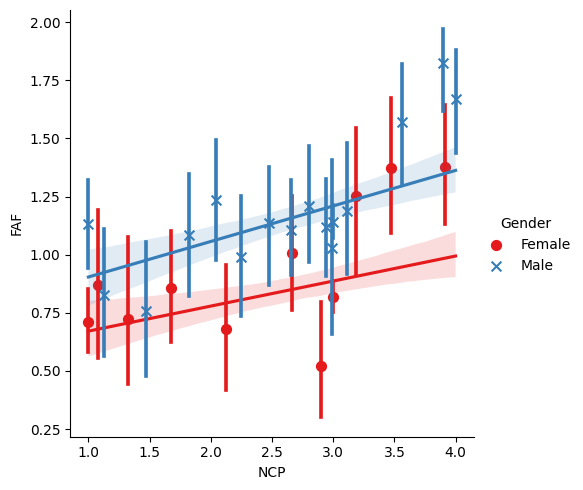

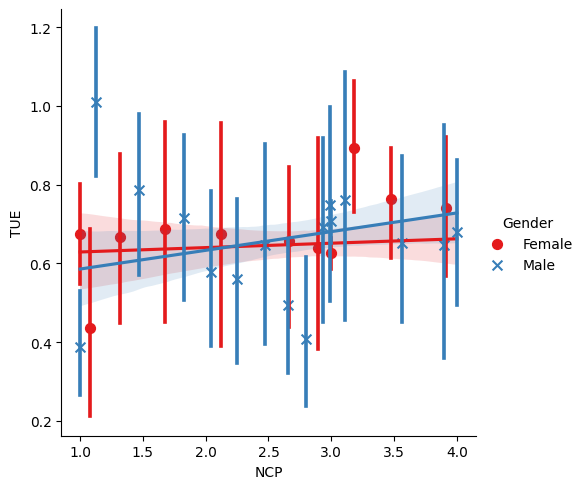

In [20]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="Gender", data=df, x_bins=35, palette="Set1", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on Gender)
    - Physical Activity Frequency (FAF)

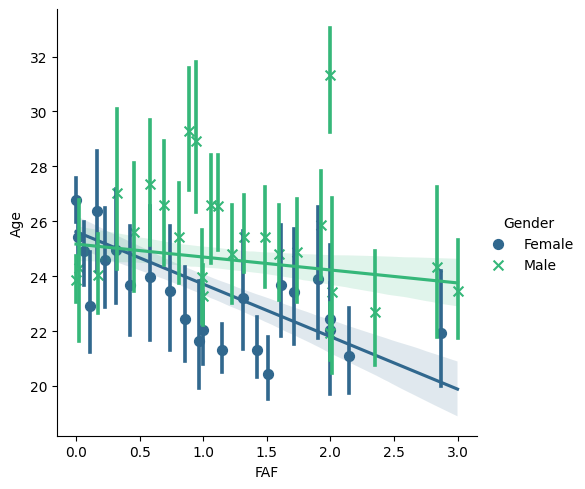

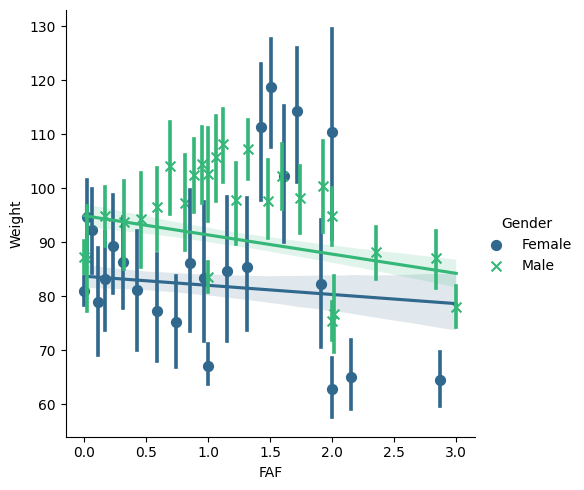

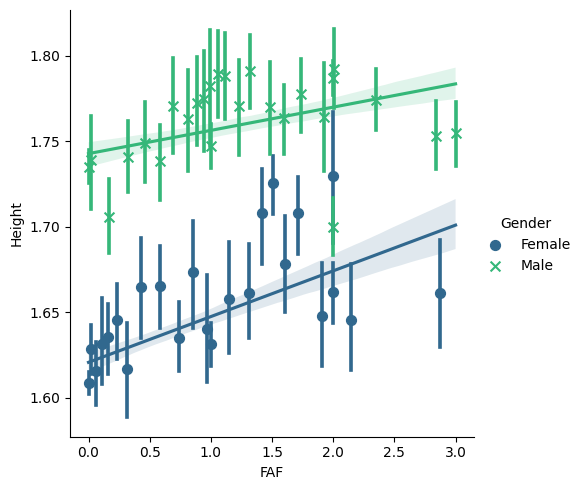

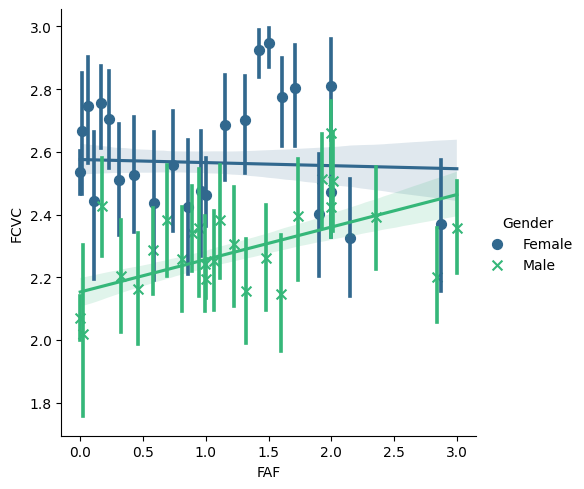

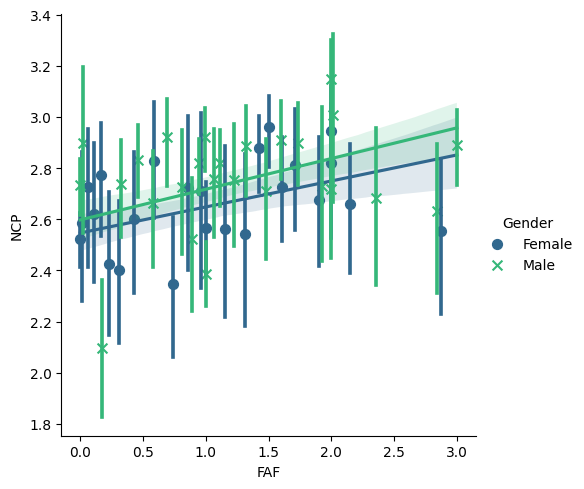

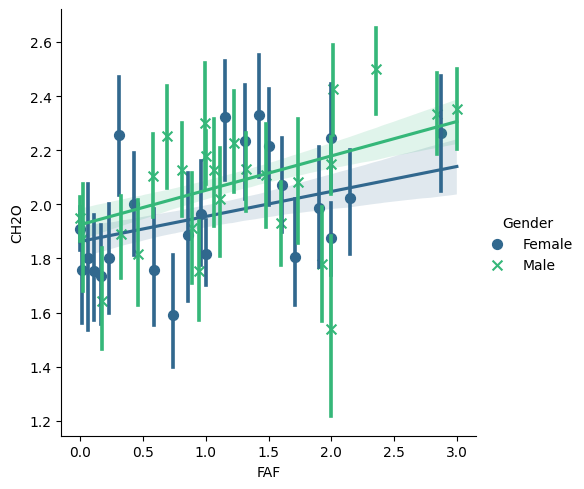

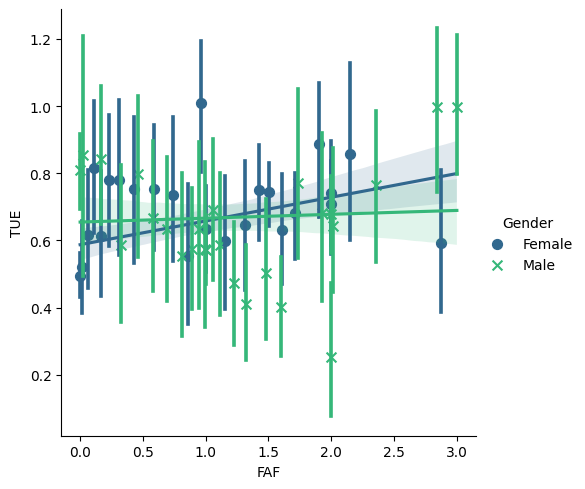

In [21]:
for col in ['Age', 'Weight', 'Height', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="Gender", data=df, x_bins=35, palette="viridis", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on Gender)
    - Time Using Technology Devices (TUE)

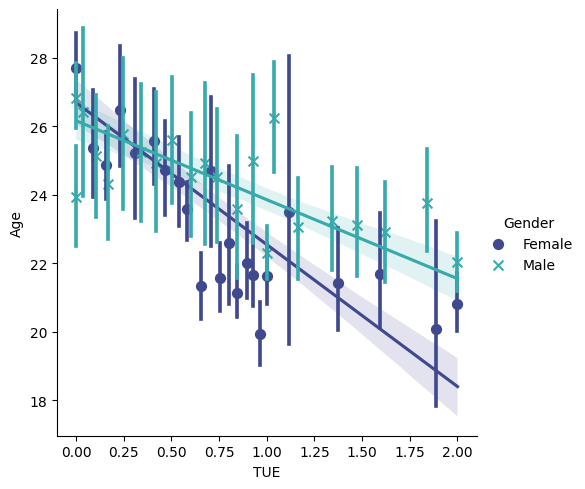

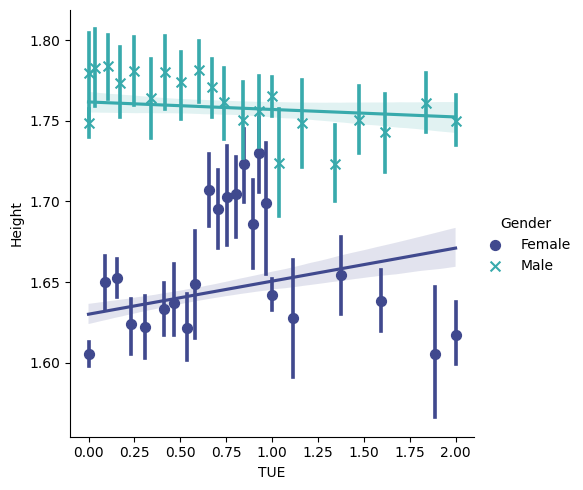

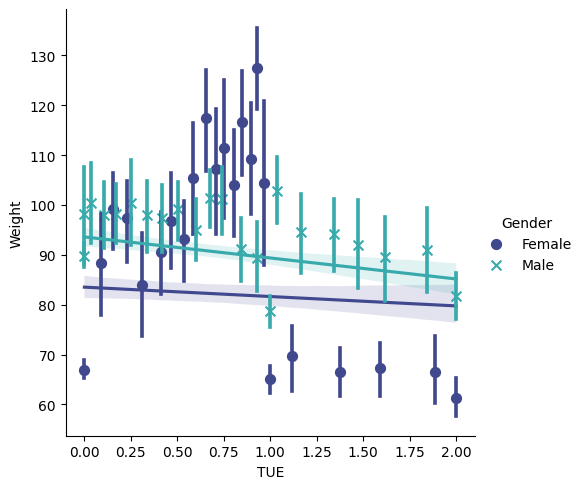

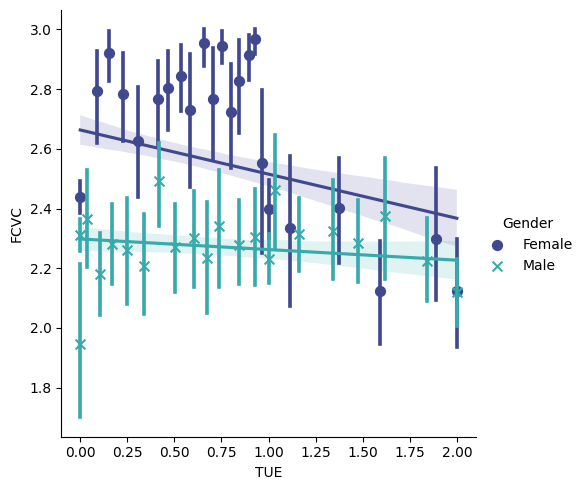

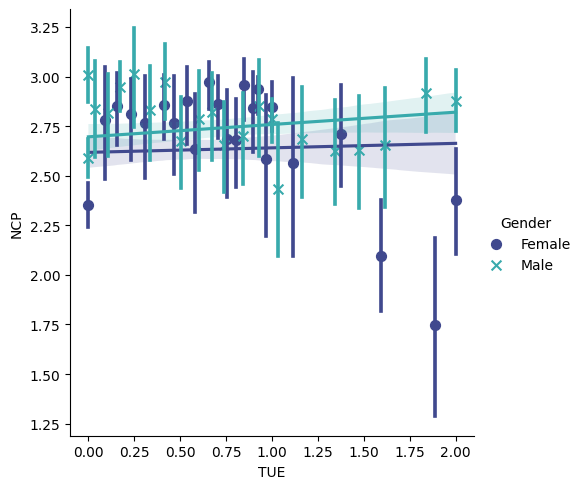

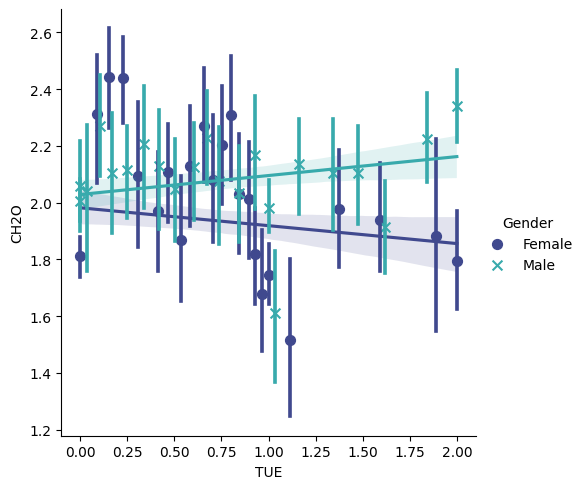

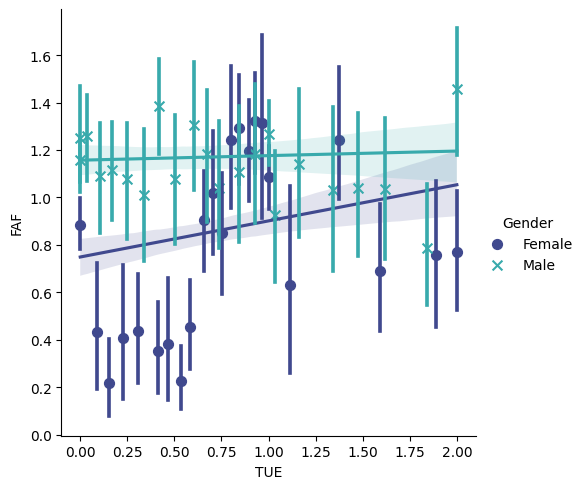

In [22]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="Gender", data=df, x_bins=35, palette="mako", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on family_history_with_overweight - Family Member/s Suffering From Overweight)
    - Weight

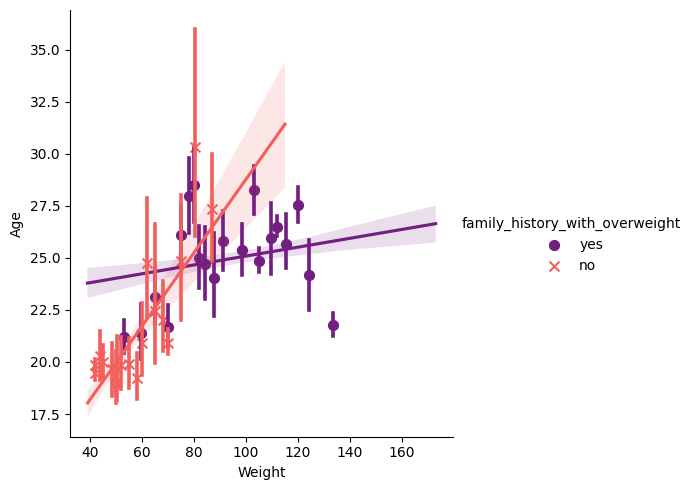

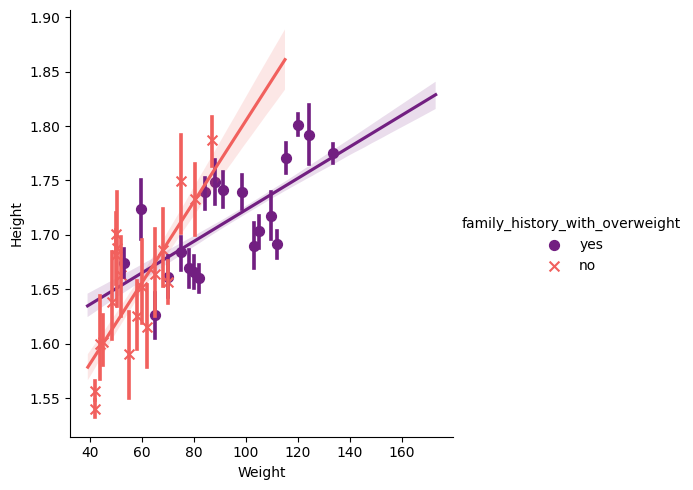

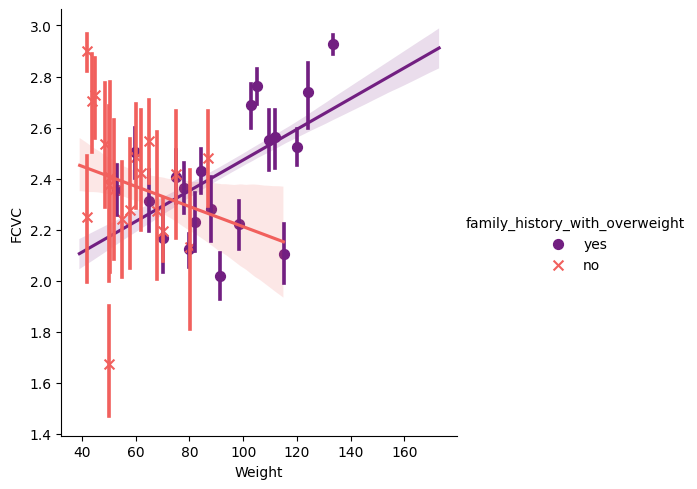

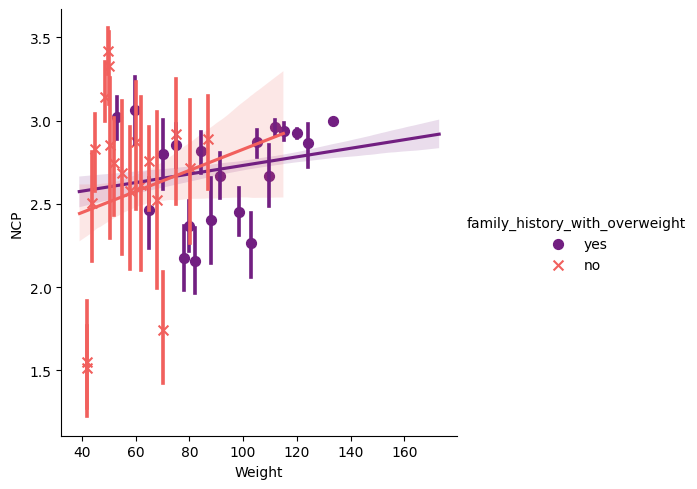

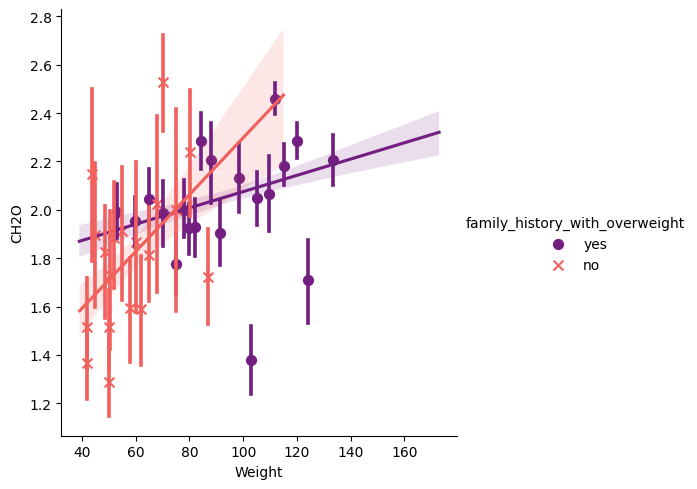

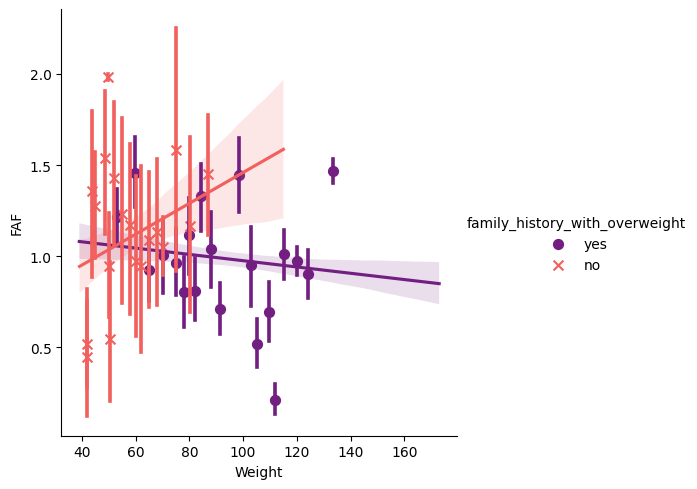

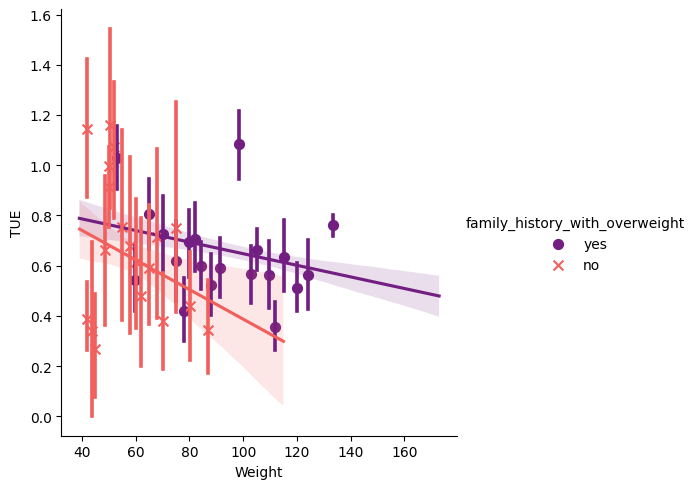

In [23]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="family_history_with_overweight", data=df, x_bins=20, palette="magma", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on family_history_with_overweight - Family Member/s Suffering From Overweight)
    - Frequency of Consumption of Vegetables (FCVC)

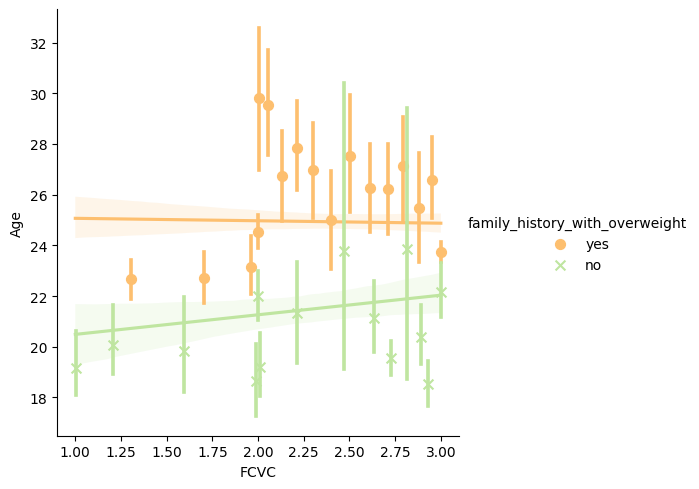

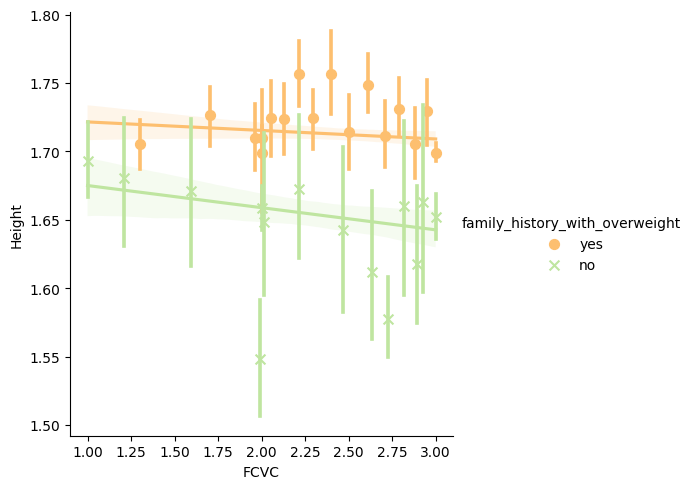

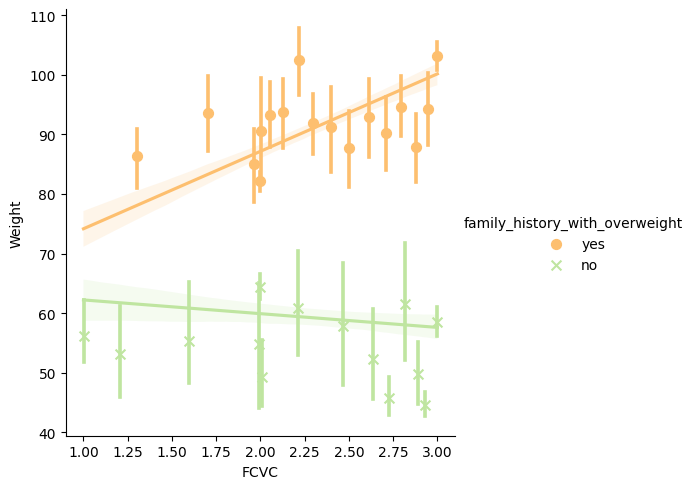

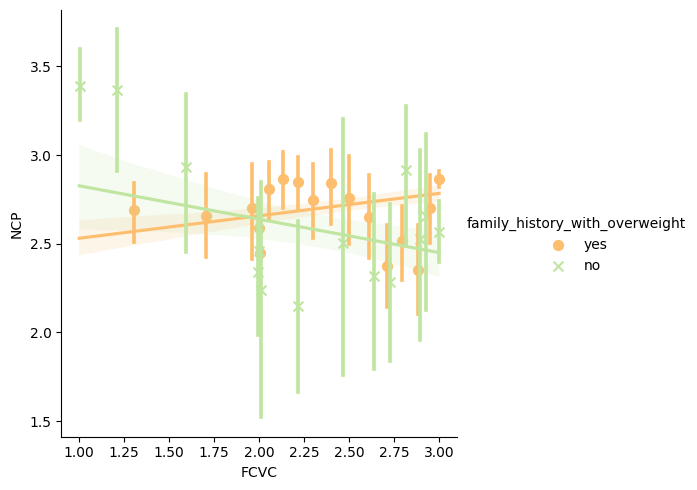

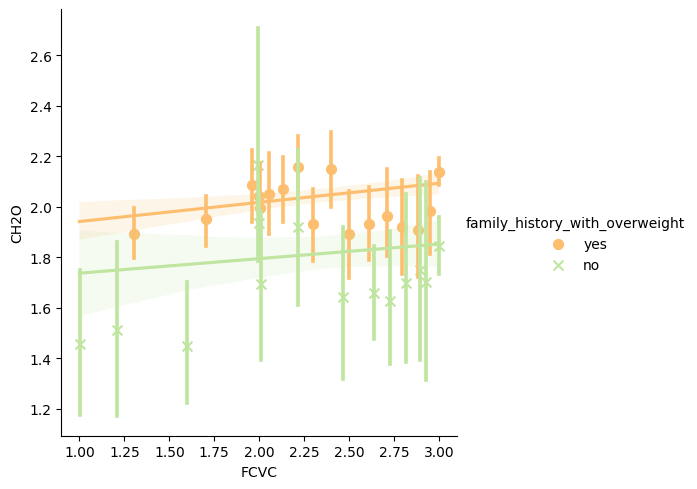

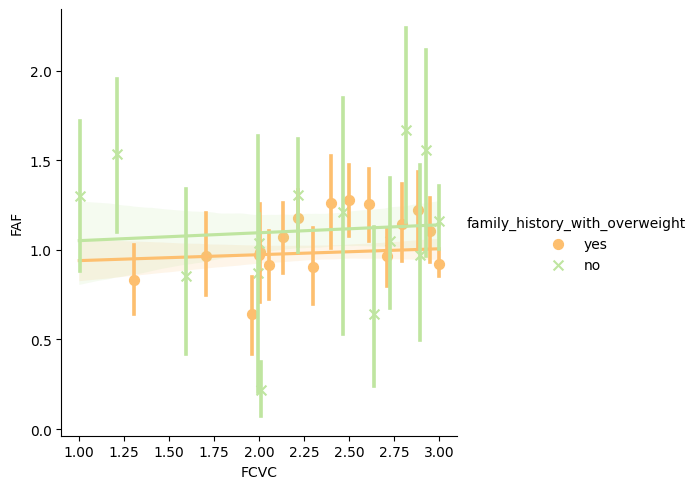

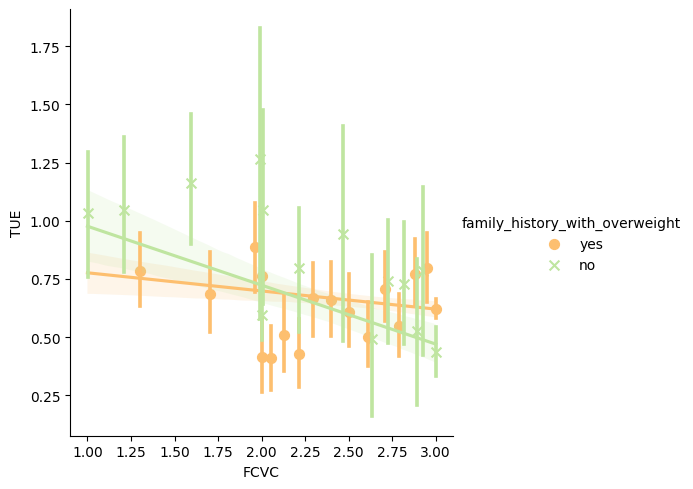

In [68]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="family_history_with_overweight", data=df, x_bins=35, palette="Spectral", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on family_history_with_overweight - Family Member/s Suffering From Overweight)
    - Number of Main Meals (NCP)

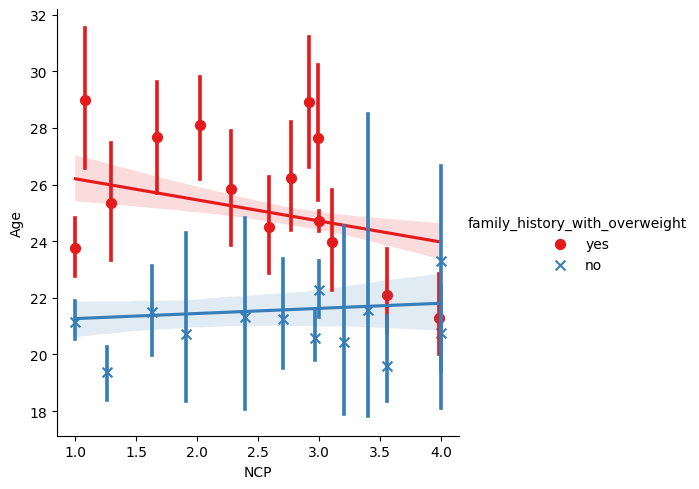

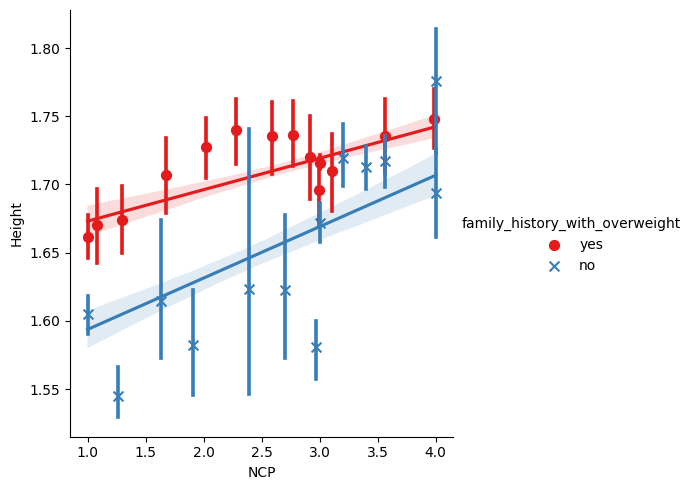

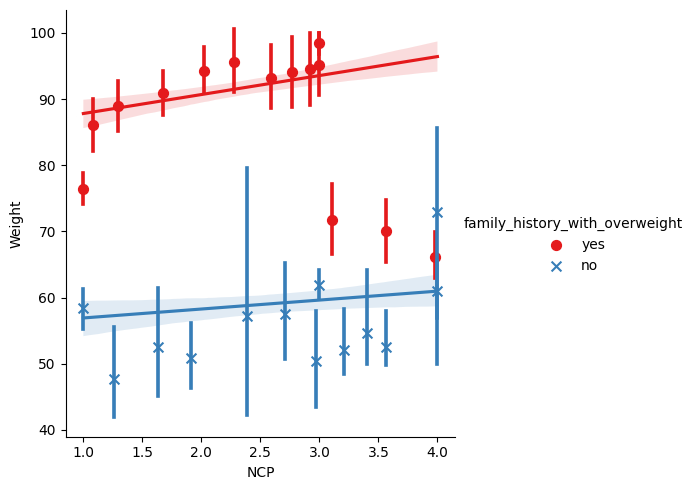

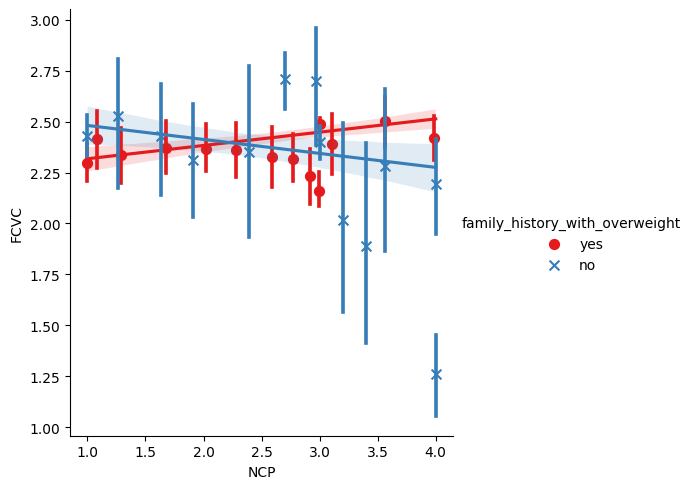

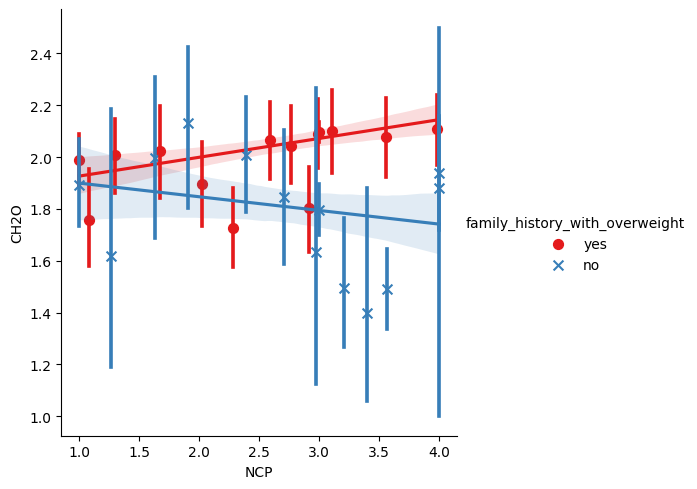

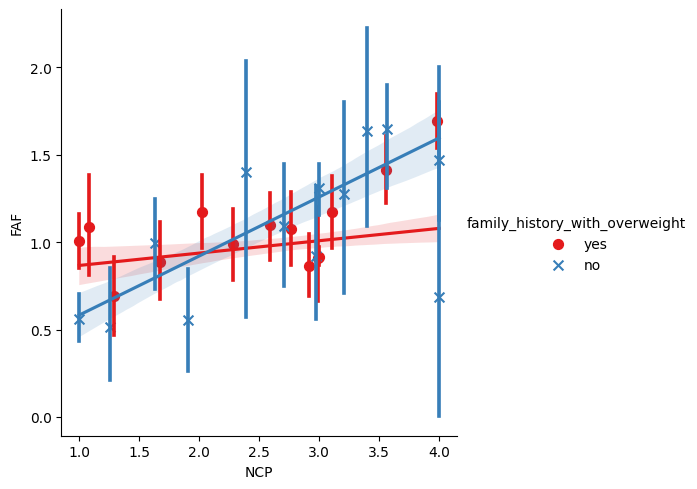

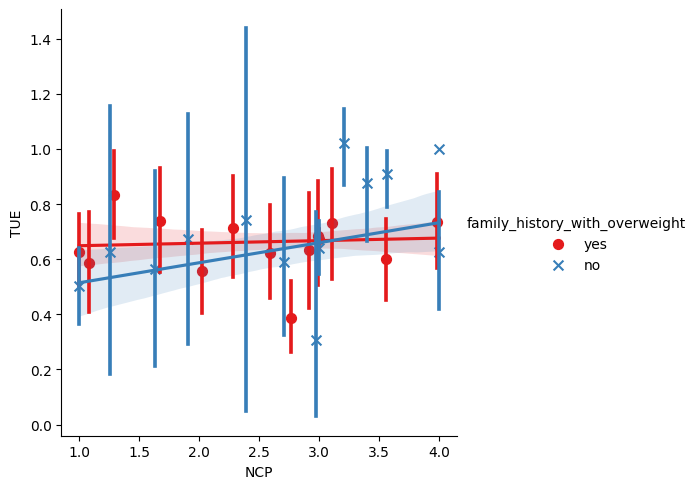

In [25]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="family_history_with_overweight", data=df, x_bins=35, palette="Set1", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on family_history_with_overweight - Frequent of Consumption of High Calorific Food)
    - Physical Activity Frequent (FAF)

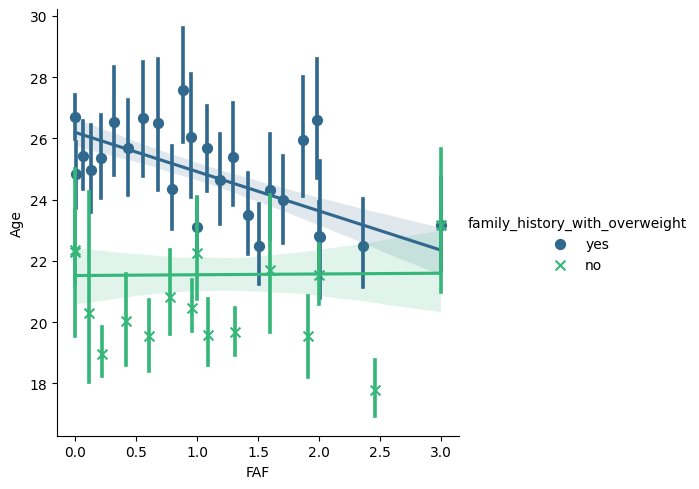

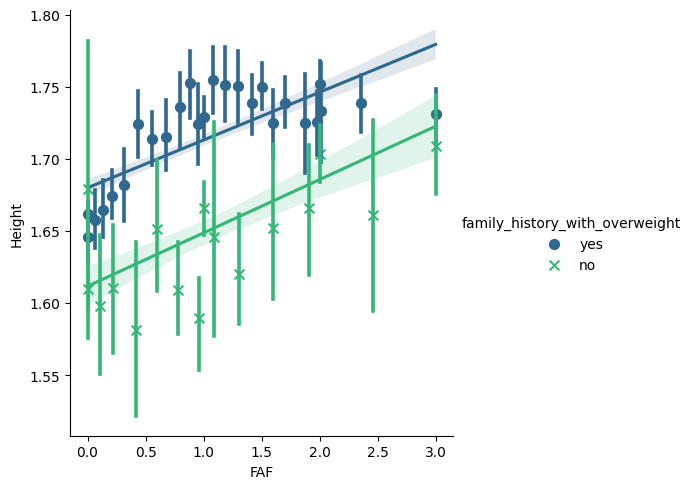

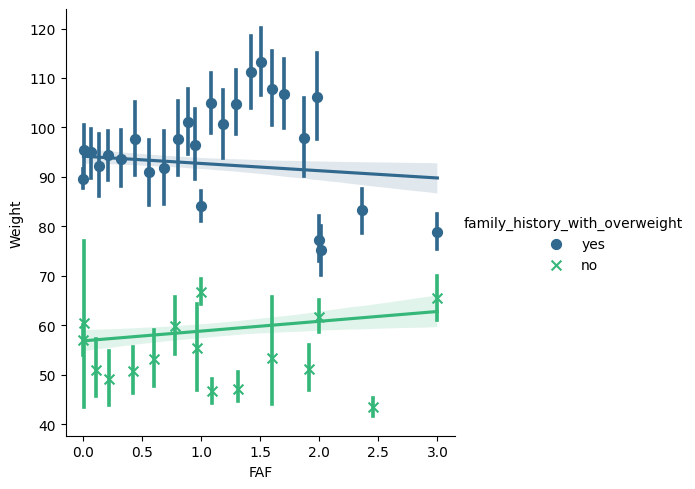

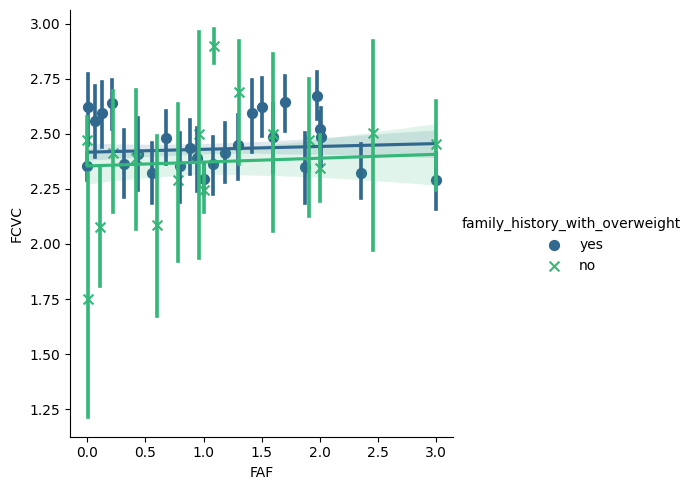

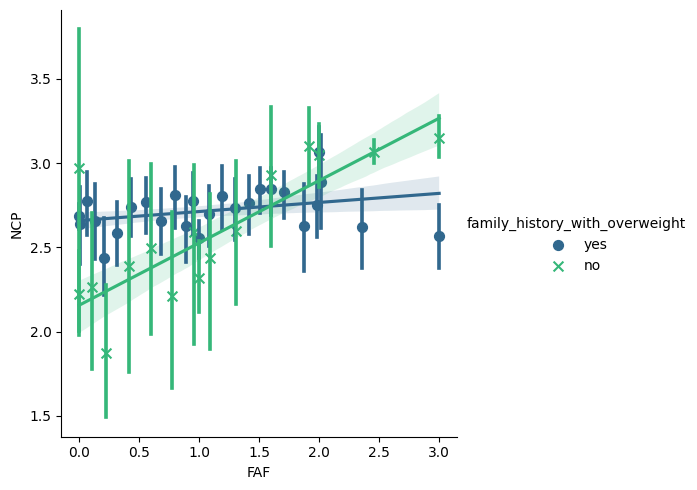

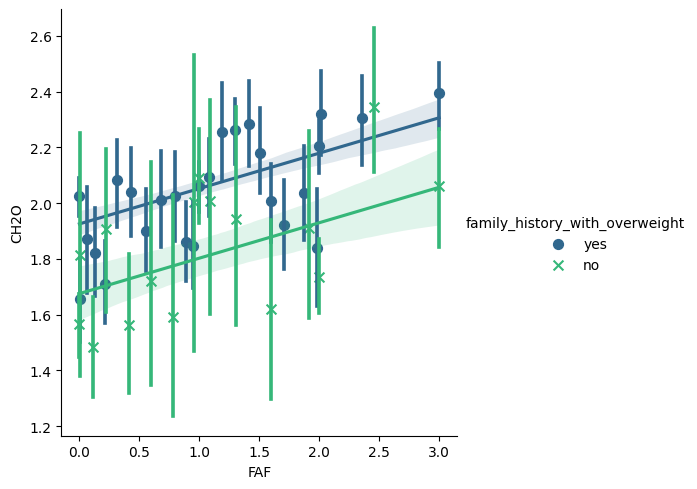

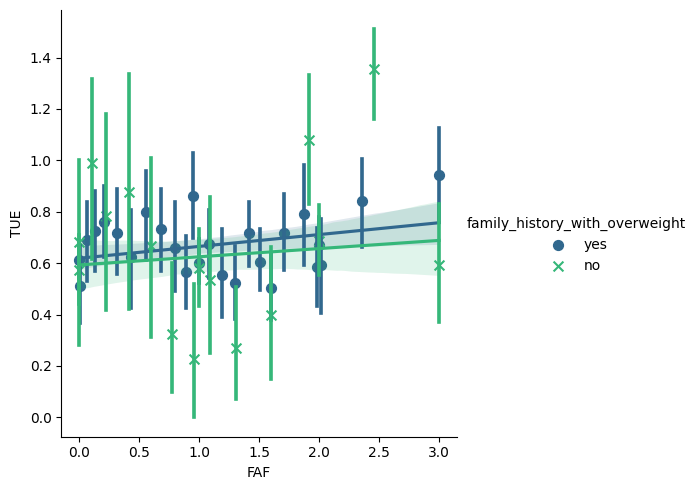

In [26]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="family_history_with_overweight", data=df, x_bins=35, palette="viridis", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on family_history_with_overweight - Family Member/s Suffering From Overweight)
    - Time Using Technology Devices (TUE)

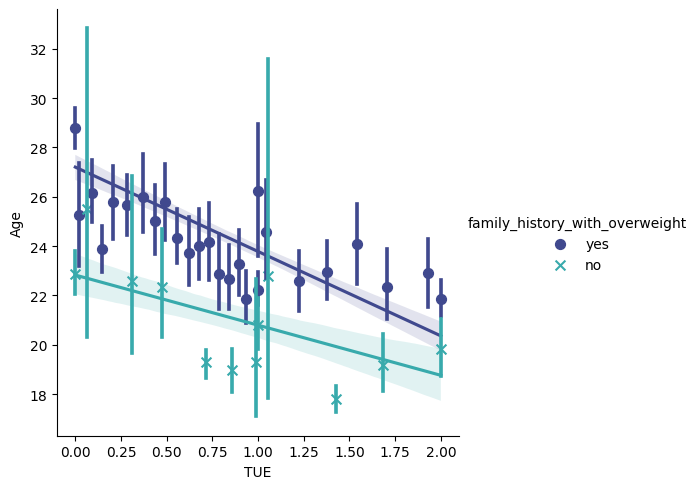

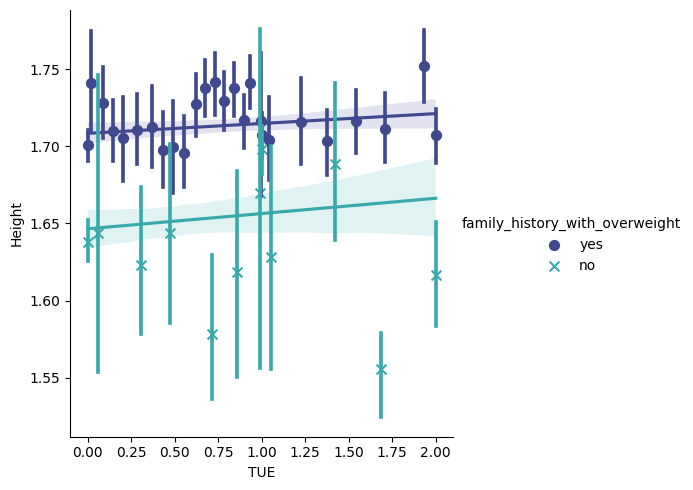

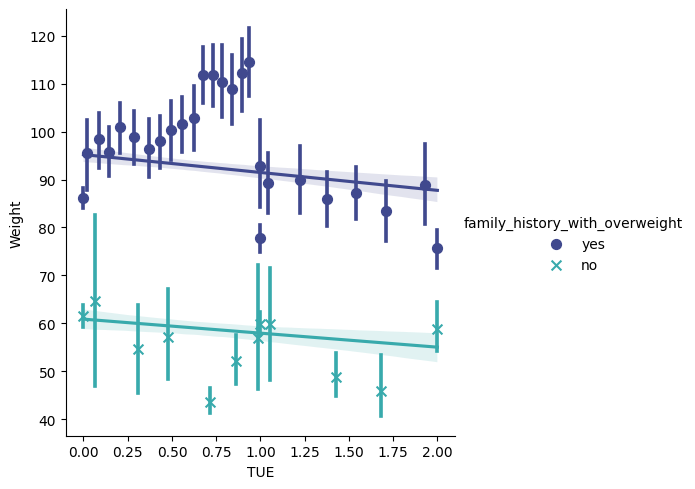

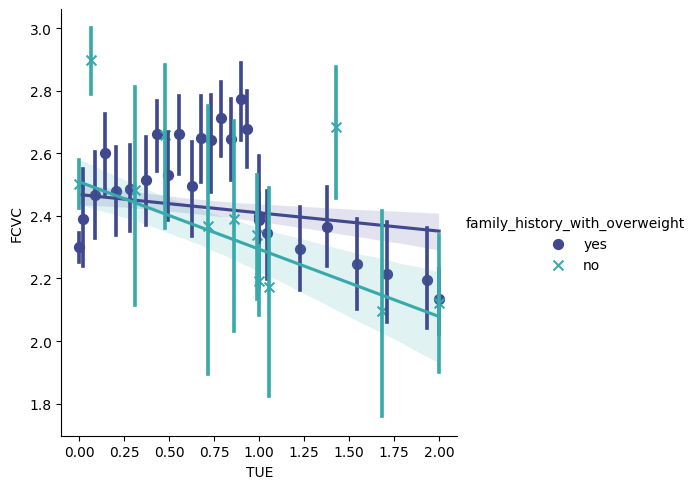

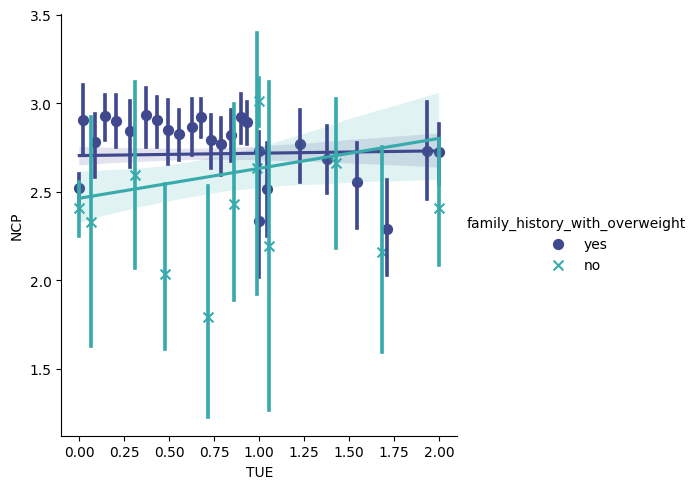

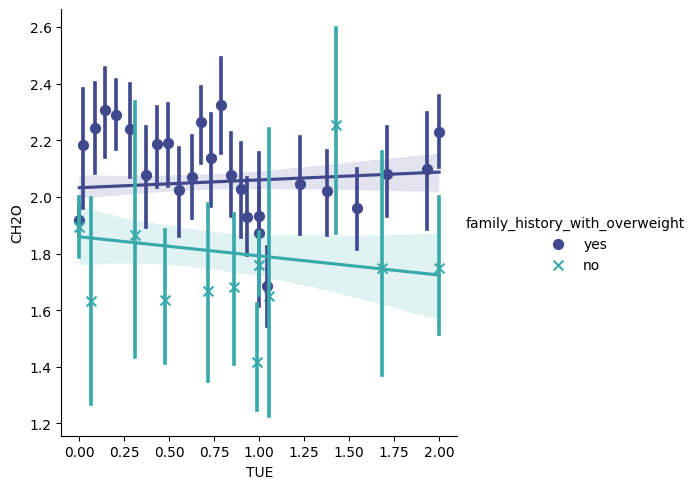

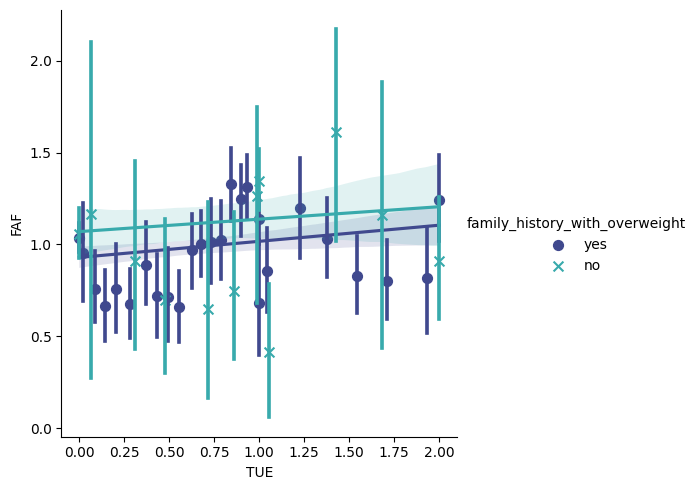

In [27]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="family_history_with_overweight", data=df, x_bins=35, palette="mako", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on FAVC - Frequent Consumption of High Calorific Food)
    - Weight

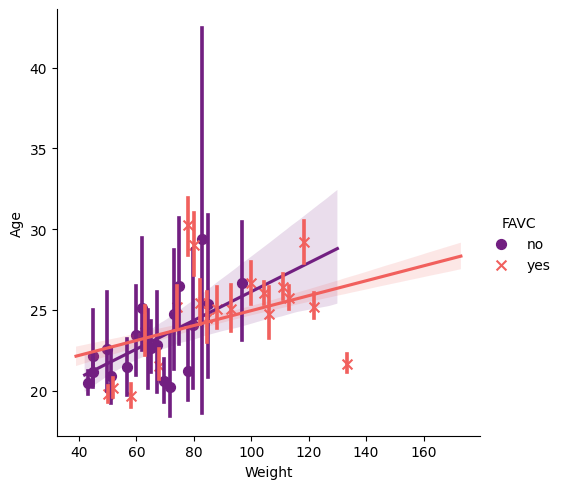

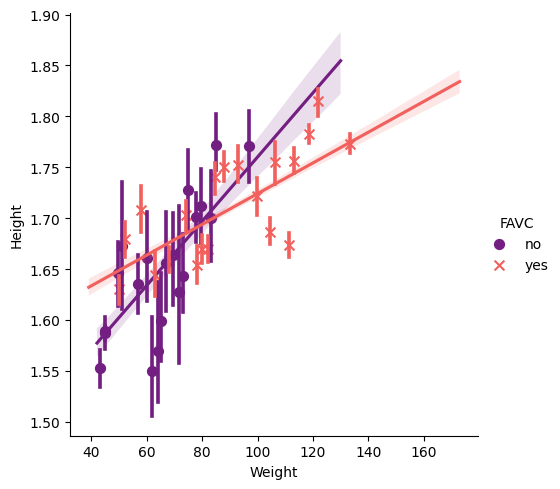

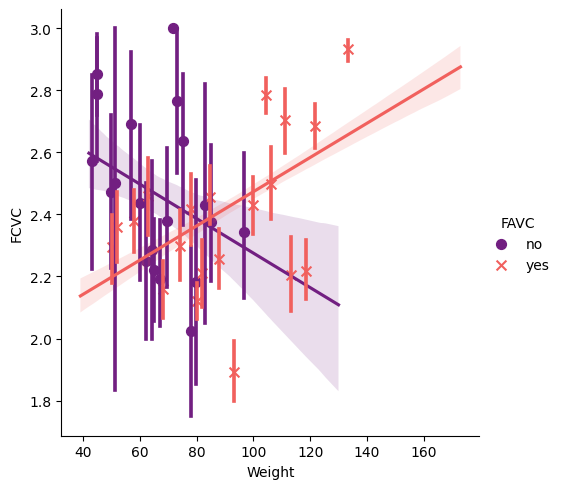

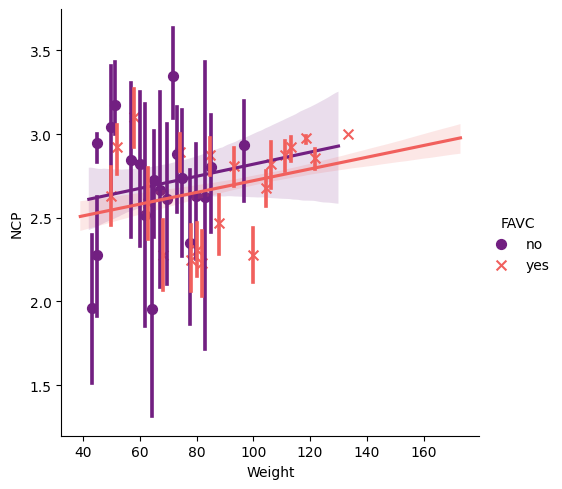

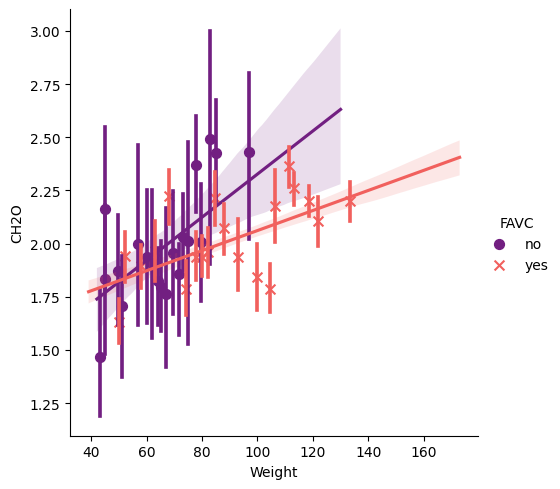

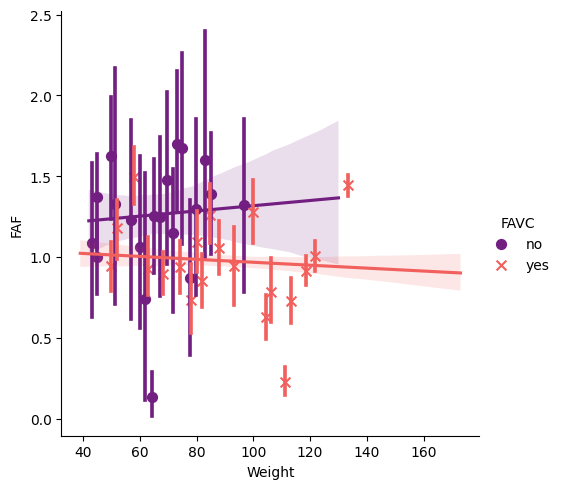

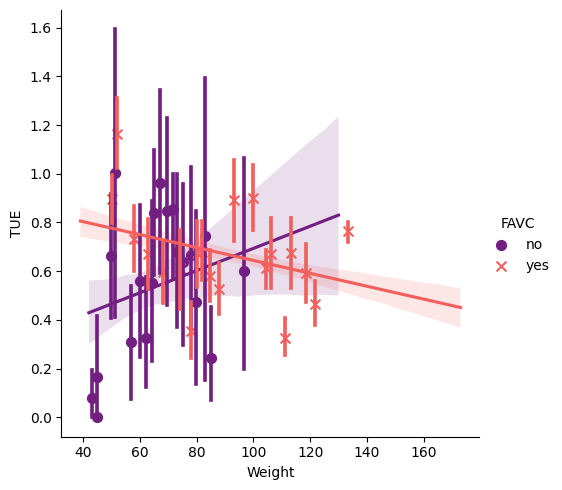

In [28]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="FAVC", data=df, x_bins=20, palette="magma", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on FAVC - Frequent Consumption of High Calorific Food)
    - Frequency of Consumption of Vegetables (FCVC)

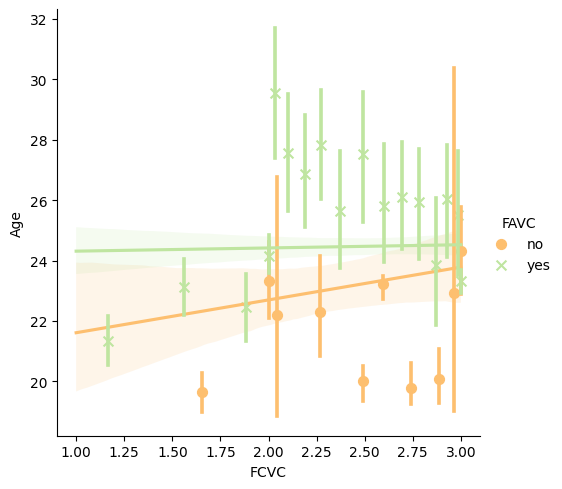

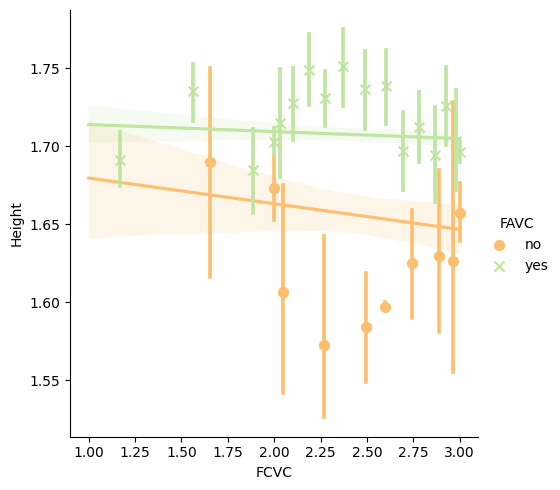

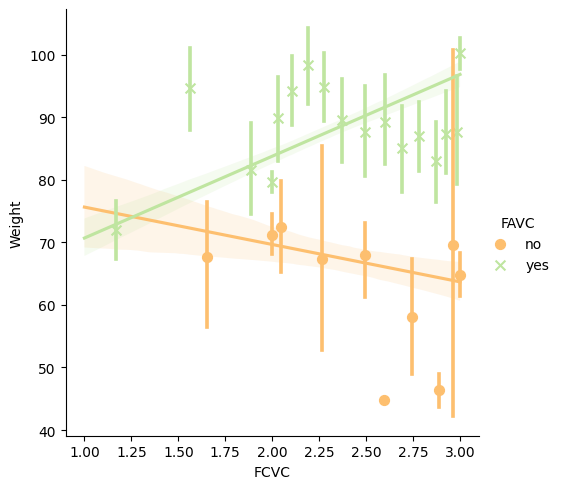

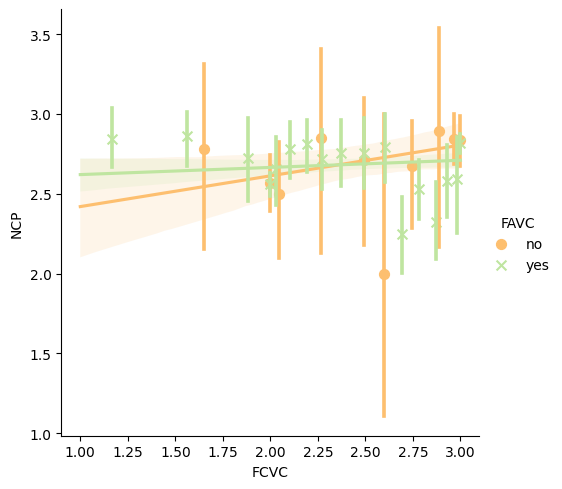

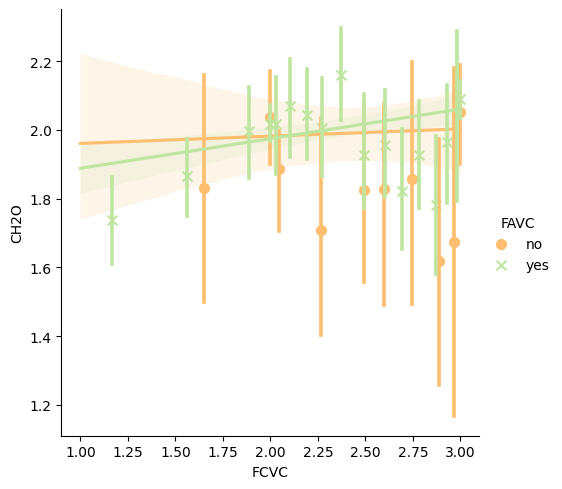

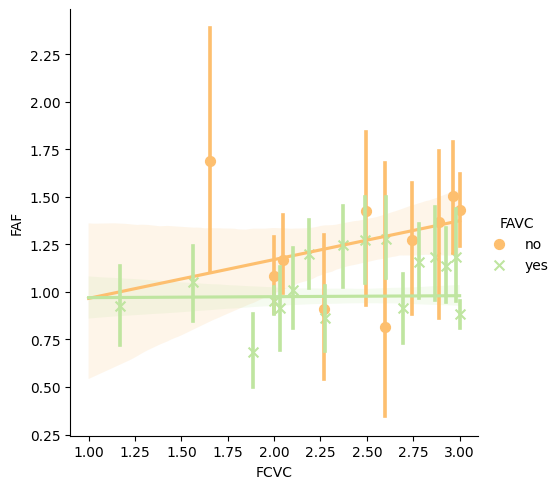

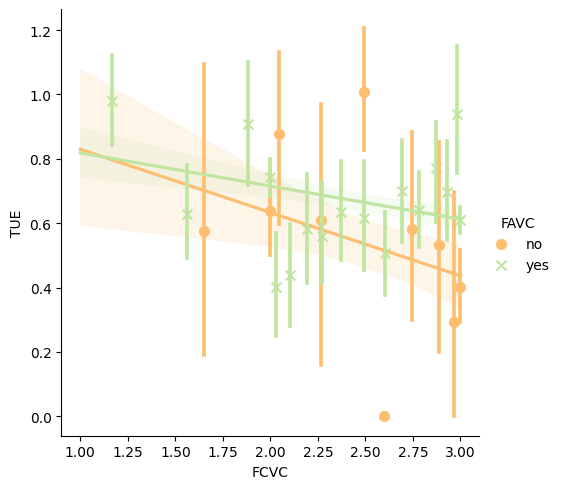

In [69]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="FAVC", data=df, x_bins=35, palette="Spectral", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on FAVC - Frequent Consumption of High Calorific Food)
    - Number of Main Meals (NCP)

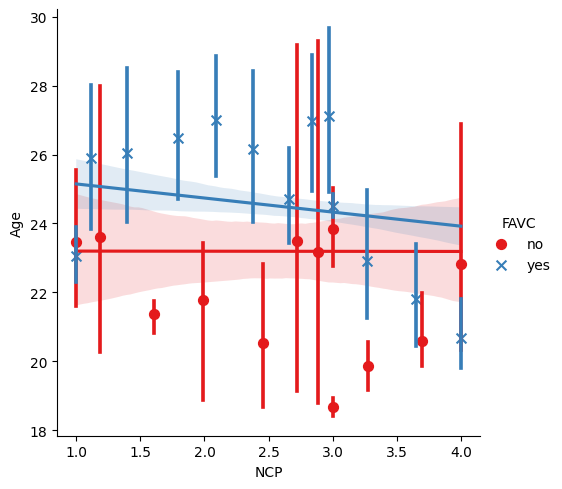

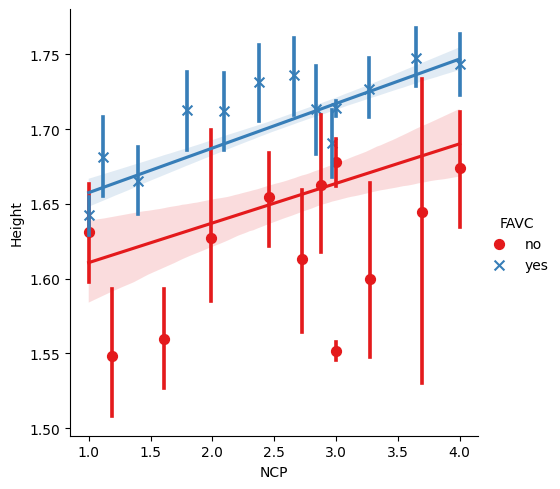

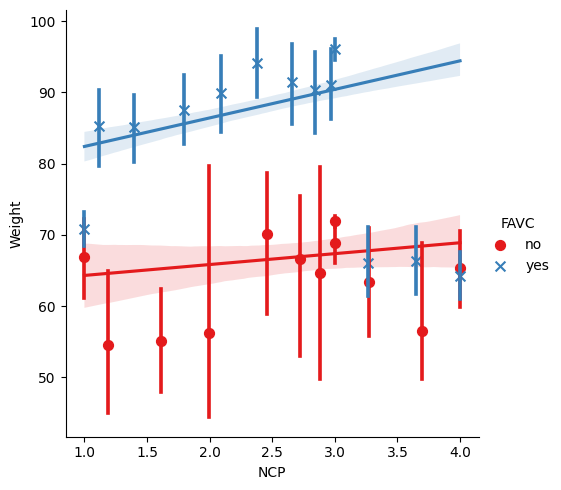

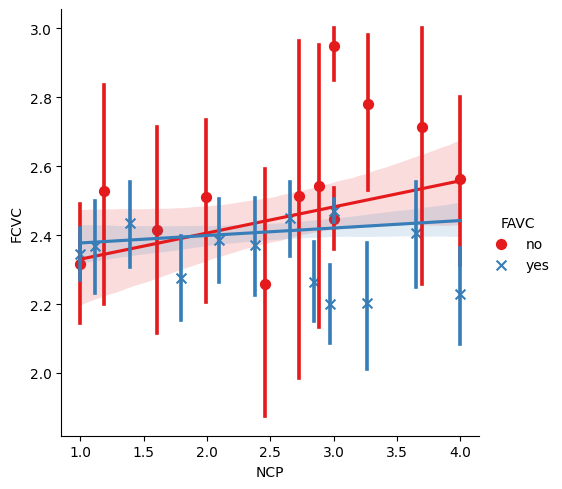

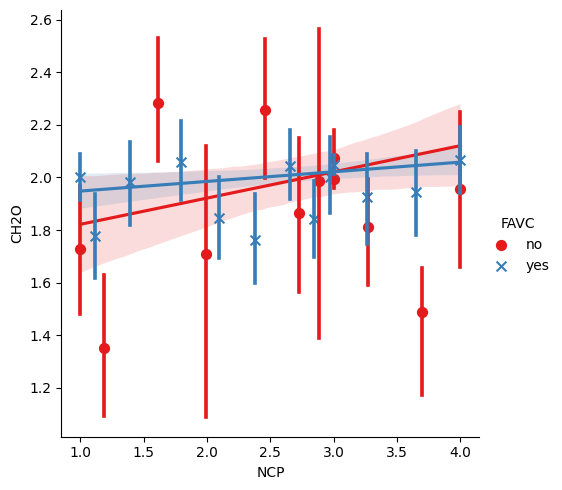

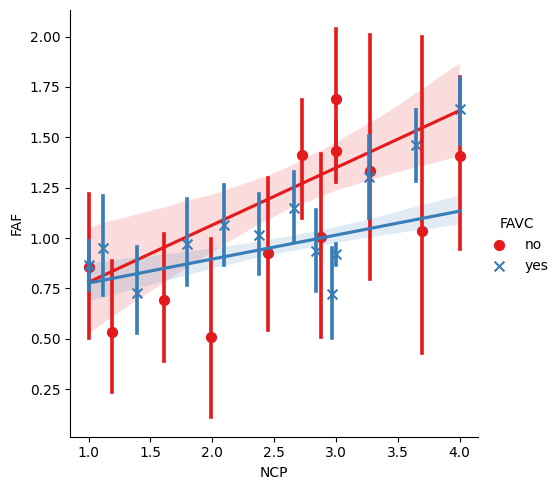

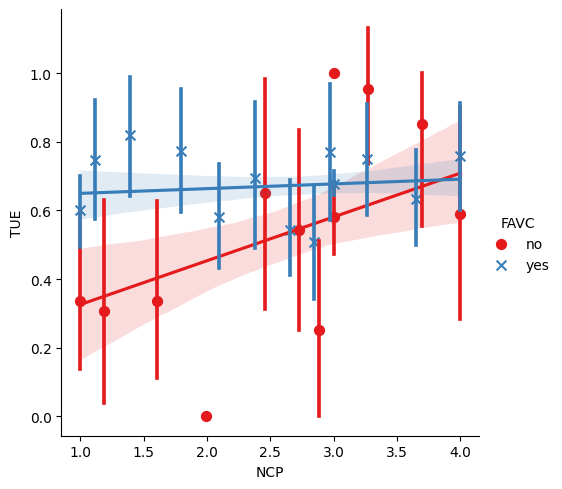

In [30]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="FAVC", data=df, x_bins=35, palette="Set1", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on FAVC - Frequent of Consumption of High Calorific Food)
    - Physical Activity Frequent (FAF)

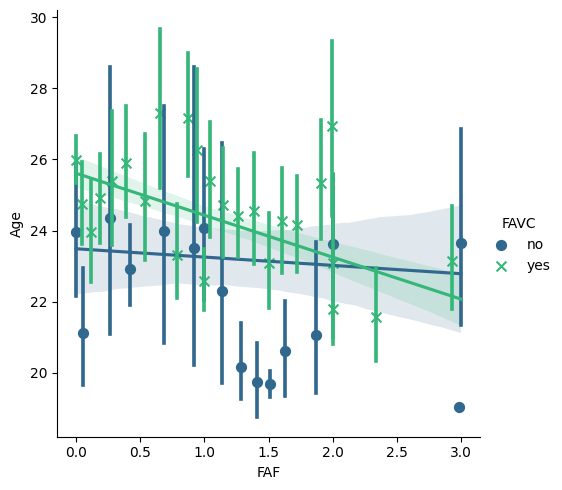

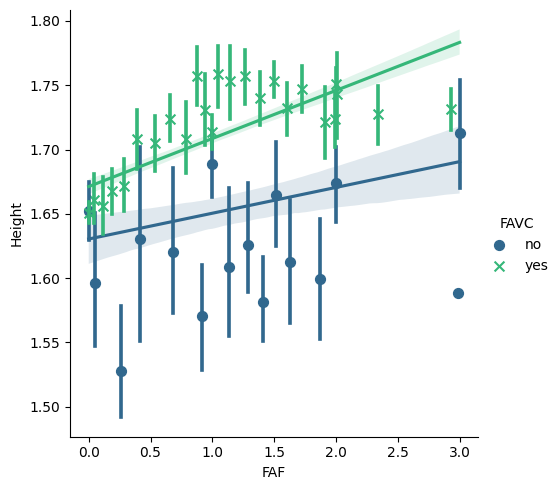

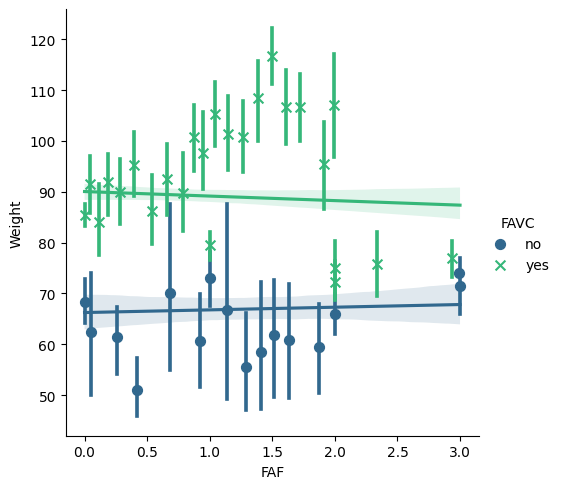

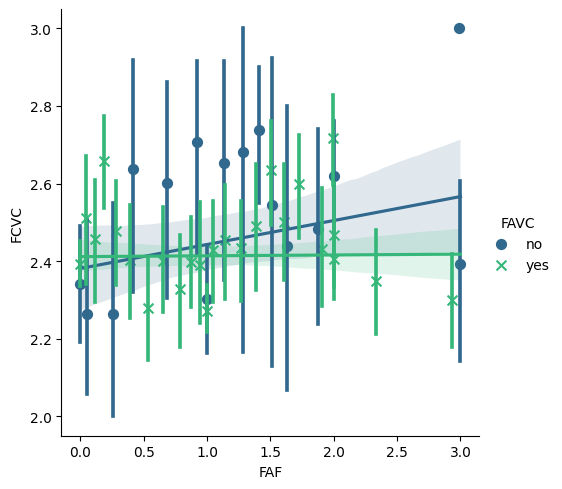

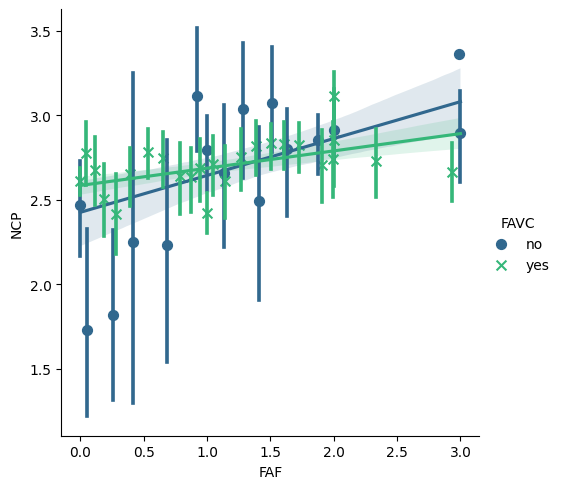

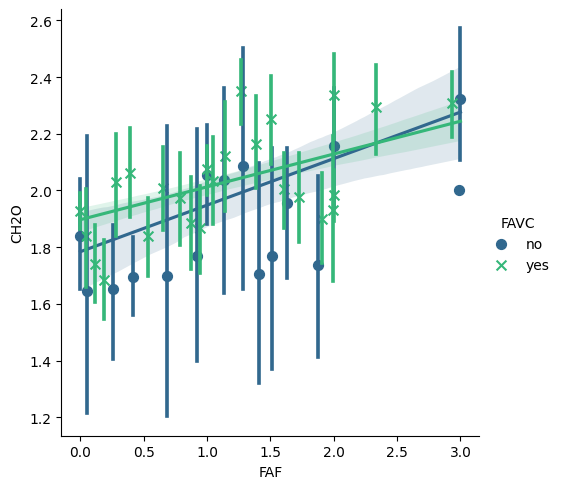

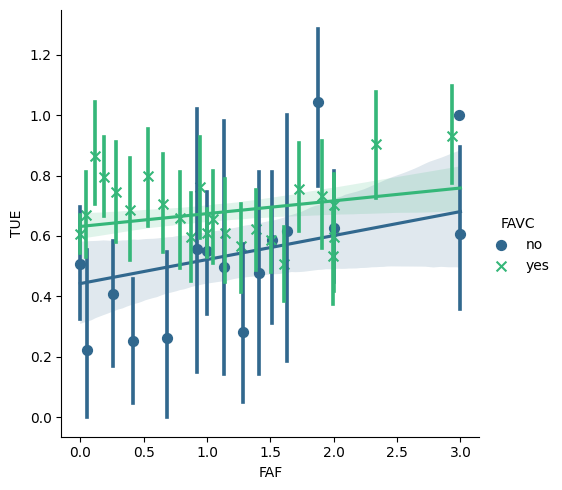

In [31]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="FAVC", data=df, x_bins=35, palette="viridis", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on FAVC - Frequent Consumption of High Calorific Food)
    - Time Using Technology Devices (TUE)

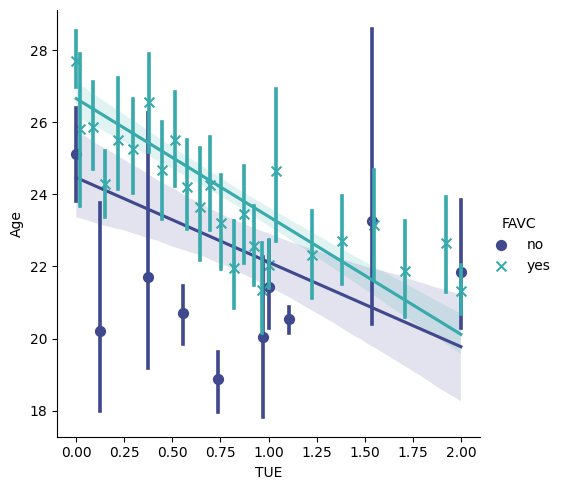

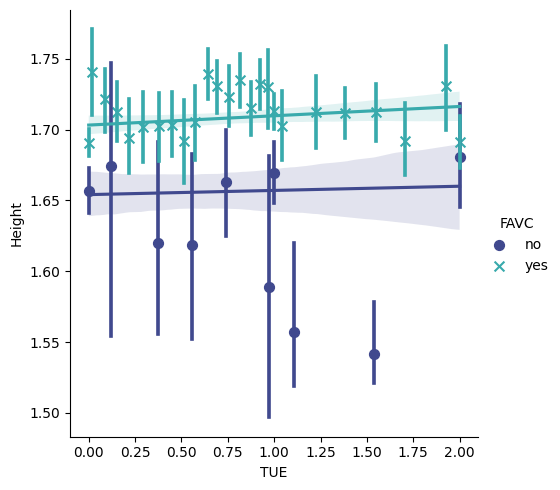

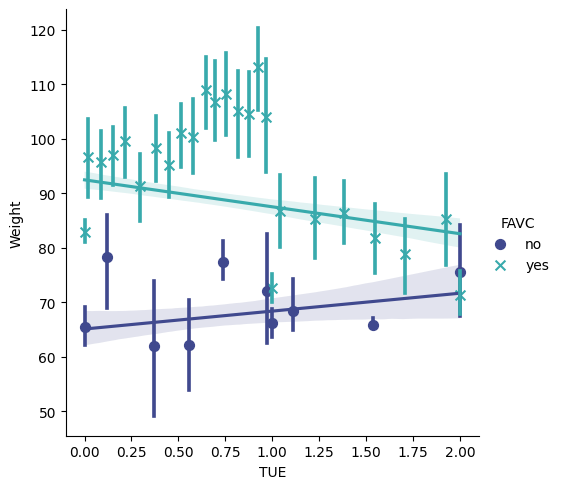

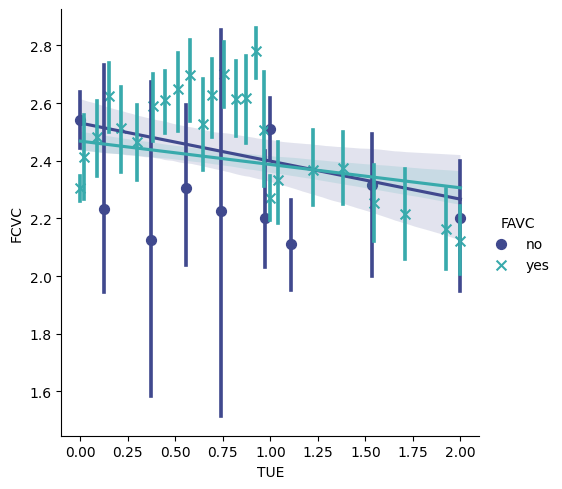

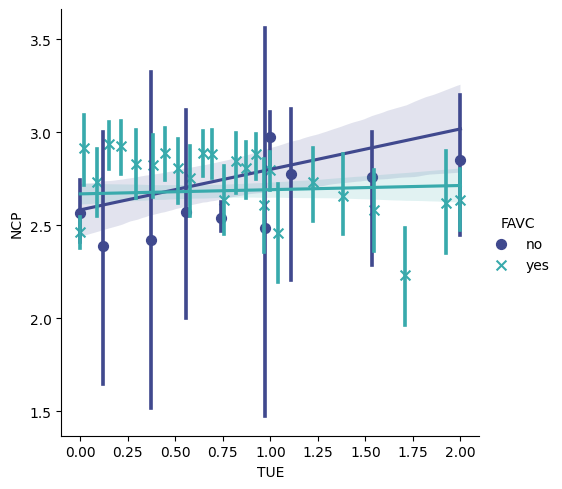

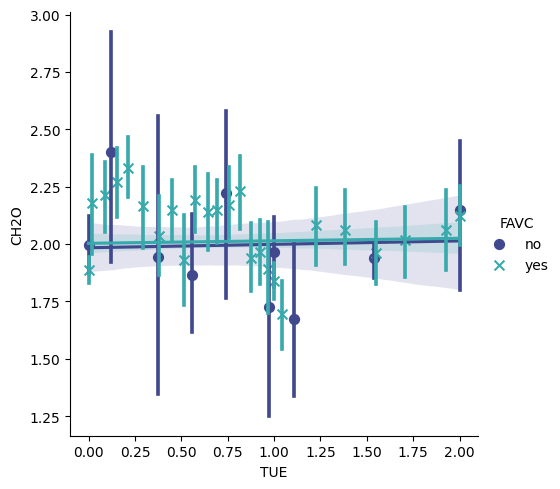

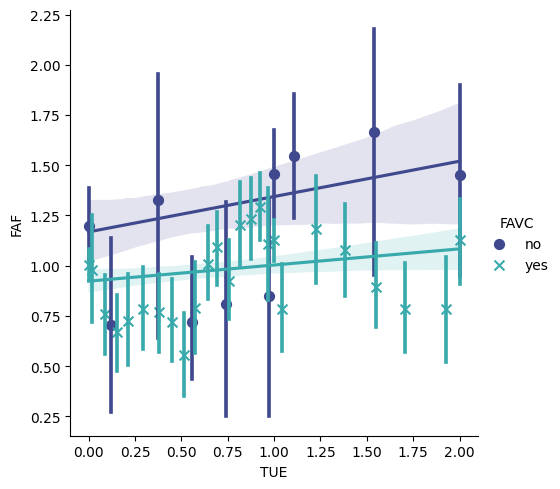

In [32]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="FAVC", data=df, x_bins=35, palette="mako", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on CAEC - Consumption of Food Between Meals)
    - Weight

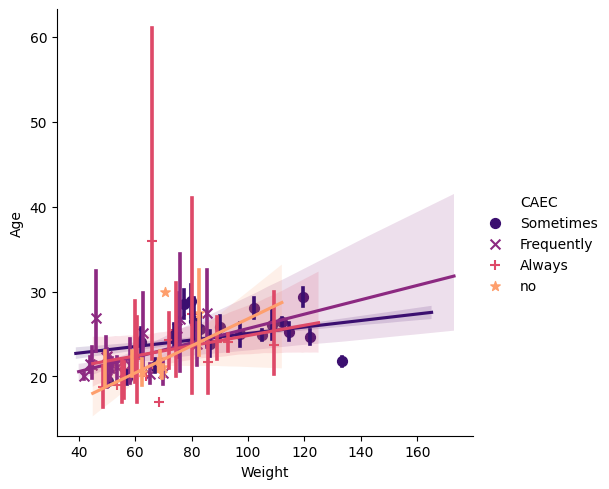

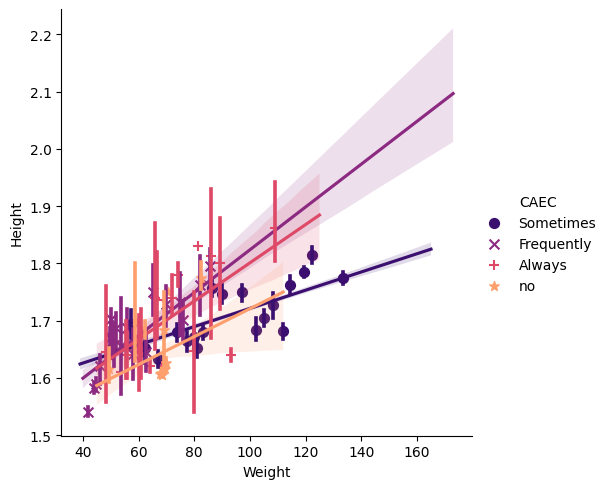

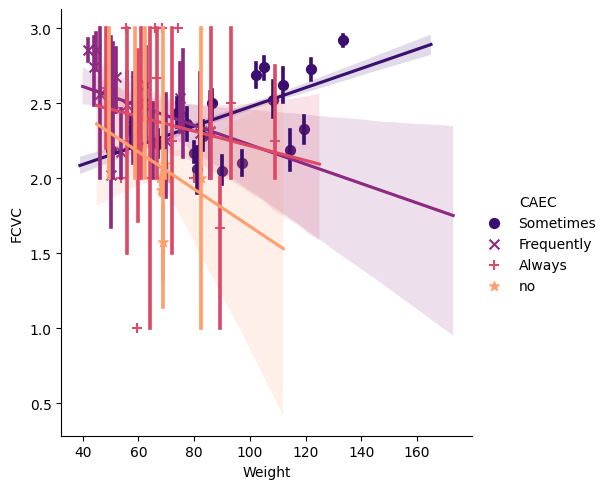

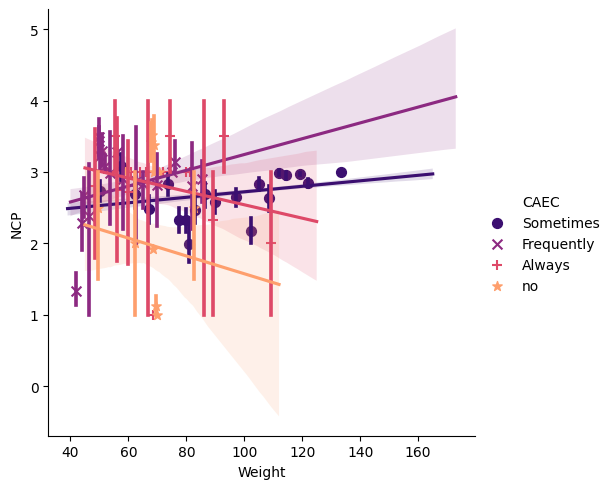

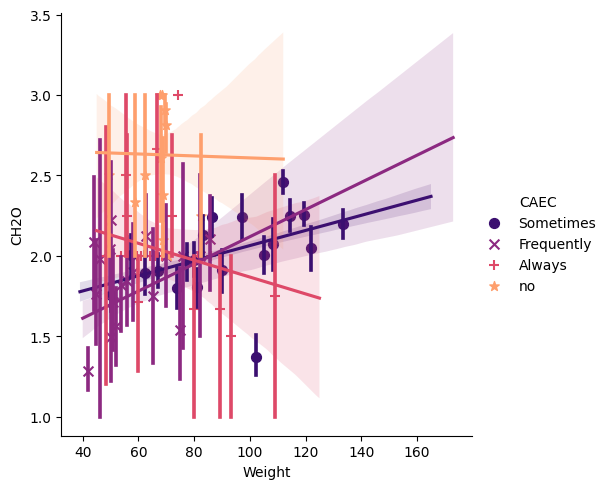

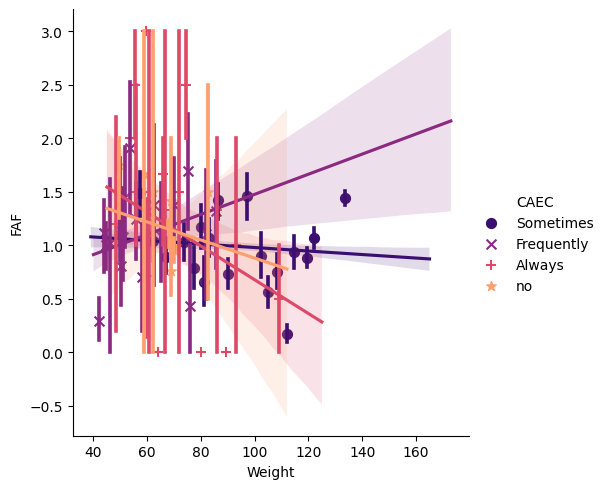

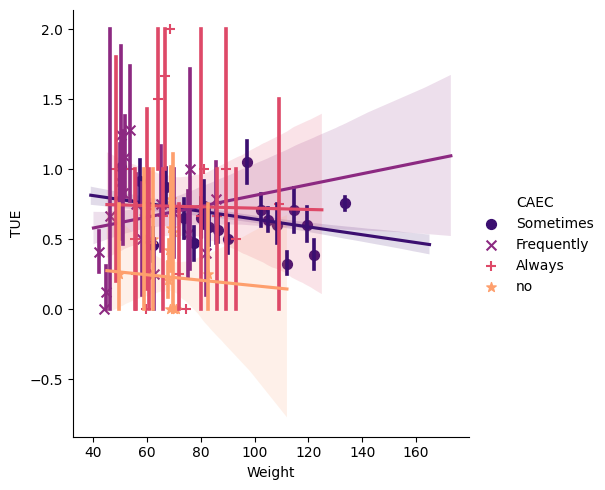

In [33]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="CAEC", data=df, x_bins=20, palette="magma", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on CAEC - Consumption of Food Between Meals)
    - Frequency of Consumption of Vegetables (FCVC)

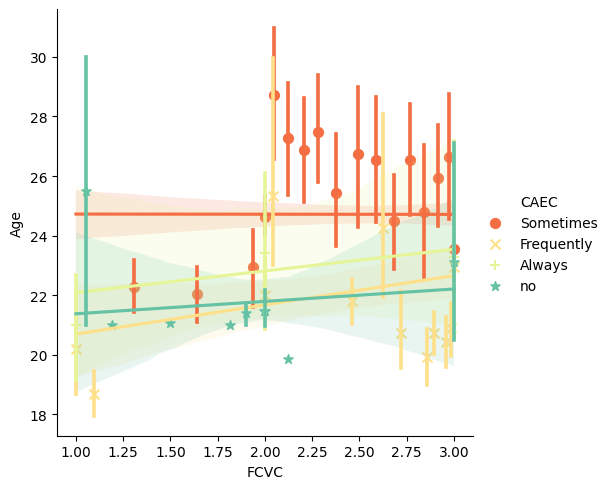

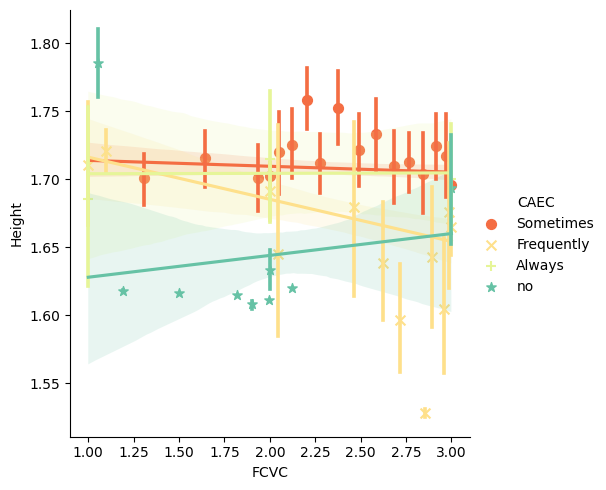

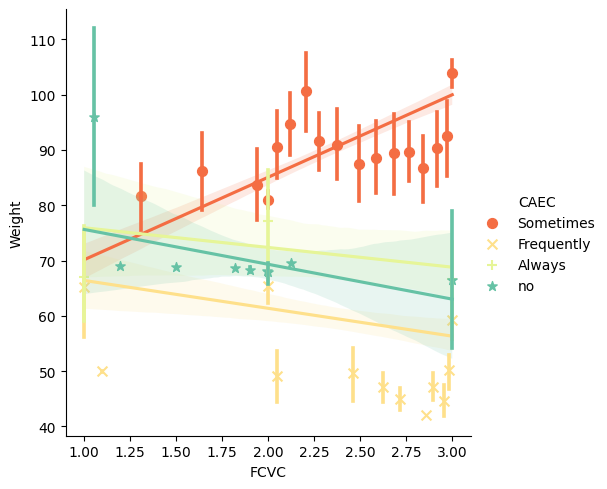

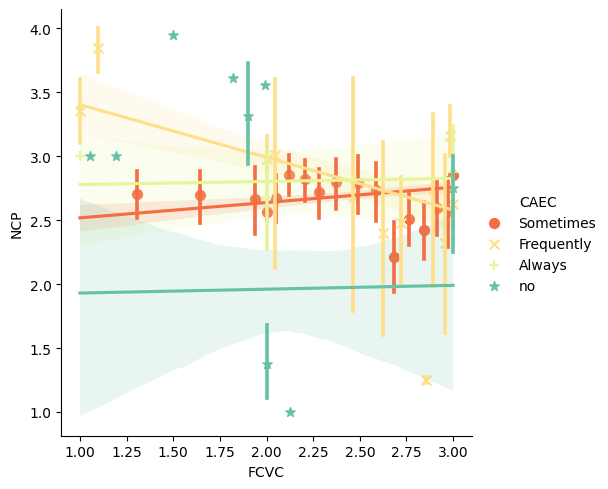

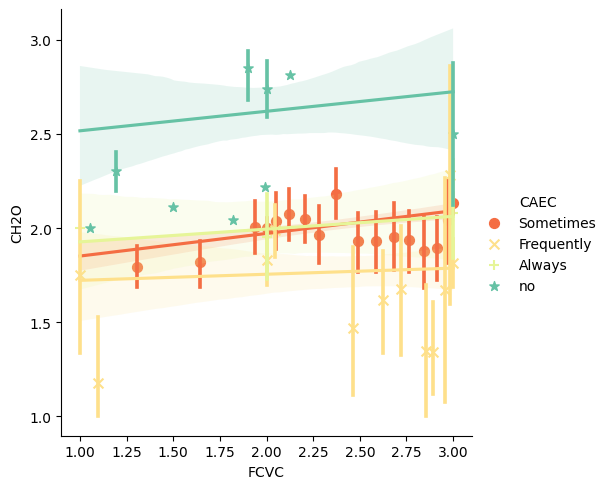

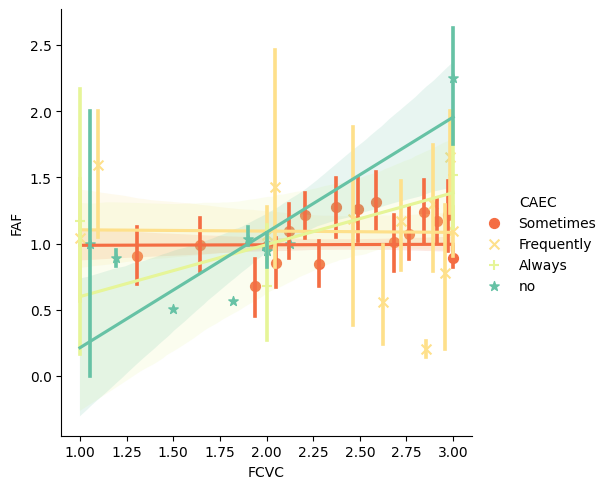

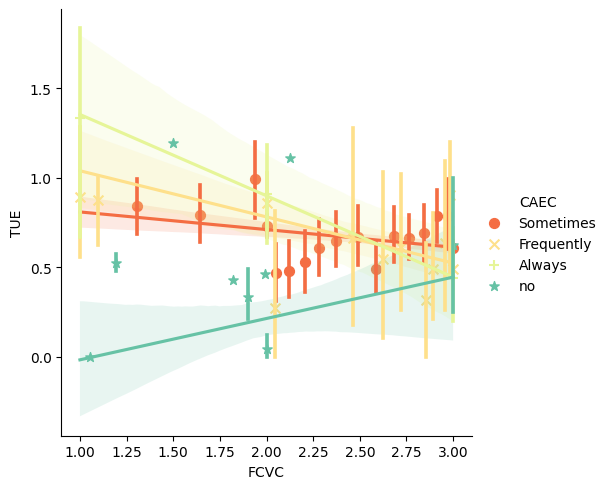

In [70]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="CAEC", data=df, x_bins=35, palette="Spectral", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on CAEC - Consumption of Food Between Meals)
    - Number of Main Meals (NCP)

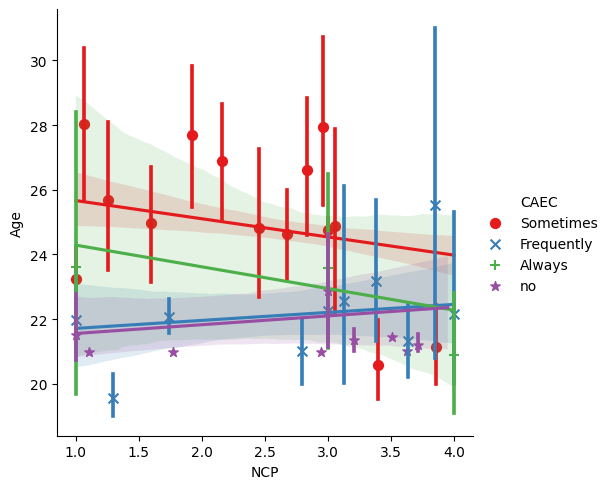

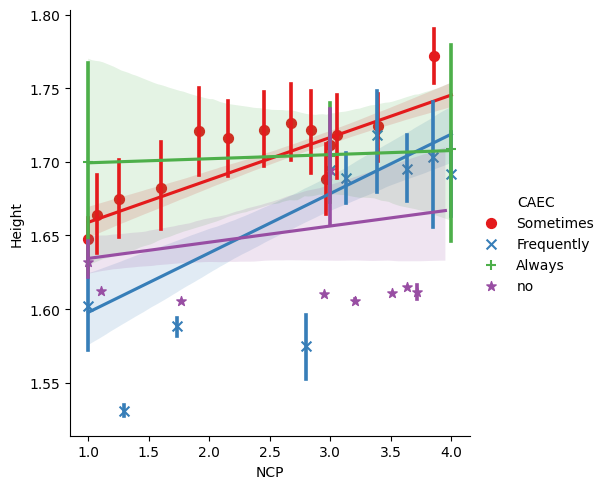

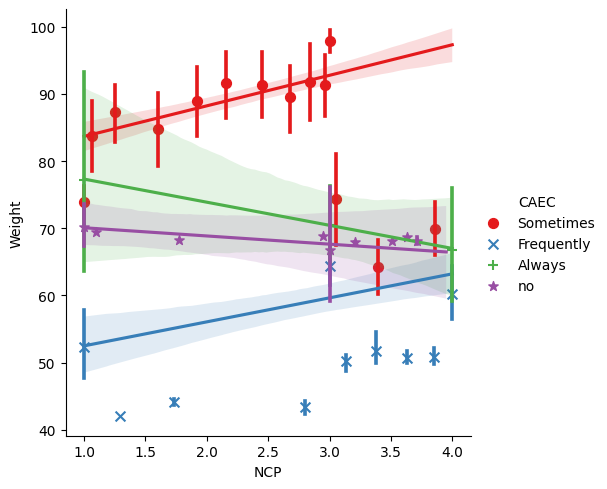

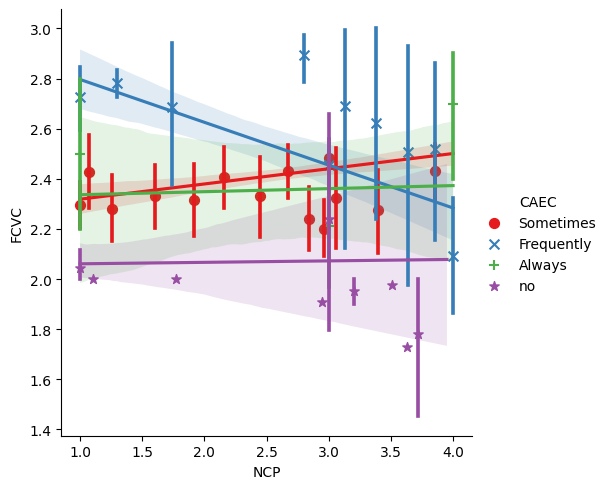

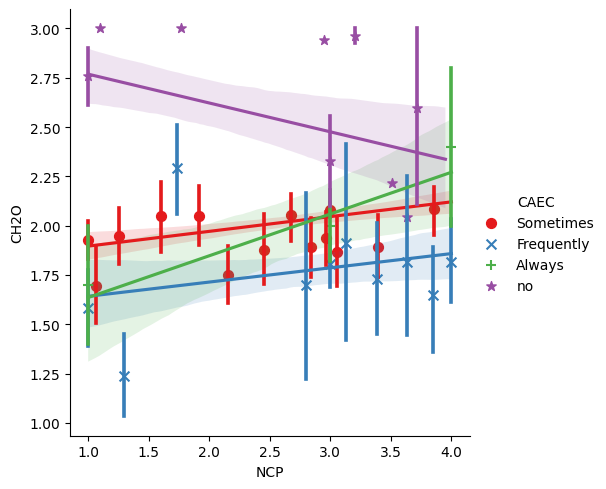

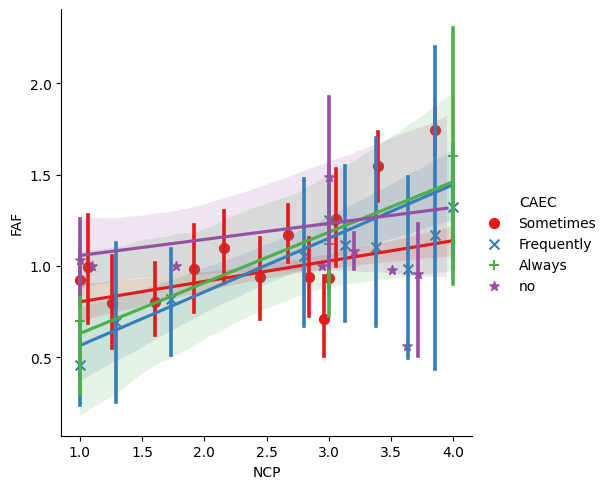

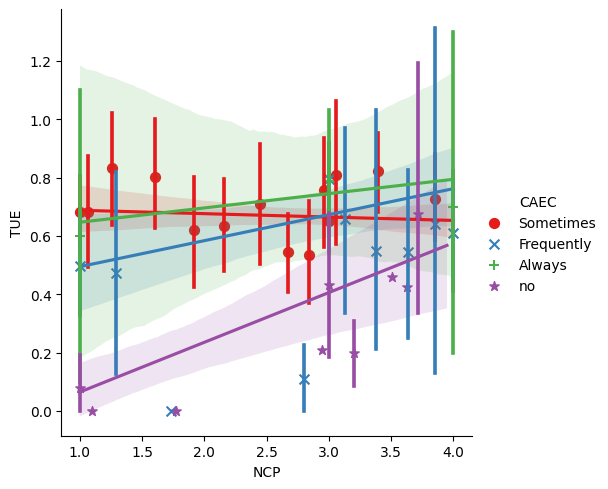

In [35]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="CAEC", data=df, x_bins=35, palette="Set1", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on CAEC - Frequent of Consumption of High Calorific Food)
    - Physical Activity Frequent (FAF)

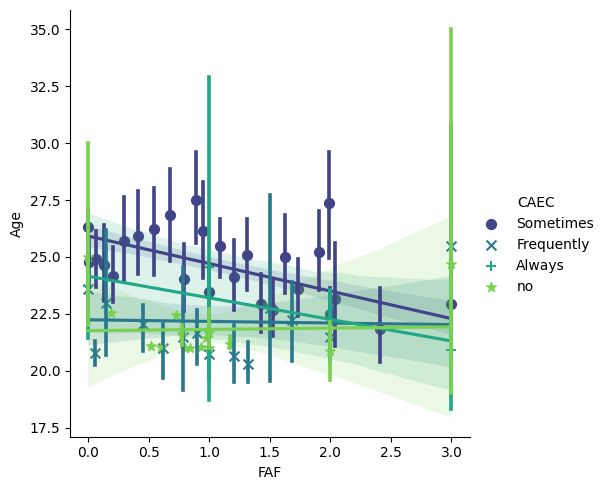

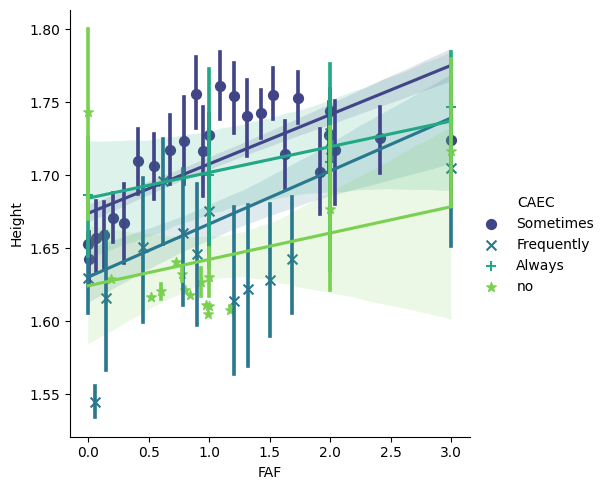

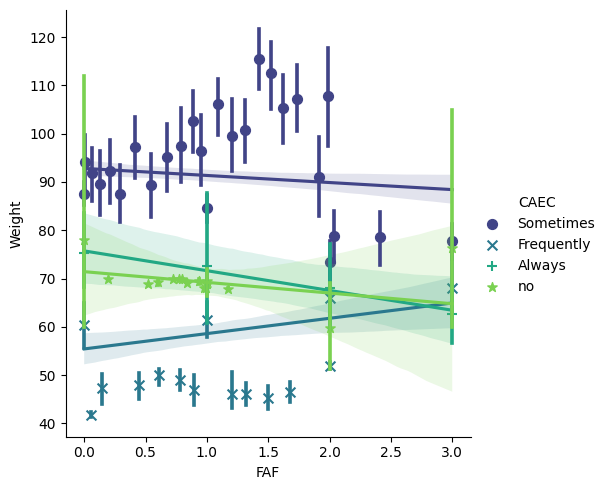

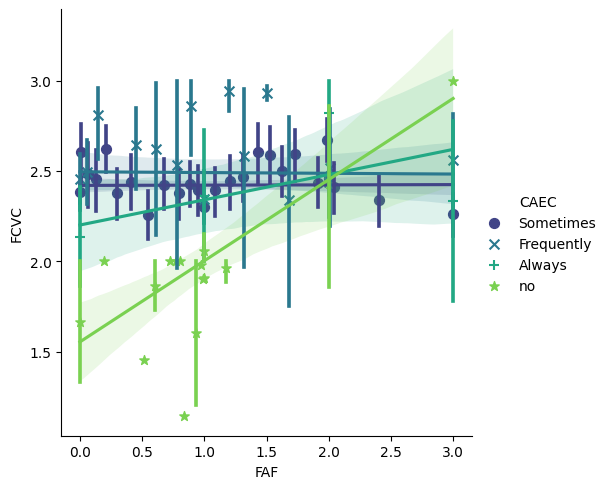

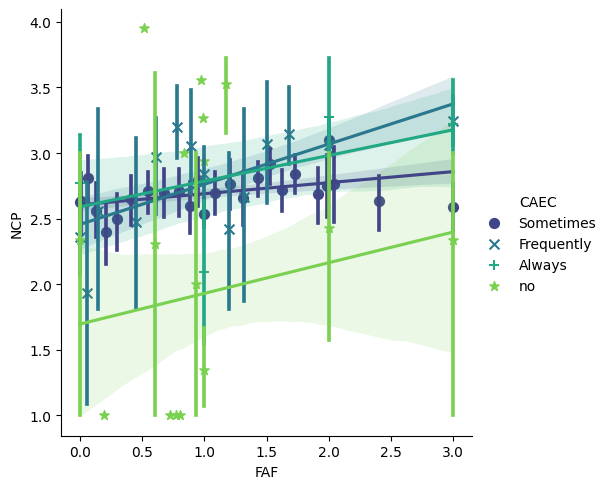

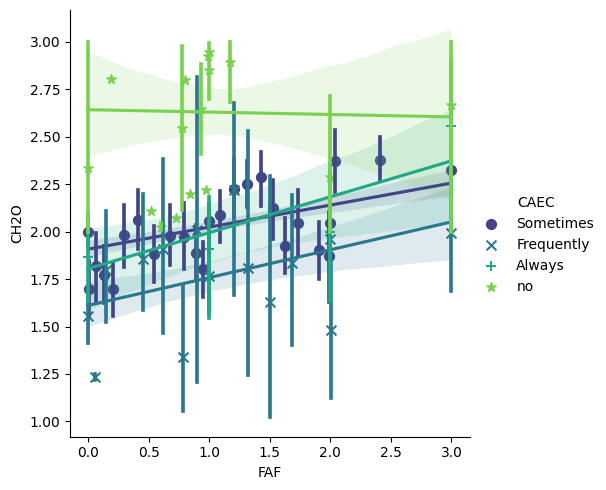

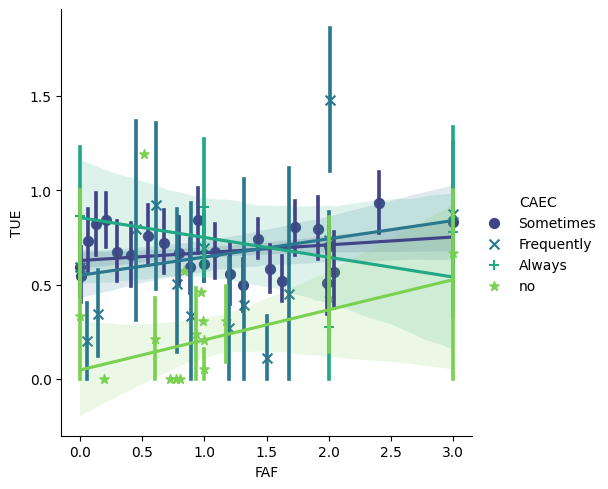

In [36]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="CAEC", data=df, x_bins=35, palette="viridis", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on CAEC - Consumption of Food Between Meals)
    - Time Using Technology Devices (TUE)

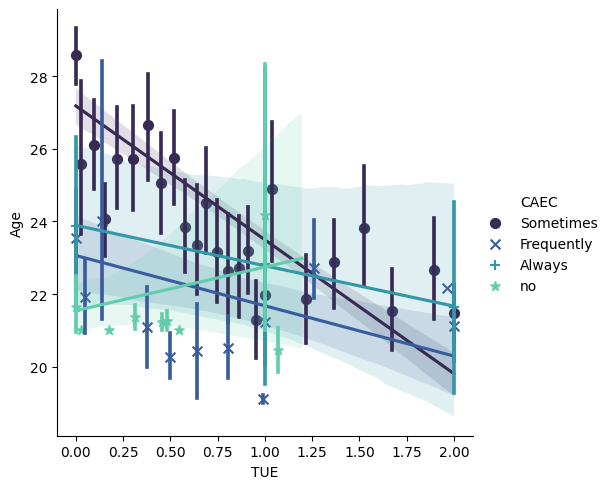

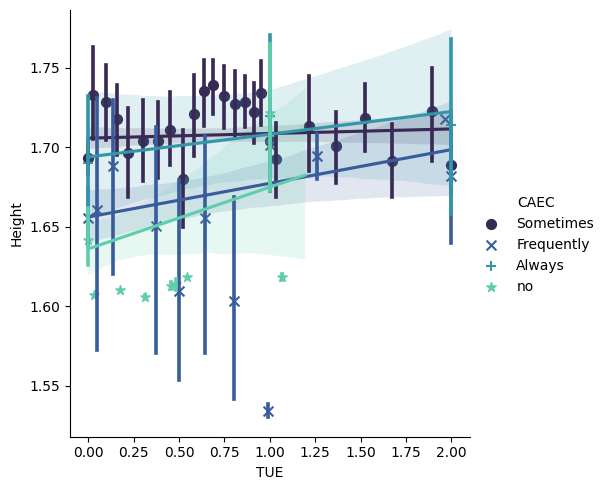

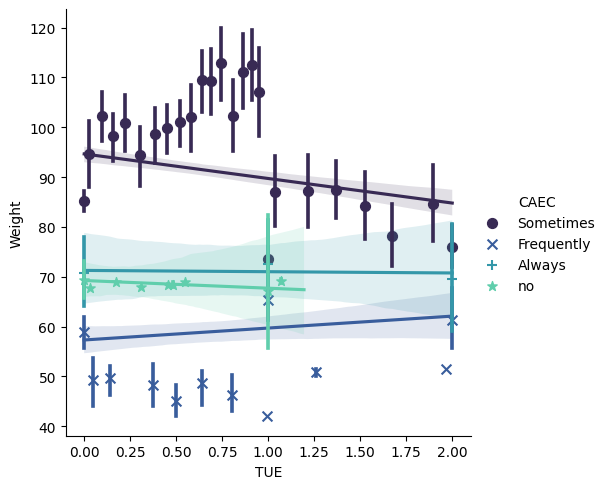

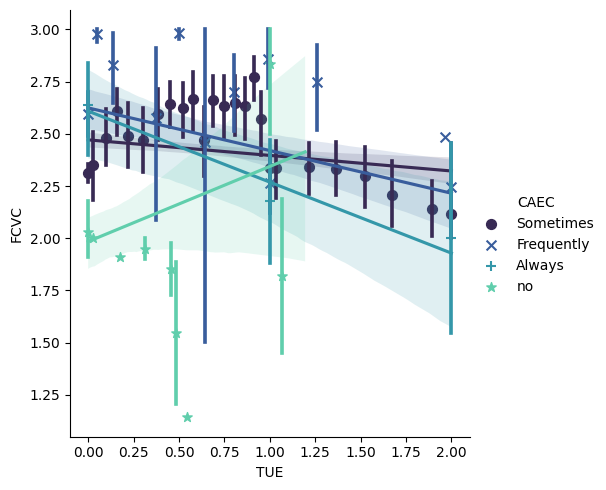

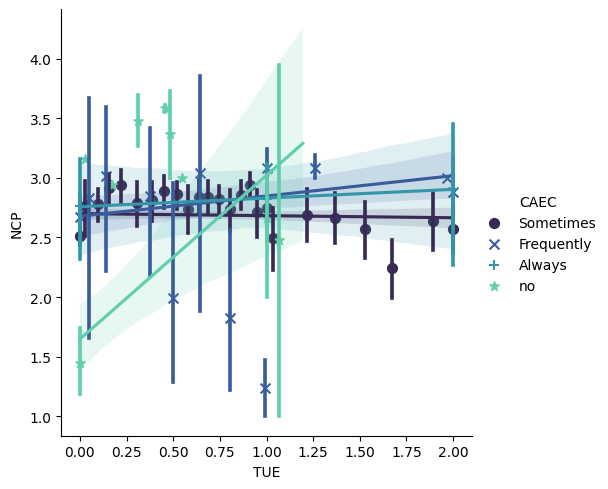

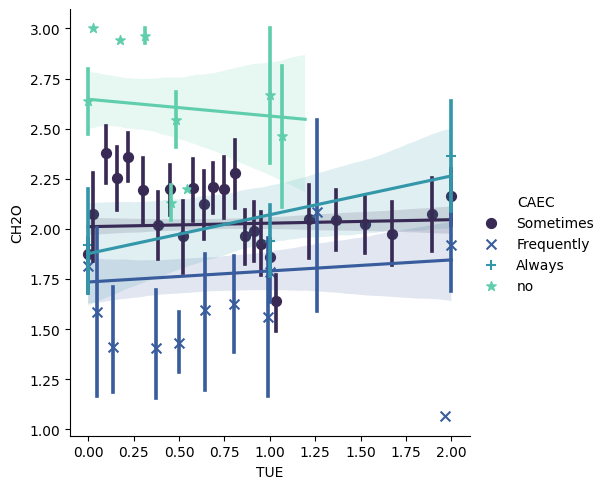

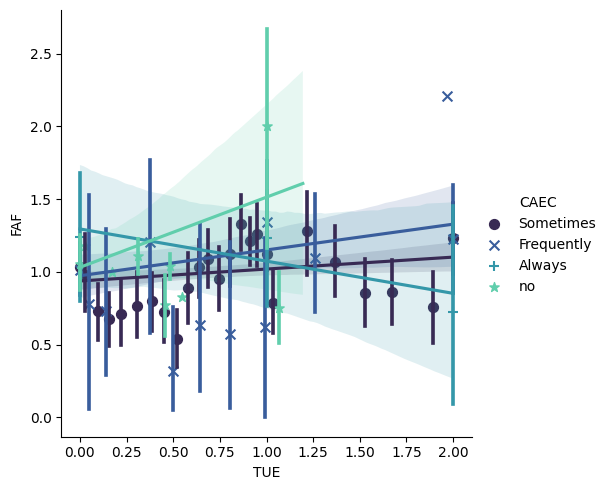

In [37]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="CAEC", data=df, x_bins=35, palette="mako", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on SMOKE)
    - Weight

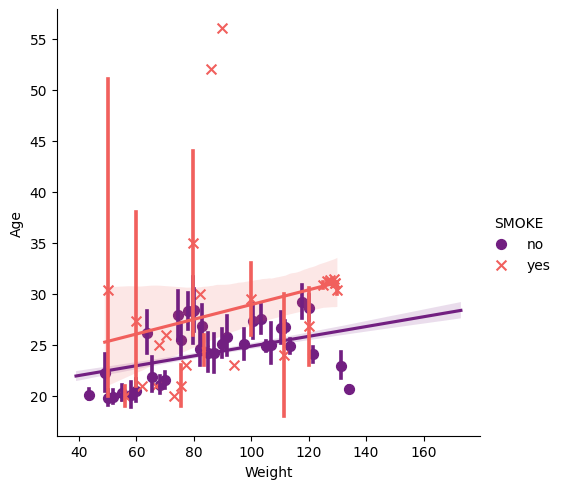

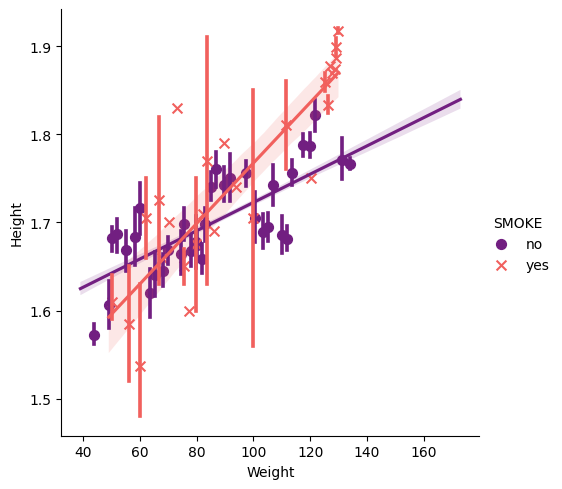

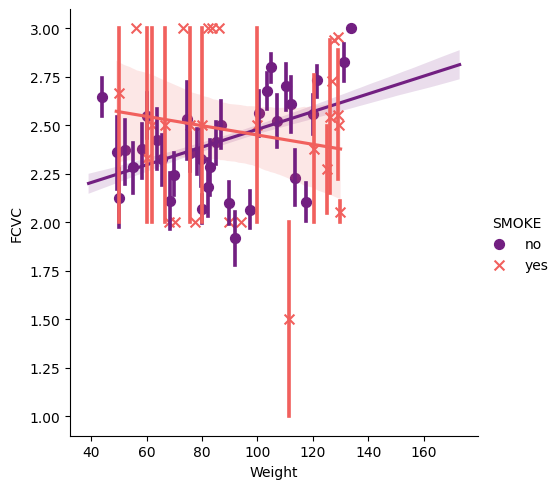

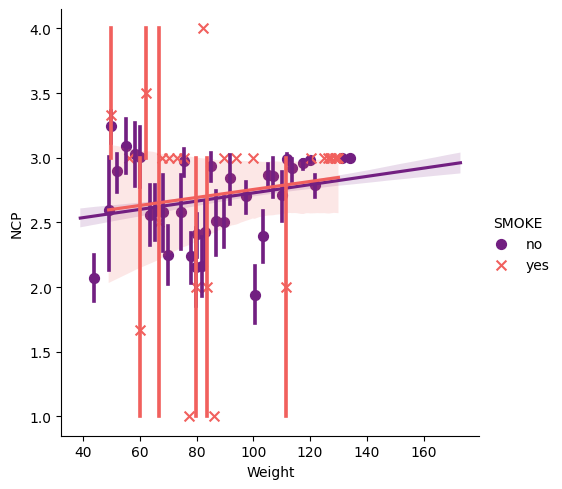

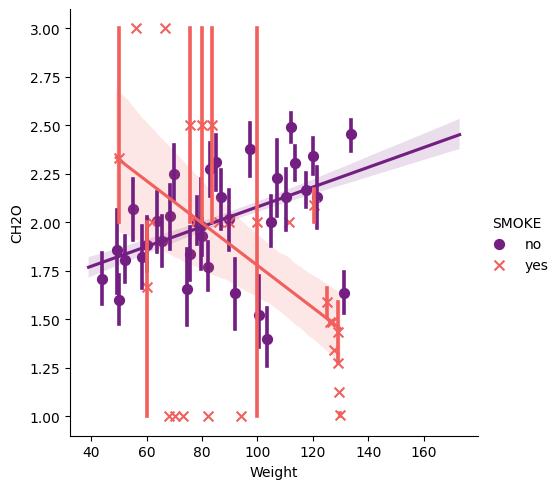

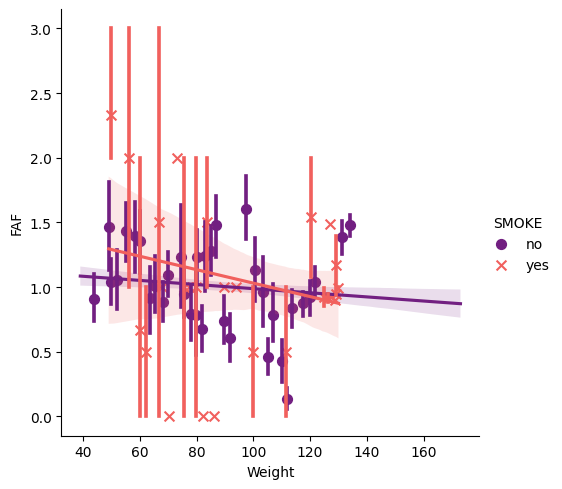

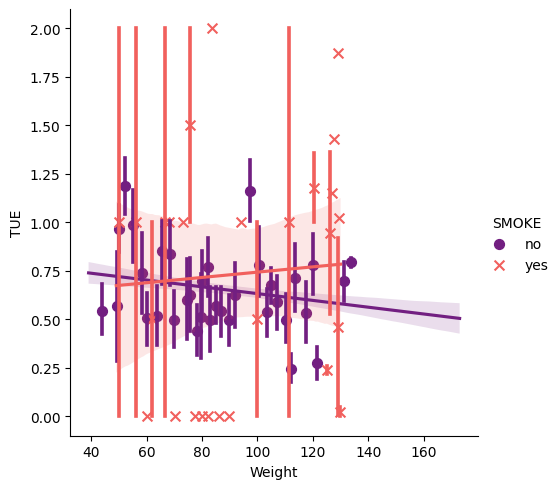

In [38]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="SMOKE", data=df, x_bins=35, palette="magma", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SMOKE)
    - Frequency of Consumption of Vegetables (FCVC)

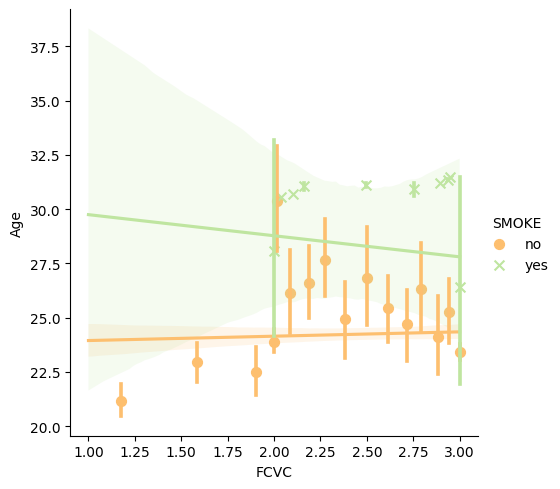

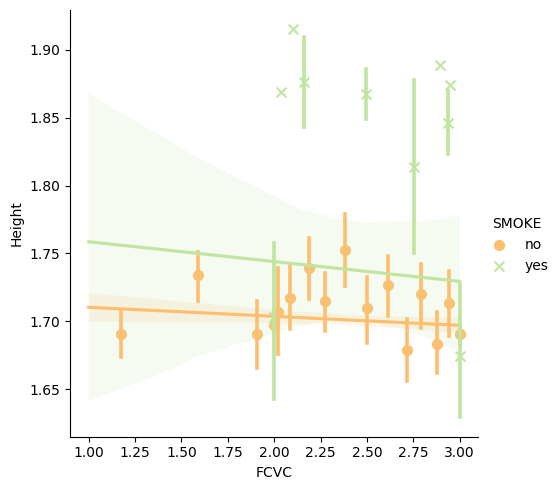

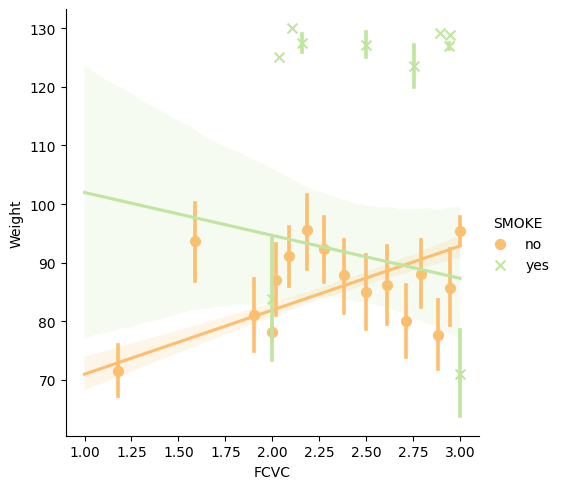

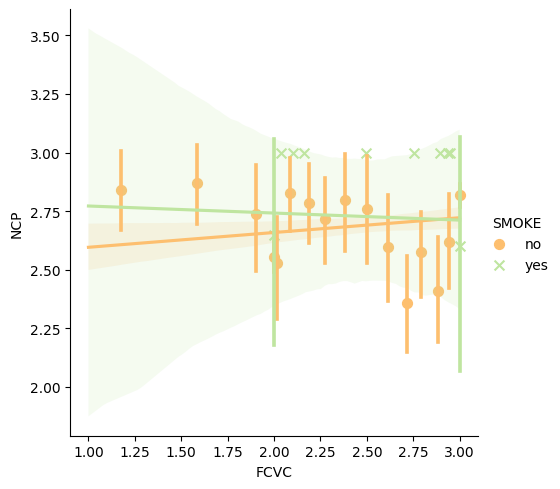

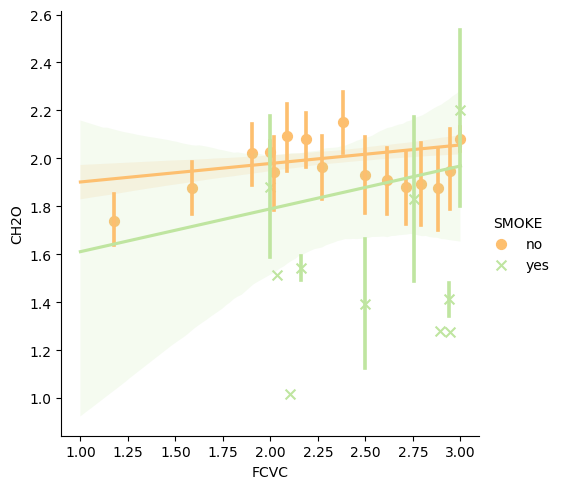

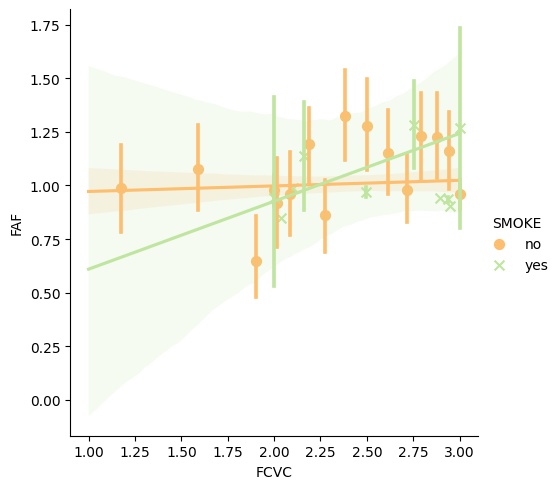

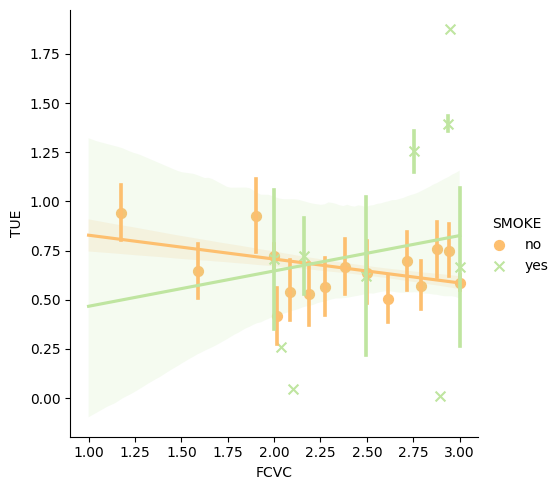

In [71]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="SMOKE", data=df, x_bins=35, palette="Spectral", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SMOKE)
    - Number of Main Meals (NCP)

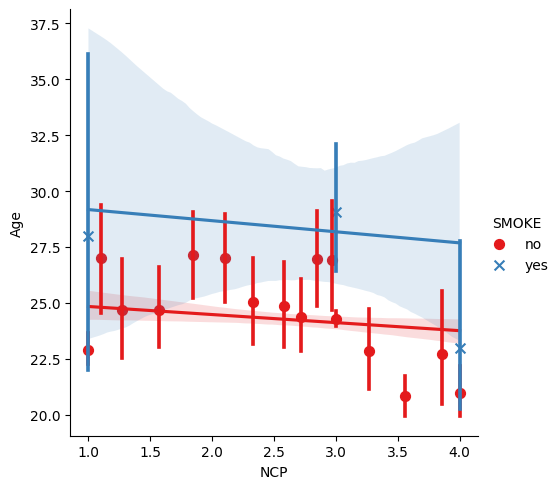

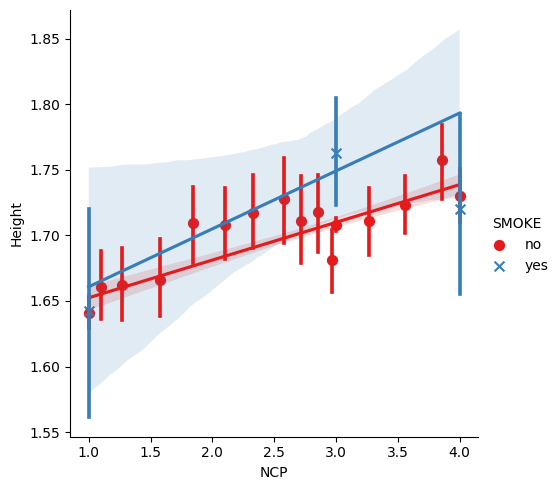

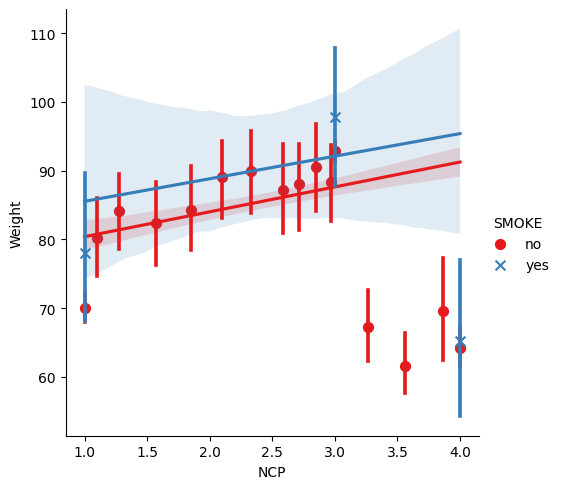

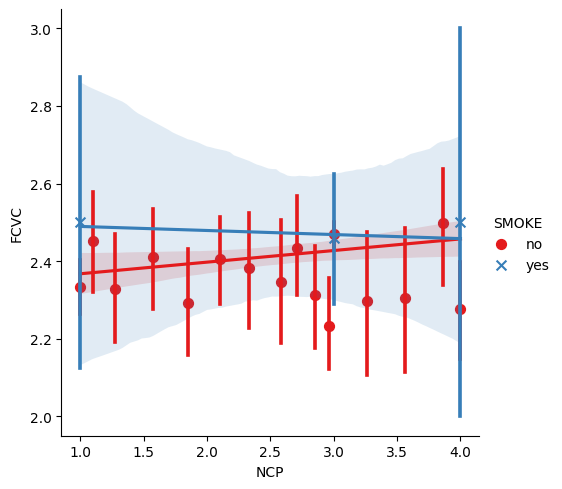

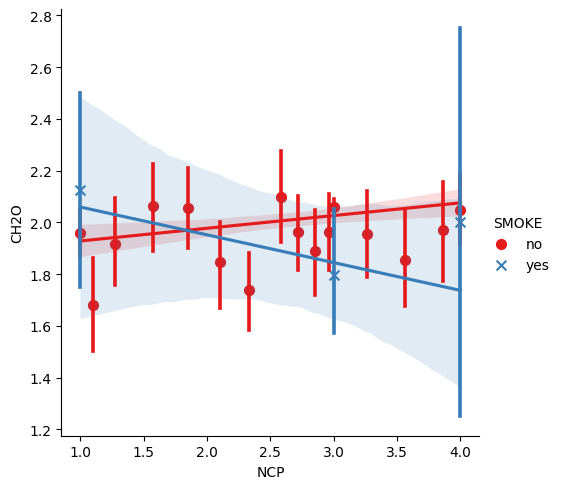

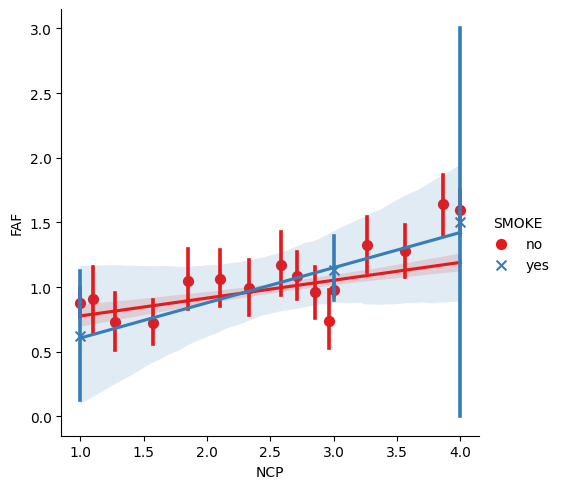

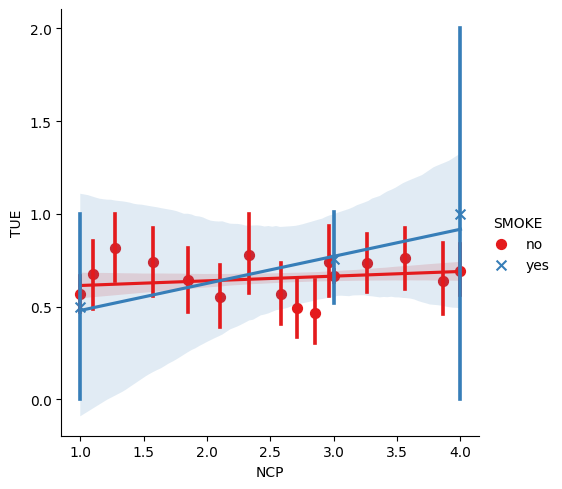

In [73]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="SMOKE", data=df, x_bins=45, palette="Set1", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SMOKE)
    - Physical Activity Frequency (FAF)

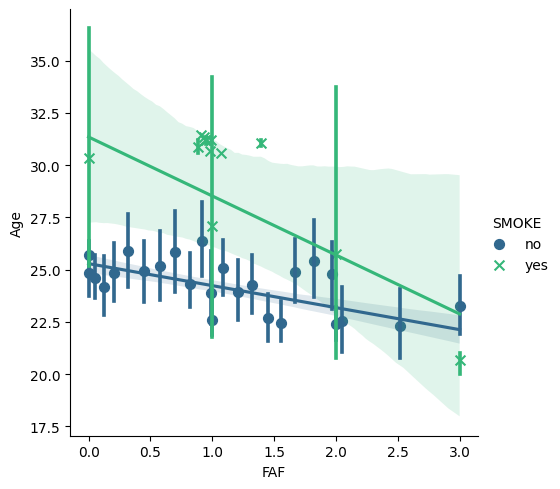

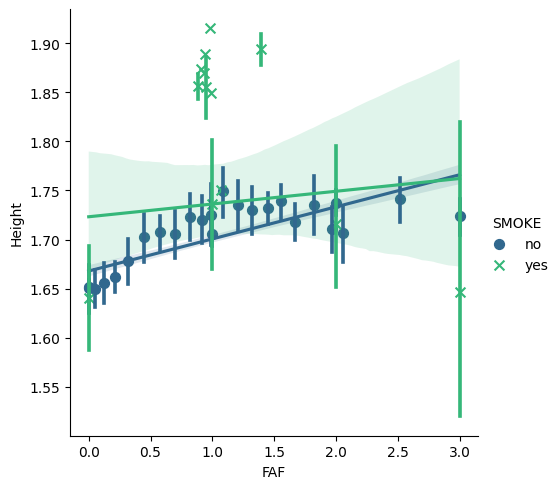

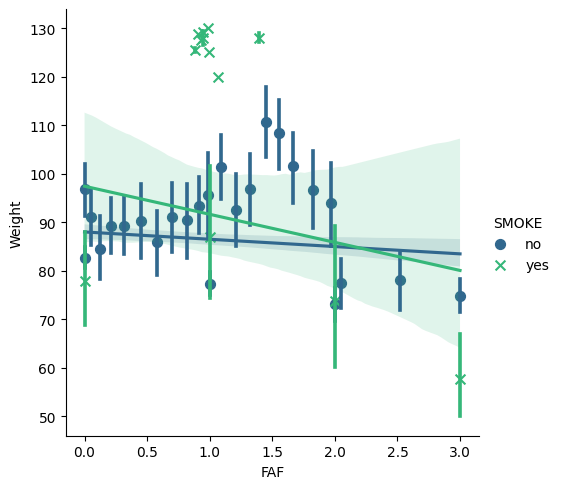

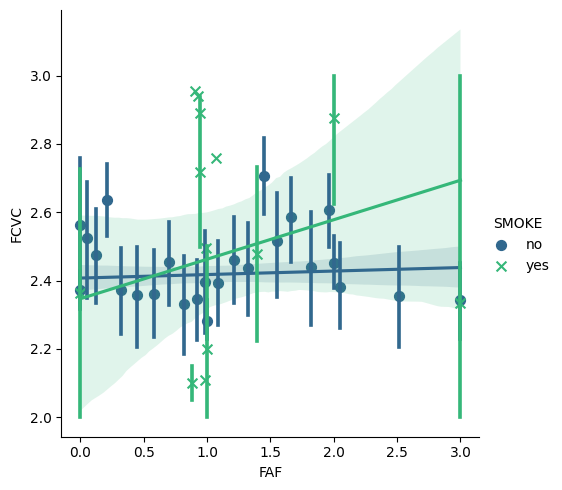

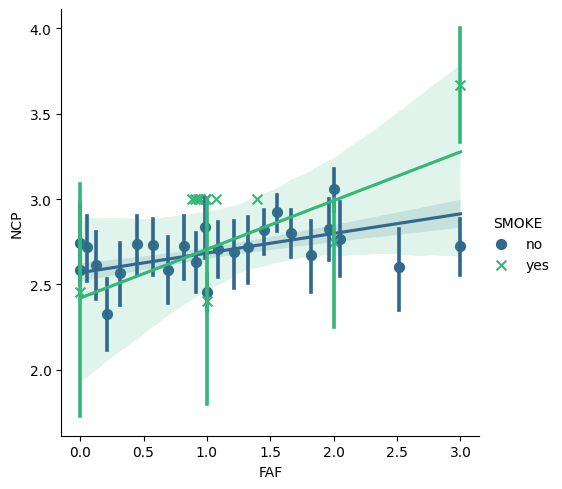

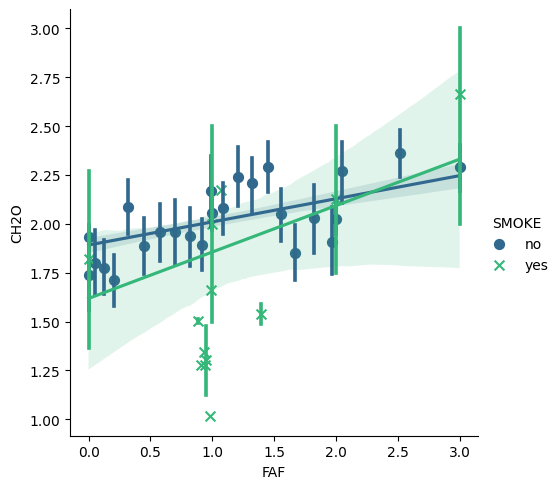

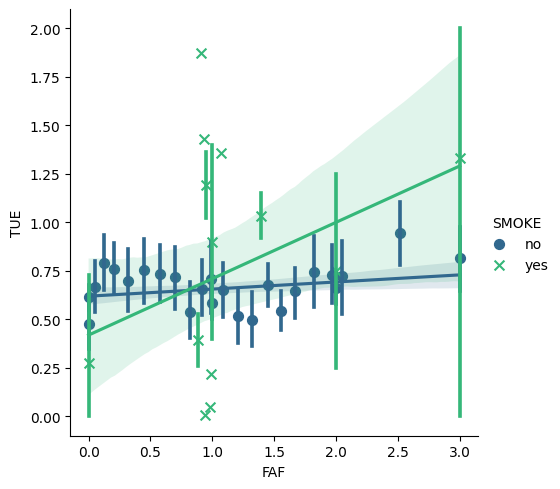

In [41]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="SMOKE", data=df, x_bins=35, palette="viridis", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SMOKE)
    - Time Using Technology Devices (TUE)

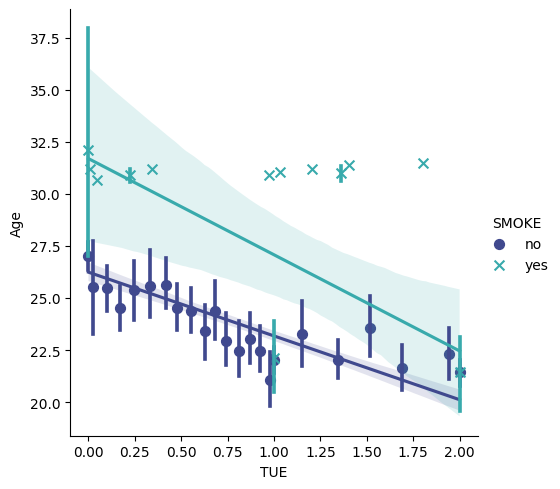

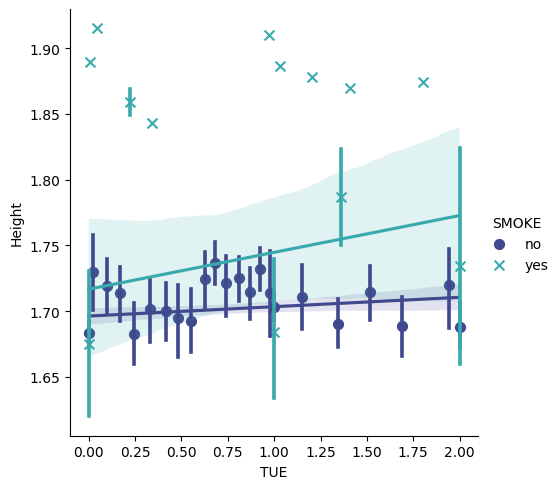

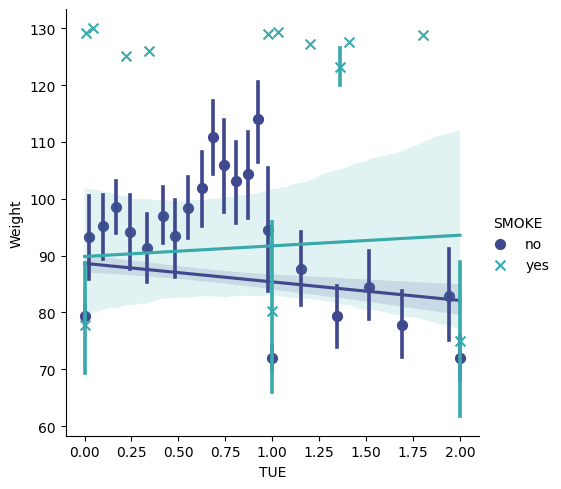

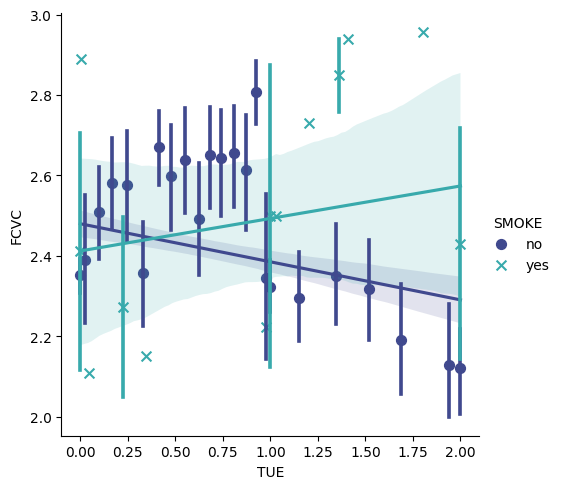

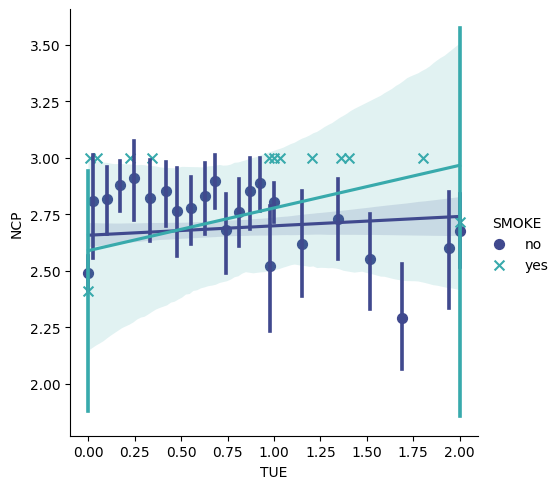

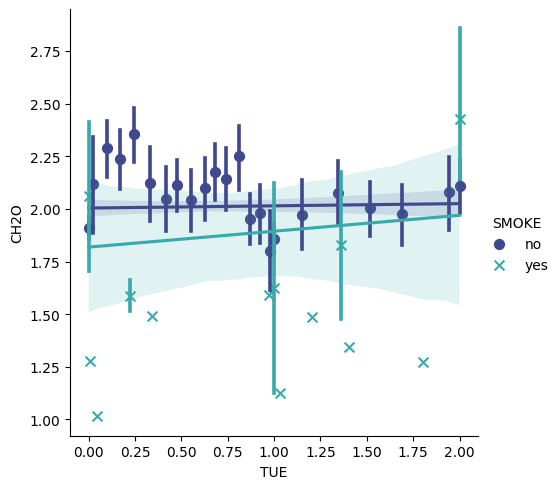

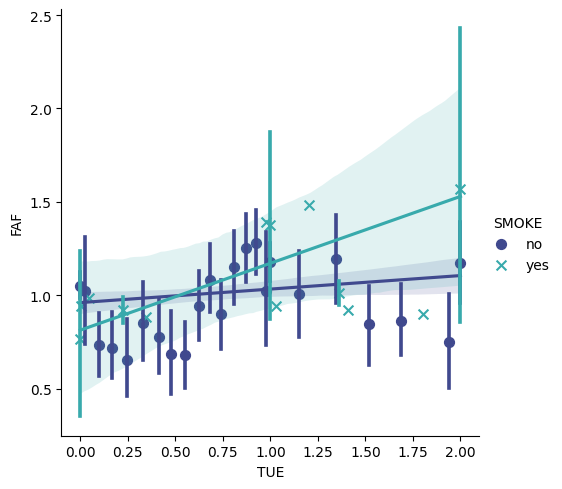

In [42]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="SMOKE", data=df, x_bins=35, palette="mako", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SCC - Monitoring Calories Consumed)
    - Weight

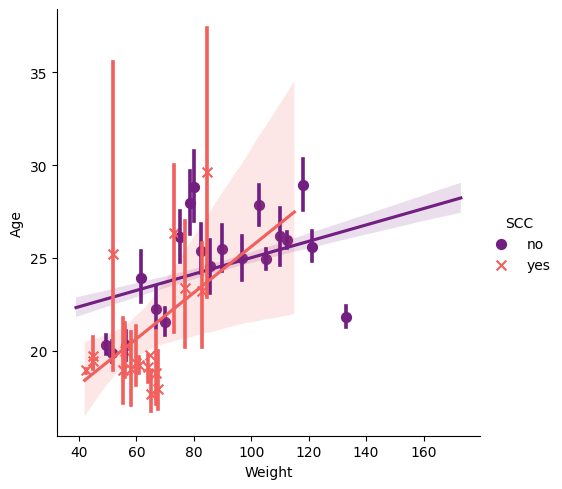

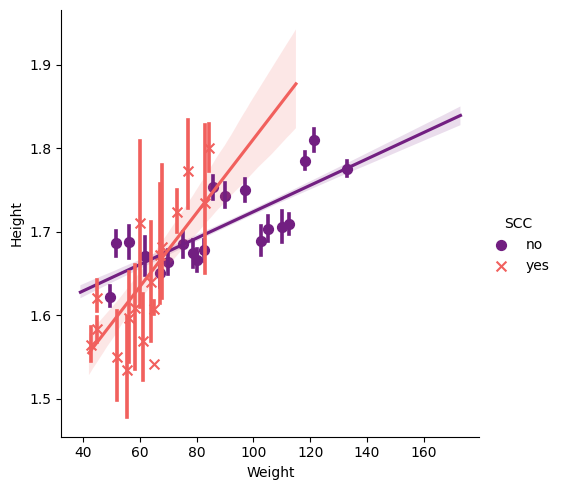

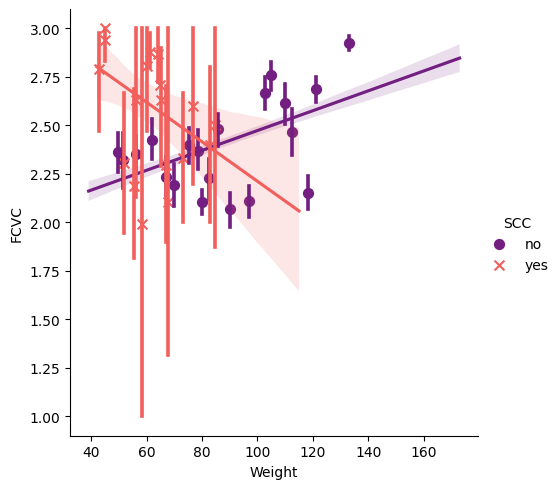

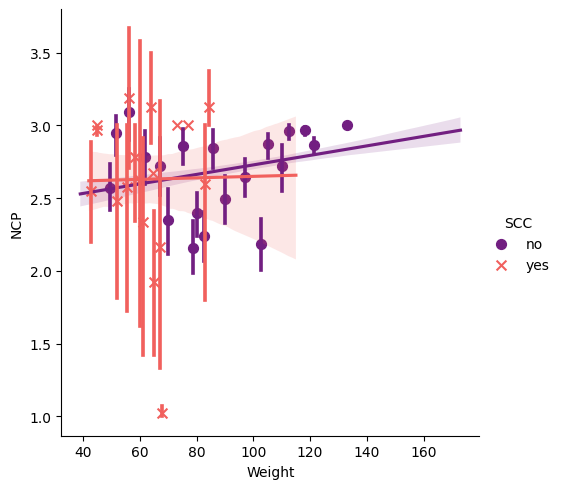

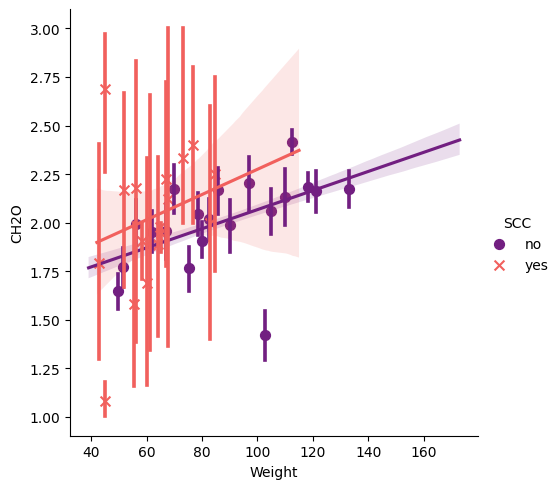

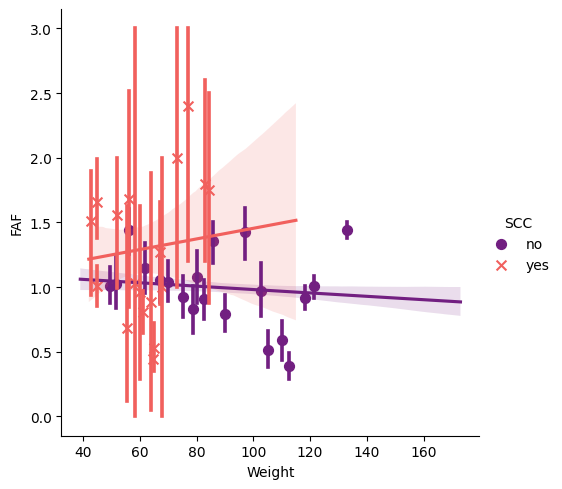

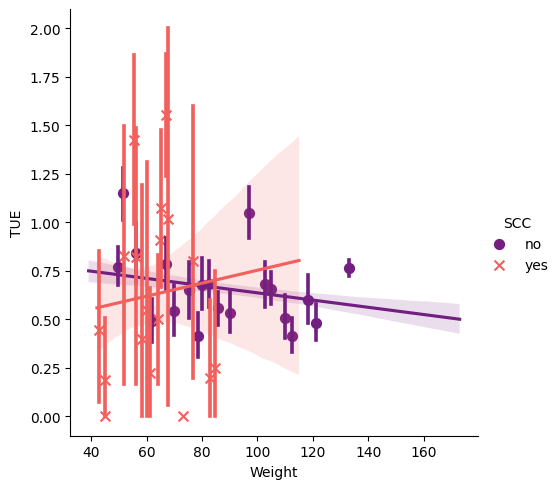

In [43]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="SCC", data=df, x_bins=20, palette="magma", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SCC - Monitoring Calories Consumed)
    - Frequency of Consumption of Vegetables (FCVC)

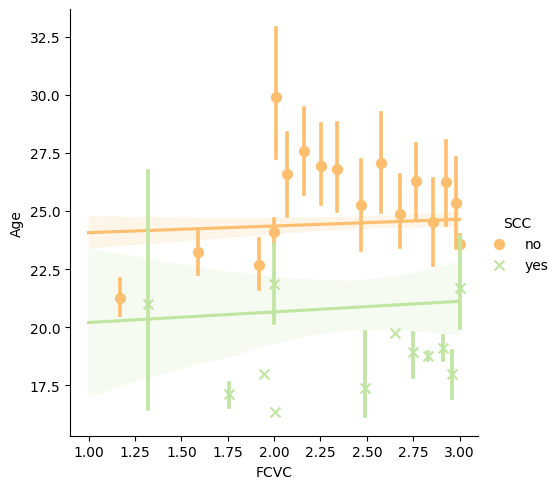

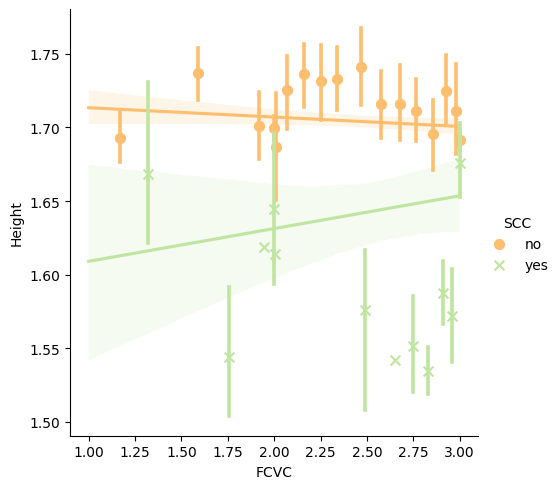

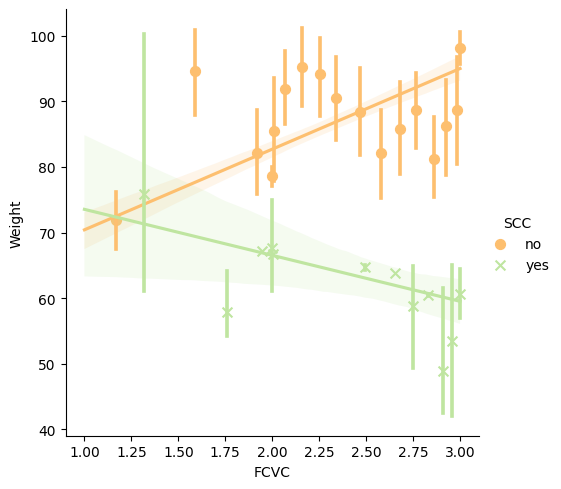

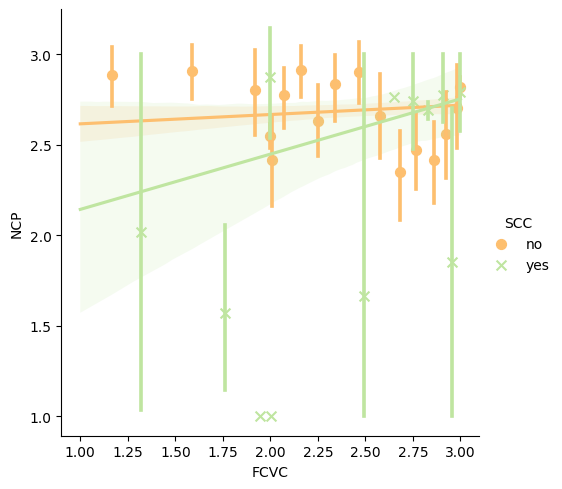

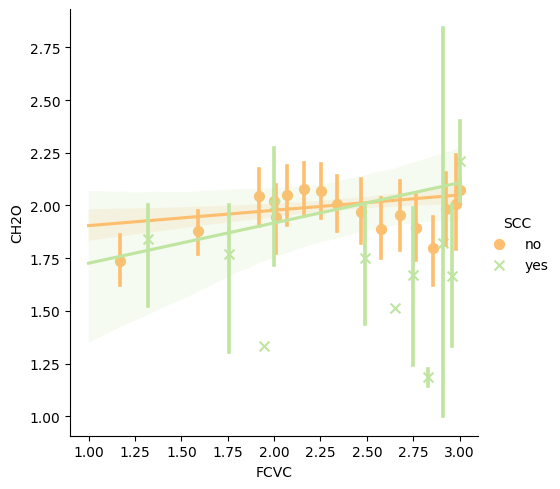

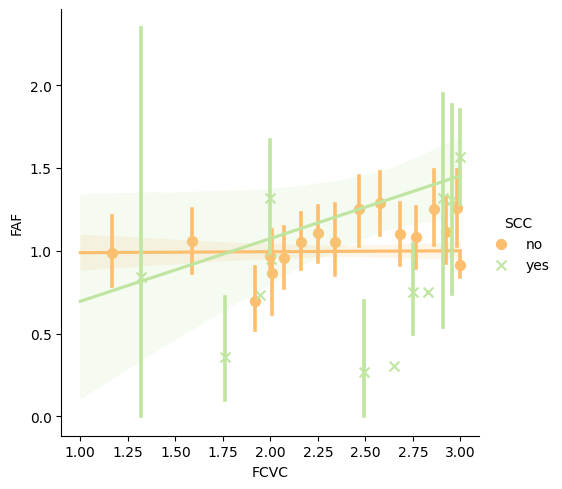

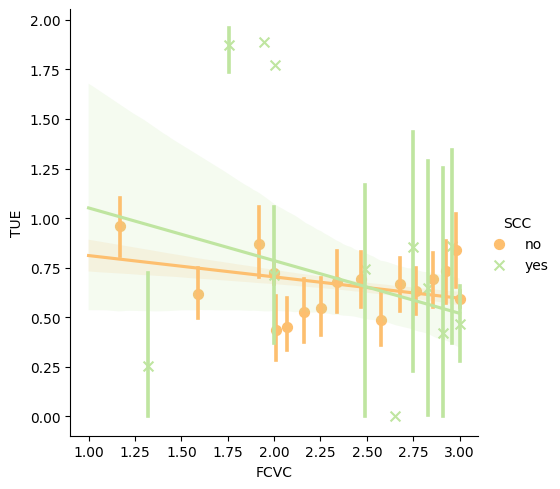

In [74]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="SCC", data=df, x_bins=35, palette="Spectral", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SCC - Monitoring Calories Consumed)
    - Number of Main Meals (NCP)

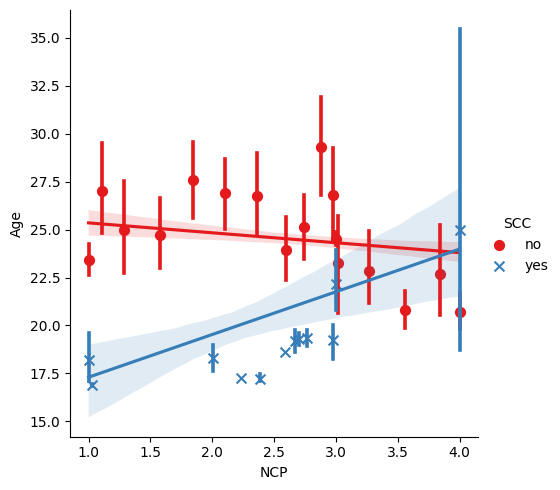

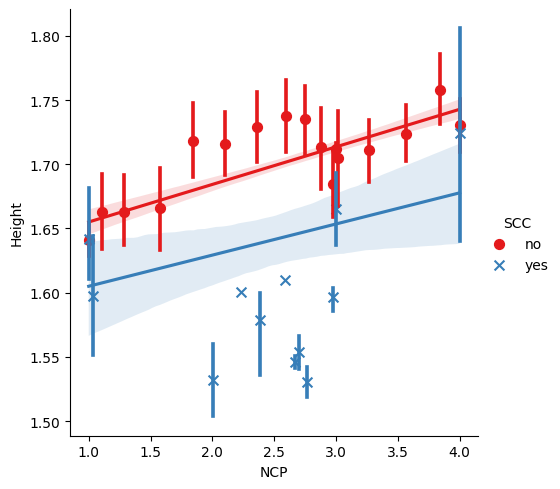

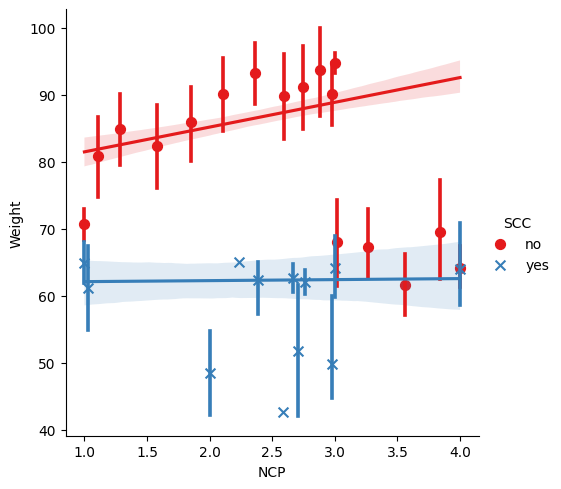

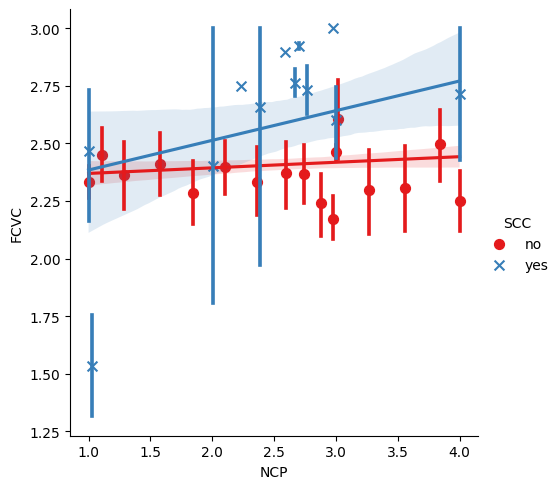

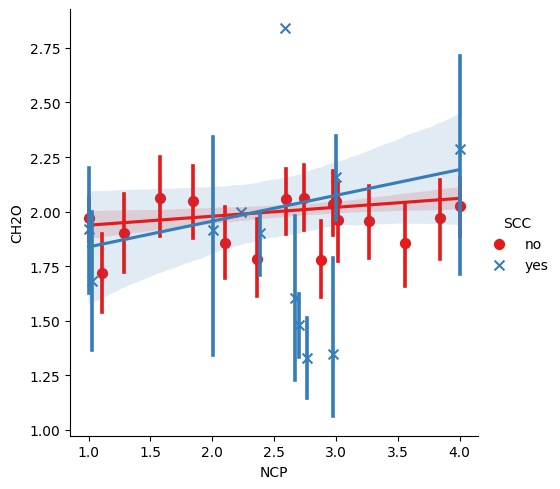

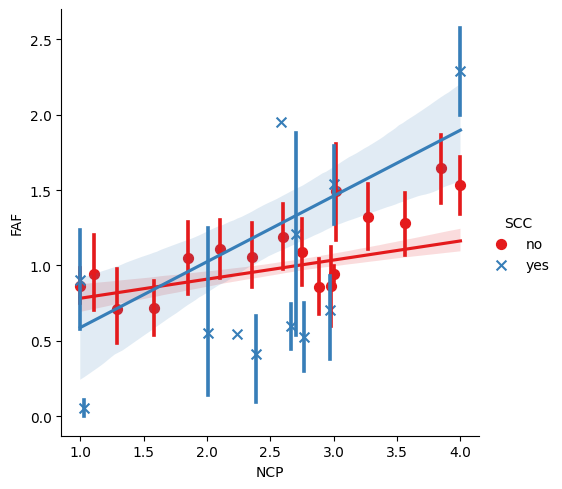

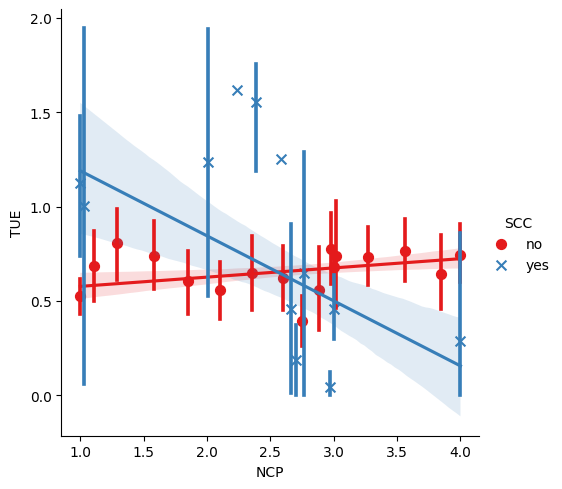

In [75]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="SCC", data=df, x_bins=45, palette="Set1", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SCC - Frequent of Consumption of High Calorific Food)
    - Physical Activity Frequent (FAF)

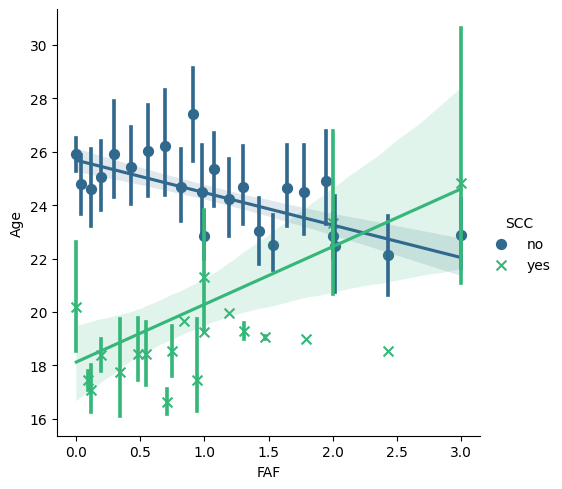

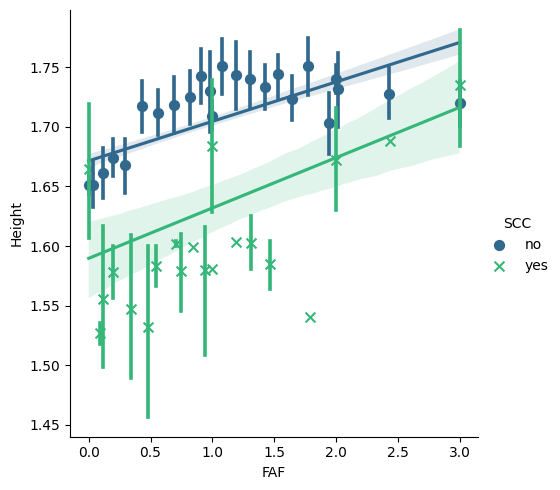

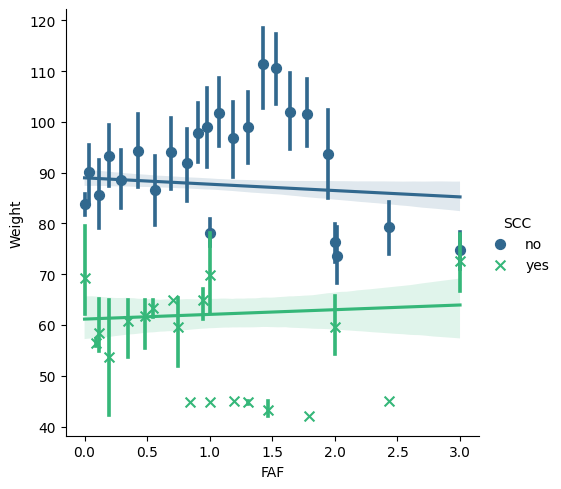

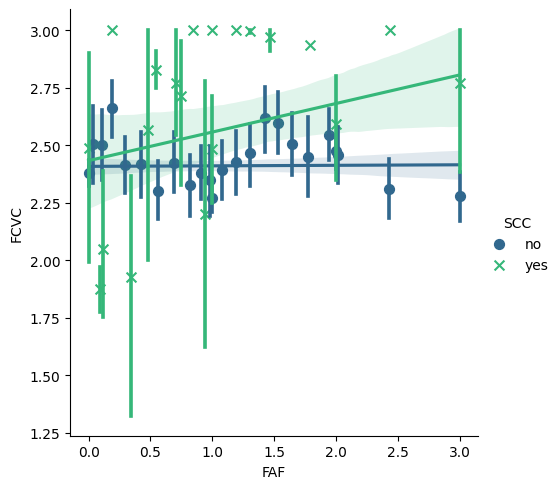

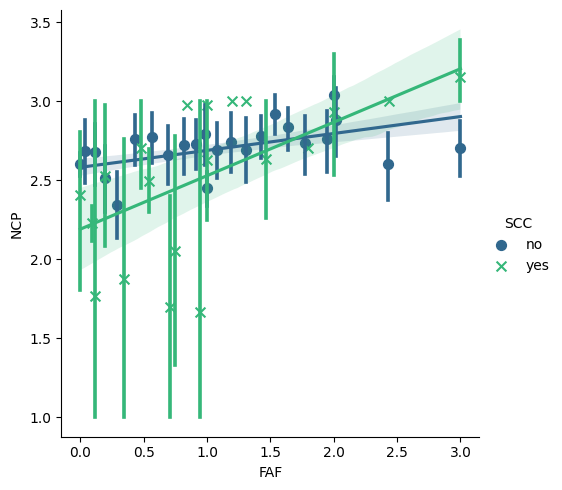

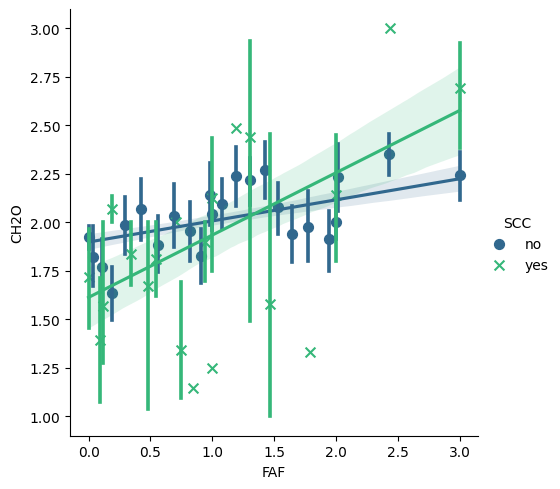

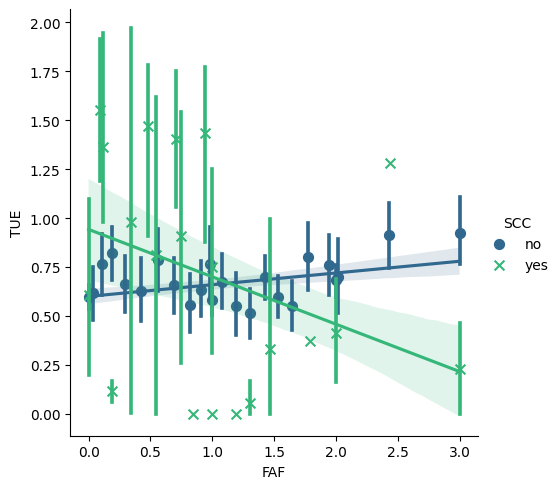

In [46]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="SCC", data=df, x_bins=35, palette="viridis", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on SCC - Monitoring Calories Consumed)
    - Time Using Technology Devices (TUE)

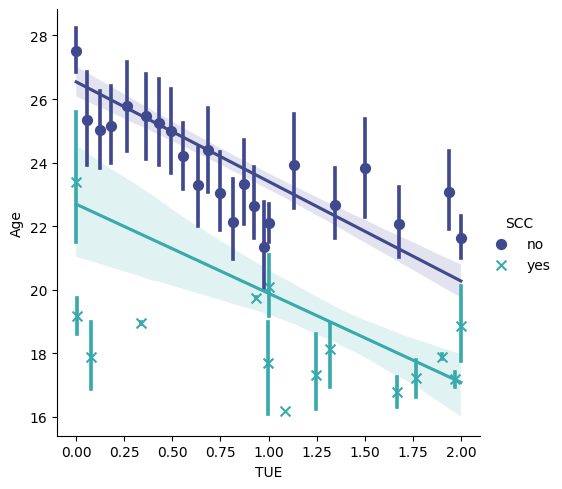

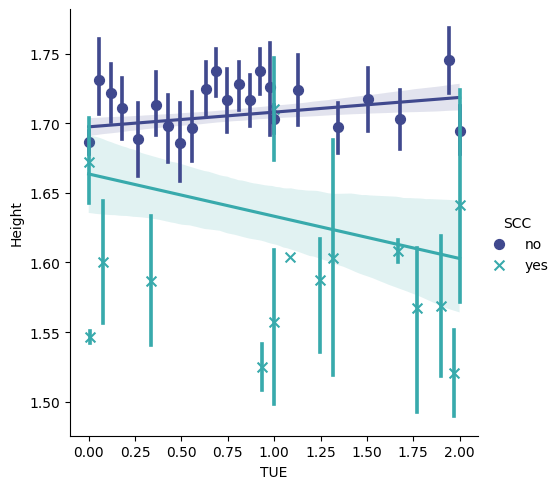

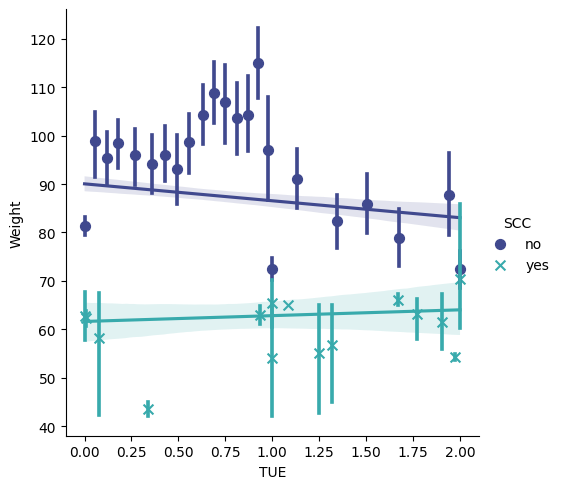

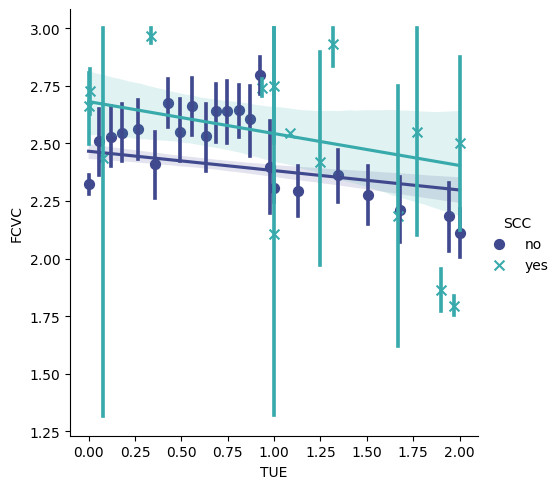

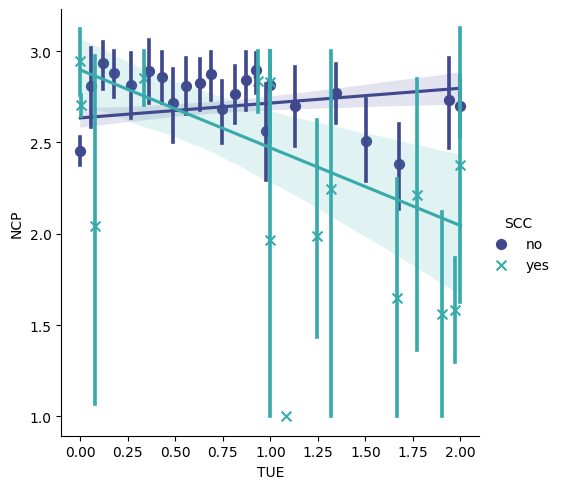

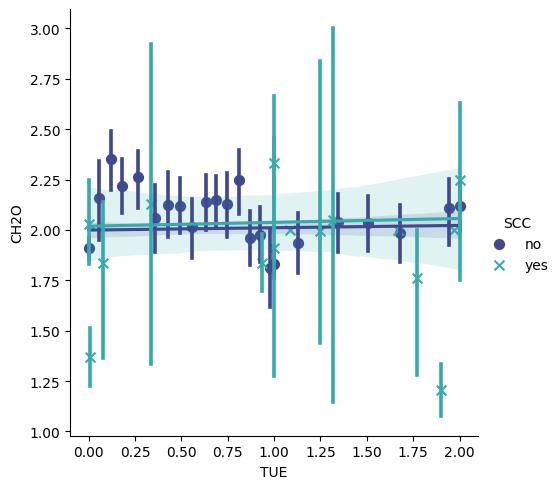

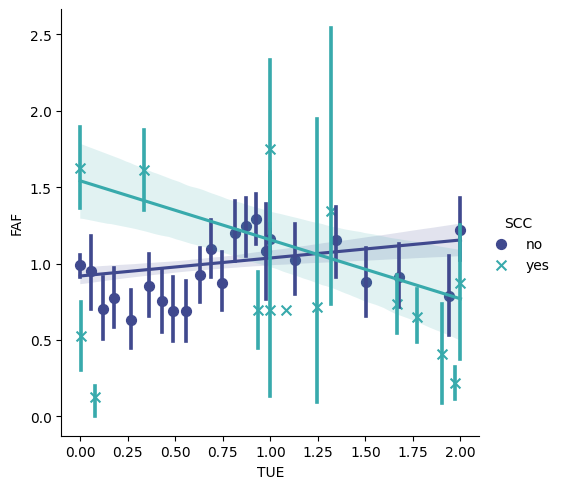

In [47]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="SCC", data=df, x_bins=35, palette="mako", markers=["o", "x"])
    plt.show()

- Linear Regression (Based on CALC - Consumption of Alcohol)
    - Weight

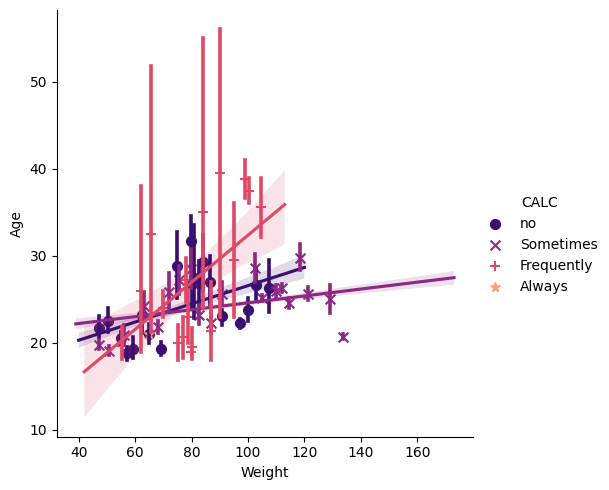

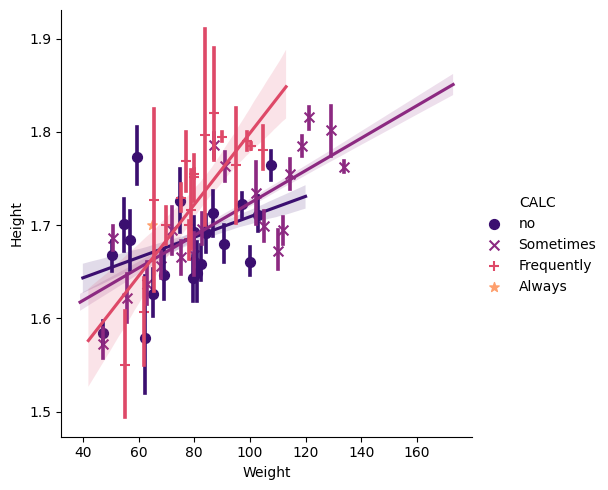

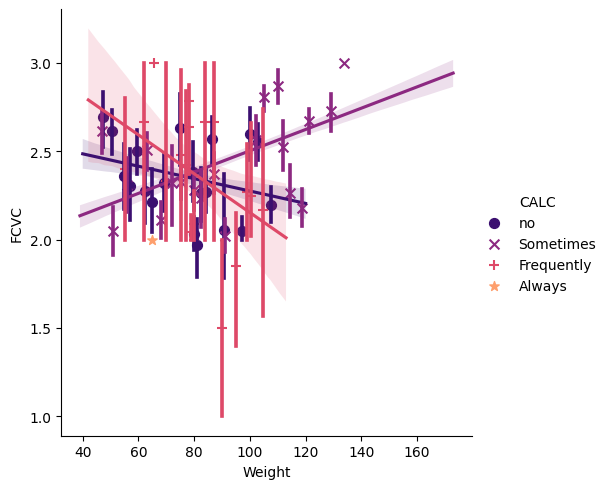

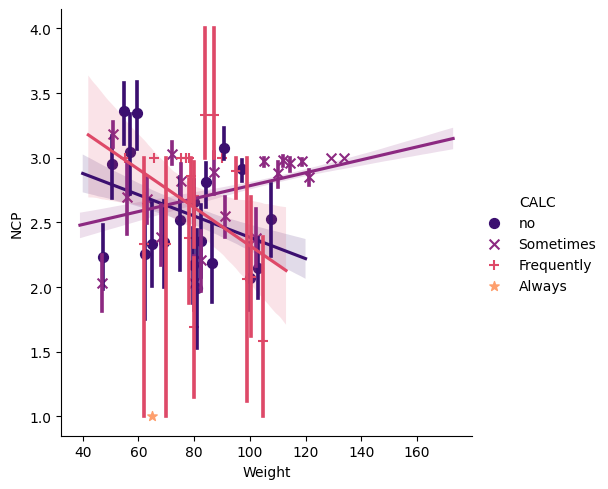

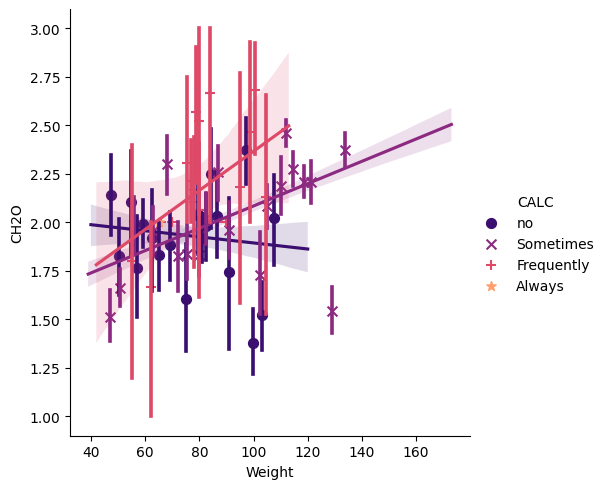

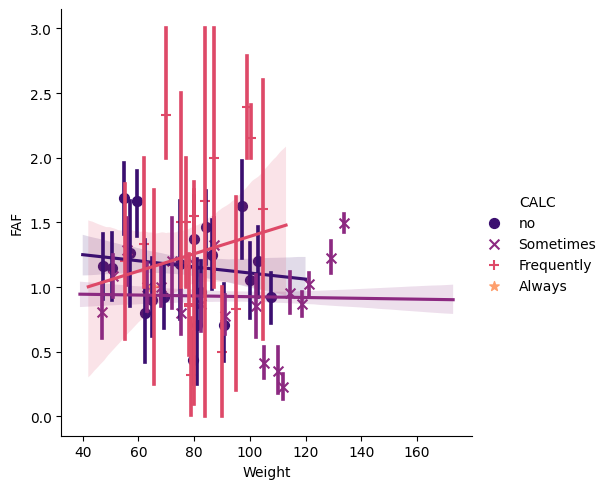

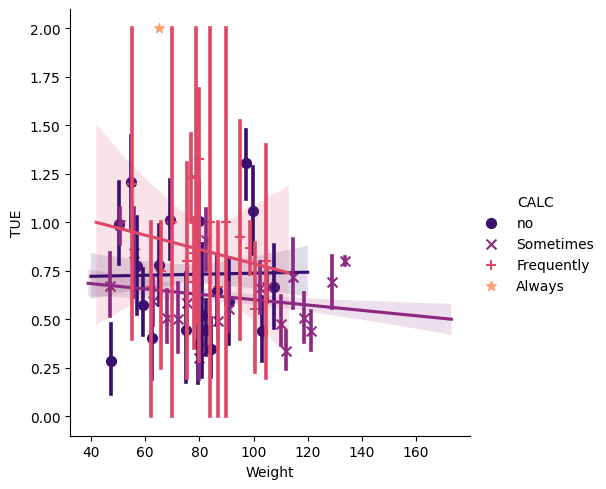

In [48]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="CALC", data=df, x_bins=20, palette="magma", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on CALC - Consumption of Alcohol)
    - Frequency of Consumption of Vegetables (FCVC)

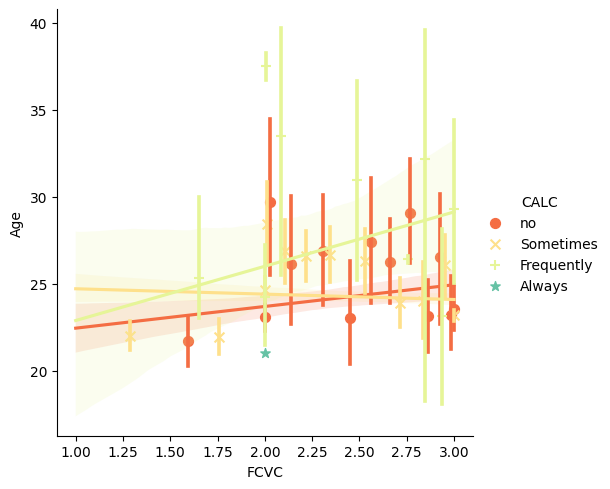

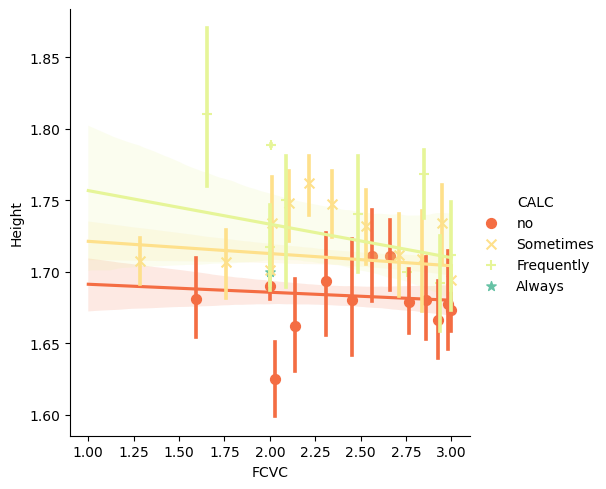

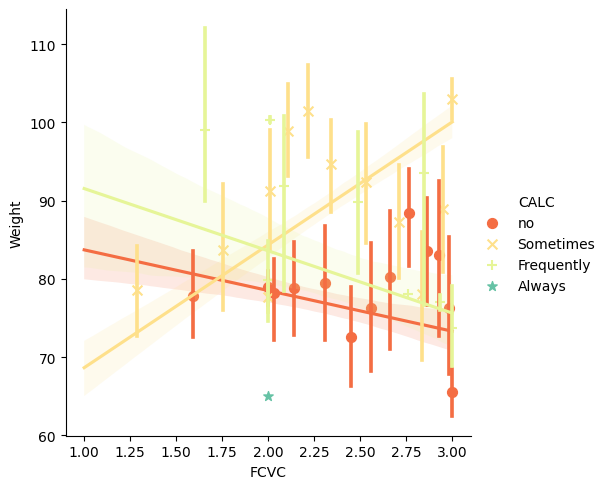

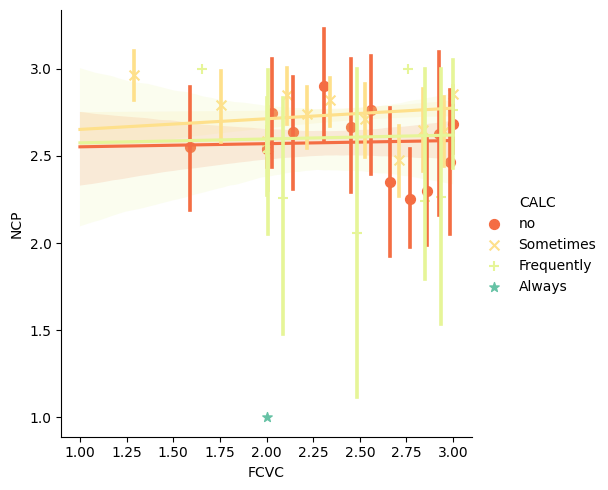

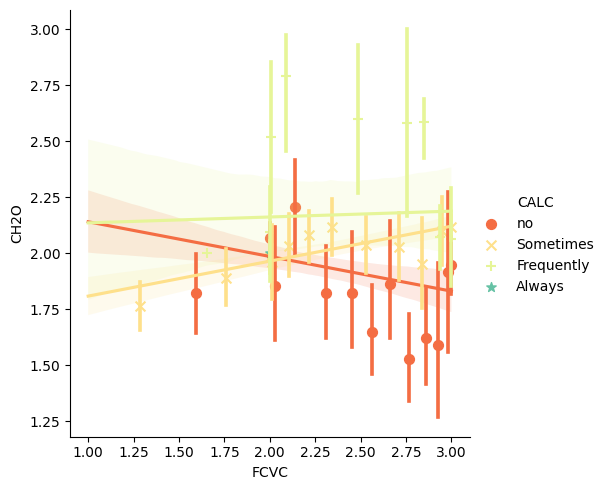

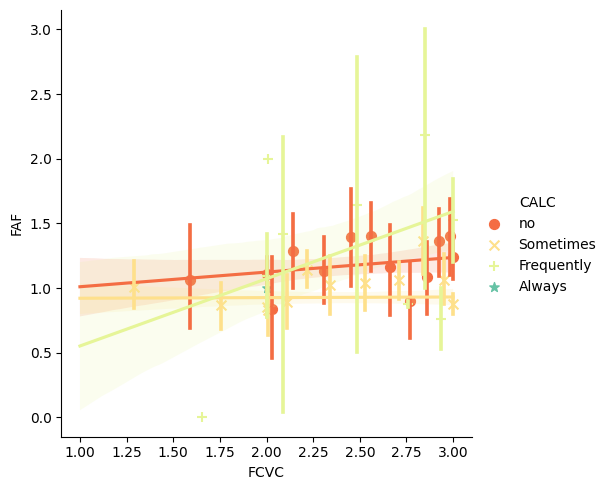

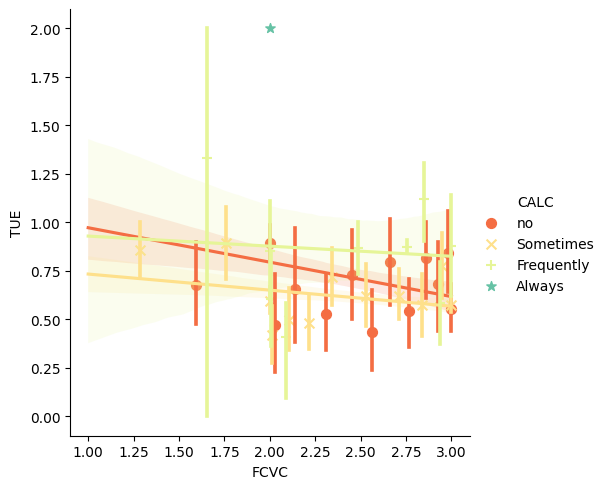

In [76]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="CALC", data=df, x_bins=25, palette="Spectral", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on CALC - Consumption of Alcohol)
    - Number of Main Meals (NCP)

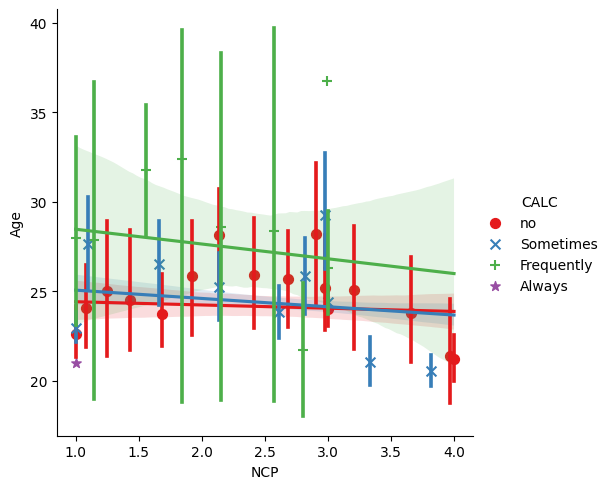

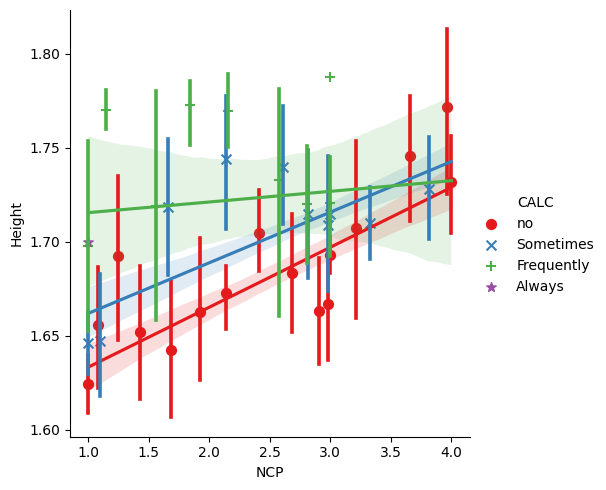

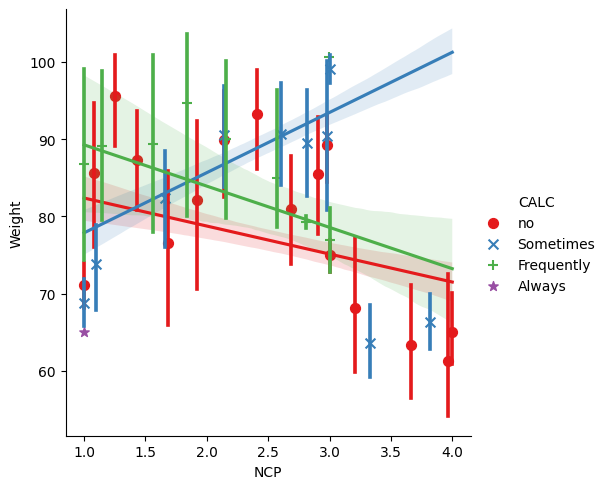

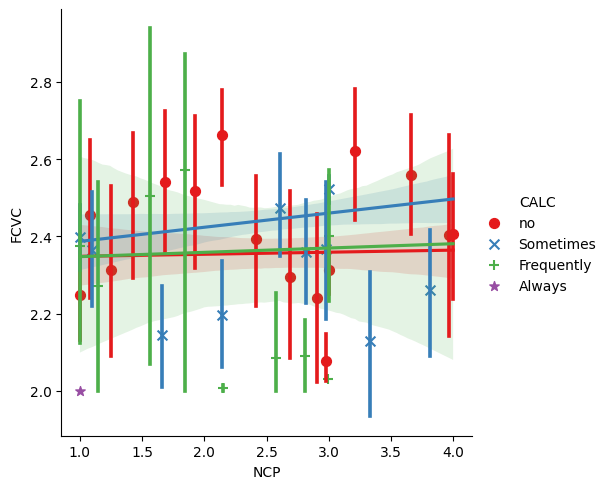

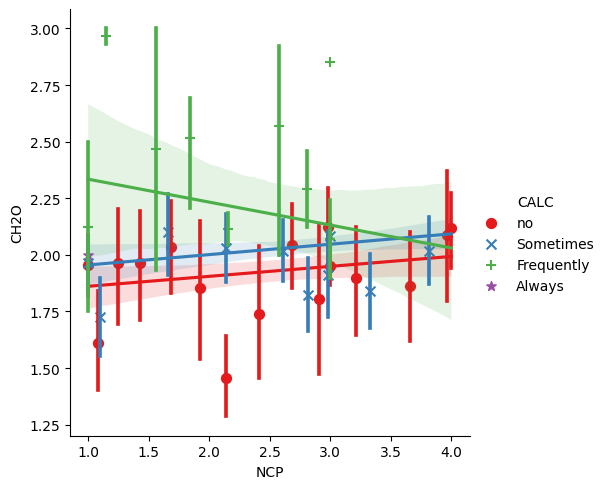

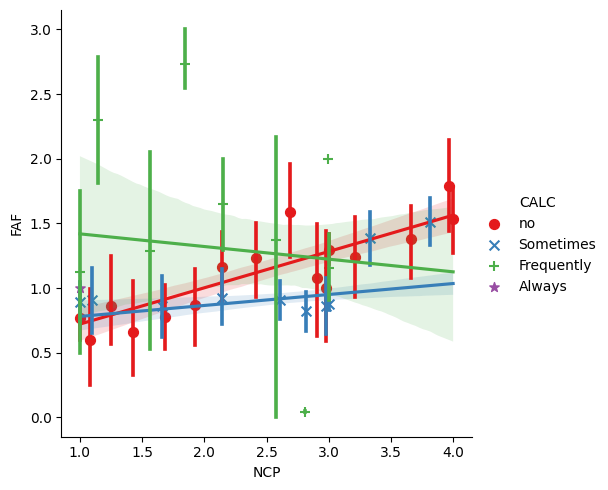

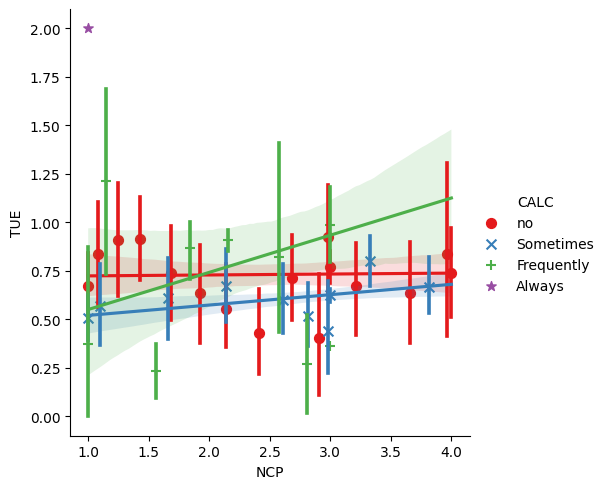

In [77]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="CALC", data=df, x_bins=30, palette="Set1", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on CALC - Consumption of Alcohol)
    - Physical Activity Frequent (FAF)

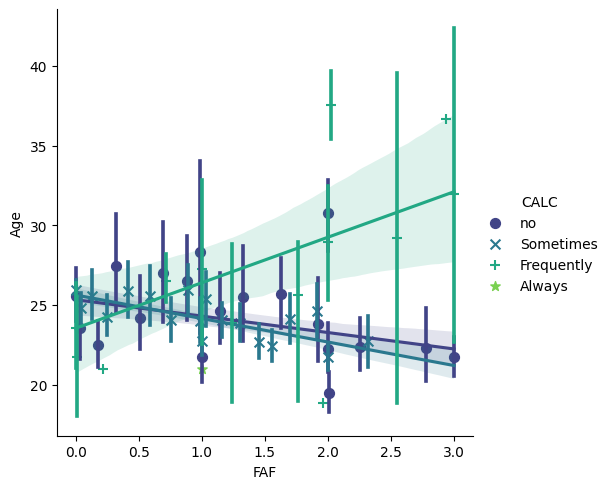

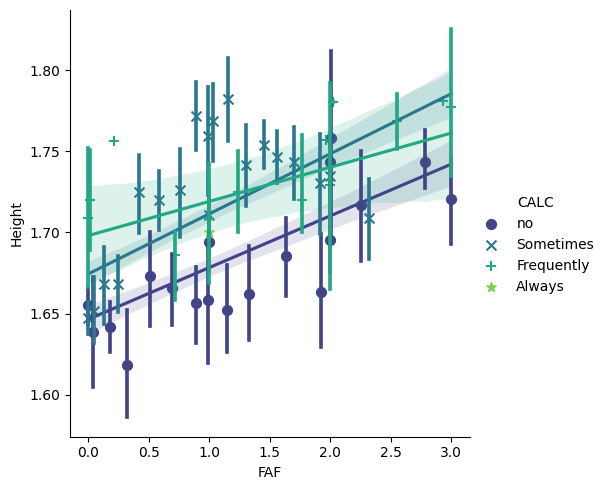

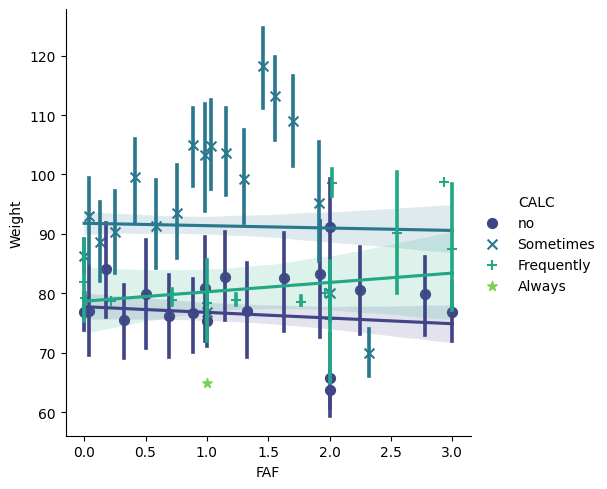

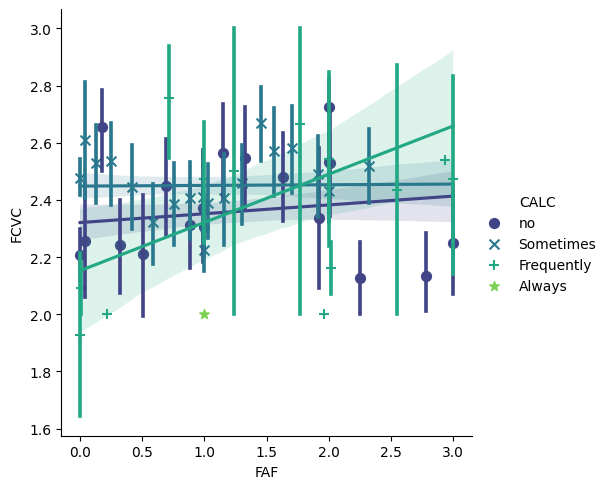

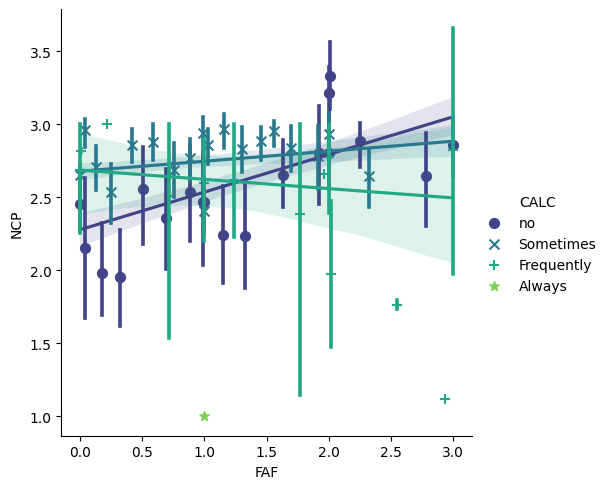

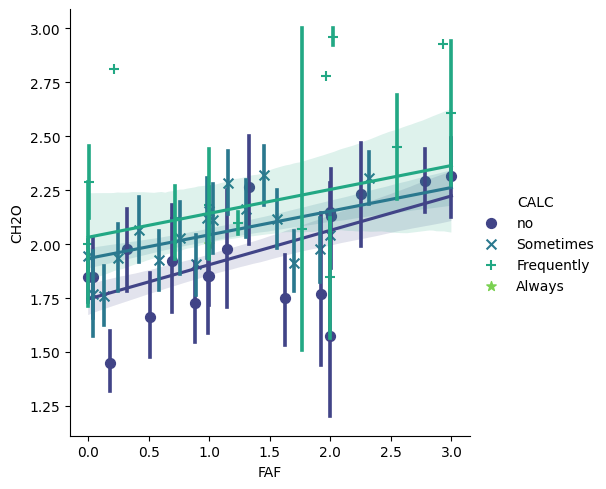

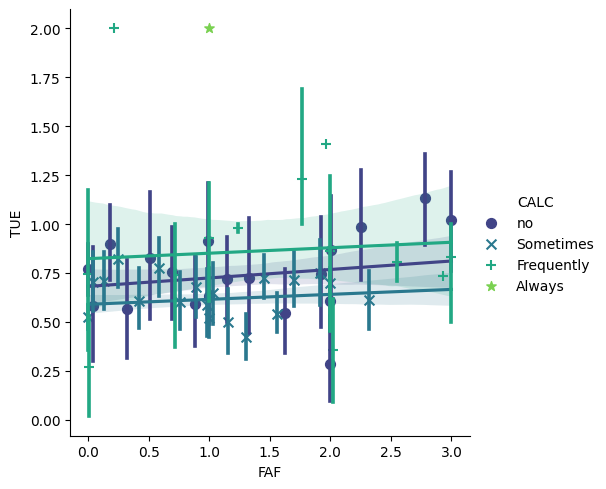

In [51]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="CALC", data=df, x_bins=25, palette="viridis", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on CALC - Consumption of Alcohol)
    - Time Using Technology Devices (TUE)

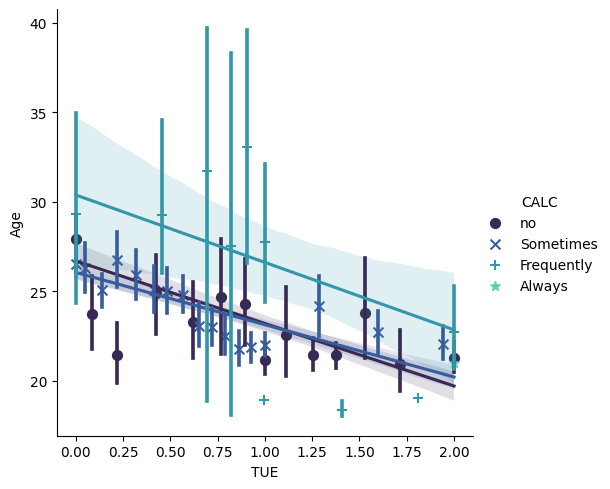

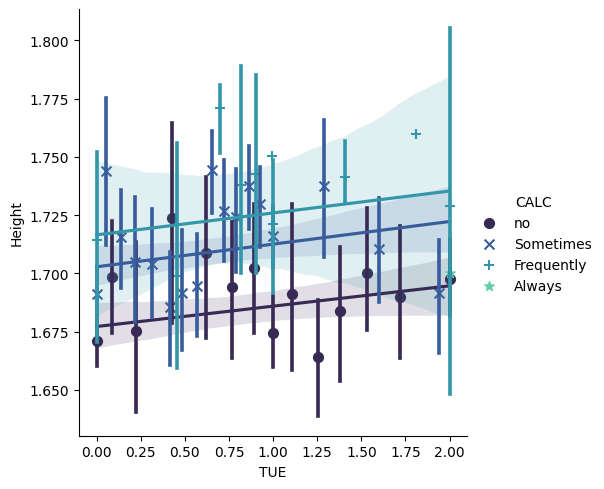

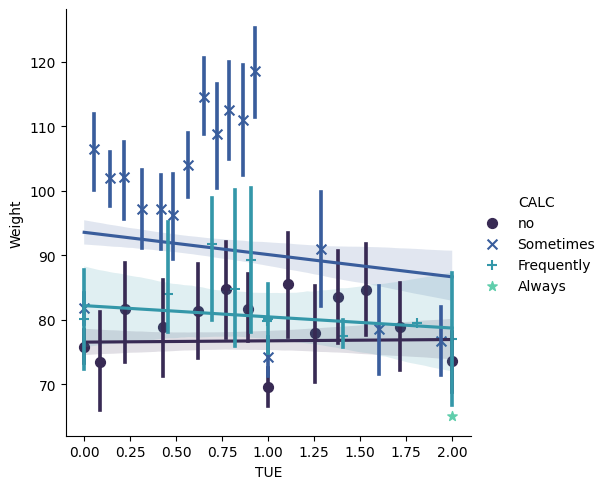

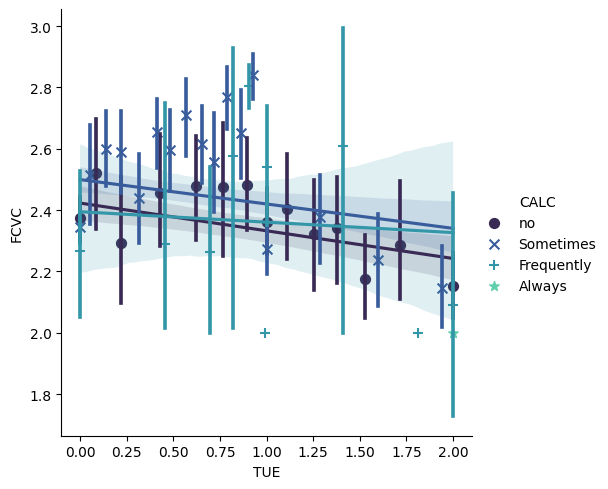

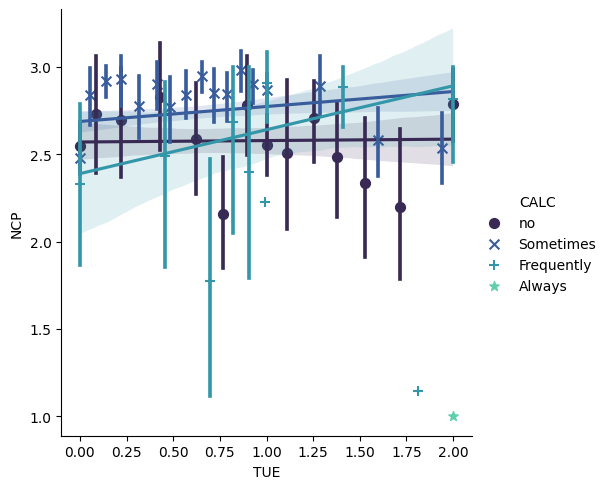

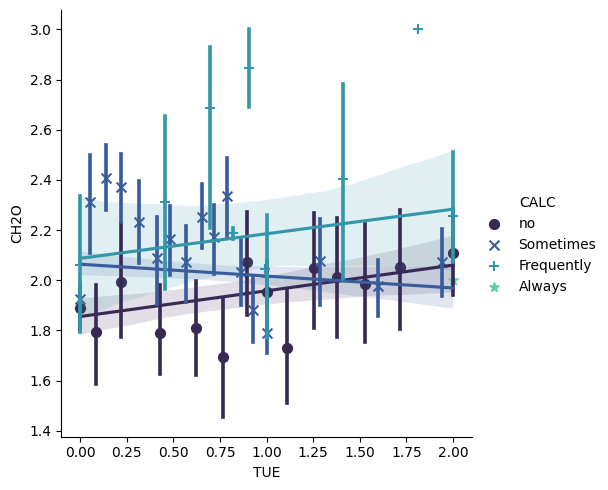

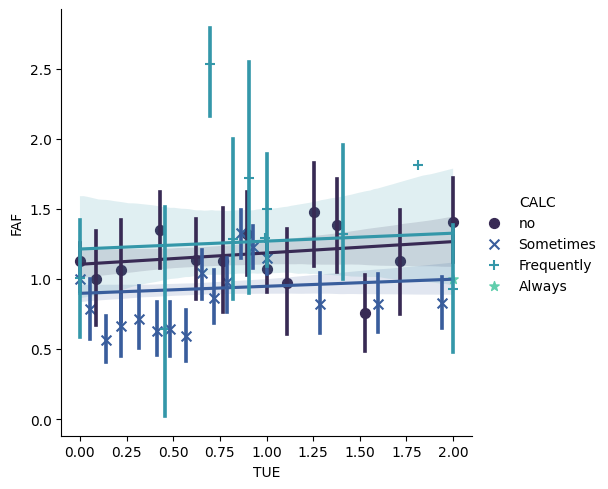

In [52]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="CALC", data=df, x_bins=25, palette="mako", markers=["o", "x", "+", "*"])
    plt.show()

- Linear Regression (Based on MTRANS - Transportation Used)
    - Weight

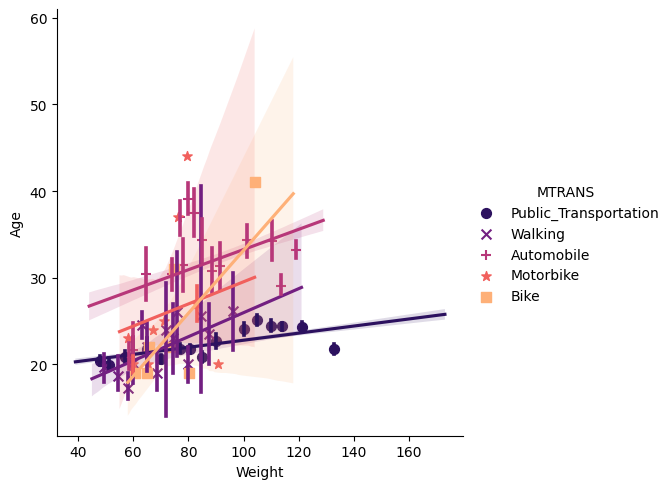

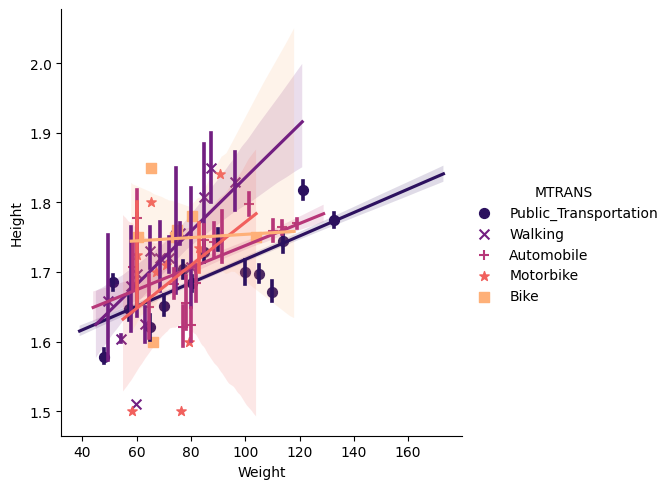

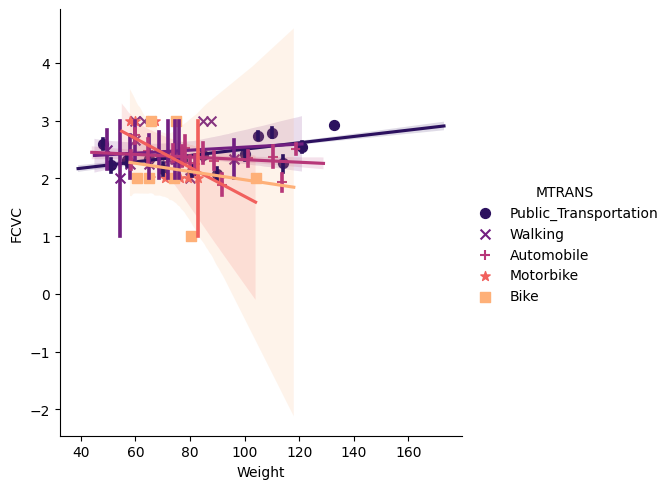

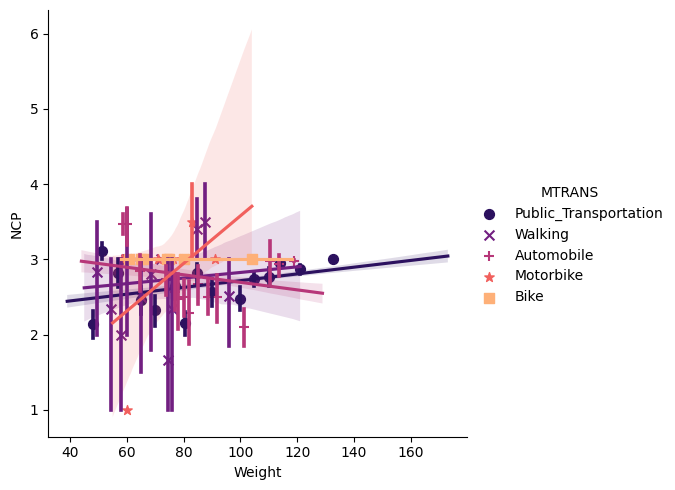

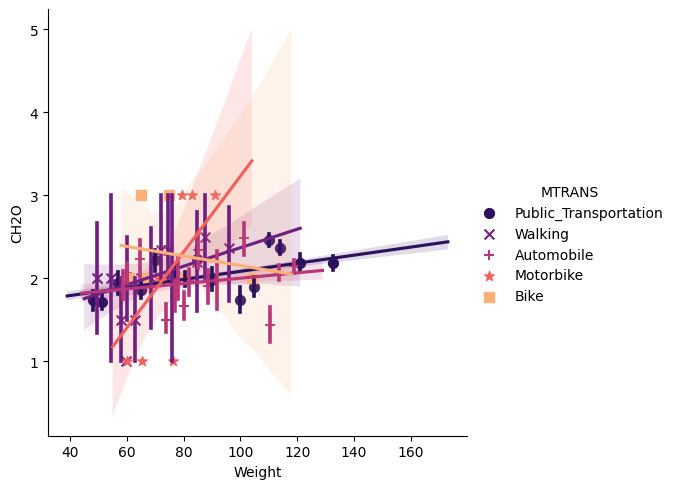

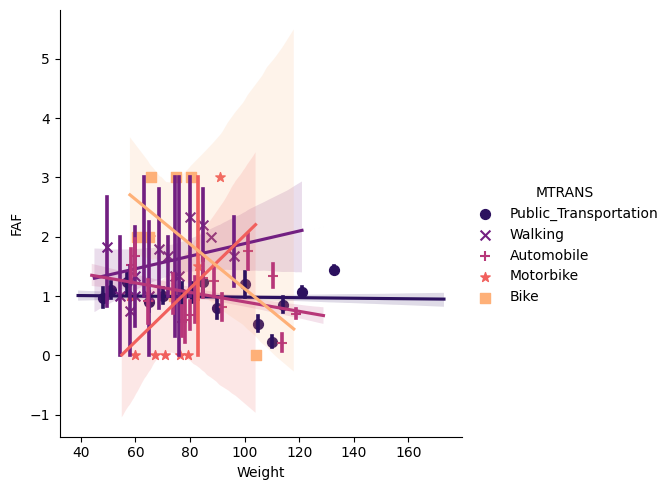

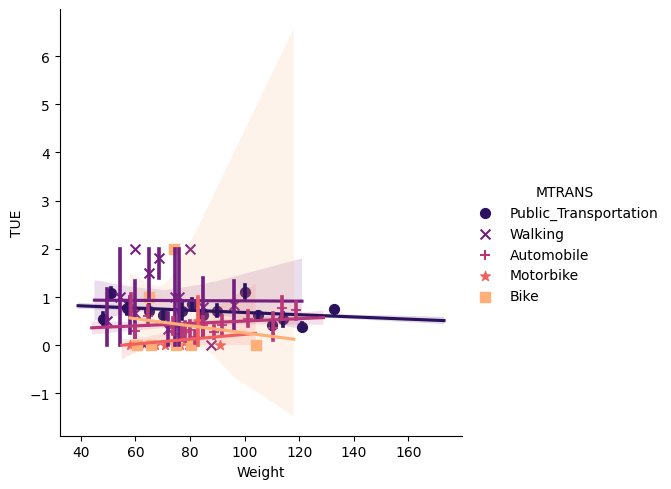

In [53]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="MTRANS", data=df, x_bins=15, palette="magma", markers=["o", "x", "+", "*", "s"])
    plt.show()

- Linear Regression (Based on MTRANS - Transportation Used)
    - Frequency of Consumption of Vegetables (FCVC)

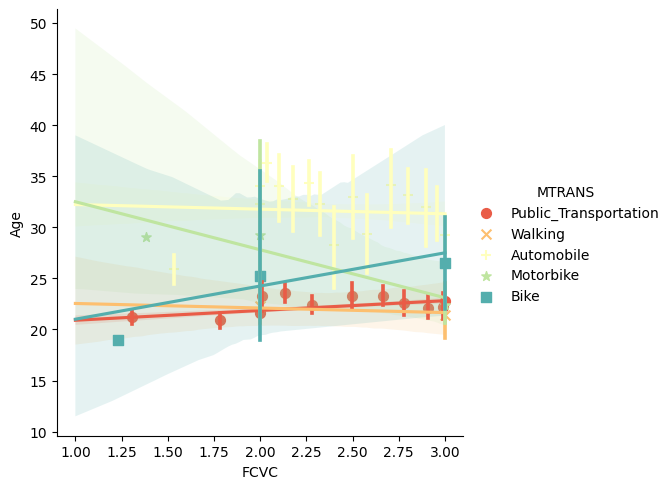

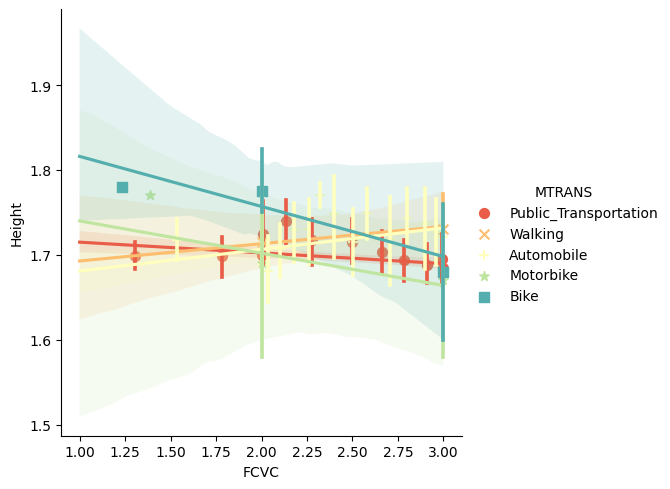

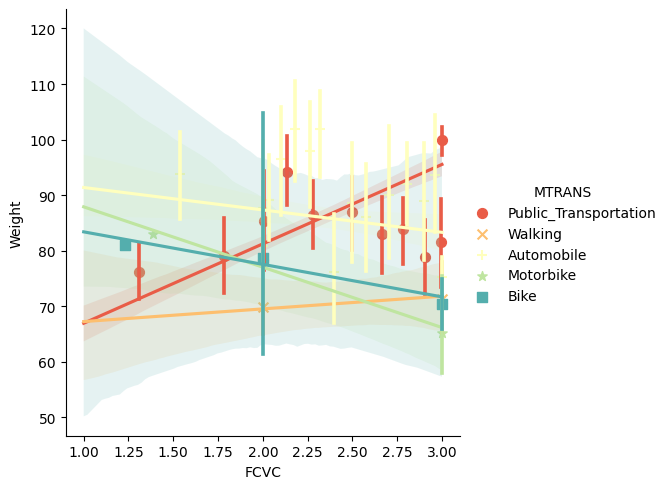

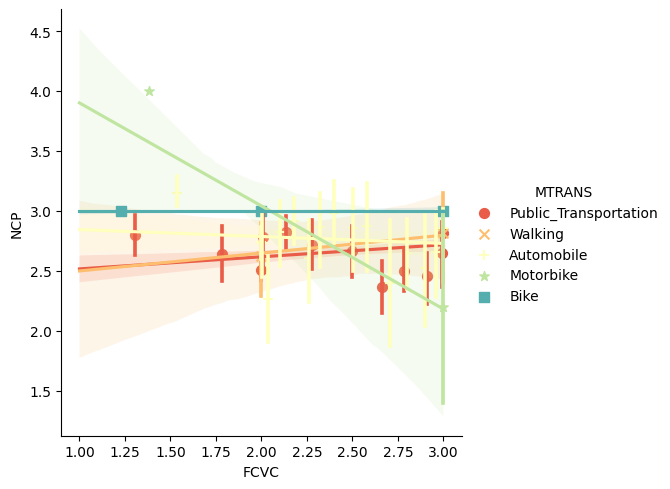

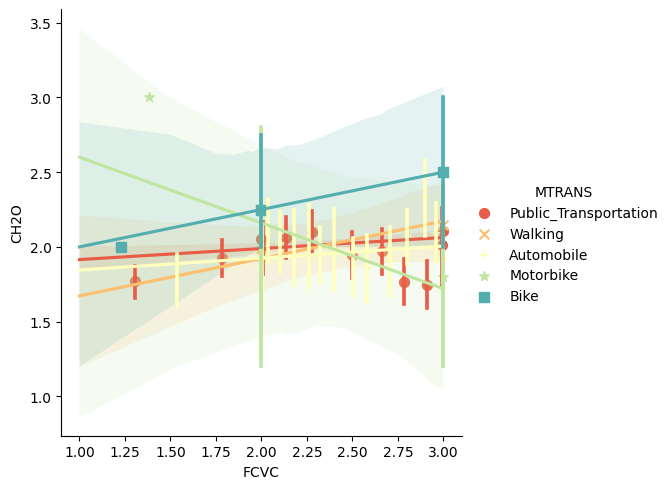

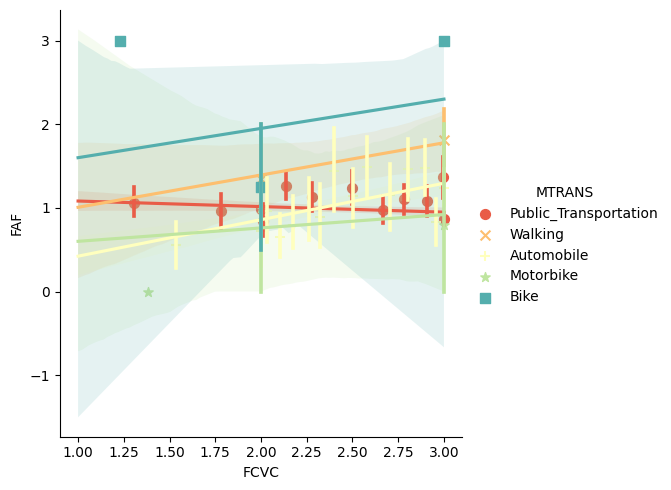

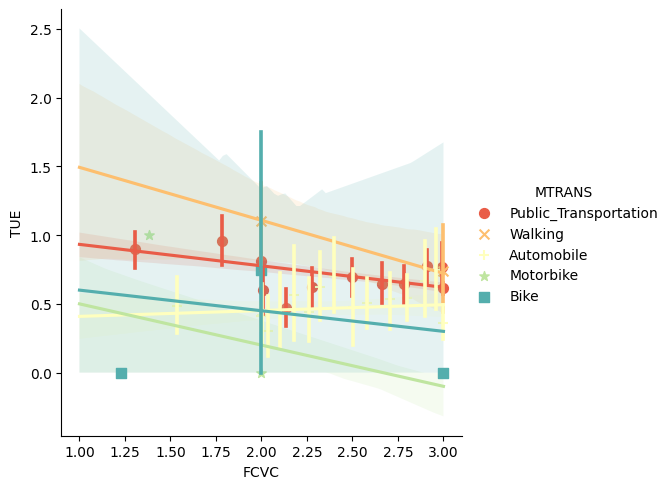

In [78]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="MTRANS", data=df, x_bins=25, palette="Spectral", markers=["o", "x", "+", "*", "s"])
    plt.show()

- Linear Regression (Based on MTRANS - Transportation Used)
    - Number of Main Meals (NCP)

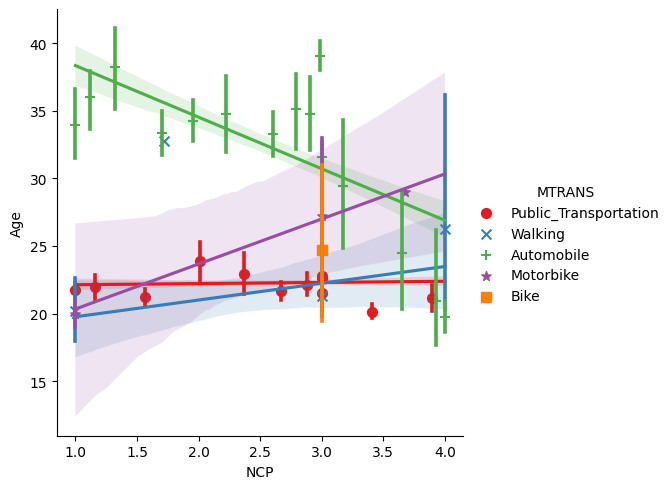

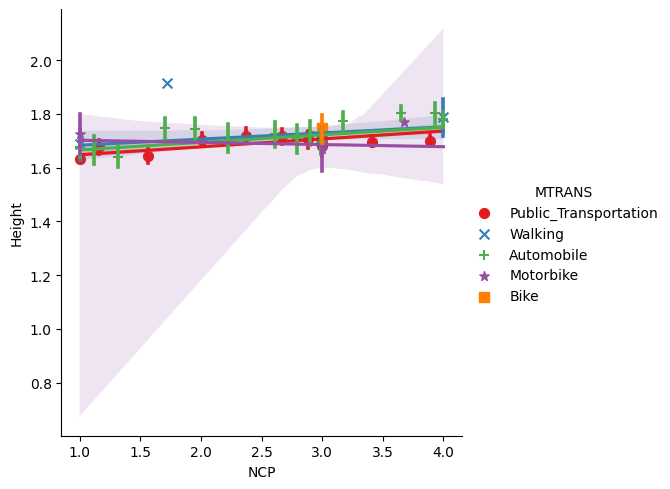

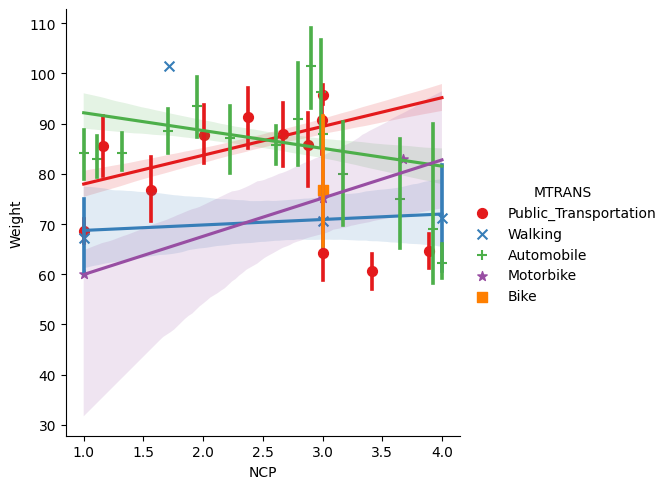

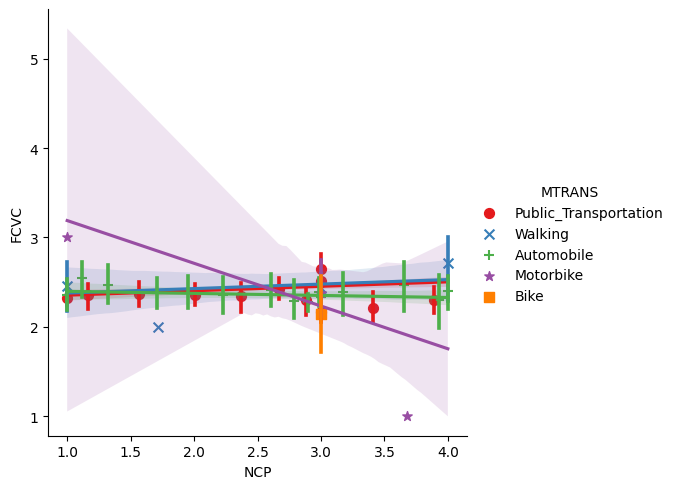

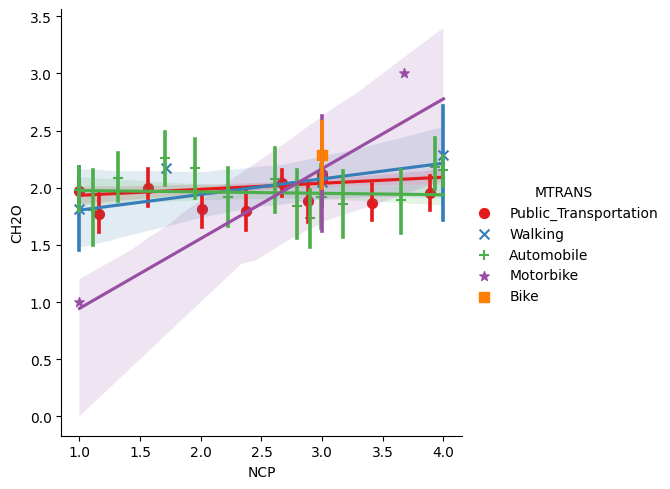

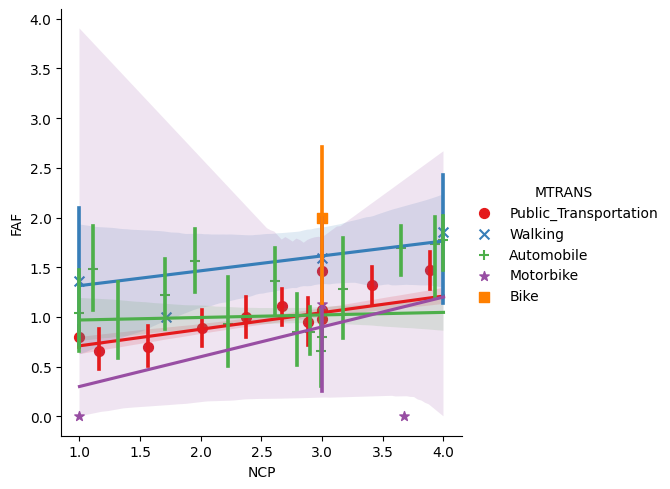

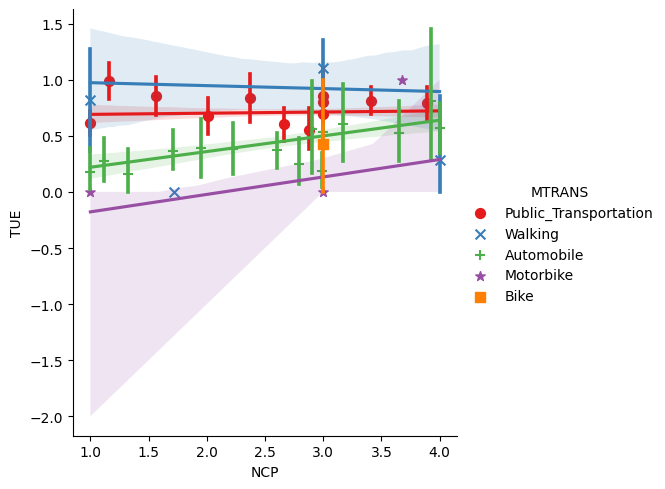

In [79]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="MTRANS", data=df, x_bins=30, palette="Set1", markers=["o", "x", "+", "*", "s"])
    plt.show()

- Linear Regression (Based on MTRANS - Frequent of Consumption of High Calorific Food)
    - Physical Activity Frequent (FAF)

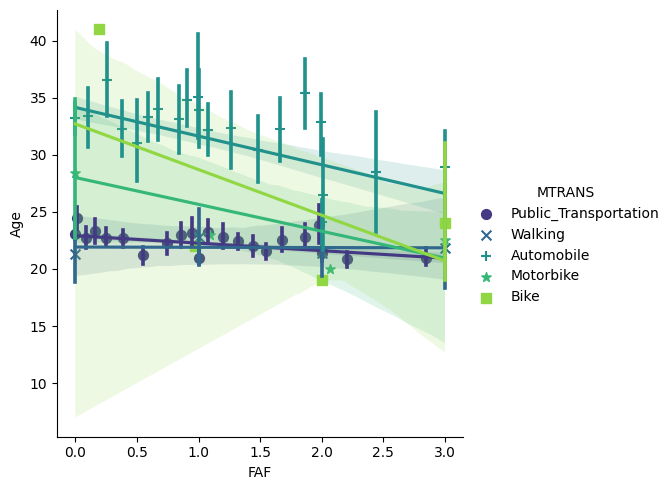

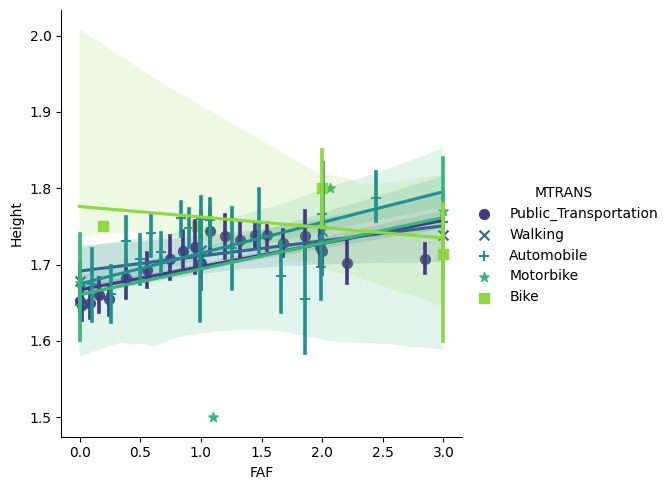

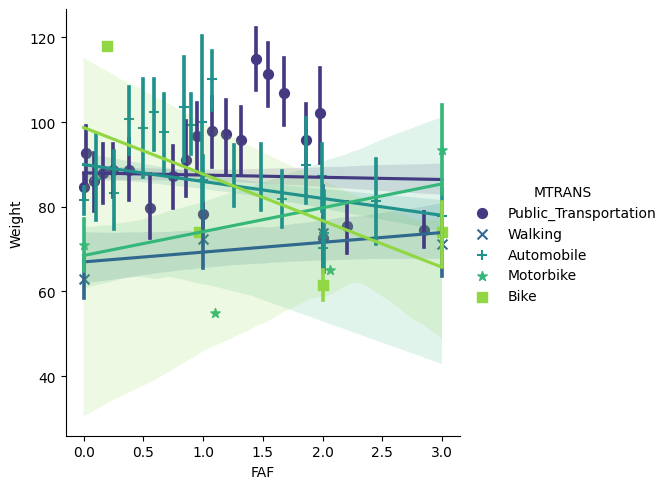

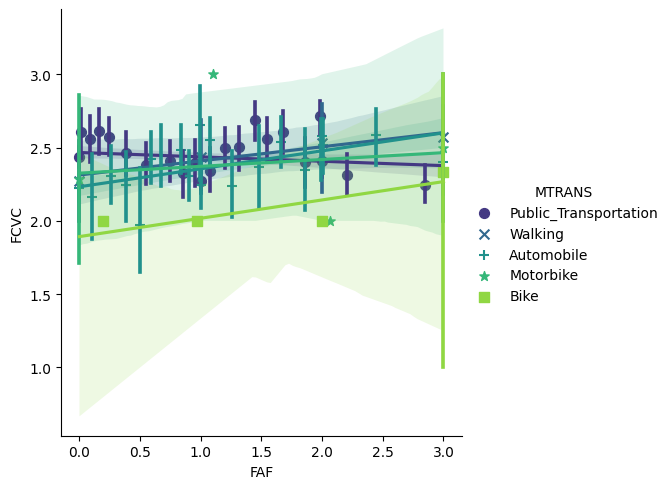

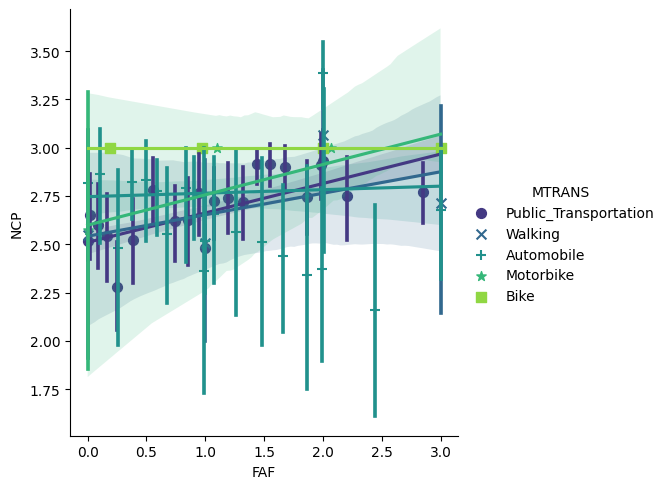

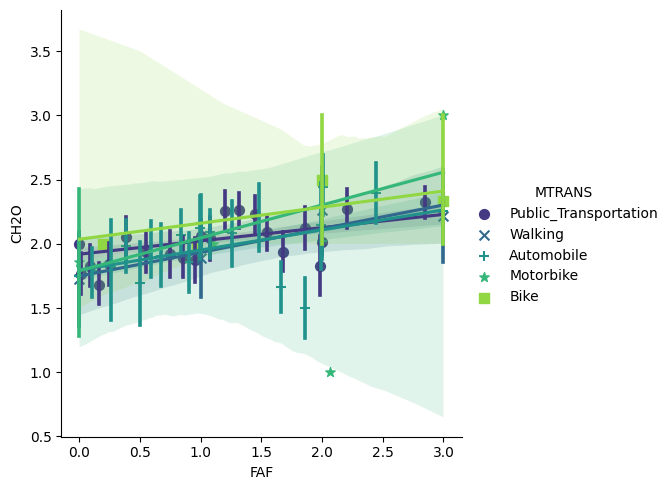

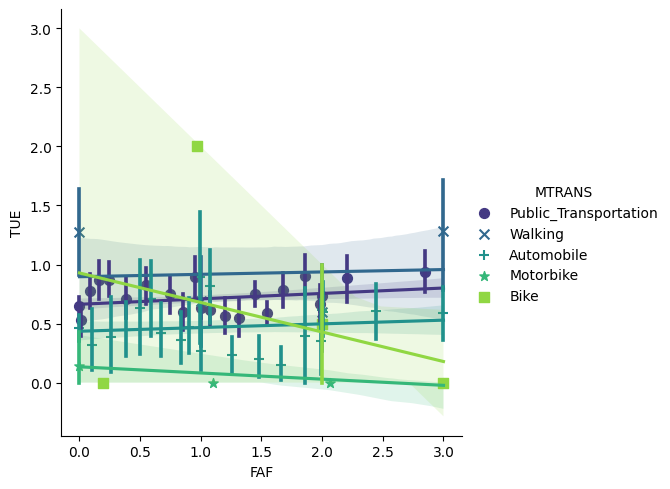

In [56]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="MTRANS", data=df, x_bins=30, palette="viridis", markers=["o", "x", "+", "*", "s"])
    plt.show()

- Linear Regression (Based on MTRANS - Transportation Used)
    - Time Using Technology Devices (TUE)

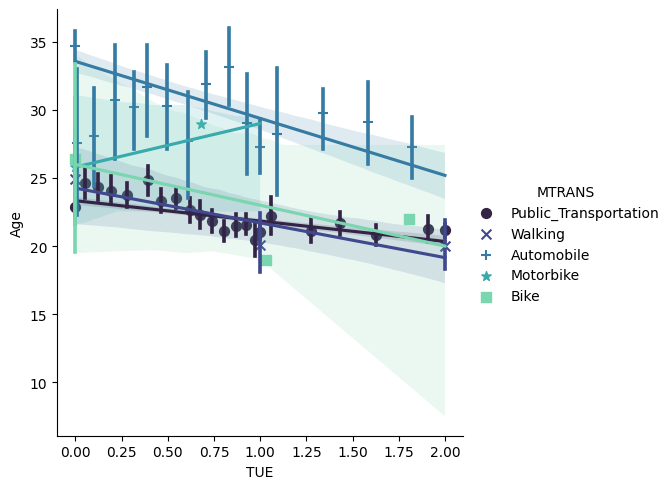

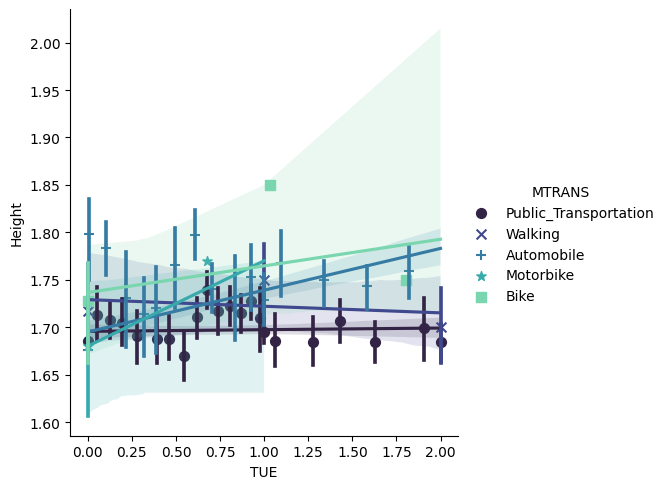

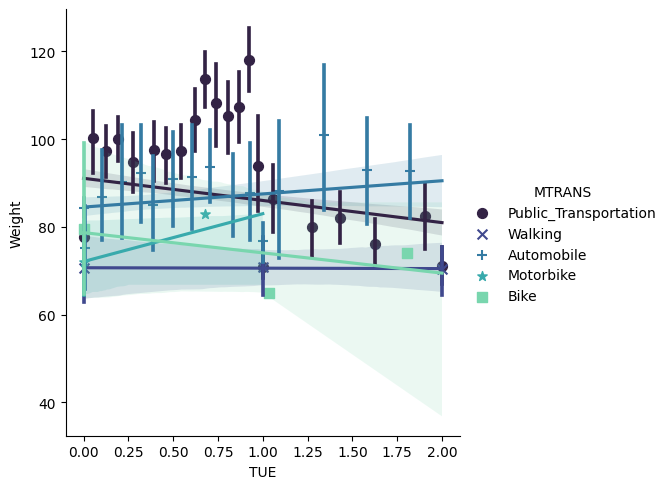

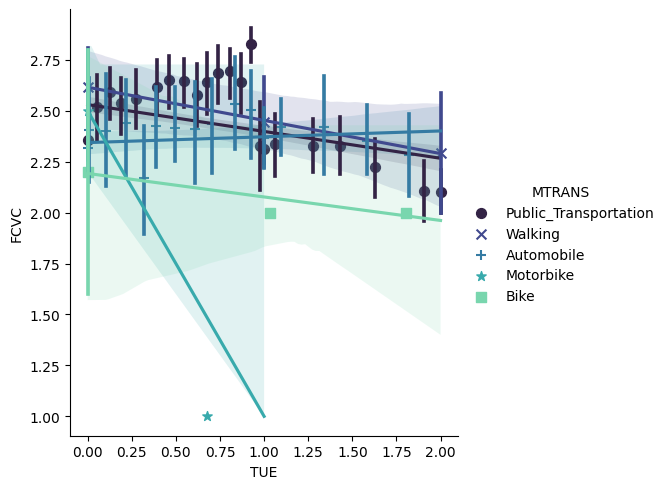

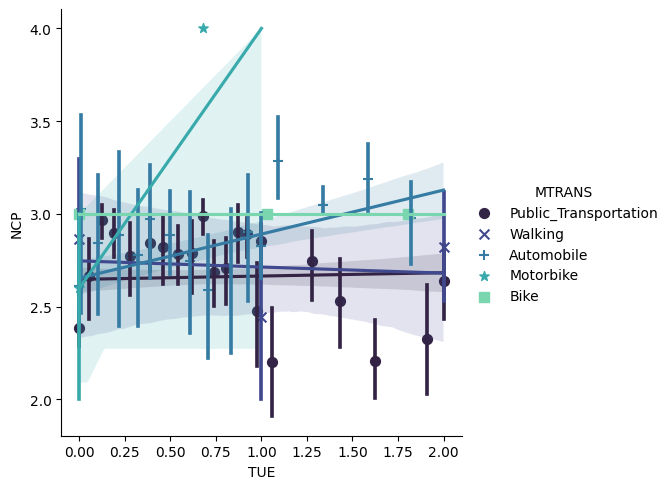

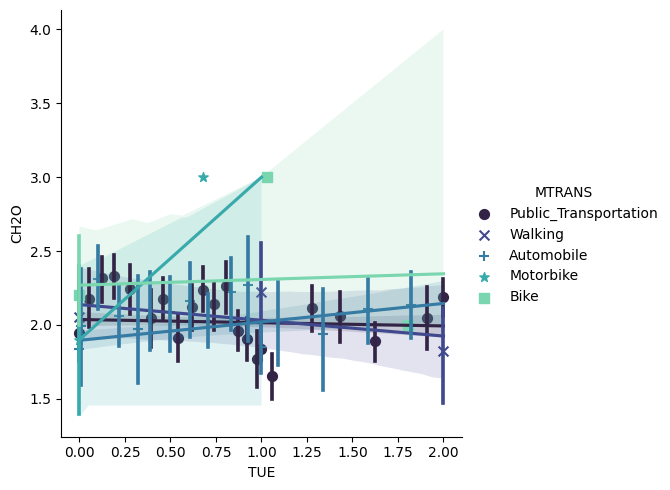

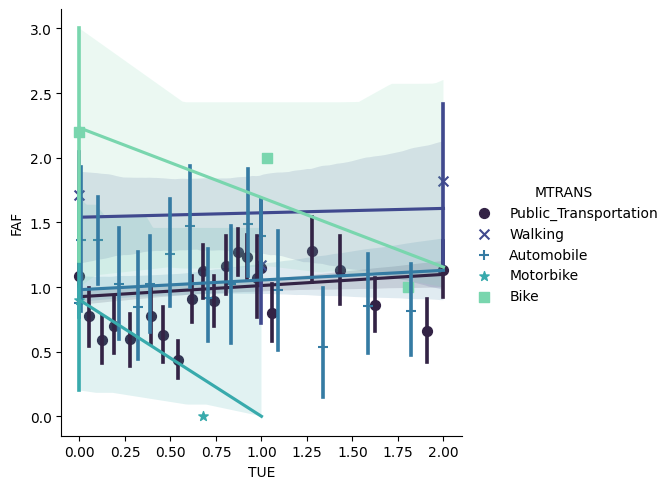

In [57]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="MTRANS", data=df, x_bins=30, palette="mako", markers=["o", "x", "+", "*", "s"])
    plt.show()

- Linear Regression (Based on NObeyesdad - Weight Type)
    - Weight

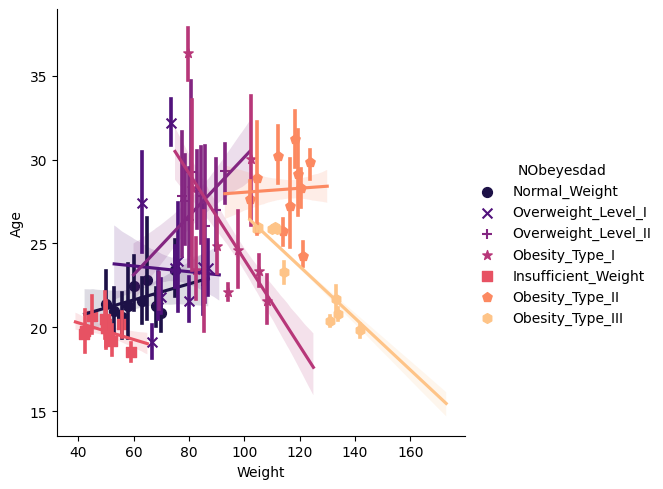

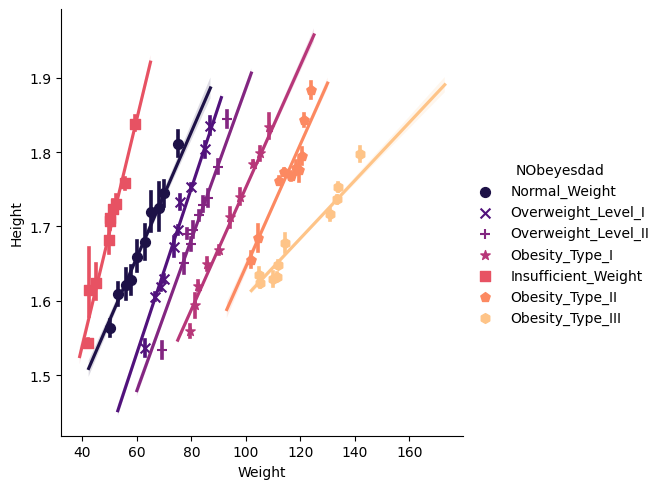

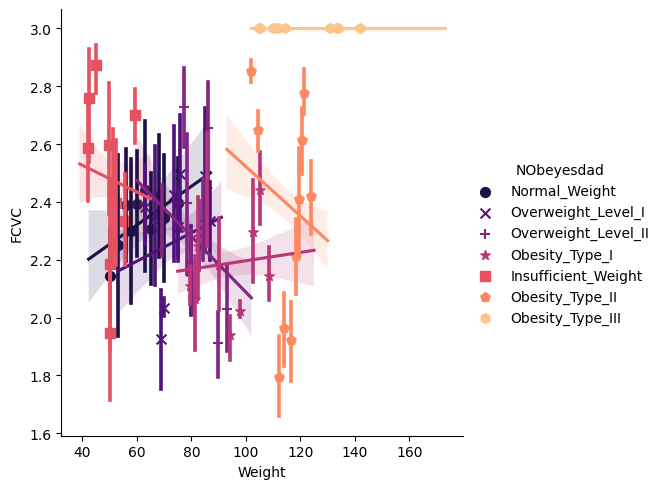

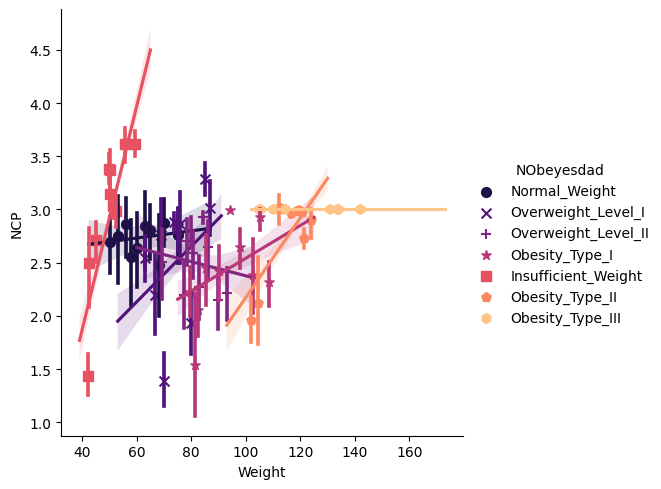

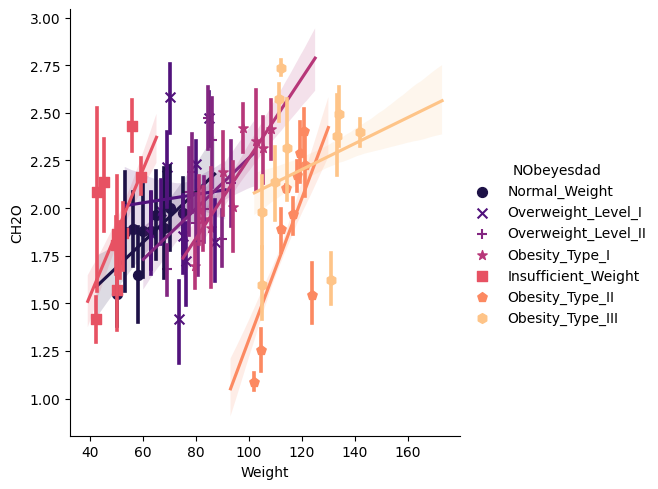

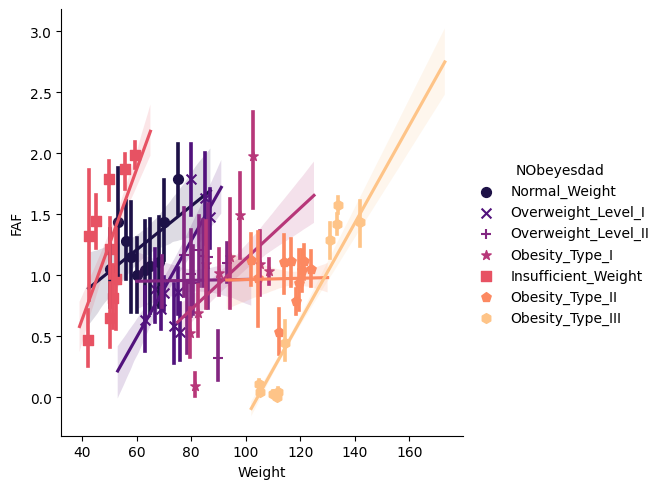

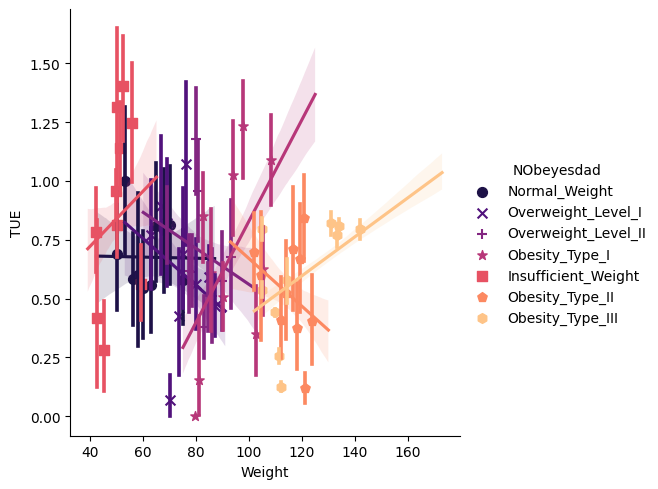

In [58]:
for col in ['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="Weight", y=col, hue="NObeyesdad", data=df, x_bins=10, palette="magma", markers=["o", "x", "+", "*", "s", "p", "h"])
    plt.show()

- Linear Regression (Based on NObeyesdad - Weight Type)
    - Frequency of Consumption of Vegetables (FCVC)

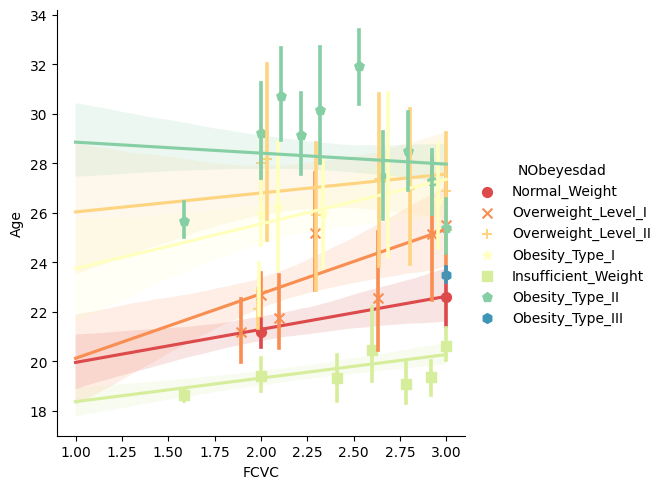

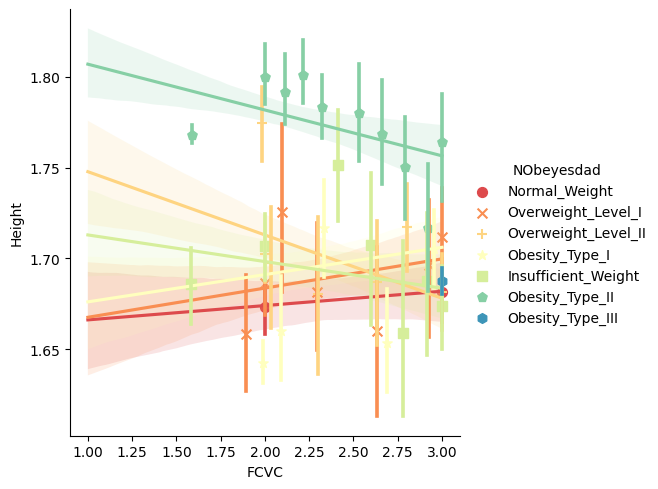

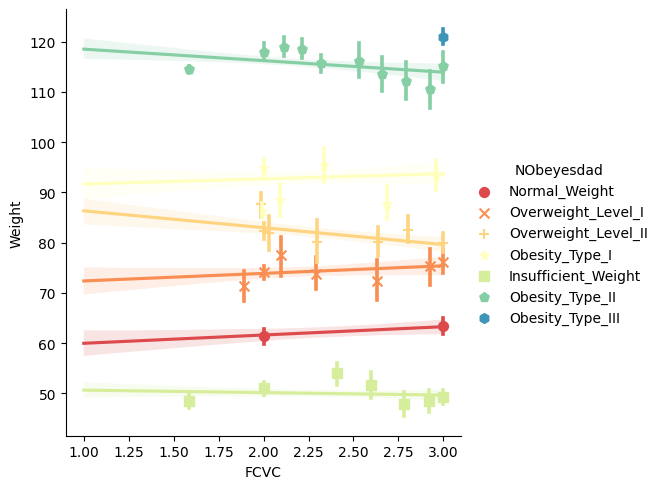

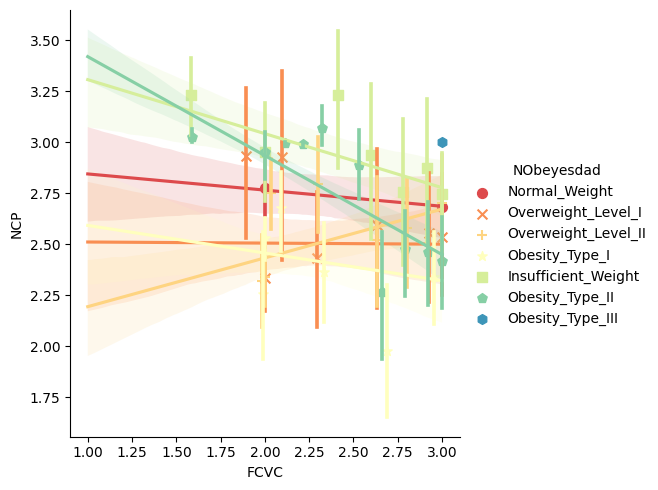

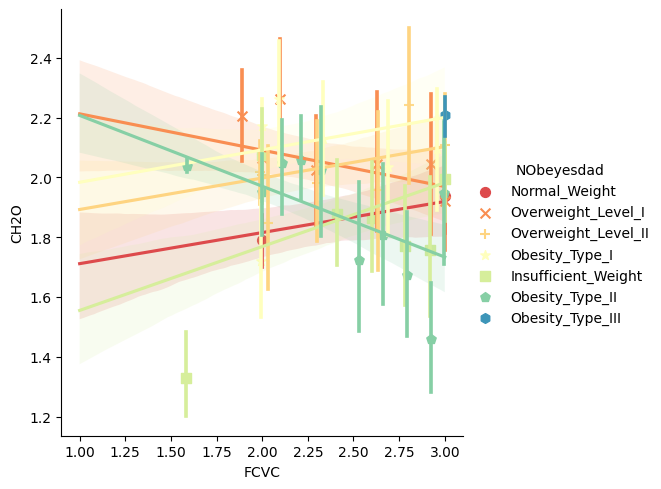

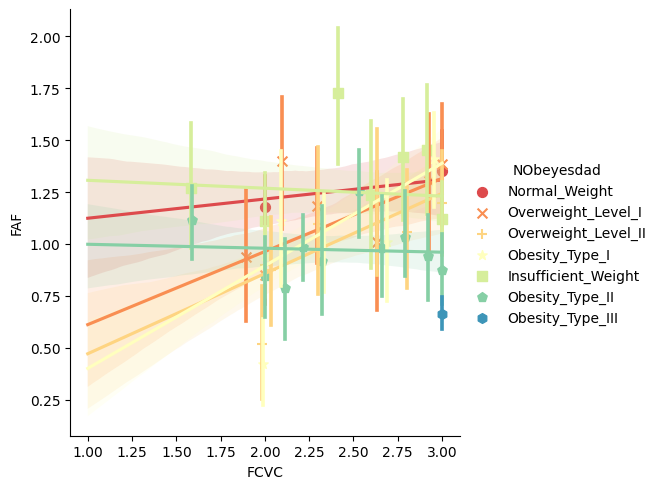

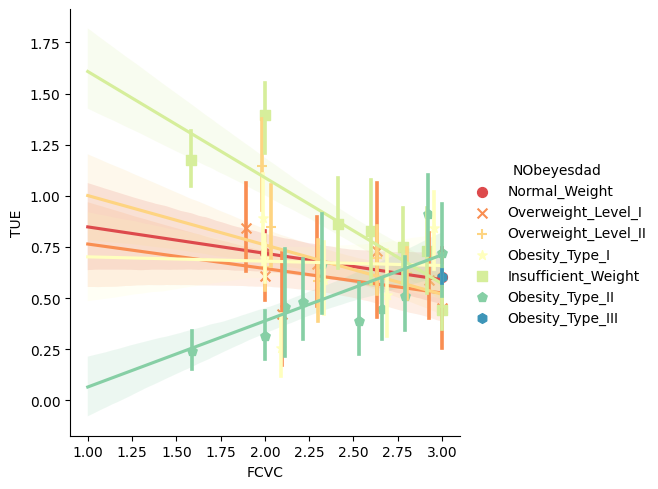

In [82]:
for col in ['Age', 'Height', 'Weight', 'NCP', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="FCVC", y=col, hue="NObeyesdad", data=df, x_bins=10, palette="Spectral", markers=["o", "x", "+", "*", "s", "p", "h"])
    plt.show()

- Linear Regression (Based on NObeyesdad - Weight Type)
    - Number of Main Meals (NCP)

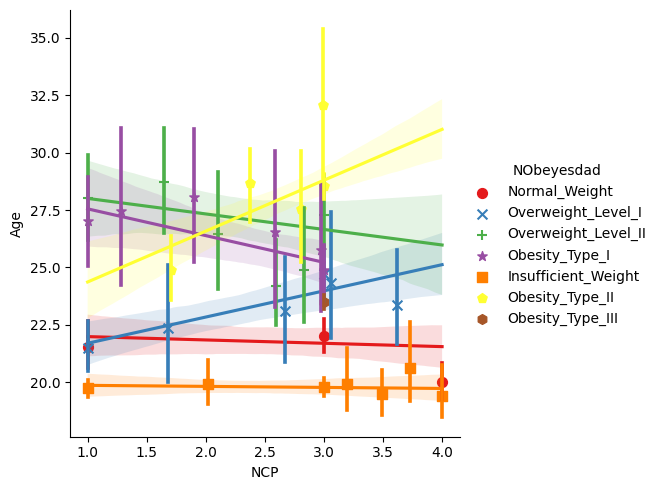

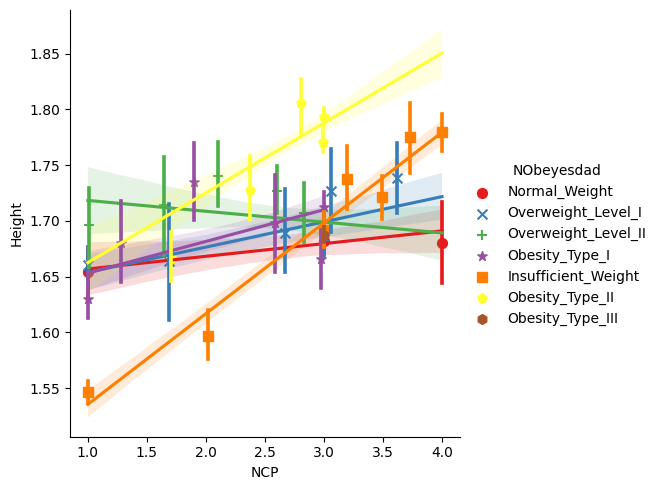

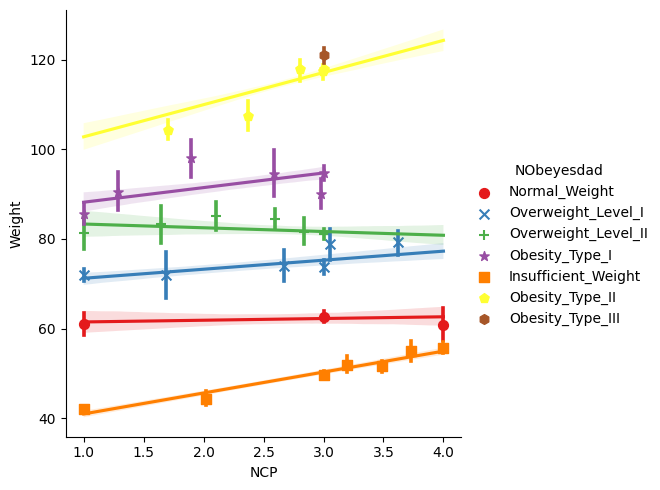

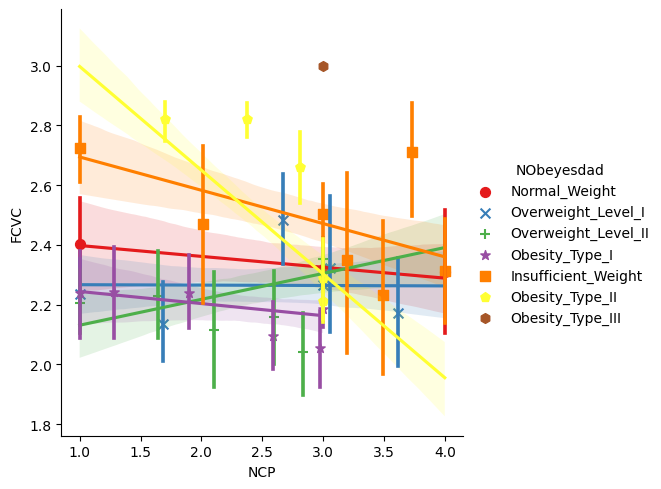

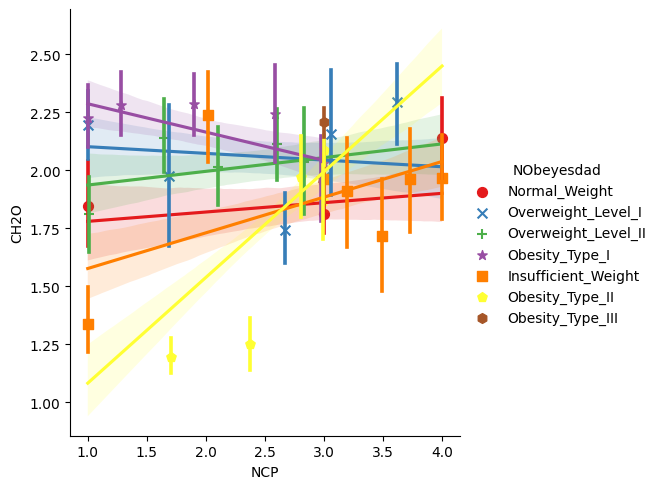

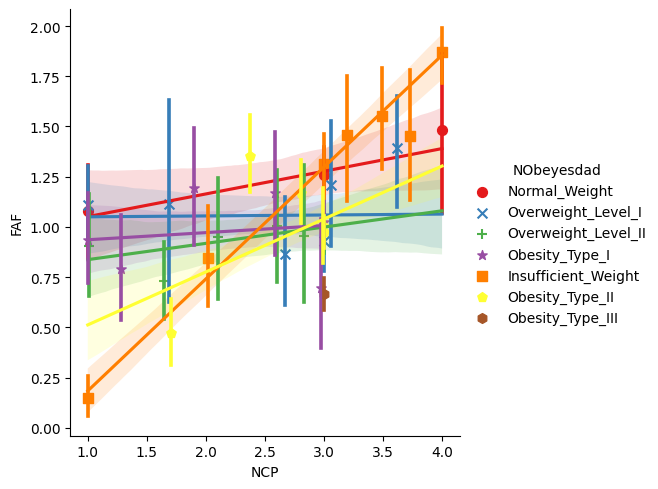

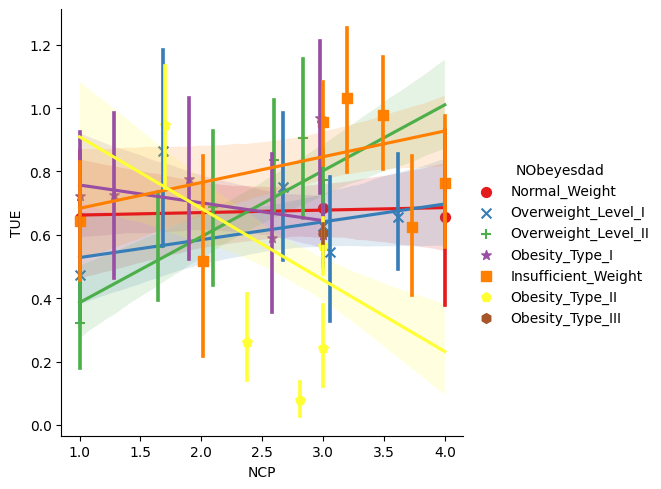

In [84]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'CH2O', 'FAF', 'TUE']:
    sns.lmplot(x="NCP", y=col, hue="NObeyesdad", data=df, x_bins=10, palette="Set1", markers=["o", "x", "+", "*", "s", "p", "h"])
    plt.show()

- Linear Regression (Based on NObeyesdad - Weight Type)
    - Physical Activity Frequent (FAF)

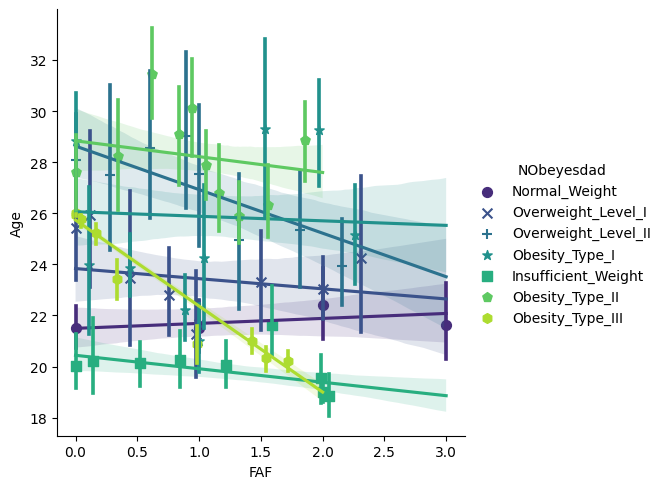

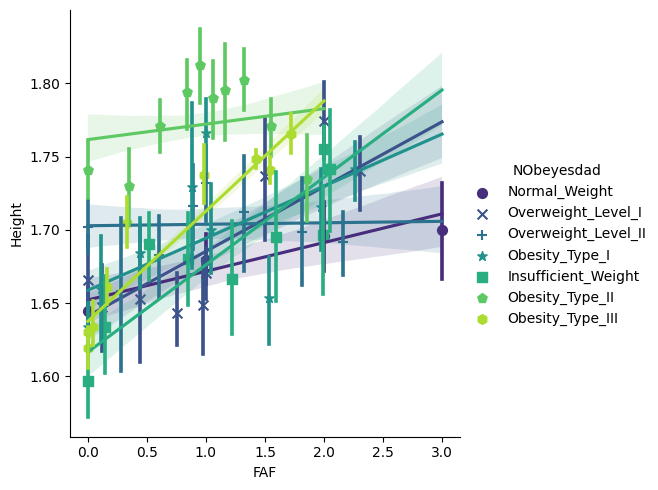

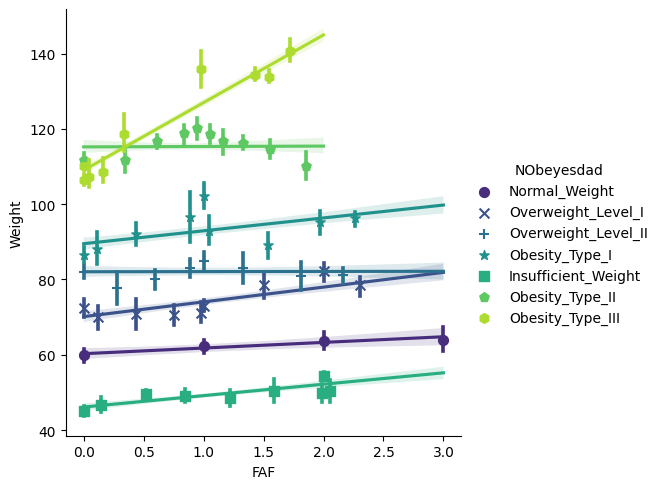

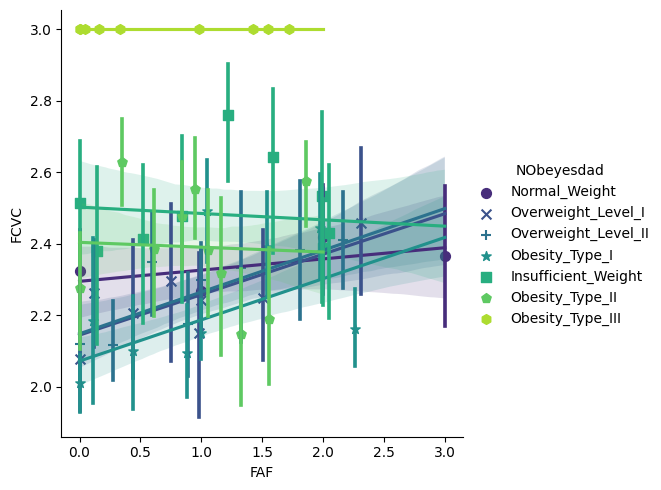

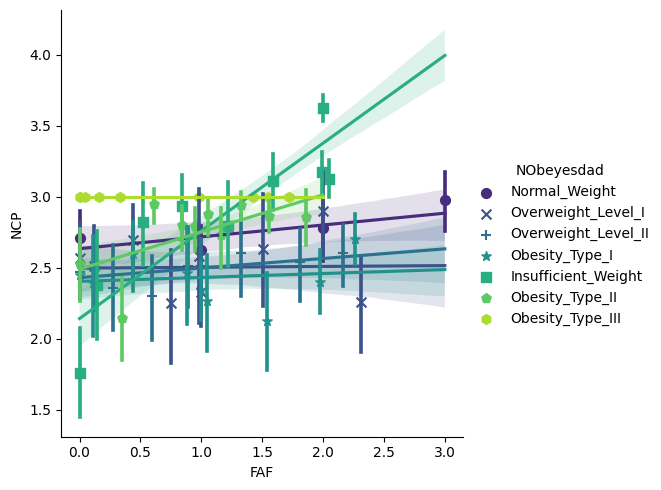

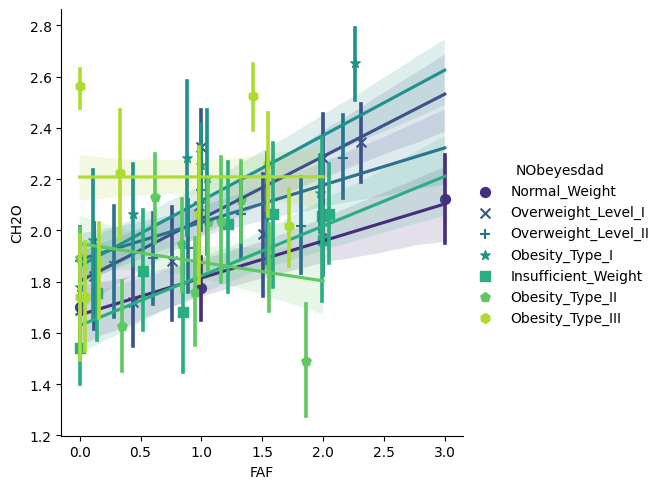

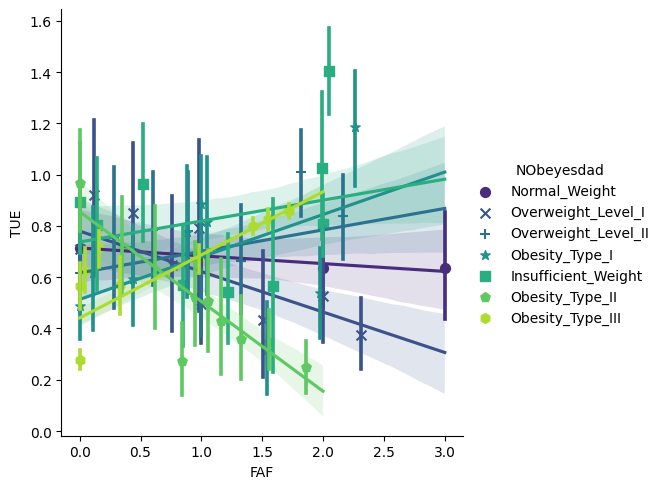

In [61]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'TUE']:
    sns.lmplot(x="FAF", y=col, hue="NObeyesdad", data=df, x_bins=10, palette="viridis", markers=["o", "x", "+", "*", "s", "p", "h"])
    plt.show()

- Linear Regression (Based on NObeyesdad - Weight Type)
    - Time Using Technology Devices (TUE)

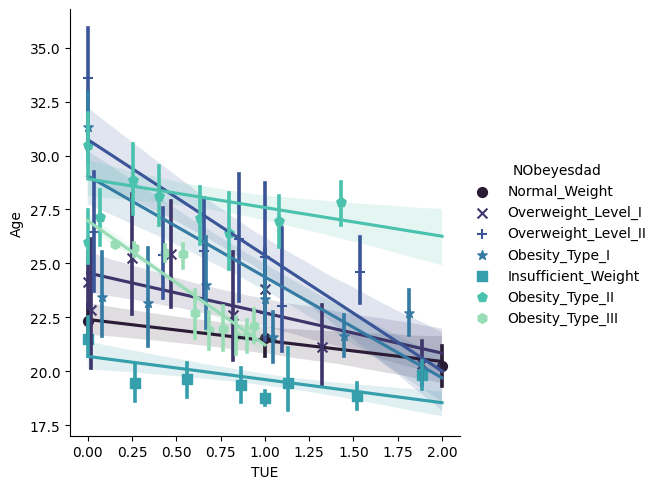

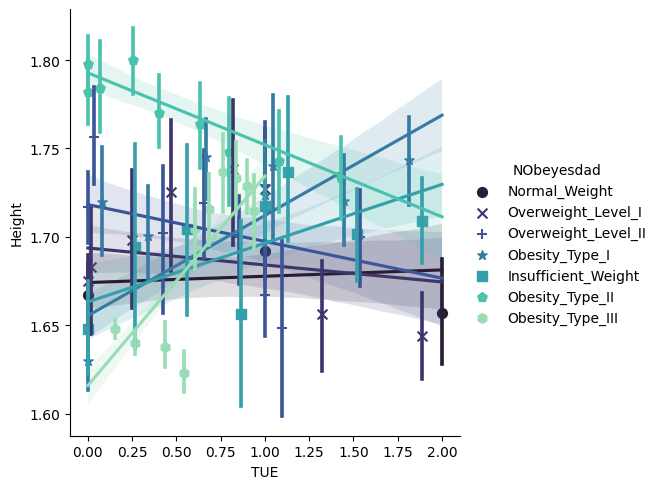

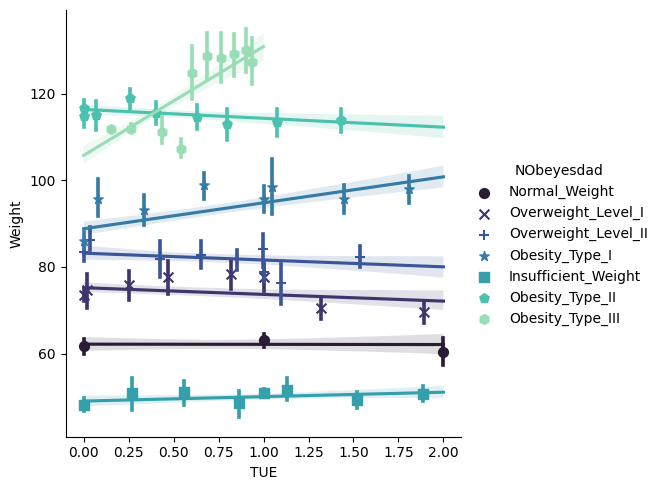

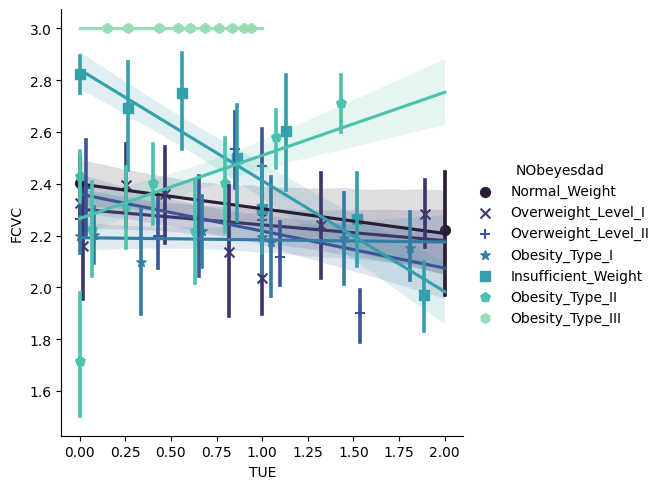

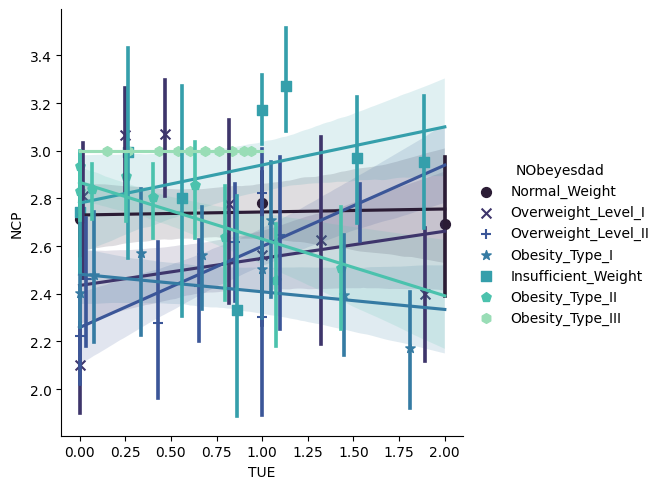

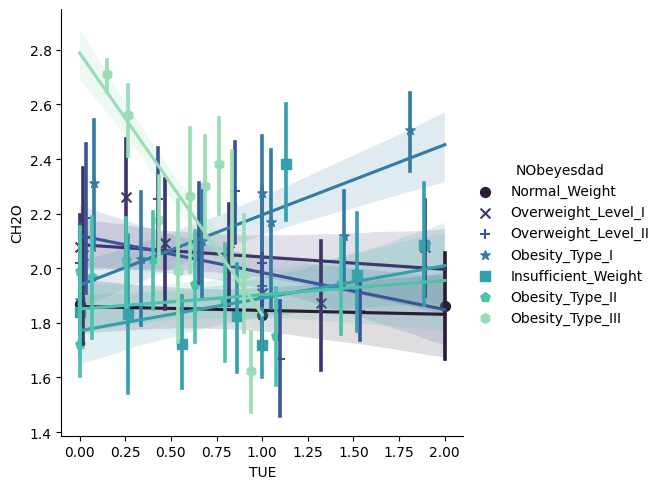

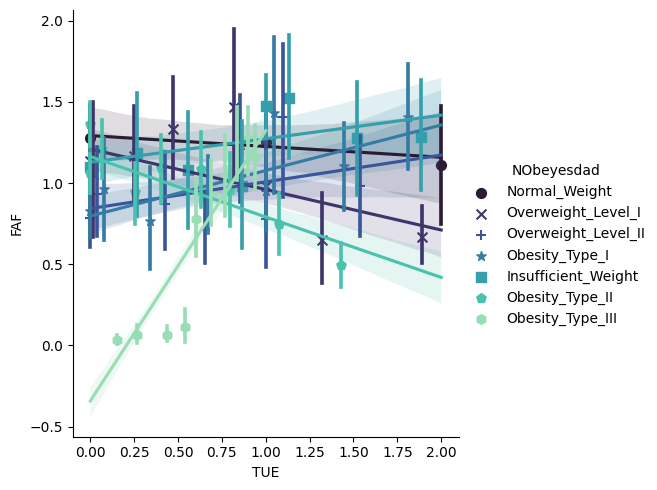

In [62]:
for col in ['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF']:
    sns.lmplot(x="TUE", y=col, hue="NObeyesdad", data=df, x_bins=10, palette="mako", markers=["o", "x", "+", "*", "s", "p", "h"])
    plt.show()

Linear Regression is used to predict the value of a variable based on the value of another. The various graphs above help in mapping how the variables Weight, FCVC, NCP, FAF and TUE change with respect to variables such as Age, Height and CH2O to name a few. The variables that we are trying to predict have a direct relation with the weight of a person and can be key in predicting obesity. Furthermore, the predictions have been segregated on the basis of several categorical variables (Gender, FAVC, CAEC etc.) available to us because such factors can have very significant statistical effects especially when trying to make predicitions. Some findings are:

<ul style="list-style-type:square">
    <li>Positive Correlation: Weight-Age(Male), Weight-Height(Female), Weight-Height(Male)</li>
    <li>No Correlation: Weight-Age(Female), Weight-FCVC(Male), Weight-FAF(Female)</li>
    <li>Negative Correlation: Weight-NCP(Male), Weight-FAF(Male), Weight-TUE(Male)</li>
</ul>

- ANOVA
    - Weight and family_history_with_overweight

In [78]:
H0 = "Weight of a person is dependent on that person's family history"
H1 = "Weight of a person is not dependent on that person's family history"

model = ols('Weight ~ family_history_with_overweight', data=df).fit()
sm.stats.anova_lm(model, typ=2)

,sum_sq,df,F,PR(>F)
family_history_with_overweight,3.572655e+05,1.0,691.166447,5.326129e-132
Residual,1.090147e+06,2109.0,NaN,NaN


Since the p-value is below the pre-determined significance level(.05), we reject the null hypothesis(H0) and can say that the weight of a person is not dependent on family_history_with_overweight

- ANOVA
    - Weight and Frequent Consumption of High Calorific Food (FAVC)

In [79]:
H0 = "Weight of a person is not dependent on that person's consumption of High Calorific Food (FAVC)"
H1 = "Weight of a person is dependent on that person's consumption of High Calorific Food (FAVC)"

model = ols('Weight ~ FAVC', data=df).fit()
sm.stats.anova_lm(model, typ=2)

,sum_sq,df,F,PR(>F)
FAVC,1.073221e+05,1.0,168.900778,3.315687e-37
Residual,1.340090e+06,2109.0,NaN,NaN


Since the p-value is below the pre-determined significance level(.05), we reject the null hypothesis(H0) and can say that the weight of a person is dependent on Frequent Consumption of High Calorific Food (FAVC)

- ANOVA
    - Weight and Consumption of food between meals (CAEC)

In [80]:
H0 = "Weight of a person is not dependent on consumption of food between meals (CAEC)"
H1 = "Weight of a person is dependent on consumption of food between meals (CAEC)"

model = ols('Weight ~ CAEC', data=df).fit()
sm.stats.anova_lm(model, typ=2)

,sum_sq,df,F,PR(>F)
CAEC,2.545943e+05,3.0,149.905577,4.725762e-88
Residual,1.192818e+06,2107.0,NaN,NaN


Since the p-value is below the pre-determined significance level(.05), we reject the null hypothesis(H0) and can say that the weight of a person is dependent on consumption of food between meals (CAEC)

- ANOVA
    - Weight and Consumption of Alcohol (CALC)

In [81]:
H0 = "Weight of a person is dependent on that person's Consumption of Alcohol (CALC)"
H1 = "Weight of a person is not dependent on that person's Consumption of Alcohol (CALC)"

model = ols('Weight ~ CALC', data=df).fit()
sm.stats.anova_lm(model, typ=2)

,sum_sq,df,F,PR(>F)
CALC,9.870887e+04,3.0,51.402349,4.641371e-32
Residual,1.348704e+06,2107.0,NaN,NaN


Since the p-value is below the pre-determined significance level(.05), we reject the null hypothesis(H0) and can say that the weight of a person is not dependent on that person's Consumption of Alcohol (CALC)

Similar to what was done with Linear Regression, ANOVA(Analysis of Variance) is used to gain information about the relationship between dependent and independent variables. The difference lies in the fact that we relate a categorical variable with a numeric variable and perform hypothesis testing to gain insights about the relationship whereas Linear Regression only utilizes numeric variables and does not involve any hypothesis testing. Through the above analysis Weight has been related with several categorical variables such as FAVC, CAEC, CALC. Some key findings are:

<ul style="list-style-type:square">
    <li>Weight of a person is not dependent on family_history_with_overweight</li>
    <li>Weight of a person is dependent on Frequent Consumption of High Calorific Food (FAVC)</li>
    <li>Weight of a person is dependent on consumption of food between meals (CAEC)</li>
    <li>Weight of a person is not dependent on that person's Consumption of Alcohol (CALC)</li>
</ul>

#### Multivariate Analysis

‘Multi’ means many and ‘variate’ means variable thus, multivariate analysis is the statistical procedure for analyzing data involving more than two variables. Multivariate analysis has various applications in clustering, feature selection, root-cause analysis, hypothesis testing, dimensionality reduction, etc.

- K-Means Clustering
    - Angle Plot

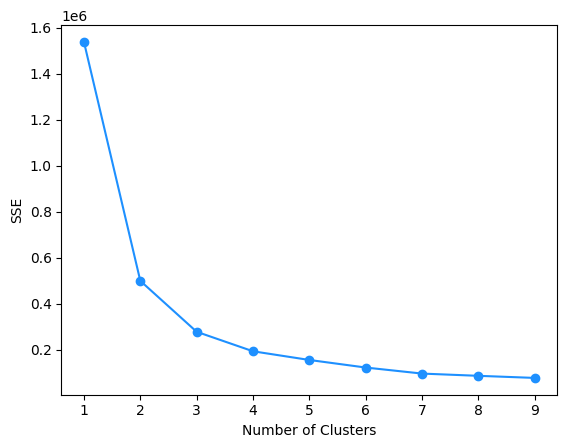

In [80]:
data = {}
num_data = df[['Age', 'Height', 'Weight', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']]

for k in range(1, 10):
    k_means = KMeans(n_clusters=k, max_iter=1000, n_init=10).fit(num_data)
    data[k] = k_means.inertia_

plt.plot(list(data.keys()), list(data.values()), marker='o', color='dodgerblue')
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
plt.show()

The angle plot helps in defining a fixed number of clusters that are being formed in the data based on which K-Means Clustering can be carried out. For this particular dataset that number is 3 as we can clearly see from the Angle Plot that the deviation decreases and reduces to a minimum after 3 clusters

In [81]:
k_means = KMeans(n_clusters=3, max_iter=1000, n_init=10).fit(num_data)
cluster = k_means.fit_predict(num_data)

- K-Means Clustering
    - Weight, Age, FCVC

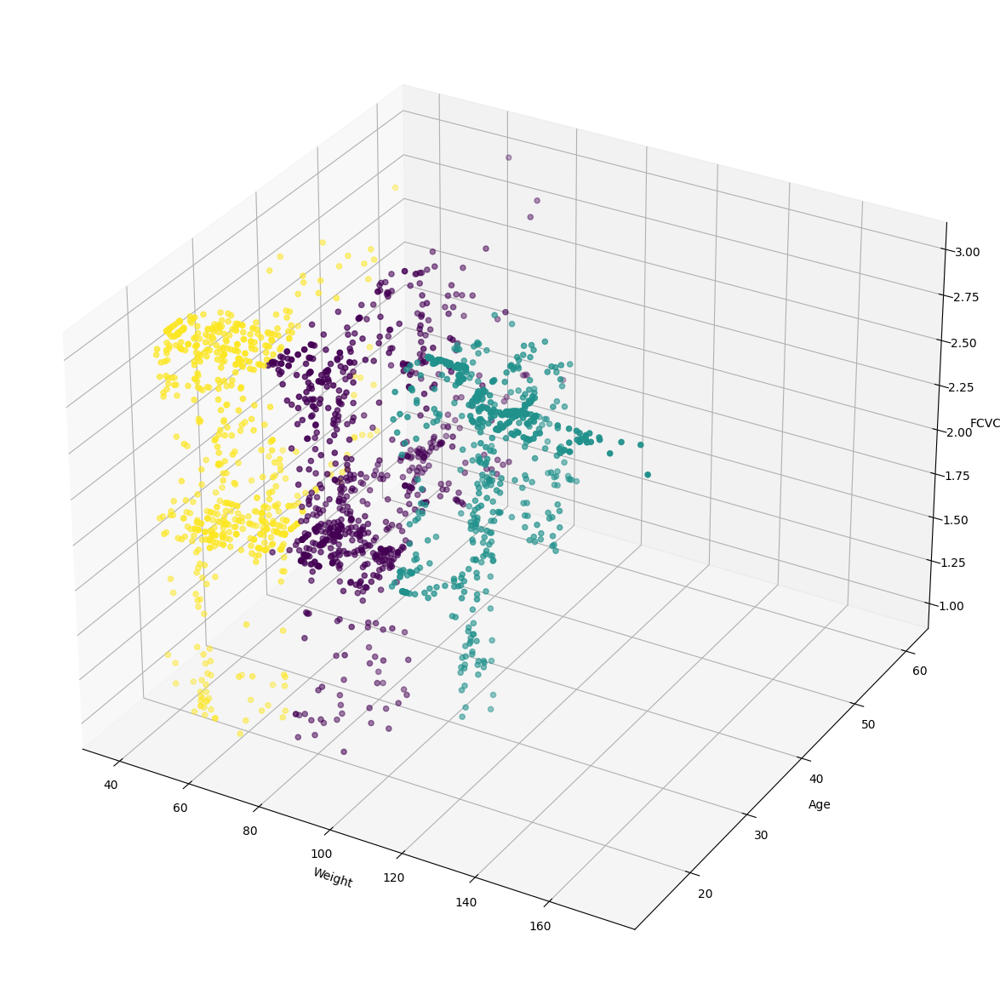

In [82]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Age'], num_data['FCVC'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Age')
ax.set_zlabel('FCVC')
plt.show()

- K-Means Clustering
    - Weight, Age, NCP

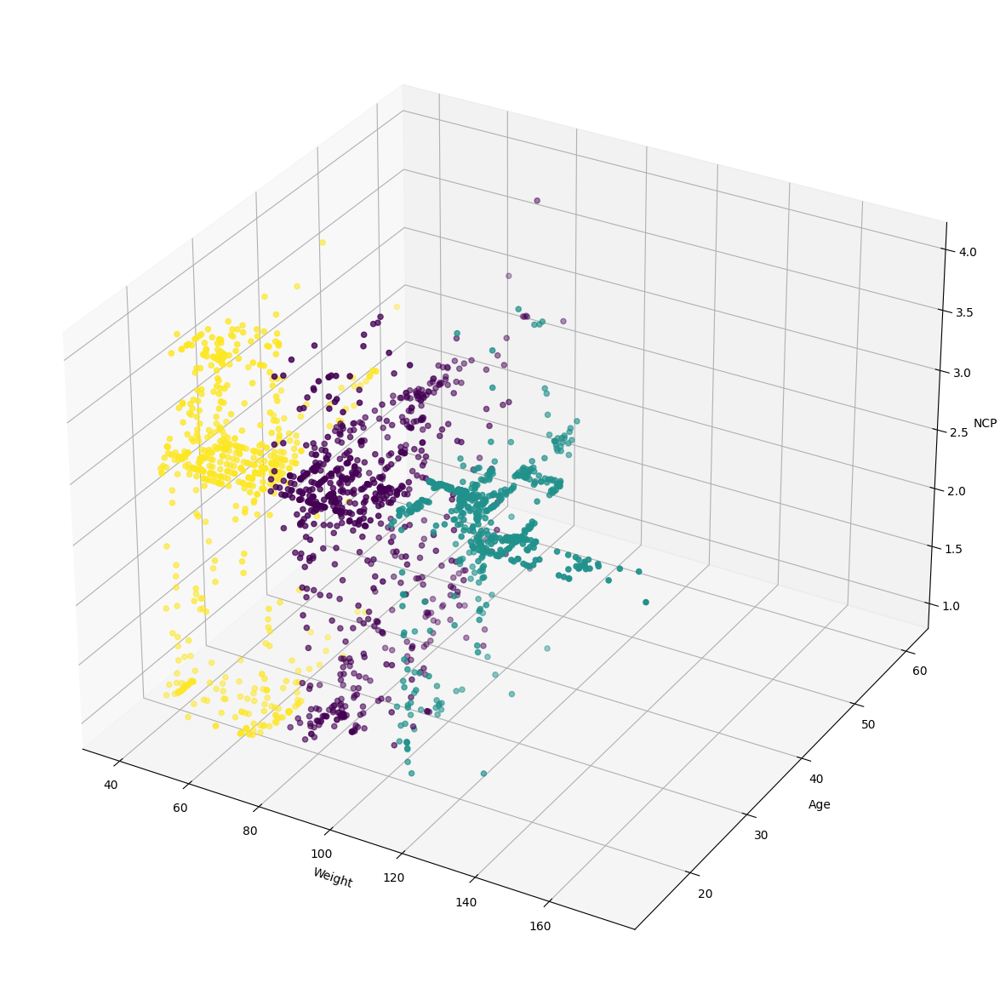

In [83]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Age'], num_data['NCP'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Age')
ax.set_zlabel('NCP')
plt.show()

- K-Means Clustering
    - Weight, Age, CH2O

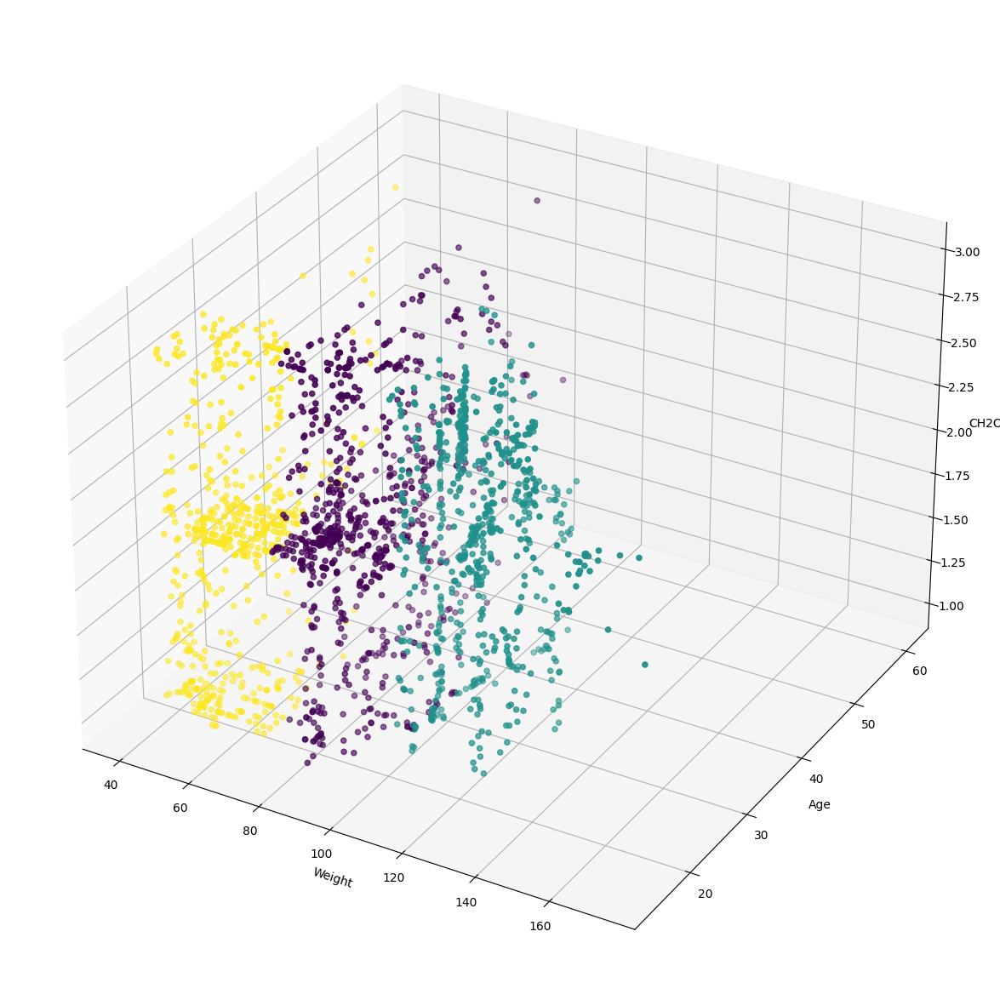

In [84]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Age'], num_data['CH2O'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Age')
ax.set_zlabel('CH2O')
plt.show()

- K-Means Clustering
    - Weight, Age, FAF

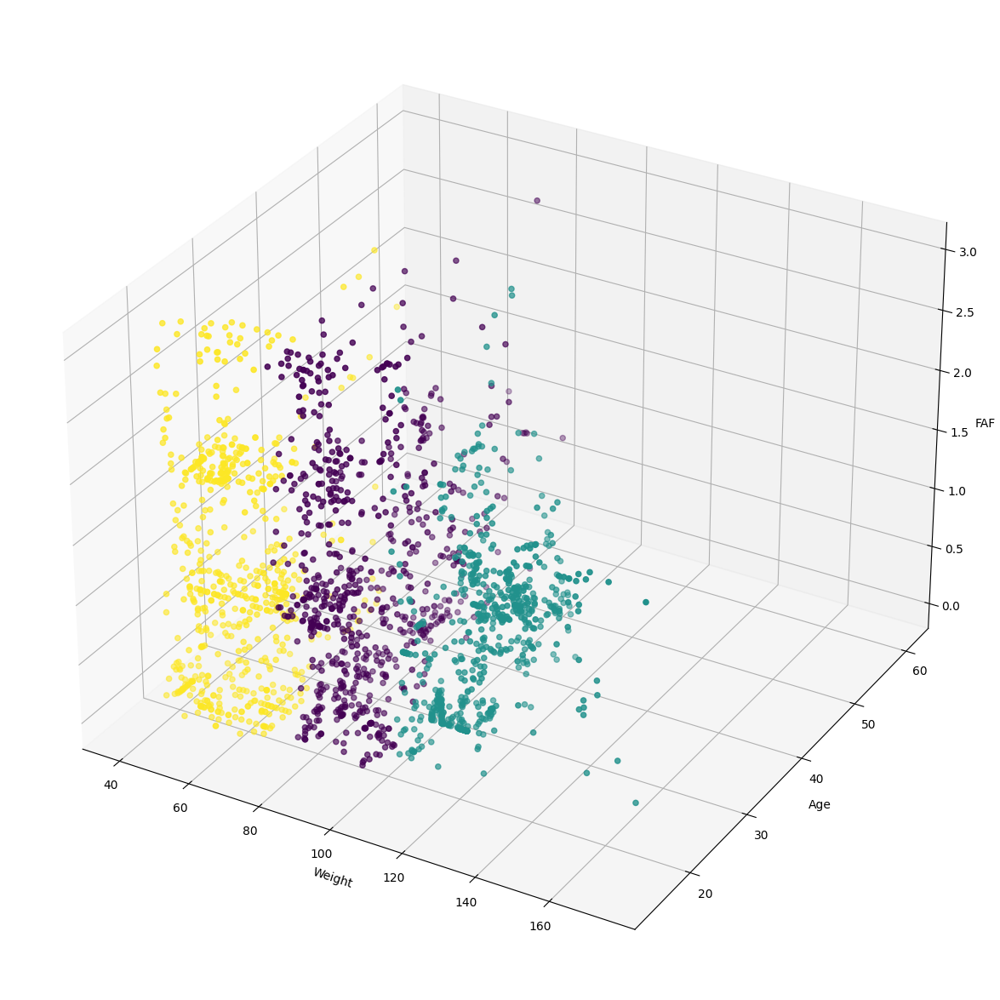

In [85]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Age'], num_data['FAF'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Age')
ax.set_zlabel('FAF')
plt.show()

- K-Means Clustering
    - Weight, Age, TUE

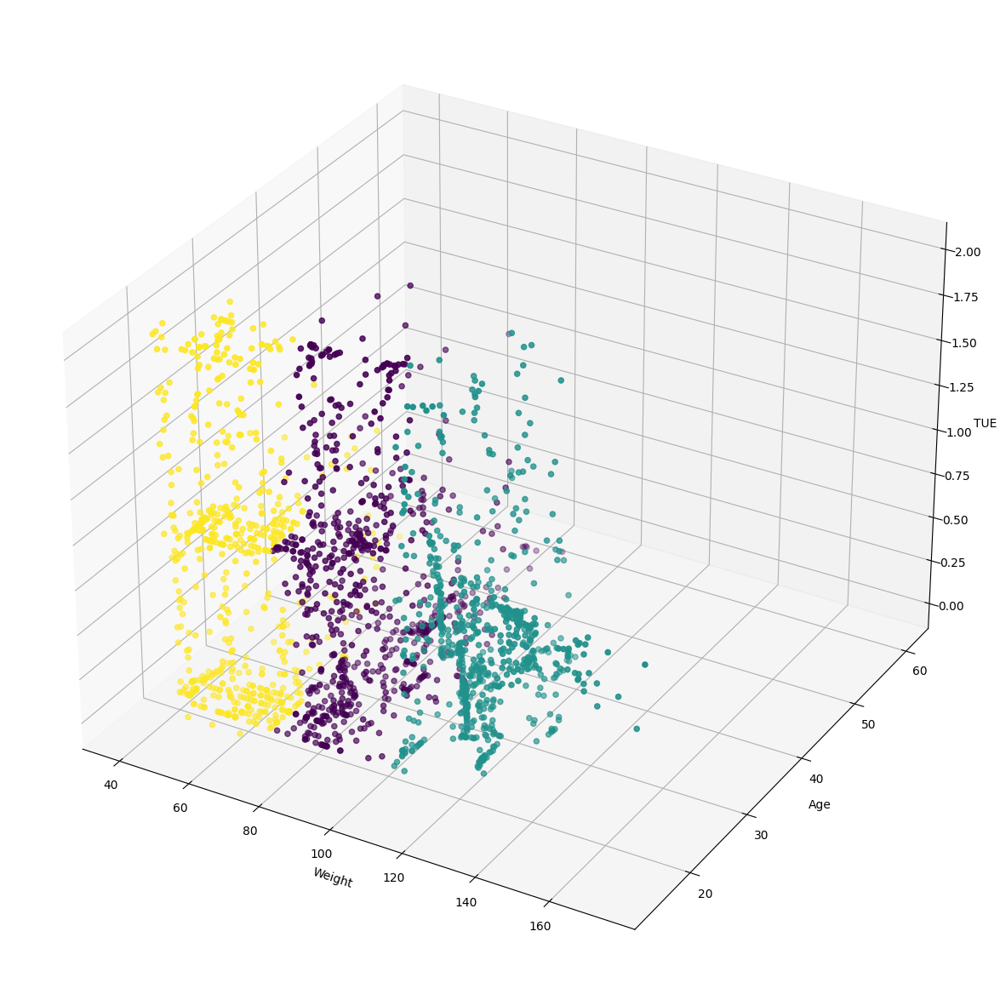

In [86]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Age'], num_data['TUE'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Age')
ax.set_zlabel('TUE')
plt.show()

- K-Means Clustering
    - Weight, Age, Height

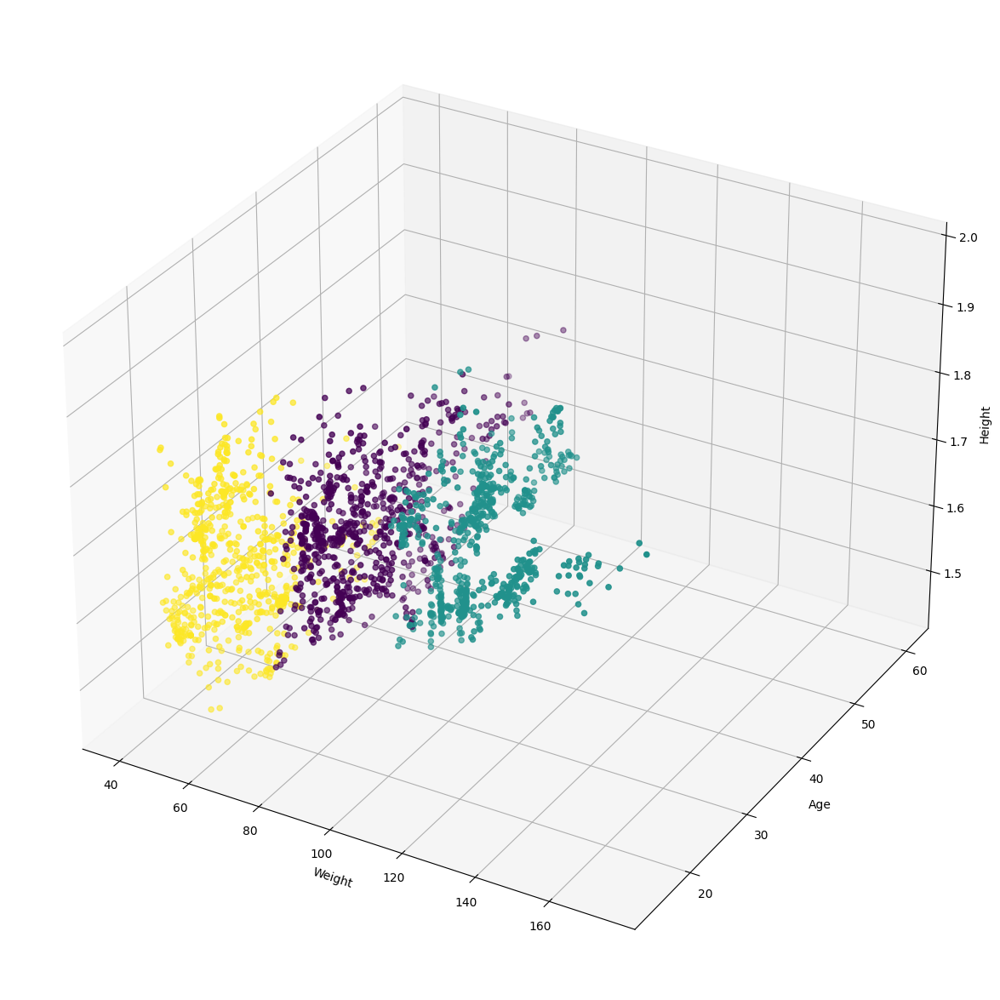

In [98]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Age'], num_data['Height'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Age')
ax.set_zlabel('Height')
plt.show()

- K-Means Clustering
    - Weight, FCVC, NCP

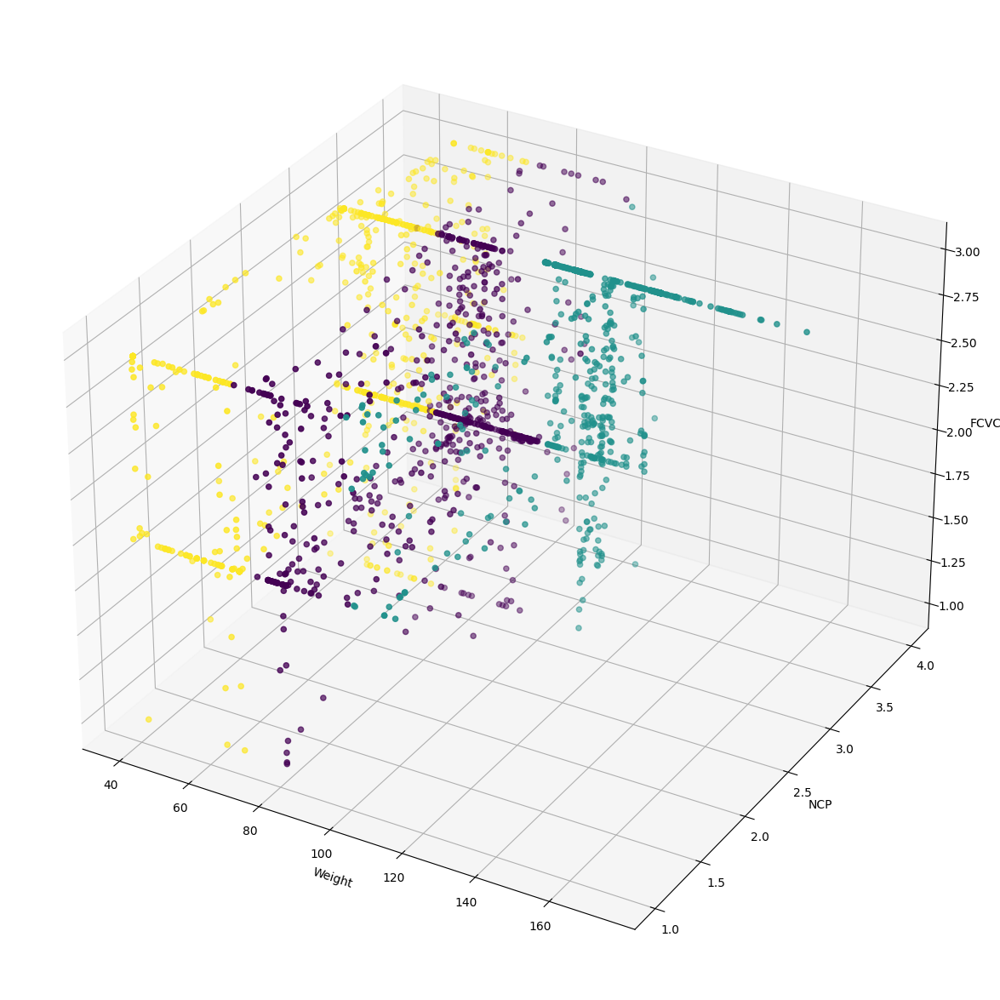

In [87]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['NCP'], num_data['FCVC'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('NCP')
ax.set_zlabel('FCVC')
plt.show()

- K-Means Clustering
    - Weight, FCVC, CH2O

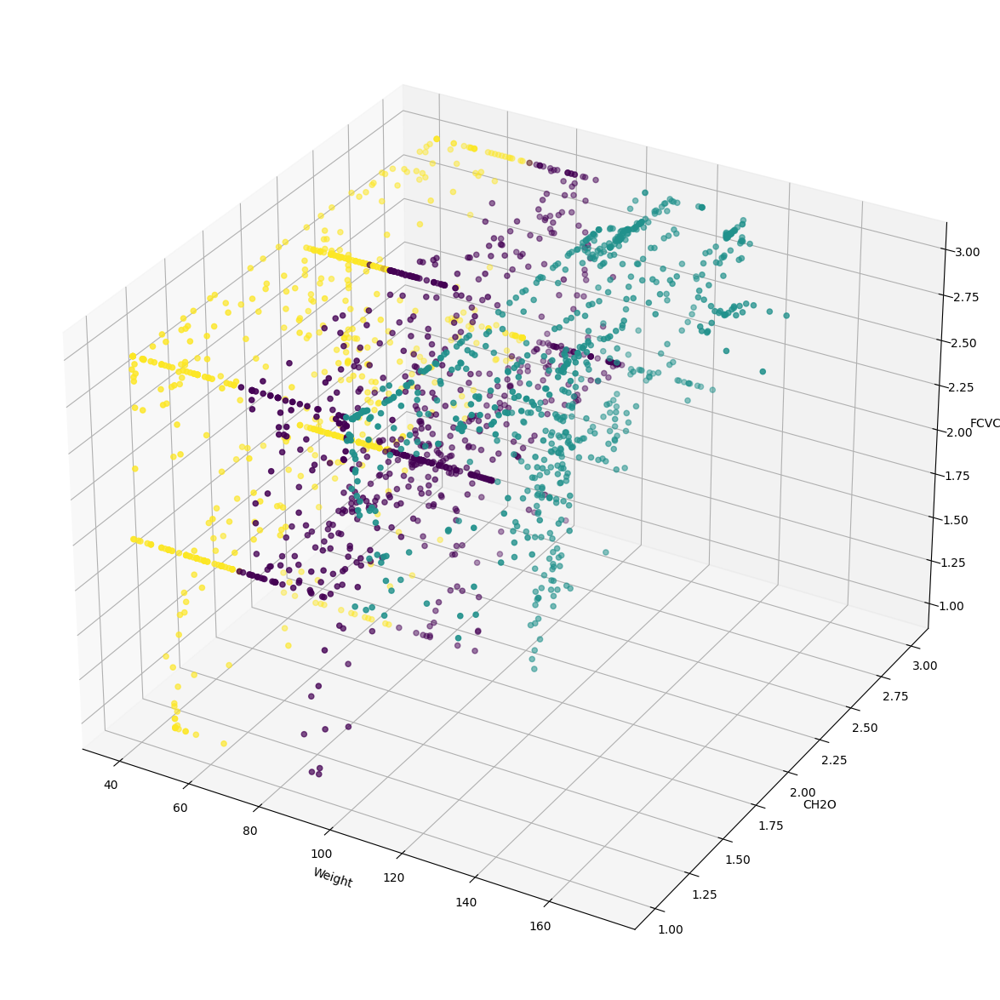

In [88]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['CH2O'], num_data['FCVC'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('CH2O')
ax.set_zlabel('FCVC')
plt.show()

- K-Means Clustering
    - Weight, FCVC, FAF

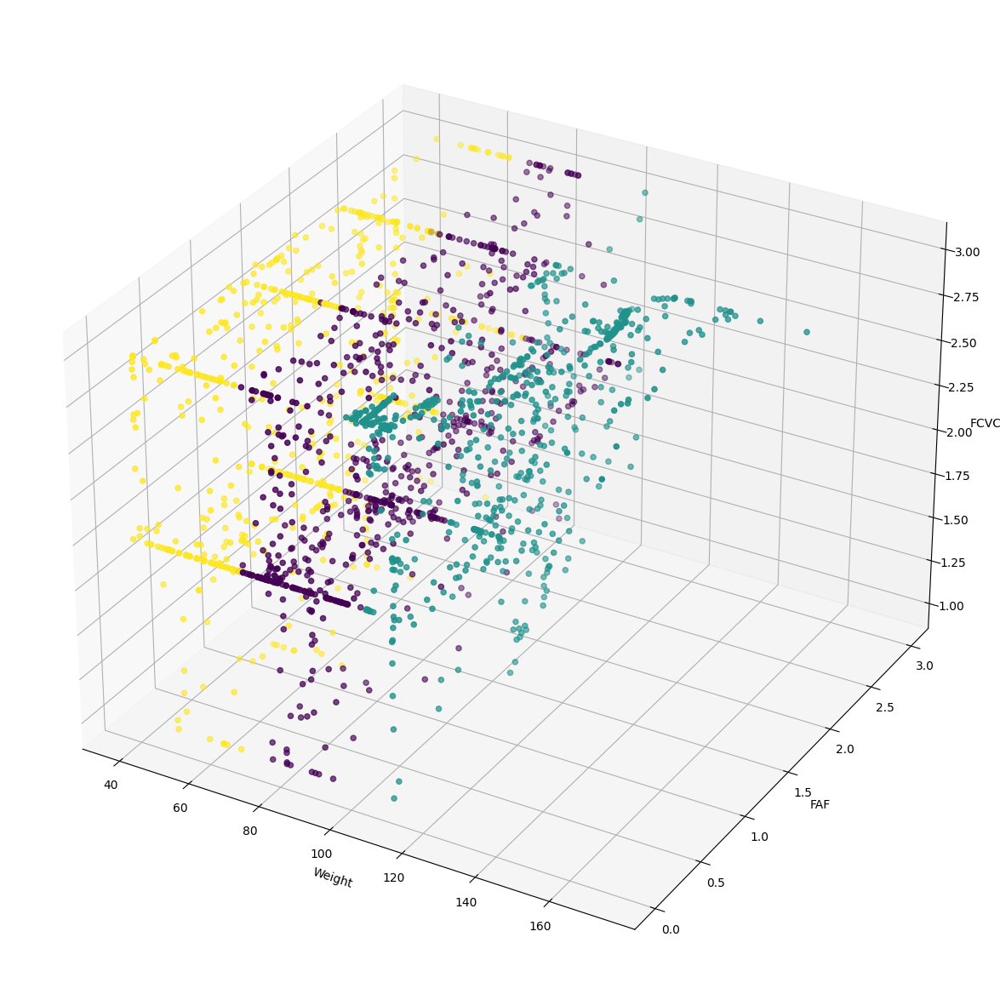

In [89]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['FAF'], num_data['FCVC'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('FAF')
ax.set_zlabel('FCVC')
plt.show()

- K-Means Clustering
    - Weight, FCVC, TUE

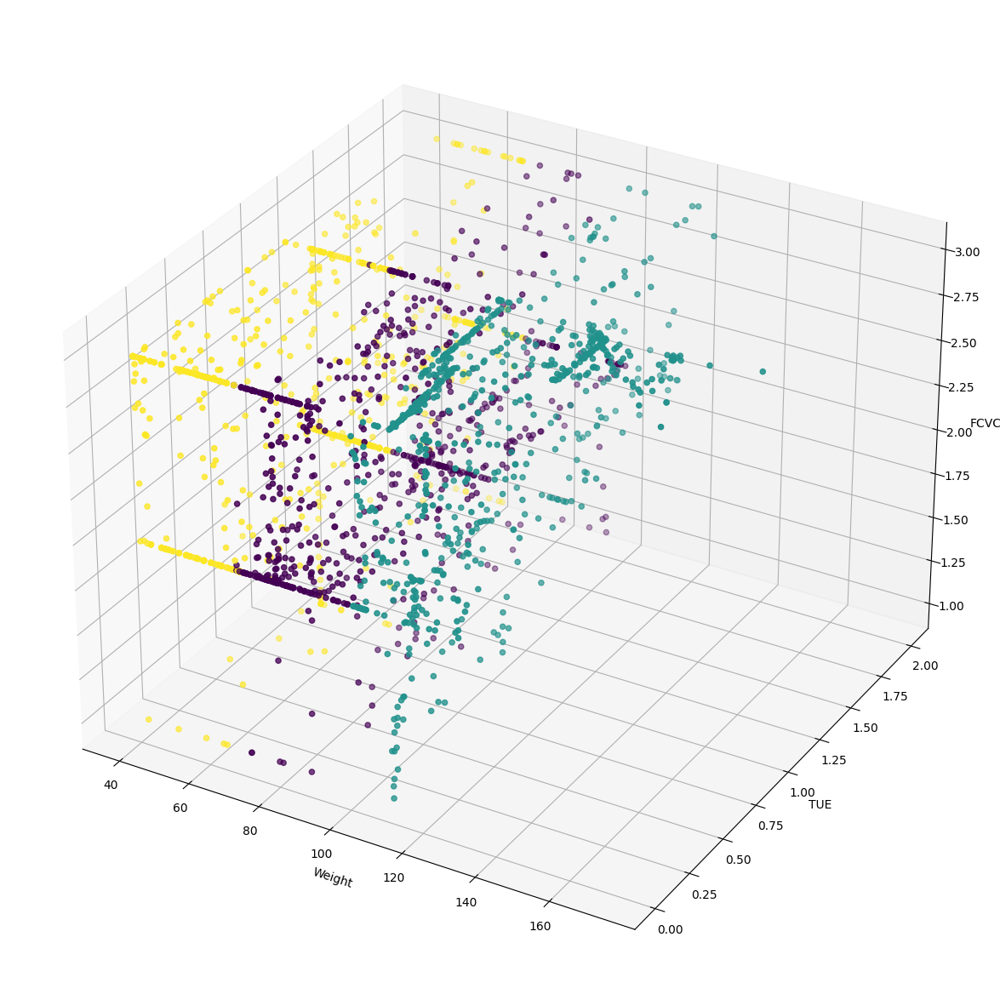

In [90]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['TUE'], num_data['FCVC'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('TUE')
ax.set_zlabel('FCVC')
plt.show()

- K-Means Clustering
    - Weight, FCVC, Height

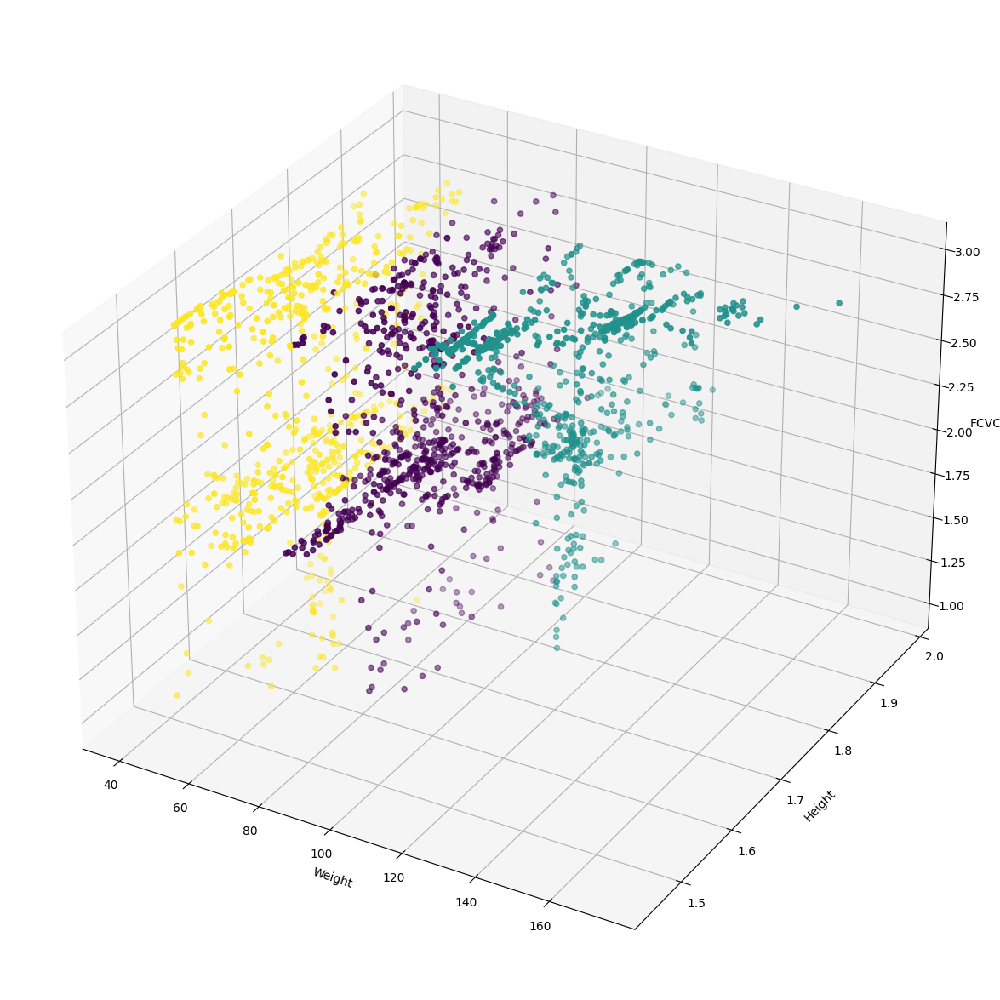

In [99]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Height'], num_data['FCVC'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Height')
ax.set_zlabel('FCVC')
plt.show()

- K-Means Clustering
    - Weight, NCP, CH2O

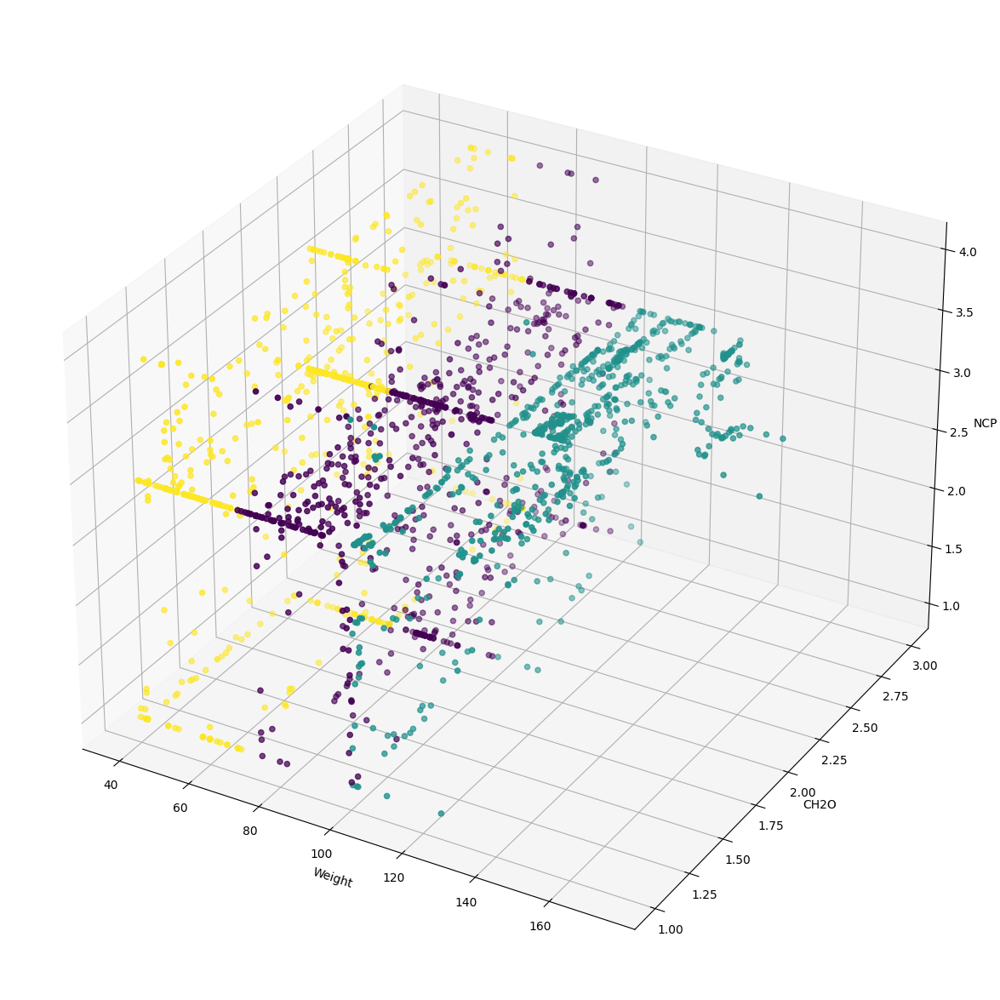

In [91]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['CH2O'], num_data['NCP'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('CH2O')
ax.set_zlabel('NCP')
plt.show()

- K-Means Clustering
    - Weight, NCP, FAF

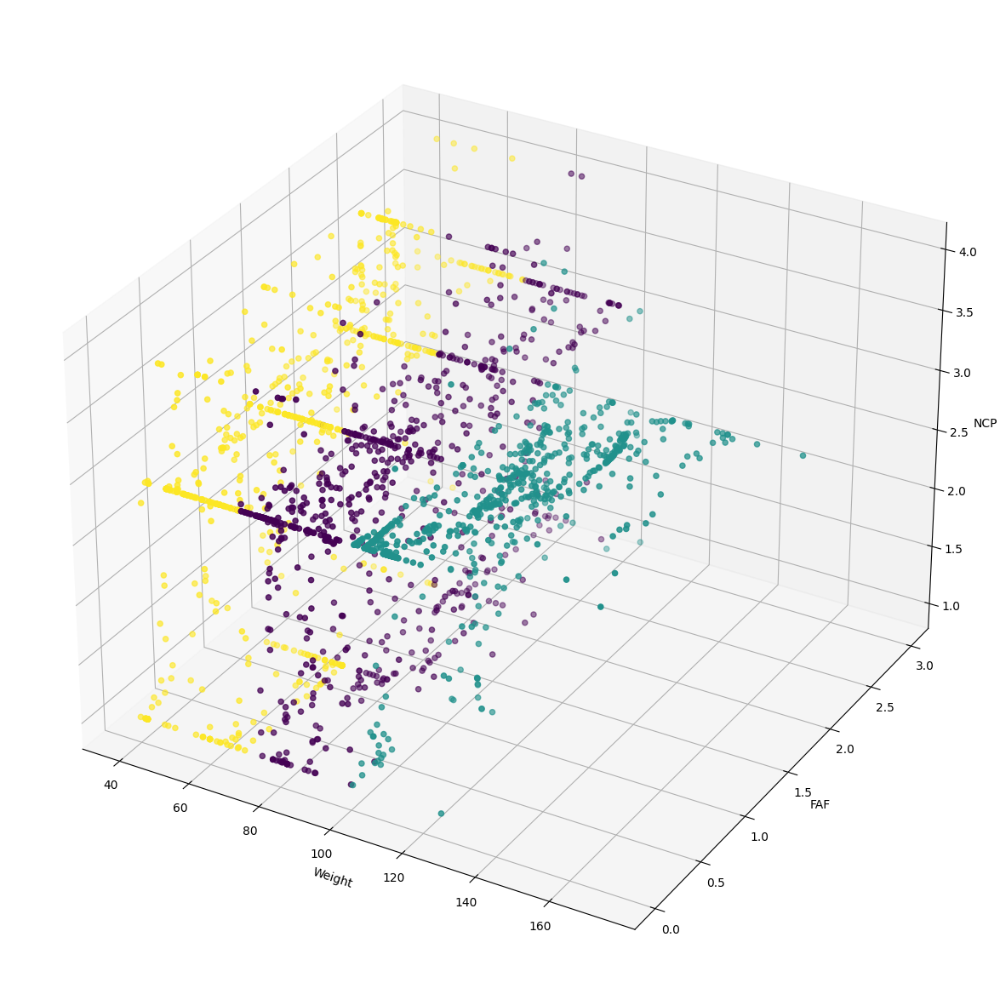

In [92]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['FAF'], num_data['NCP'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('FAF')
ax.set_zlabel('NCP')
plt.show()

- K-Means Clustering
    - Weight, NCP, TUE

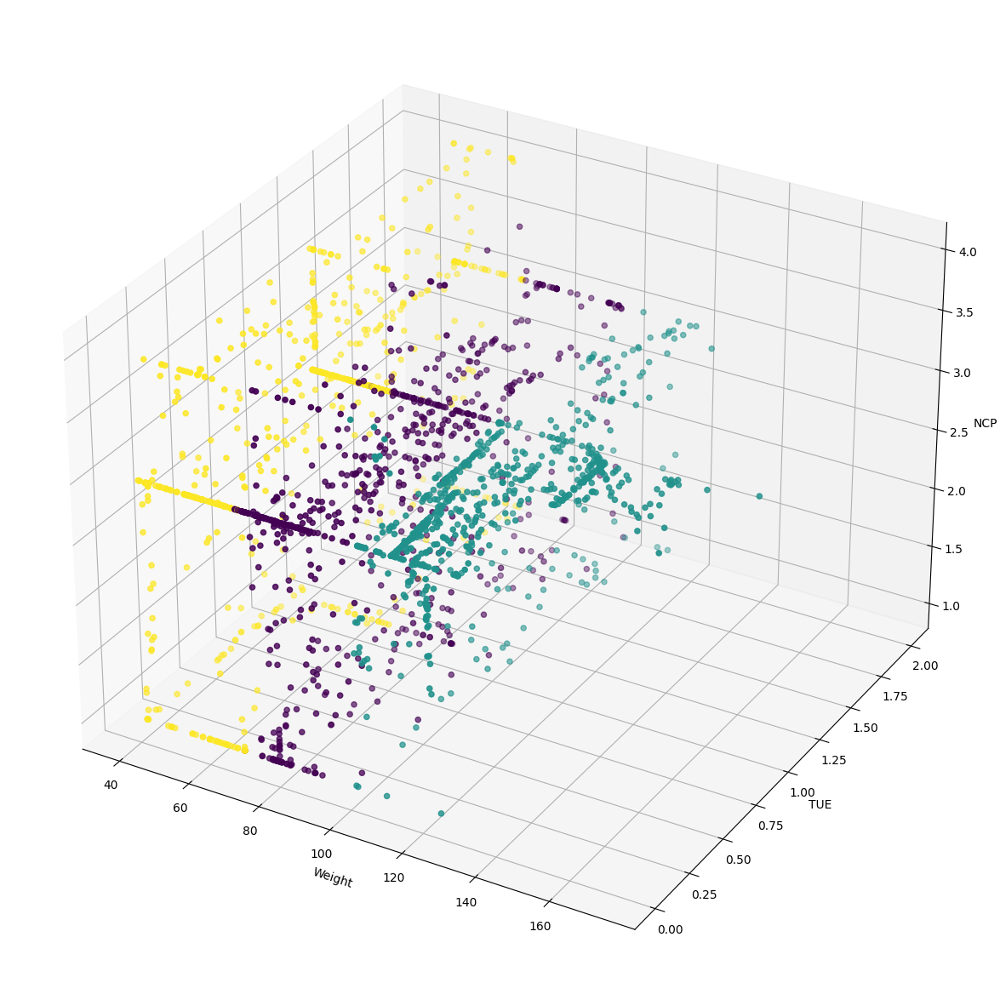

In [93]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['TUE'], num_data['NCP'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('TUE')
ax.set_zlabel('NCP')
plt.show()

- K-Means Clustering
    - Weight, NCP, Height

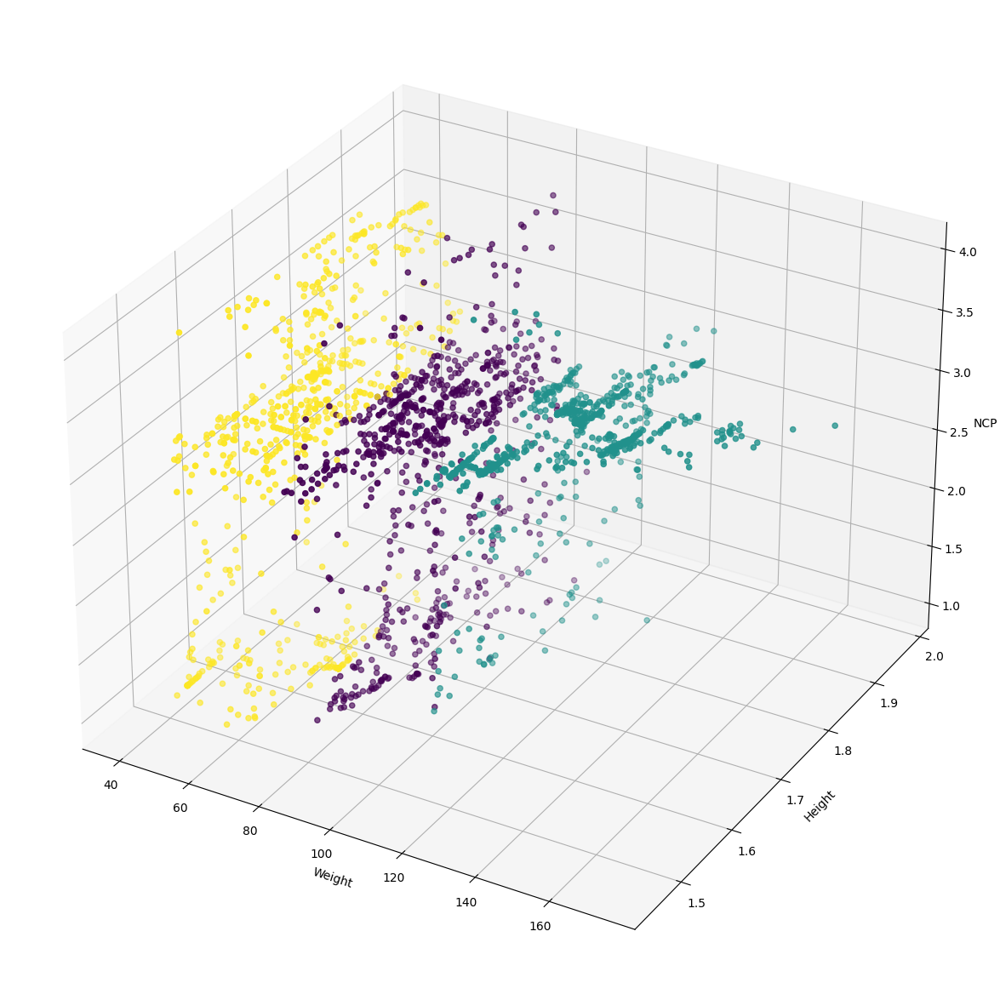

In [100]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Height'], num_data['NCP'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Height')
ax.set_zlabel('NCP')
plt.show()

- K-Means Clustering
    - Weight, CH2O, FAF

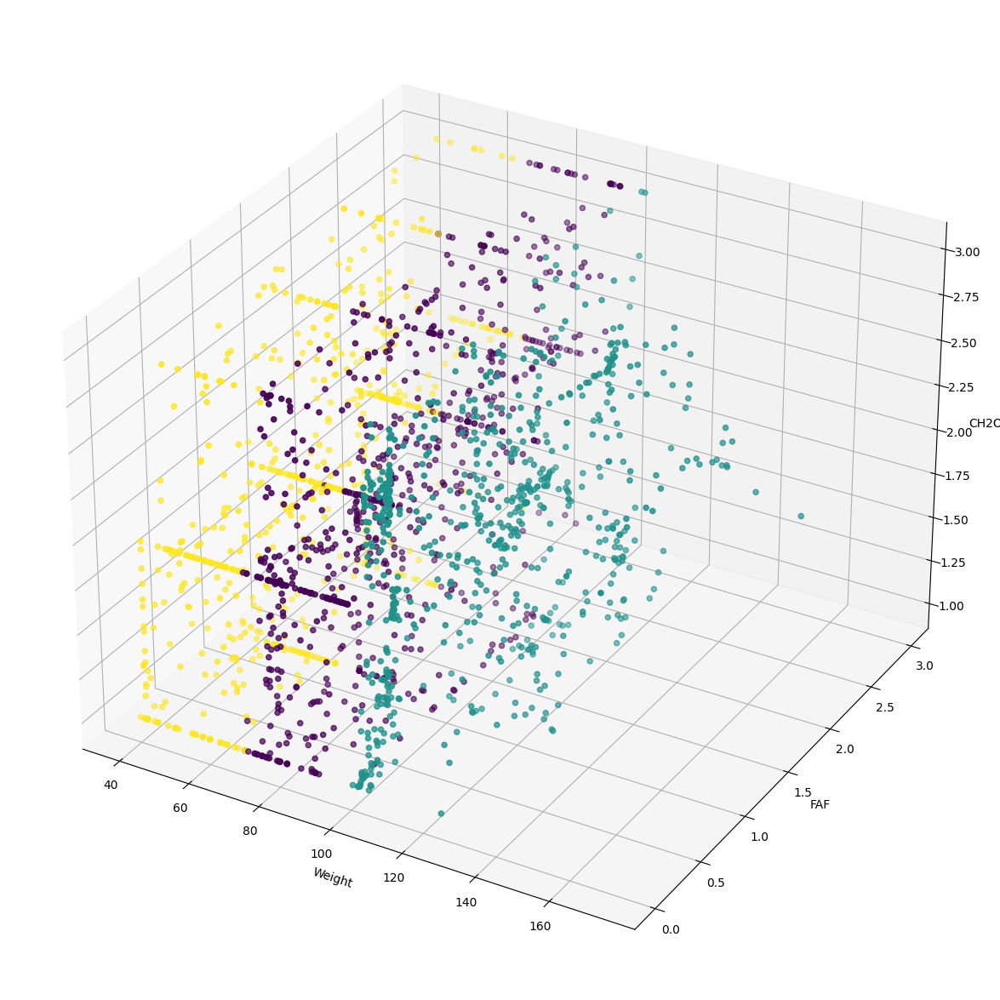

In [94]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['FAF'], num_data['CH2O'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('FAF')
ax.set_zlabel('CH2O')
plt.show()

- K-Means Clustering
    - Weight, CH2O, TUE

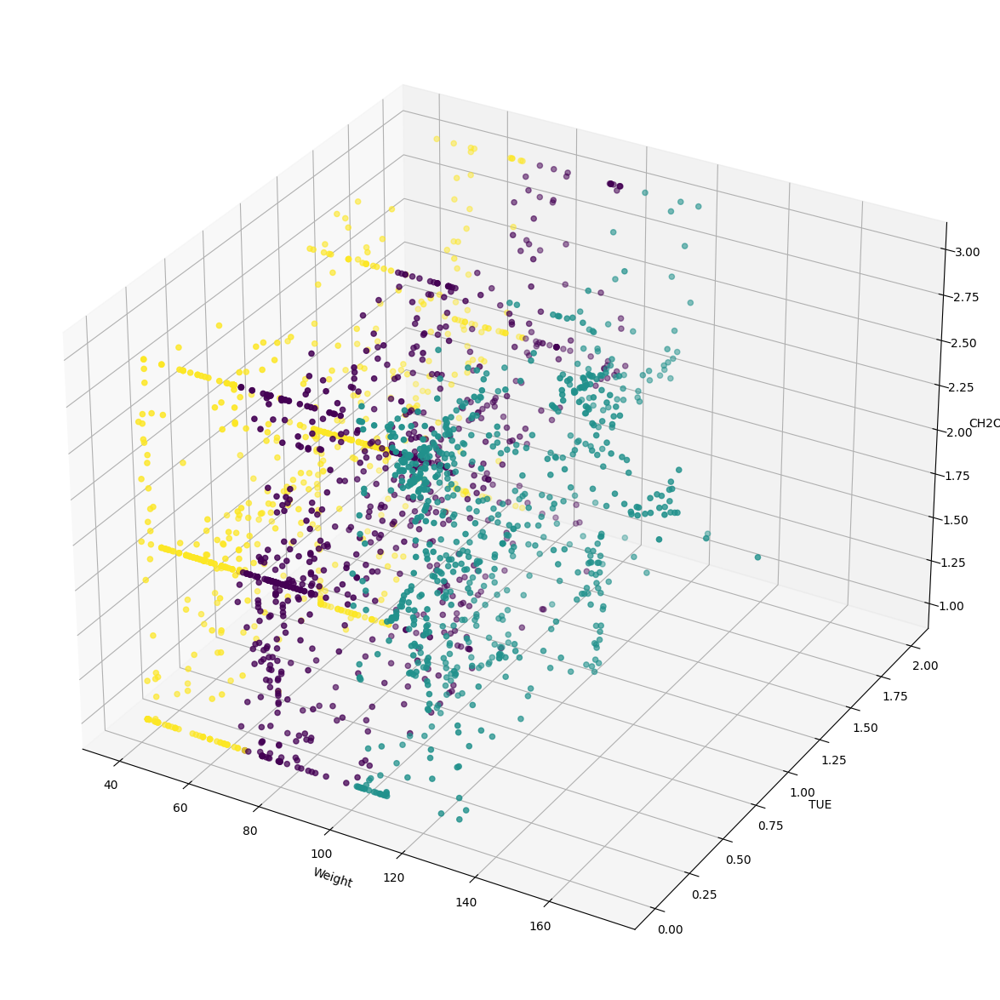

In [95]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['TUE'], num_data['CH2O'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('TUE')
ax.set_zlabel('CH2O')
plt.show()

- K-Means Clustering
    - Weight, CH2O, Height

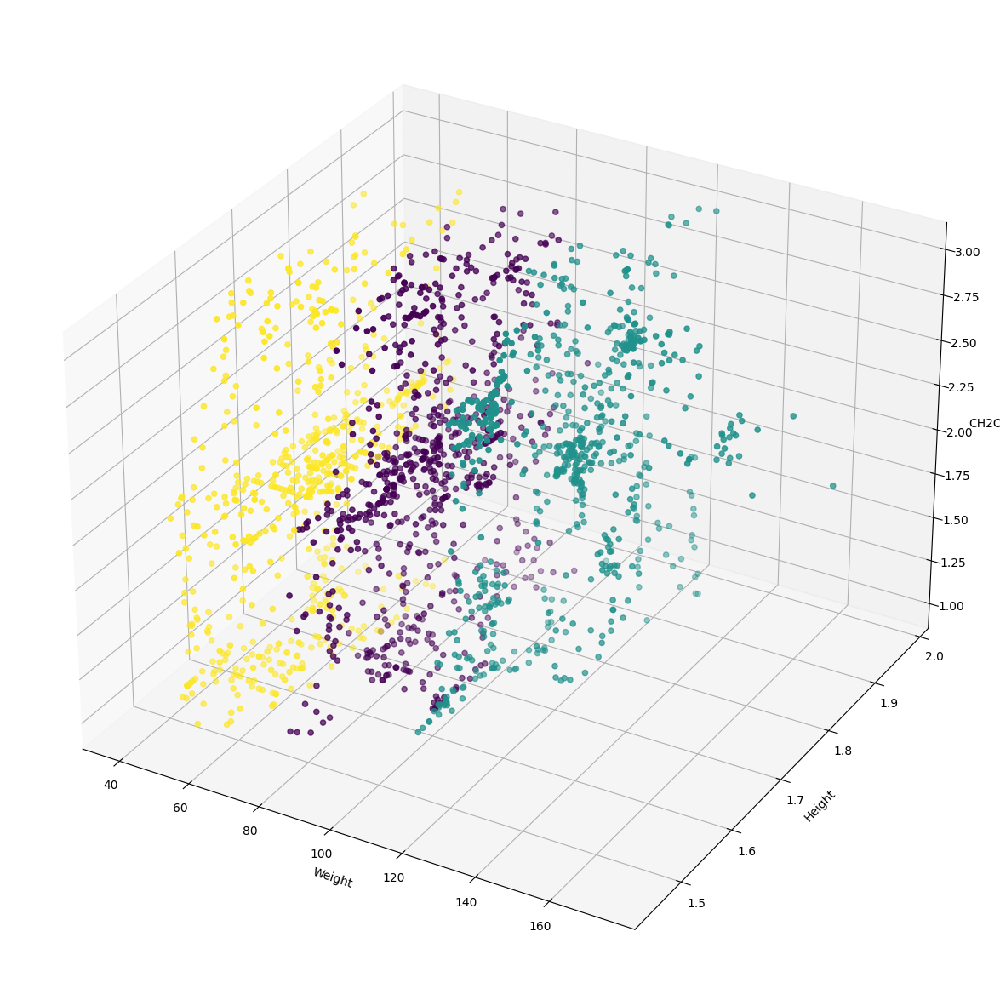

In [101]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Height'], num_data['CH2O'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Height')
ax.set_zlabel('CH2O')
plt.show()

- K-Means Clustering
    - Weight, TUE, FAF

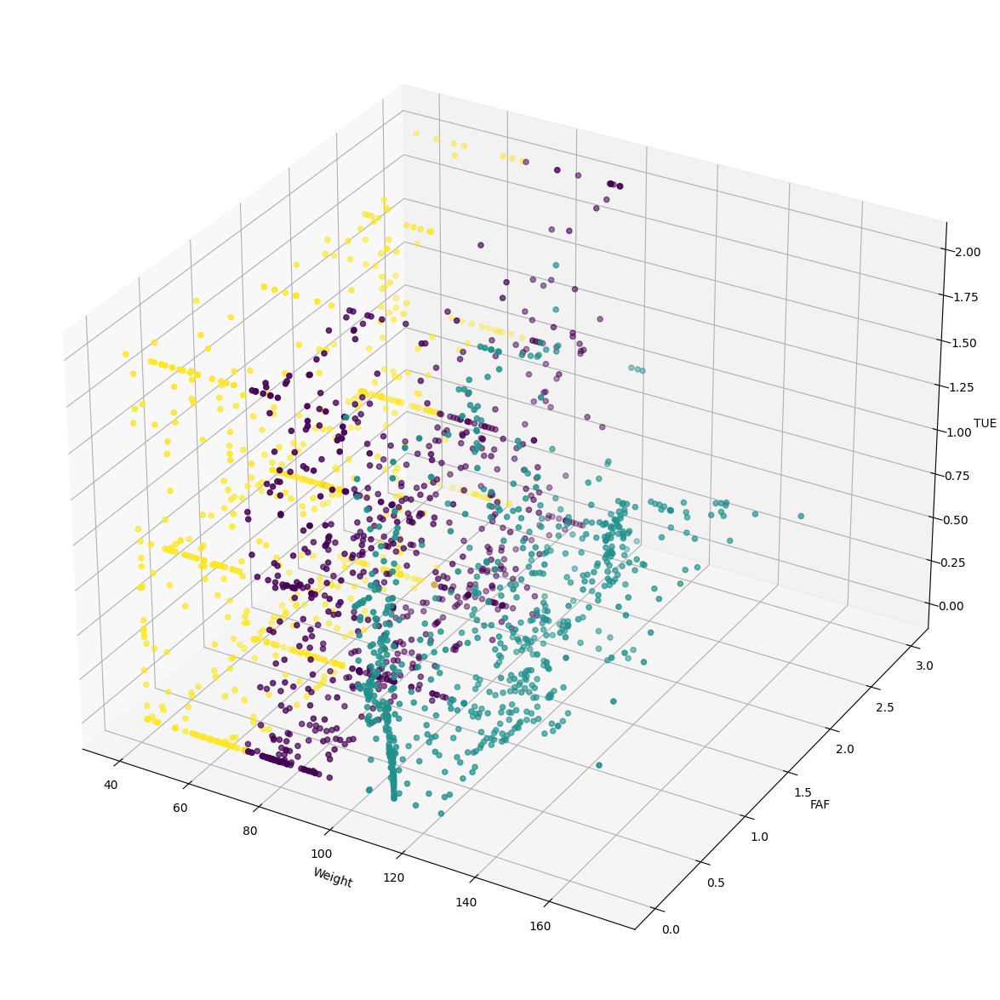

In [96]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['FAF'], num_data['TUE'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('FAF')
ax.set_zlabel('TUE')
plt.show()

- K-Means Clustering
    - Weight, TUE, Height

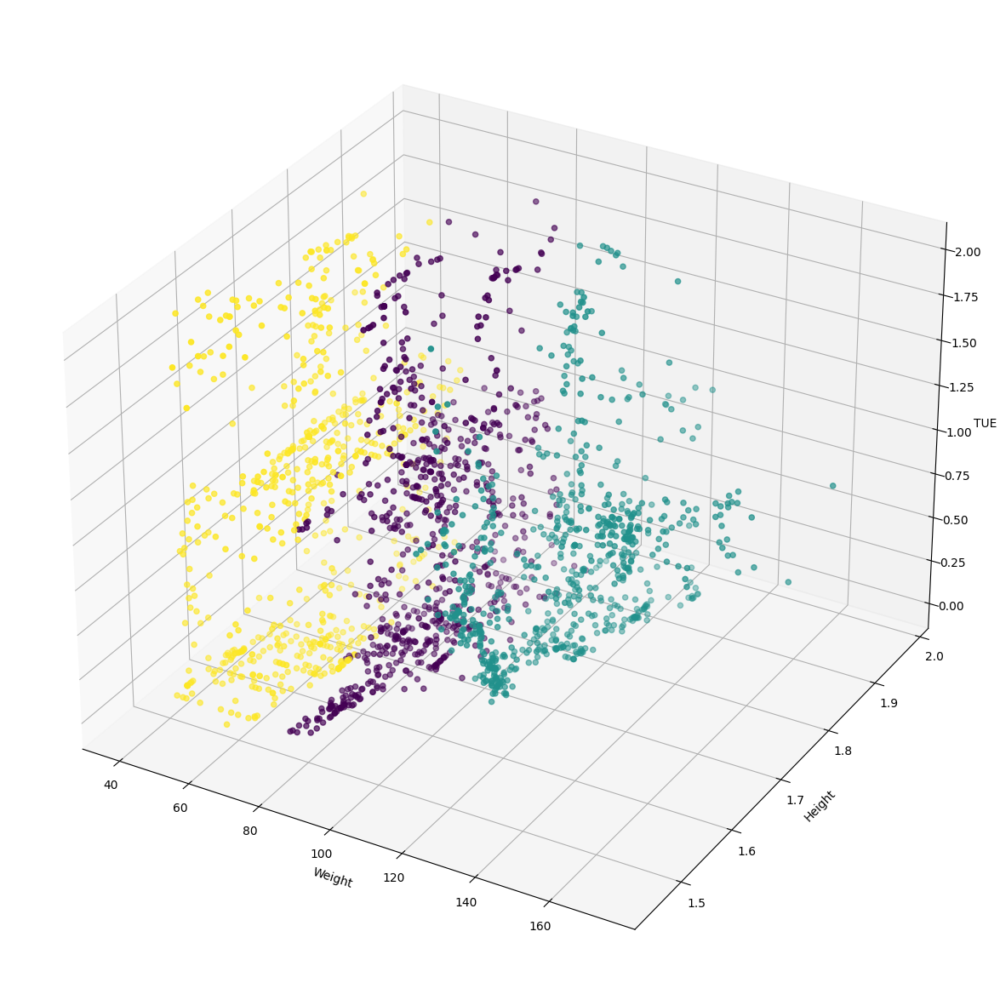

In [102]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['Height'], num_data['TUE'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('Height')
ax.set_zlabel('TUE')
plt.show()

- K-Means Clustering
    - Weight, FAF, Height

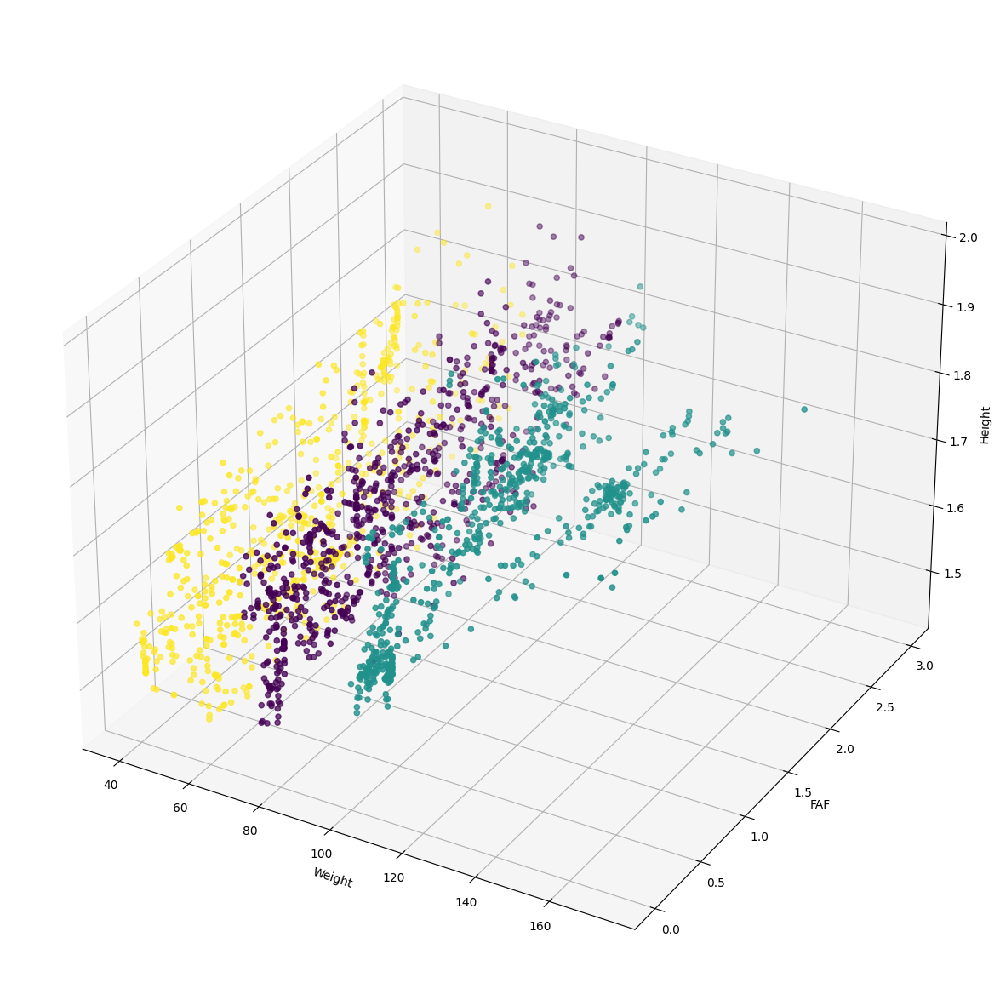

In [97]:
plt.figure(figsize=(15, 15))
ax = plt.axes(projection="3d")
ax.scatter3D(num_data['Weight'], num_data['FAF'], num_data['Height'], c=cluster)

ax.set_xlabel('Weight')
ax.set_ylabel('FAF')
ax.set_zlabel('Height')
plt.show()

K-Means Clustering is used to group data which has not been explicitly labeled this can be quite useful when trying to confirm assumptions about the types of groups that are being formed in the data because a group will form only if a visible relation exists between the concerned variables otherwise no such grouping will take place. K-Means Clustering thus provides us with a possible combination of variables that may be having a significant impact on predictive analysis

- Multiple Linear Regression
    - Predicting Weight based on Age and Height

In [24]:
x = df[['Age', 'Height']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.507468
1838,155.872093,98.088865
2083,113.077187,81.741728
1105,96.945262,101.768498
361,80.000000,81.362144


In [20]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.03950415128007
Mean Absolute Error: 18.307346884359912
Mean Square Error: 496.18921260446183
Root Mean Square Error: 22.27530499464512


- Multiple Linear Regression
    - Predicting Weight based on Age and FCVC

In [21]:
x = df[['Age', 'FCVC']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.415856
1838,155.872093,90.755684
2083,113.077187,93.702429
1105,96.945262,75.912457
361,80.000000,95.320264


In [23]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.568664293579475
Mean Absolute Error: 20.568898592430223
Mean Square Error: 614.3535263317395
Root Mean Square Error: 24.78615594100343


- Multiple Linear Regression
    - Predicting Weight based on Age and NCP

In [24]:
x = df[['Age', 'NCP']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,72.936787
1838,155.872093,85.139732
2083,113.077187,88.220632
1105,96.945262,85.051264
361,80.000000,94.026733


In [25]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.4462633919694525
Mean Absolute Error: 20.649528339495625
Mean Square Error: 619.7607572886021
Root Mean Square Error: 24.894994623188857


- Multiple Linear Regression
    - Predicting Weight based on Age and CH2O

In [26]:
x = df[['Age', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,79.289753
1838,155.872093,87.815340
2083,113.077187,93.123320
1105,96.945262,89.874513
361,80.000000,101.068784


In [27]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.452631370583951
Mean Absolute Error: 20.73705244821516
Mean Square Error: 613.7714277211713
Root Mean Square Error: 24.774410744176567


- Multiple Linear Regression
    - Predicting Weight based on Age and FAF

In [28]:
x = df[['Age', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,80.045992
1838,155.872093,84.021728
2083,113.077187,87.323342
1105,96.945262,85.060088
361,80.000000,99.701892


In [29]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  4.1366591693800085
Mean Absolute Error: 20.874718902257825
Mean Square Error: 627.6921681359426
Root Mean Square Error: 25.05378550510766


- Multiple Linear Regression
    - Predicting Weight based on Age and TUE

In [30]:
x = df[['Age', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,79.796863
1838,155.872093,83.961961
2083,113.077187,86.971151
1105,96.945262,85.384192
361,80.000000,100.370666


In [31]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  4.091633404557005
Mean Absolute Error: 20.900847954693194
Mean Square Error: 628.2963240052245
Root Mean Square Error: 25.065839782565124


- Multiple Linear Regression
    - Predicting Weight based on Height and FCVC

In [32]:
x = df[['Height', 'FCVC']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.049001
1838,155.872093,108.107467
2083,113.077187,88.611443
1105,96.945262,93.305022
361,80.000000,62.555191


In [33]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.892944151640584
Mean Absolute Error: 18.405672774748847
Mean Square Error: 501.4573782329001
Root Mean Square Error: 22.393244031021947


- Multiple Linear Regression
    - Predicting Weight based on Height and NCP

In [34]:
x = df[['Height', 'NCP']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.975046
1838,155.872093,100.914172
2083,113.077187,81.497243
1105,96.945262,103.228649
361,80.000000,68.063359


In [35]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  21.42485271473967
Mean Absolute Error: 18.929755941774694
Mean Square Error: 529.7215325960066
Root Mean Square Error: 23.015680146283024


- Multiple Linear Regression
    - Predicting Weight based on Height and CH2O

In [36]:
x = df[['Height', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,74.280357
1838,155.872093,102.180946
2083,113.077187,84.966323
1105,96.945262,104.525453
361,80.000000,68.714683


In [37]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  22.50325773149414
Mean Absolute Error: 18.93320240013489
Mean Square Error: 525.3319011525405
Root Mean Square Error: 22.9201200073765


- Multiple Linear Regression
    - Predicting Weight based on Height and FAF

In [38]:
x = df[['Height', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.983626
1838,155.872093,103.058397
2083,113.077187,85.445413
1105,96.945262,100.587258
361,80.000000,59.122806


In [39]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  25.293502901248786
Mean Absolute Error: 18.388020047426487
Mean Square Error: 502.09315396651647
Root Mean Square Error: 22.407435238476456


- Multiple Linear Regression
    - Predicting Weight based on Height and TUE

In [40]:
x = df[['Height', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,72.060024
1838,155.872093,101.326934
2083,113.077187,82.887612
1105,96.945262,98.938791
361,80.000000,69.834208


In [41]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  22.320171524363662
Mean Absolute Error: 18.802514423970354
Mean Square Error: 519.9546549425684
Root Mean Square Error: 22.802514224150116


- Multiple Linear Regression
    - Predicting Weight based on FCVC and NCP

In [42]:
x = df[['FCVC', 'NCP']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,82.733516
1838,155.872093,94.569646
2083,113.077187,94.569646
1105,96.945262,77.042852
361,80.000000,76.488353


In [43]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.579609095825222
Mean Absolute Error: 20.729718980979527
Mean Square Error: 630.1273679711146
Root Mean Square Error: 25.10233789851285


- Multiple Linear Regression
    - Predicting Weight based on FCVC and CH2O

In [44]:
x = df[['FCVC', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,88.137982
1838,155.872093,96.808029
2083,113.077187,98.684066
1105,96.945262,81.706363
361,80.000000,82.145377


In [45]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.04819676268227
Mean Absolute Error: 20.488727758896534
Mean Square Error: 624.4123831207388
Root Mean Square Error: 24.988244898766677


- Multiple Linear Regression
    - Predicting Weight based on FCVC and FAF

In [46]:
x = df[['FCVC', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,88.815698
1838,155.872093,93.766055
2083,113.077187,94.791199
1105,96.945262,75.970801
361,80.000000,80.382563


In [47]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  4.920068549276612
Mean Absolute Error: 20.762189315722495
Mean Square Error: 633.8662600443206
Root Mean Square Error: 25.176700737871126


- Multiple Linear Regression
    - Predicting Weight based on FCVC and TUE

In [48]:
x = df[['FCVC', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,87.652320
1838,155.872093,93.675167
2083,113.077187,94.151953
1105,96.945262,75.336062
361,80.000000,83.036133


In [49]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  4.840435540039012
Mean Absolute Error: 20.840569981777623
Mean Square Error: 633.6926366782362
Root Mean Square Error: 25.1732524056435


- Multiple Linear Regression
    - Predicting Weight based on NCP and CH2O

In [50]:
x = df[['NCP', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.275997
1838,155.872093,91.550434
2083,113.077187,93.515723
1105,96.945262,90.741441
361,80.000000,81.275997


In [51]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  4.906467046277719
Mean Absolute Error: 20.82882593713393
Mean Square Error: 630.6009255572011
Root Mean Square Error: 25.11176866644803


- Multiple Linear Regression
    - Predicting Weight based on NCP and FAF

In [52]:
x = df[['NCP', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,80.768836
1838,155.872093,88.182469
2083,113.077187,89.498115
1105,96.945262,85.019843
361,80.000000,78.133109


In [53]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  1.5810039914151197
Mean Absolute Error: 20.893558932005426
Mean Square Error: 640.5421852772333
Root Mean Square Error: 25.3089348902168


- Multiple Linear Regression
    - Predicting Weight based on NCP and TUE

In [54]:
x = df[['NCP', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,79.454871
1838,155.872093,88.186732
2083,113.077187,88.998542
1105,96.945262,83.202780
361,80.000000,82.273587


In [55]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  1.7005367465217414
Mean Absolute Error: 20.987460860357334
Mean Square Error: 637.3857067963406
Root Mean Square Error: 25.24649890175548


- Multiple Linear Regression
    - Predicting Weight based on CH2O and FAF

In [58]:
x = df[['CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,87.543629
1838,155.872093,91.017002
2083,113.077187,94.866137
1105,96.945262,89.483145
361,80.000000,84.120671


In [59]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  4.726437524273763
Mean Absolute Error: 20.77406134135403
Mean Square Error: 631.038085358591
Root Mean Square Error: 25.120471439815596


- Multiple Linear Regression
    - Predicting Weight based on CH2O and TUE

In [56]:
x = df[['CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,85.660887
1838,155.872093,90.833567
2083,113.077187,93.644370
1105,96.945262,87.925413
361,80.000000,88.398228


In [57]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  4.511177193568249
Mean Absolute Error: 20.94457621183795
Mean Square Error: 630.6645283376758
Root Mean Square Error: 25.113035028400606


- Multiple Linear Regression
    - Predicting Weight based on FAF and TUE

In [60]:
x = df[['FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,86.276869
1838,155.872093,87.070357
2083,113.077187,88.689834
1105,96.945262,82.870948
361,80.000000,86.996411


In [61]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  0.7104990494517627
Mean Absolute Error: 21.03170552784066
Mean Square Error: 643.4289377191151
Root Mean Square Error: 25.365901082341132


- Multiple Linear Regression
    - Predicting Weight based on Age, Height and FCVC

In [18]:
x = df[['Age', 'Height', 'FCVC']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.070184
1838,155.872093,105.208590
2083,113.077187,88.653710
1105,96.945262,92.094834
361,80.000000,76.013152


In [19]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  31.353802453368885
Mean Absolute Error: 17.833381932326628
Mean Square Error: 468.73893835859417
Root Mean Square Error: 21.65037963543813


- Multiple Linear Regression
    - Predicting Weight based on Age, Height and NCP

In [20]:
x = df[['Age', 'Height', 'NCP']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.377007
1838,155.872093,98.096201
2083,113.077187,81.775428
1105,96.945262,101.739831
361,80.000000,81.250286


In [21]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.040262125575563
Mean Absolute Error: 18.301898319081843
Mean Square Error: 496.1816346980845
Root Mean Square Error: 22.2751348974161


- Multiple Linear Regression
    - Predicting Weight based on Age, Height and CH2O

In [22]:
x = df[['Age', 'Height', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,67.029756
1838,155.872093,99.369460
2083,113.077187,85.471960
1105,96.945262,103.248674
361,80.000000,82.904120


In [23]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.3062864905549
Mean Absolute Error: 18.325887994409577
Mean Square Error: 492.01749935583524
Root Mean Square Error: 22.181467475255896


- Multiple Linear Regression
    - Predicting Weight based on Age, Height and FAF

In [24]:
x = df[['Age', 'Height', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,67.691610
1838,155.872093,100.239424
2083,113.077187,85.004329
1105,96.945262,99.754564
361,80.000000,72.387605


In [25]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  28.84621298333553
Mean Absolute Error: 17.774969185309793
Mean Square Error: 475.18859930428636
Root Mean Square Error: 21.79882105308189


- Multiple Linear Regression
    - Predicting Weight based on Age, Height and TUE

In [26]:
x = df[['Age', 'Height', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.258158
1838,155.872093,98.306019
2083,113.077187,82.143964
1105,96.945262,100.488298
361,80.000000,81.574571


In [27]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.145314749603653
Mean Absolute Error: 18.30793454065146
Mean Square Error: 494.7619396868279
Root Mean Square Error: 22.243244810207614


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC and NCP

In [28]:
x = df[['Age', 'FCVC', 'NCP']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.117205
1838,155.872093,91.693913
2083,113.077187,94.712066
1105,96.945262,75.777929
361,80.000000,89.639815


In [29]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.723198953535094
Mean Absolute Error: 20.36194933369622
Mean Square Error: 606.6088891150454
Root Mean Square Error: 24.629431359961306


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC and CH2O

In [30]:
x = df[['Age', 'FCVC', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,80.835767
1838,155.872093,93.931031
2083,113.077187,99.034143
1105,96.945262,80.679809
361,80.000000,96.296187


In [31]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  12.357593500574982
Mean Absolute Error: 20.247652170533083
Mean Square Error: 601.738685138668
Root Mean Square Error: 24.530362515435193


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC and FAF

In [32]:
x = df[['Age', 'FCVC', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.720628
1838,155.872093,90.844229
2083,113.077187,94.159359
1105,96.945262,75.461447
361,80.000000,94.492490


In [33]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.638097146368073
Mean Absolute Error: 20.533528242703394
Mean Square Error: 613.4183178268196
Root Mean Square Error: 24.76728321449124


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC and TUE

In [34]:
x = df[['Age', 'FCVC', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.607816
1838,155.872093,90.659456
2083,113.077187,93.408889
1105,96.945262,76.941412
361,80.000000,95.061126


In [35]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.566782580984643
Mean Absolute Error: 20.56418892070073
Mean Square Error: 615.0816996819298
Root Mean Square Error: 24.800840705144044


- Multiple Linear Regression
    - Predicting Weight based on Age, NCP and CH2O

In [36]:
x = df[['Age', 'NCP', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.155641
1838,155.872093,88.775985
2083,113.077187,94.094592
1105,96.945262,89.437249
361,80.000000,95.375578


In [37]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.55565258855967
Mean Absolute Error: 20.438011302456825
Mean Square Error: 606.4885838292796
Root Mean Square Error: 24.62698893144023


- Multiple Linear Regression
    - Predicting Weight based on Age, NCP and FAF

In [38]:
x = df[['Age', 'NCP', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.162824
1838,155.872093,85.322135
2083,113.077187,89.028673
1105,96.945262,84.297024
361,80.000000,92.377340


In [39]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.582817436837651
Mean Absolute Error: 20.62584292189734
Mean Square Error: 618.4598722516517
Root Mean Square Error: 24.86885345671673


- Multiple Linear Regression
    - Predicting Weight based on Age, NCP and TUE

In [40]:
x = df[['Age', 'NCP', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,72.898753
1838,155.872093,85.167783
2083,113.077187,88.284146
1105,96.945262,84.852312
361,80.000000,94.060717


In [41]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.455806405985896
Mean Absolute Error: 20.646912745666633
Mean Square Error: 619.5652133050572
Root Mean Square Error: 24.891066937860604


- Multiple Linear Regression
    - Predicting Weight based on Age, CH2O and FAF

In [44]:
x = df[['Age', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,80.066087
1838,155.872093,88.158663
2083,113.077187,94.515532
1105,96.945262,88.882665
361,80.000000,98.938481


In [45]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.779941103908861
Mean Absolute Error: 20.587088849169938
Mean Square Error: 610.6768062361199
Root Mean Square Error: 24.7118758137888


- Multiple Linear Regression
    - Predicting Weight based on Age, CH2O and TUE

In [42]:
x = df[['Age', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,79.292376
1838,155.872093,87.813154
2083,113.077187,93.118260
1105,96.945262,89.890729
361,80.000000,101.065578


In [43]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.451924194141602
Mean Absolute Error: 20.73738469742782
Mean Square Error: 613.7877209031051
Root Mean Square Error: 24.77473957286141


- Multiple Linear Regression
    - Predicting Weight based on Age, FAF and TUE

In [46]:
x = df[['Age', 'TUE', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,80.043432
1838,155.872093,84.023800
2083,113.077187,87.328065
1105,96.945262,85.044834
361,80.000000,99.705126


In [47]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  4.137311253633347
Mean Absolute Error: 20.874404662312788
Mean Square Error: 627.6774145969747
Root Mean Square Error: 25.053491066056537


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC and NCP

In [48]:
x = df[['Height', 'FCVC', 'NCP']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,76.050094
1838,155.872093,108.065720
2083,113.077187,88.374486
1105,96.945262,93.486283
361,80.000000,63.471369


In [49]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.925594044220446
Mean Absolute Error: 18.41876957681562
Mean Square Error: 501.31244692893557
Root Mean Square Error: 22.390007747406777


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC and CH2O

In [50]:
x = df[['Height', 'FCVC', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.580230
1838,155.872093,108.952668
2083,113.077187,91.260268
1105,96.945262,94.748942
361,80.000000,63.547251


In [51]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.626051863801703
Mean Absolute Error: 18.3219015543996
Mean Square Error: 499.14487564957415
Root Mean Square Error: 22.341550430746164


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC and FAF

In [52]:
x = df[['Height', 'FCVC', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.461083
1838,155.872093,110.387839
2083,113.077187,92.662825
1105,96.945262,90.531485
361,80.000000,53.675802


In [53]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  31.07800754731026
Mean Absolute Error: 17.756301602741313
Mean Square Error: 469.65975744773635
Root Mean Square Error: 21.671634858674977


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC and TUE

In [54]:
x = df[['Height', 'FCVC', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.883875
1838,155.872093,108.232261
2083,113.077187,89.404025
1105,96.945262,90.433996
361,80.000000,64.226834


In [55]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.40616242856261
Mean Absolute Error: 18.31585429165098
Mean Square Error: 495.49240317800565
Root Mean Square Error: 22.259658649179812


- Multiple Linear Regression
    - Predicting Weight based on Height, NCP and CH2O

In [56]:
x = df[['Height', 'NCP', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,74.667015
1838,155.872093,102.154132
2083,113.077187,84.864297
1105,96.945262,104.610919
361,80.000000,69.078387


In [57]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  22.50690934810318
Mean Absolute Error: 18.9455458115129
Mean Square Error: 525.3392903250173
Root Mean Square Error: 22.920281200827734


- Multiple Linear Regression
    - Predicting Weight based on Height, NCP and FAF

In [58]:
x = df[['Height', 'NCP', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.500364
1838,155.872093,103.101051
2083,113.077187,85.590012
1105,96.945262,100.469771
361,80.000000,58.631312


In [59]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  25.297230445395734
Mean Absolute Error: 18.372635477414843
Mean Square Error: 502.14979577063724
Root Mean Square Error: 22.408699109288722


- Multiple Linear Regression
    - Predicting Weight based on Height, NCP and TUE

In [60]:
x = df[['Height', 'NCP', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,72.320607
1838,155.872093,101.308252
2083,113.077187,82.816982
1105,96.945262,99.002679
361,80.000000,70.073342


In [61]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  22.32088809478283
Mean Absolute Error: 18.809203134774187
Mean Square Error: 519.9787028397434
Root Mean Square Error: 22.803041526071546


- Multiple Linear Regression
    - Predicting Weight based on Height, CH2O and FAF

In [62]:
x = df[['Height', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,74.812779
1838,155.872093,104.675301
2083,113.077187,89.706401
1105,96.945262,102.045871
361,80.000000,59.718466


In [63]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.905294059792595
Mean Absolute Error: 18.246606412660444
Mean Square Error: 493.56473236012937
Root Mean Square Error: 22.21631680454997


- Multiple Linear Regression
    - Predicting Weight based on Height, CH2O and TUE

In [64]:
x = df[['Height', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,72.737543
1838,155.872093,102.567461
2083,113.077187,86.257254
1105,96.945262,100.318420
361,80.000000,70.834702


In [65]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  23.40300656716646
Mean Absolute Error: 18.752180441732055
Mean Square Error: 515.54287129627
Root Mean Square Error: 22.705569169176755


- Multiple Linear Regression
    - Predicting Weight based on Height, FAF and TUE

In [66]:
x = df[['Height', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value
mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,72.592246
1838,155.872093,103.370516
2083,113.077187,86.541130
1105,96.945262,96.852612
361,80.000000,61.168404


In [67]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.031379808732424
Mean Absolute Error: 18.238743690586073
Mean Square Error: 493.8978612445263
Root Mean Square Error: 22.223812932179893


- Multiple Linear Regression
    - Predicting Weight based on FCVC, NCP and CH2O

In [68]:
x = df[['FCVC', 'NCP', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,83.179163
1838,155.872093,97.550225
2083,113.077187,99.382258
1105,96.945262,81.514366
361,80.000000,77.280811


In [69]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.830740067299947
Mean Absolute Error: 20.33561882531918
Mean Square Error: 618.7308254243226
Root Mean Square Error: 24.874300501206513


- Multiple Linear Regression
    - Predicting Weight based on FCVC, NCP and FAF

In [70]:
x = df[['FCVC', 'NCP', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,82.833711
1838,155.872093,94.812285
2083,113.077187,96.162653
1105,96.945262,75.495440
361,80.000000,73.870467


In [71]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  6.0568835040500035
Mean Absolute Error: 20.605636975605798
Mean Square Error: 626.2157519983423
Root Mean Square Error: 25.024303227029964


- Multiple Linear Regression
    - Predicting Weight based on FCVC, NCP and TUE

In [72]:
x = df[['FCVC', 'NCP', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.899659
1838,155.872093,94.611303
2083,113.077187,95.143693
1105,96.945262,75.028856
361,80.000000,77.604604


In [73]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.852438628422874
Mean Absolute Error: 20.67560535843457
Mean Square Error: 626.5432210309249
Root Mean Square Error: 25.030845391854523


- Multiple Linear Regression
    - Predicting Weight based on FCVC, CH2O and FAF

In [74]:
x = df[['FCVC', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,88.974169
1838,155.872093,97.209614
2083,113.077187,100.933043
1105,96.945262,80.049903
361,80.000000,79.524621


In [75]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.824942770330768
Mean Absolute Error: 20.213122708382222
Mean Square Error: 618.0033378418261
Root Mean Square Error: 24.859672923066107


- Multiple Linear Regression
    - Predicting Weight based on FCVC, CH2O and TUE

In [76]:
x = df[['FCVC', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,87.414254
1838,155.872093,96.843940
2083,113.077187,99.249793
1105,96.945262,79.743846
361,80.000000,83.337975


In [77]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.315185860334251
Mean Absolute Error: 20.457903738625177
Mean Square Error: 620.8765560535671
Root Mean Square Error: 24.917394648188385


- Multiple Linear Regression
    - Predicting Weight based on FCVC, FAF and TUE

In [78]:
x = df[['FCVC', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,88.188560
1838,155.872093,93.782765
2083,113.077187,95.208536
1105,96.945262,74.352798
361,80.000000,81.444460


In [79]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.119626584504311
Mean Absolute Error: 20.73831208305446
Mean Square Error: 631.113096632847
Root Mean Square Error: 25.12196442623162


- Multiple Linear Regression
    - Predicting Weight based on NCP, CH2O and FAF

In [80]:
x = df[['NCP', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.463113
1838,155.872093,92.151003
2083,113.077187,96.286112
1105,96.945262,88.746860
361,80.000000,77.397087


In [81]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.882168320662961
Mean Absolute Error: 20.592458337166953
Mean Square Error: 623.7348123957029
Root Mean Square Error: 24.974683429339056


- Multiple Linear Regression
    - Predicting Weight based on NCP, CH2O and TUE

In [82]:
x = df[['NCP', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,80.019543
1838,155.872093,91.794640
2083,113.077187,94.602090
1105,96.945262,87.345189
361,80.000000,82.925161


In [83]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.489350131341286
Mean Absolute Error: 20.725268653236736
Mean Square Error: 623.8843137402625
Root Mean Square Error: 24.977676307860637


- Multiple Linear Regression
    - Predicting Weight based on NCP, FAF and TUE

In [84]:
x = df[['NCP', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,79.605544
1838,155.872093,88.387972
2083,113.077187,90.412625
1105,96.945262,81.950782
361,80.000000,79.770284


In [85]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  2.0836494124007454
Mean Absolute Error: 20.836632479497784
Mean Square Error: 634.6449783377759
Root Mean Square Error: 25.19216104937756


- Multiple Linear Regression
    - Predicting Weight based on CH2O, FAF and TUE

In [86]:
x = df[['CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,86.535531
1838,155.872093,91.195346
2083,113.077187,95.712794
1105,96.945262,86.587079
361,80.000000,85.776116


In [87]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.1875897704441565
Mean Absolute Error: 20.709873762610798
Mean Square Error: 625.5245066456648
Root Mean Square Error: 25.010487932978535


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC and NCP

In [88]:
x = df[['Age', 'Height', 'FCVC', 'NCP']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.585943
1838,155.872093,105.194025
2083,113.077187,88.535134
1105,96.945262,92.188102
361,80.000000,76.441971


In [89]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  31.363195815454336
Mean Absolute Error: 17.84573908944047
Mean Square Error: 468.6742908935319
Root Mean Square Error: 21.64888659708697


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC and CH2O

In [90]:
x = df[['Age', 'Height', 'FCVC', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.468233
1838,155.872093,106.076785
2083,113.077187,91.635892
1105,96.945262,93.685167
361,80.000000,77.514891


In [91]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  32.243009071256225
Mean Absolute Error: 17.759023093540293
Mean Square Error: 466.65030141582156
Root Mean Square Error: 21.602090209417735


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC and FAF

In [92]:
x = df[['Age', 'Height', 'FCVC', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,69.317114
1838,155.872093,107.538754
2083,113.077187,92.129224
1105,96.945262,89.866661
361,80.000000,66.662223


In [93]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  34.444883308220355
Mean Absolute Error: 17.269154546550475
Mean Square Error: 444.0972933274137
Root Mean Square Error: 21.073616047736415


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC and TUE

In [94]:
x = df[['Age', 'Height', 'FCVC', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.036118
1838,155.872093,105.228203
2083,113.077187,88.697484
1105,96.945262,91.940899
361,80.000000,76.046943


In [95]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  31.359707997431652
Mean Absolute Error: 17.83283351648632
Mean Square Error: 468.62048333978674
Root Mean Square Error: 21.64764382882781


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, NCP and CH2O

In [96]:
x = df[['Age', 'Height', 'NCP', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.899559
1838,155.872093,99.376780
2083,113.077187,85.505588
1105,96.945262,103.220064
361,80.000000,82.792487


In [97]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.3068068270088
Mean Absolute Error: 18.320864940793584
Mean Square Error: 492.01530740750974
Root Mean Square Error: 22.181418065748407


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, NCP and FAF

In [98]:
x = df[['Age', 'Height', 'NCP', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.876838
1838,155.872093,100.301908
2083,113.077187,85.241627
1105,96.945262,99.558429
361,80.000000,71.613904


In [99]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  28.860807448228154
Mean Absolute Error: 17.751269121718657
Mean Square Error: 475.2406900206721
Root Mean Square Error: 21.80001582615646


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, NCP and TUE

In [100]:
x = df[['Age', 'Height', 'NCP', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.107297
1838,155.872093,98.314854
2083,113.077187,82.183520
1105,96.945262,100.453024
361,80.000000,81.445961


In [101]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.146348532018326
Mean Absolute Error: 18.302457956126638
Mean Square Error: 494.751267442589
Root Mean Square Error: 22.243004910366516


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, CH2O and FAF

In [104]:
x = df[['Age', 'Height', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.378163
1838,155.872093,101.862479
2083,113.077187,89.491680
1105,96.945262,101.270163
361,80.000000,73.415696


In [105]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  30.576470939078693
Mean Absolute Error: 17.702222963981463
Mean Square Error: 467.1754938063637
Root Mean Square Error: 21.614242846011603


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, CH2O and TUE

In [102]:
x = df[['Age', 'Height', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.798430
1838,155.872093,99.565940
2083,113.077187,85.831980
1105,96.945262,102.064291
361,80.000000,83.095488


In [103]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.402280539597246
Mean Absolute Error: 18.309296679684095
Mean Square Error: 490.66562436170983
Root Mean Square Error: 22.1509734404994


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FAF and TUE

In [106]:
x = df[['Age', 'Height', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,67.444485
1838,155.872093,100.453965
2083,113.077187,85.401886
1105,96.945262,98.487388
361,80.000000,72.599950


In [107]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  28.949383284869512
Mean Absolute Error: 17.754069622163634
Mean Square Error: 473.8022800889304
Root Mean Square Error: 21.766999795307814


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, NCP and CH2O

In [130]:
x = df[['Age', 'FCVC', 'NCP', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.189593
1838,155.872093,94.699441
2083,113.077187,99.816018
1105,96.945262,80.446835
361,80.000000,91.168929


In [131]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  13.304838260872687
Mean Absolute Error: 20.03986706967903
Mean Square Error: 595.1013980833906
Root Mean Square Error: 24.394700204827085


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, NCP and FAF

In [132]:
x = df[['Age', 'FCVC', 'NCP', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.362301
1838,155.872093,91.899293
2083,113.077187,95.586177
1105,96.945262,74.956925
361,80.000000,87.869602


In [133]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.888097892042547
Mean Absolute Error: 20.290319726400252
Mean Square Error: 604.920170725555
Root Mean Square Error: 24.59512493819771


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, NCP and TUE

In [128]:
x = df[['Age', 'FCVC', 'NCP', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.309729
1838,155.872093,91.608506
2083,113.077187,94.460806
1105,96.945262,76.641643
361,80.000000,89.450886


In [129]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.716643553463268
Mean Absolute Error: 20.370274085580483
Mean Square Error: 607.2401374348168
Root Mean Square Error: 24.6422429465099


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, CH2O and FAF

In [25]:
x = df[['Age', 'FCVC', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.633912
1838,155.872093,94.291947
2083,113.077187,100.470059
1105,96.945262,79.649532
361,80.000000,94.105259


In [26]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  12.711818449656265
Mean Absolute Error: 20.089463784417
Mean Square Error: 598.2526700782462
Root Mean Square Error: 24.459204199610546


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, CH2O and TUE

In [23]:
x = df[['Age', 'FCVC', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.022893
1838,155.872093,93.836551
2083,113.077187,98.746955
1105,96.945262,81.681009
361,80.000000,96.043530


In [24]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  12.352545295729033
Mean Absolute Error: 20.243783077770832
Mean Square Error: 602.5041233817334
Root Mean Square Error: 24.54595941049633


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, FAF and TUE

In [27]:
x = df[['Age', 'FCVC', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.921635
1838,155.872093,90.747949
2083,113.077187,93.869130
1105,96.945262,76.500170
361,80.000000,94.213406


In [28]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.637546117881845
Mean Absolute Error: 20.5280192523844
Mean Square Error: 614.1402691966607
Root Mean Square Error: 24.781853627133316


- Multiple Linear Regression
    - Predicting Weight based on Age, NCP, CH2O and FAF

In [134]:
x = df[['Age', 'NCP', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.623277
1838,155.872093,89.308463
2083,113.077187,95.994590
1105,96.945262,88.106222
361,80.000000,92.095302


In [135]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  10.047995230863116
Mean Absolute Error: 20.305418269153268
Mean Square Error: 602.5391179209869
Root Mean Square Error: 24.546672237209403


- Multiple Linear Regression
    - Predicting Weight based on Age, NCP, CH2O and TUE

In [136]:
x = df[['Age', 'NCP', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.129494
1838,155.872093,88.795042
2083,113.077187,94.137883
1105,96.945262,89.300288
361,80.000000,95.398848


In [137]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.562199819422512
Mean Absolute Error: 20.43430197350623
Mean Square Error: 606.3496493095803
Root Mean Square Error: 24.624167992230323


- Multiple Linear Regression
    - Predicting Weight based on Age, NCP, FAF and TUE

In [29]:
x = df[['Age', 'NCP', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.128787
1838,155.872093,85.346809
2083,113.077187,89.084055
1105,96.945262,84.121363
361,80.000000,92.409528


In [30]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  5.591098358937064
Mean Absolute Error: 20.62346882058282
Mean Square Error: 618.2884023317956
Root Mean Square Error: 24.865405734308773


- Multiple Linear Regression
    - Predicting Weight based on Age, CH2O, FAF and TUE

In [138]:
x = df[['Age', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,80.076668
1838,155.872093,88.150229
2083,113.077187,94.496239
1105,96.945262,88.945833
361,80.000000,98.925091


In [139]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  8.777294951076197
Mean Absolute Error: 20.588051398308455
Mean Square Error: 610.7394969950619
Root Mean Square Error: 24.713144215074333


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, NCP and CH2O

In [140]:
x = df[['Height', 'FCVC', 'NCP', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,76.575906
1838,155.872093,108.910958
2083,113.077187,91.023984
1105,96.945262,94.928927
361,80.000000,64.458359


In [141]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.659198599599456
Mean Absolute Error: 18.342343414261034
Mean Square Error: 498.98225845763125
Root Mean Square Error: 22.337910789902246


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, NCP and FAF

In [142]:
x = df[['Height', 'FCVC', 'NCP', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.591265
1838,155.872093,110.379953
2083,113.077187,92.627573
1105,96.945262,90.558103
361,80.000000,53.804845


In [143]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  31.080189387725877
Mean Absolute Error: 17.757729988006467
Mean Square Error: 469.620096344487
Root Mean Square Error: 21.670719792948436


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, NCP and TUE

In [144]:
x = df[['Height', 'FCVC', 'NCP', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,74.798304
1838,155.872093,108.193422
2083,113.077187,89.182796
1105,96.945262,90.624195
361,80.000000,65.038347


In [145]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.431256571993746
Mean Absolute Error: 18.333127487370227
Mean Square Error: 495.4082607293273
Root Mean Square Error: 22.25776854784251


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, CH2O and FAF

In [148]:
x = df[['Height', 'FCVC', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,76.133375
1838,155.872093,111.551175
2083,113.077187,96.130169
1105,96.945262,92.134285
361,80.000000,54.374847


In [149]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  32.26510687244761
Mean Absolute Error: 17.546993122077943
Mean Square Error: 463.8438983362635
Root Mean Square Error: 21.537035504828967


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, CH2O and TUE

In [146]:
x = df[['Height', 'FCVC', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,74.405251
1838,155.872093,109.082264
2083,113.077187,92.072051
1105,96.945262,91.854198
361,80.000000,65.240313


In [147]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  28.150147145300096
Mean Absolute Error: 18.240462960131964
Mean Square Error: 493.05100126286885
Root Mean Square Error: 22.20475177215158


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, FAF and TUE

In [150]:
x = df[['Height', 'FCVC', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,74.466431
1838,155.872093,110.467252
2083,113.077187,93.288899
1105,96.945262,88.124738
361,80.000000,55.199566


In [151]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  31.45920330692237
Mean Absolute Error: 17.66887038601779
Mean Square Error: 465.0997519523892
Root Mean Square Error: 21.566171471830348


- Multiple Linear Regression
    - Predicting Weight based on Height, NCP, CH2O and FAF

In [35]:
x = df[['Height', 'NCP', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,74.288313
1838,155.872093,104.722383
2083,113.077187,89.865441
1105,96.945262,101.918956
361,80.000000,59.184950


In [36]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.908953814591552
Mean Absolute Error: 18.23175049887045
Mean Square Error: 493.6483635127703
Root Mean Square Error: 22.2181989259429


- Multiple Linear Regression
    - Predicting Weight based on Height, NCP, CH2O and TUE

In [33]:
x = df[['Height', 'NCP', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.013001
1838,155.872093,102.547867
2083,113.077187,86.183017
1105,96.945262,100.386100
361,80.000000,71.087532


In [34]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  23.404227186925308
Mean Absolute Error: 18.761562093920006
Mean Square Error: 515.5601298752645
Root Mean Square Error: 22.70594921766682


- Multiple Linear Regression
    - Predicting Weight based on Height, NCP, FAF and TUE

In [37]:
x = df[['Height', 'NCP', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,72.015052
1838,155.872093,103.422134
2083,113.077187,86.716253
1105,96.945262,96.700199
361,80.000000,60.593698


In [38]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  26.038129562530376
Mean Absolute Error: 18.22192274730029
Mean Square Error: 493.94239659281357
Root Mean Square Error: 22.224814883206868


- Multiple Linear Regression
    - Predicting Weight based on Height, CH2O, FAF and TUE

In [39]:
x = df[['Height', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.430840
1838,155.872093,104.980755
2083,113.077187,90.782291
1105,96.945262,98.338501
361,80.000000,61.745607


In [40]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.633710577428506
Mean Absolute Error: 18.118555909698145
Mean Square Error: 485.44243992147545
Root Mean Square Error: 22.032758336655796


- Multiple Linear Regression
    - Predicting Weight based on FCVC, NCP, CH2O and FAF

In [152]:
x = df[['FCVC', 'NCP', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,83.362747
1838,155.872093,98.139595
2083,113.077187,102.127991
1105,96.945262,79.543731
361,80.000000,73.431198


In [153]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.8249053119847
Mean Absolute Error: 20.083392728208736
Mean Square Error: 611.2502132382248
Root Mean Square Error: 24.723474942617287


- Multiple Linear Regression
    - Predicting Weight based on FCVC, NCP, CH2O and TUE

In [19]:
x = df[['FCVC', 'NCP', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,82.284906
1838,155.872093,97.604944
2083,113.077187,100.015010
1105,96.945262,79.365843
361,80.000000,78.482564


In [20]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.137479690926952
Mean Absolute Error: 20.269536676839184
Mean Square Error: 614.778946824008
Root Mean Square Error: 24.794736272523814


- Multiple Linear Regression
    - Predicting Weight based on FCVC, NCP, FAF and TUE

In [41]:
x = df[['FCVC', 'NCP', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,82.065426
1838,155.872093,94.843380
2083,113.077187,96.642661
1105,96.945262,73.692464
361,80.000000,74.972016


In [42]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  6.291344740445492
Mean Absolute Error: 20.555978548287445
Mean Square Error: 623.0847505463788
Root Mean Square Error: 24.96166562043444


- Multiple Linear Regression
    - Predicting Weight based on FCVC, CH2O, FAF and TUE

In [31]:
x = df[['FCVC', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,88.313675
1838,155.872093,97.231991
2083,113.077187,101.381234
1105,96.945262,78.350929
361,80.000000,80.642180


In [32]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.041546465109374
Mean Absolute Error: 20.19423848373343
Mean Square Error: 615.0590762984993
Root Mean Square Error: 24.800384599810126


- Multiple Linear Regression
    - Predicting Weight based on NCP, CH2O, FAF and TUE

In [21]:
x = df[['NCP', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,80.294849
1838,155.872093,92.358639
2083,113.077187,97.206780
1105,96.945262,85.665264
361,80.000000,79.041333


In [22]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  6.388282941643986
Mean Absolute Error: 20.464781676116583
Mean Square Error: 617.8082299207896
Root Mean Square Error: 24.855748428095854


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, NCP and CH2O

In [17]:
x = df[['Age', 'Height', 'FCVC', 'NCP', 'CH2O']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.962881
1838,155.872093,106.062534
2083,113.077187,91.521182
1105,96.945262,93.774131
361,80.000000,77.925782


In [18]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  32.25239151225986
Mean Absolute Error: 17.772941000923115
Mean Square Error: 466.57396014674663
Root Mean Square Error: 21.600323149127806


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, NCP and FAF

In [19]:
x = df[['Age', 'Height', 'FCVC', 'NCP', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,69.126933
1838,155.872093,107.548067
2083,113.077187,92.179216
1105,96.945262,89.828180
361,80.000000,66.486792


In [20]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  34.44375518485342
Mean Absolute Error: 17.268042089848574
Mean Square Error: 444.1437364707683
Root Mean Square Error: 21.074717945224517


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, NCP and TUE

In [21]:
x = df[['Age', 'Height', 'FCVC', 'NCP', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.550734
1838,155.872093,105.212564
2083,113.077187,88.577037
1105,96.945262,92.042731
361,80.000000,76.471124


In [22]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  31.368698130027195
Mean Absolute Error: 17.845286753758426
Mean Square Error: 468.56315056725174
Root Mean Square Error: 21.646319561700363


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, CH2O and FAF

In [23]:
x = df[['Age', 'Height', 'FCVC', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,69.860579
1838,155.872093,108.698059
2083,113.077187,95.808386
1105,96.945262,91.555614
361,80.000000,67.772258


In [24]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  35.73766383455831
Mean Absolute Error: 17.074517763051816
Mean Square Error: 438.7041575350109
Root Mean Square Error: 20.945265754700056


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, CH2O and TUE

In [25]:
x = df[['Age', 'Height', 'FCVC', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.444421
1838,155.872093,106.090286
2083,113.077187,91.665826
1105,96.945262,93.577606
361,80.000000,77.538151


In [26]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  32.2471884147715
Mean Absolute Error: 17.760124712761648
Mean Square Error: 466.56283359517334
Root Mean Square Error: 21.600065592381274


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, FAF and TUE

In [27]:
x = df[['Age', 'Height', 'FCVC', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,69.289227
1838,155.872093,107.554648
2083,113.077187,92.164786
1105,96.945262,89.741067
361,80.000000,66.690317


In [28]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  34.44930947845892
Mean Absolute Error: 17.266899759983424
Mean Square Error: 444.007160559819
Root Mean Square Error: 21.07147741758558


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, NCP, CH2O and FAF

In [29]:
x = df[['Age', 'Height', 'NCP', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,67.509382
1838,155.872093,101.930570
2083,113.077187,89.748806
1105,96.945262,101.062208
361,80.000000,72.591037


In [30]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  30.59131904541833
Mean Absolute Error: 17.683747747237025
Mean Square Error: 467.2751466263883
Root Mean Square Error: 21.616547981266304


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, NCP, CH2O and TUE

In [31]:
x = df[['Age', 'Height', 'NCP', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.649393
1838,155.872093,99.574660
2083,113.077187,85.871033
1105,96.945262,102.029434
361,80.000000,82.968426


In [32]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.403032080802824
Mean Absolute Error: 18.30426731237558
Mean Square Error: 490.6610843835223
Root Mean Square Error: 22.150870962188424


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, NCP, FAF and TUE

In [33]:
x = df[['Age', 'Height', 'NCP', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,66.607620
1838,155.872093,100.520049
2083,113.077187,85.648791
1105,96.945262,98.274170
361,80.000000,71.809624


In [34]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  28.965196026350025
Mean Absolute Error: 17.738706736468604
Mean Square Error: 473.84530713633956
Root Mean Square Error: 21.767988127898718


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, CH2O, FAF and TUE

In [35]:
x = df[['Age', 'Height', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.151609
1838,155.872093,102.053539
2083,113.077187,89.841976
1105,96.945262,100.113546
361,80.000000,73.606265


In [36]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  30.668185477266597
Mean Absolute Error: 17.68176072327049
Mean Square Error: 465.88343667540784
Root Mean Square Error: 21.584333130199038


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, NCP, CH2O and FAF

In [37]:
x = df[['Age', 'FCVC', 'NCP', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.657897
1838,155.872093,95.233033
2083,113.077187,101.718476
1105,96.945262,79.113595
361,80.000000,87.884961


In [38]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  13.81746148408427
Mean Absolute Error: 19.849286904809208
Mean Square Error: 590.7035060176995
Root Mean Square Error: 24.304392730897423


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, NCP, CH2O and TUE

In [39]:
x = df[['Age', 'FCVC', 'NCP', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.380079
1838,155.872093,94.614722
2083,113.077187,99.567046
1105,96.945262,81.301092
361,80.000000,90.981886


In [40]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  13.2960832628215
Mean Absolute Error: 20.041387716629192
Mean Square Error: 595.7727429785067
Root Mean Square Error: 24.408456382543054


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, NCP, FAF and TUE

In [41]:
x = df[['Age', 'FCVC', 'NCP', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.561874
1838,155.872093,91.812853
2083,113.077187,95.333675
1105,96.945262,75.839462
361,80.000000,87.663561


In [42]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  9.882685480864472
Mean Absolute Error: 20.293135822337902
Mean Square Error: 605.5527049372768
Root Mean Square Error: 24.607980513184675


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, CH2O, FAF and TUE

In [43]:
x = df[['Age', 'FCVC', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,81.835391
1838,155.872093,94.195514
2083,113.077187,100.179281
1105,96.945262,80.690801
361,80.000000,93.825507


In [44]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  12.709090221259078
Mean Absolute Error: 20.08415170983294
Mean Square Error: 599.0276836441761
Root Mean Square Error: 24.475042056024666


- Multiple Linear Regression
    - Predicting Weight based on Age, NCP, CH2O, FAF and TUE

In [45]:
x = df[['Age', 'NCP', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,73.606183
1838,155.872093,89.320634
2083,113.077187,96.022011
1105,96.945262,88.017925
361,80.000000,92.111460


In [46]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  10.052057938063585
Mean Absolute Error: 20.303722796592318
Mean Square Error: 602.4507895413551
Root Mean Square Error: 24.544872978717066


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, NCP, CH2O and FAF

In [47]:
x = df[['Height', 'FCVC', 'NCP', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,76.206544
1838,155.872093,111.546601
2083,113.077187,96.109927
1105,96.945262,92.149074
361,80.000000,54.447372


In [48]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  32.26631936243518
Mean Absolute Error: 17.548374714002488
Mean Square Error: 463.8194303853854
Root Mean Square Error: 21.536467453725678


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, NCP, CH2O and TUE

In [49]:
x = df[['Height', 'FCVC', 'NCP', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.313135
1838,155.872093,109.043499
2083,113.077187,91.851750
1105,96.945262,92.042728
361,80.000000,66.045889


In [50]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  28.175623029613817
Mean Absolute Error: 18.261822569492015
Mean Square Error: 492.9513010940504
Root Mean Square Error: 22.202506639883037


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, NCP, FAF and TUE

In [51]:
x = df[['Height', 'FCVC', 'NCP', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,74.523581
1838,155.872093,110.463778
2083,113.077187,93.273209
1105,96.945262,88.137751
361,80.000000,55.254704


In [52]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  31.459932865802166
Mean Absolute Error: 17.67001631246449
Mean Square Error: 465.0850100388204
Root Mean Square Error: 21.56582968584377


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, CH2O, FAF and TUE

In [53]:
x = df[['Height', 'FCVC', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.134846
1838,155.872093,111.631965
2083,113.077187,96.762097
1105,96.945262,89.718135
361,80.000000,55.906068


In [54]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  32.65073614015018
Mean Absolute Error: 17.48520898617528
Mean Square Error: 459.21995384142383
Root Mean Square Error: 21.429417953864817


- Multiple Linear Regression
    - Predicting Weight based on Height, NCP, CH2O, FAF and TUE

In [55]:
x = df[['Height', 'NCP', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,72.812968
1838,155.872093,105.036919
2083,113.077187,90.972179
1105,96.945262,98.176028
361,80.000000,61.130259


In [56]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  27.640477453254107
Mean Absolute Error: 18.102864358400158
Mean Square Error: 485.51589347729157
Root Mean Square Error: 22.034425190535185


- Multiple Linear Regression
    - Predicting Weight based on FCVC, NCP, CH2O, FAF and TUE

In [57]:
x = df[['FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,82.563385
1838,155.872093,98.176454
2083,113.077187,102.635886
1105,96.945262,77.671601
361,80.000000,74.577734


In [58]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  10.075111745932352
Mean Absolute Error: 20.035596457109992
Mean Square Error: 607.9472809070375
Root Mean Square Error: 24.656586967928824


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, NCP, CH2O and FAF

In [17]:
x = df[['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,69.599396
1838,155.872093,108.711372
2083,113.077187,95.878731
1105,96.945262,91.503464
361,80.000000,67.531599


In [18]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  35.7361473716592
Mean Absolute Error: 17.06542469063961
Mean Square Error: 438.77786471526997
Root Mean Square Error: 20.947025199661883


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, NCP, CH2O and TUE

In [19]:
x = df[['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,68.938866
1838,155.872093,106.074993
2083,113.077187,91.549168
1105,96.945262,93.674974
361,80.000000,77.945355


In [20]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  32.25619155618907
Mean Absolute Error: 17.773972028607215
Mean Square Error: 466.4939032597776
Root Mean Square Error: 21.59846992867267


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, NCP, FAF and TUE

In [21]:
x = df[['Age', 'Height', 'FCVC', 'NCP', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,69.095515
1838,155.872093,107.564529
2083,113.077187,92.216478
1105,96.945262,89.698600
361,80.000000,66.513096


In [22]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  34.44828365605454
Mean Absolute Error: 17.26575022340468
Mean Square Error: 444.05186745160967
Root Mean Square Error: 21.072538229924028


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, CH2O, FAF and TUE

In [23]:
x = df[['Age', 'Height', 'FCVC', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,69.845019
1838,155.872093,108.706764
2083,113.077187,95.827742
1105,96.945262,91.485616
361,80.000000,67.787750


In [24]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  35.740144614071475
Mean Absolute Error: 17.074007972548248
Mean Square Error: 438.65089385985704
Root Mean Square Error: 20.94399421934262


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, NCP, CH2O, FAF and TUE

In [25]:
x = df[['Age', 'Height', 'NCP', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,67.262483
1838,155.872093,102.125183
2083,113.077187,90.108324
1105,96.945262,99.888264
361,80.000000,72.766879


In [26]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  30.684246580283336
Mean Absolute Error: 17.667525694604915
Mean Square Error: 465.97343610638984
Root Mean Square Error: 21.586417861849842


- Multiple Linear Regression
    - Predicting Weight based on Age, FCVC, NCP, CH2O, FAF and TUE

In [27]:
x = df[['Age', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.860212
1838,155.872093,95.145727
2083,113.077187,101.463109
1105,96.945262,80.008522
361,80.000000,87.676120


In [28]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  13.810427214235299
Mean Absolute Error: 19.847752623618444
Mean Square Error: 591.3870063763254
Root Mean Square Error: 24.318449917219752


- Multiple Linear Regression
    - Predicting Weight based on Height, FCVC, NCP, CH2O, FAF and TUE

In [29]:
x = df[['Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,75.134022
1838,155.872093,111.632017
2083,113.077187,96.762328
1105,96.945262,89.717950
361,80.000000,55.905273


In [30]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  32.65072580481581
Mean Absolute Error: 17.485189807848094
Mean Square Error: 459.22019019419287
Root Mean Square Error: 21.429423468544197


- Multiple Linear Regression
    - Predicting Weight based on Age, Height, FCVC, NCP, CH2O, FAF and TUE

In [31]:
x = df[['Age', 'Height', 'FCVC', 'NCP', 'CH2O', 'FAF', 'TUE']]
y = df['Weight']

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=100)

# Fitting the Multiple Linear Regression model
mlr = LinearRegression()  
mlr.fit(x_train, y_train)

# Prediction of test set
y_pred = mlr.predict(x_test)

# Actual value and the predicted value

mlr_diff = pd.DataFrame({'Actual value': y_test, 'Predicted value': y_pred})
mlr_diff.head()

,Actual value,Predicted value
785,65.000000,69.581210
1838,155.872093,108.720736
2083,113.077187,95.899802
1105,96.945262,91.428491
361,80.000000,67.546657


In [32]:
# Evaluating the model
mean_ab_err = metrics.mean_absolute_error(y_test, y_pred)
mean_sq_err = metrics.mean_squared_error(y_test, y_pred)
root_mean_sq_err = math.sqrt(metrics.mean_squared_error(y_test, y_pred))

print('R square: ', mlr.score(x, y) * 100)
print('Mean Absolute Error:', mean_ab_err)
print('Mean Square Error:', mean_sq_err)
print('Root Mean Square Error:', root_mean_sq_err)

R square:  35.738782580528024
Mean Absolute Error: 17.064871216516718
Mean Square Error: 438.7215377414924
Root Mean Square Error: 20.945680646412338


Multiple Linear Regression overcomes the shorthand of Linear Regression by allowing the same type of predictive analysis to be performed while considering multiple variables. The models above help in finding out the best possible combination of variables using which the Weight of a person can be predicted with maximum accuracy. Two key variables which help in the same are R Square and Mean Absolute Error

<ul style="list-style-type:square">
    <li>R Square which tells us how many points fall on the regression line. For example a value of 51.23 indicates that 51.23% of the data fits the regression model</li>
    <li>Mean Absolute Error is the absolute difference between the actual values and the predicted values. The lower the value, the better is the model’s performance. A mean absolute error of 0 would mean that the model is a perfect predictor of the output</li>
</ul>

The top three highest R Square value and variable combination pairs are:

<ul style="list-style-type:square">
    <li>35.740: Age, Height, FCVC, CH2O, FAF, TUE</li>
    <li>35.738: Age, Height, FCVC, NCP, CH2O, FAF, TUE</li>
    <li>35.737: Age, Height, FCVC, CH2O, FAF</li>
</ul>

The top three lowest Mean Absolute Error and variable combination pairs are:

<ul style="list-style-type:square">
    <li>17.064: Age, Height, FCVC, NCP, CH2O, FAF, TUE</li>
    <li>17.065: Age, Height, FCVC, NCP, CH2O, FAF</li>
    <li>17.074: Age, Height, FCVC, CH2O, FAF</li>
</ul>

### Conclusion

After analysing the dataset we can successfully conclude that:

<ul style="list-style-type:square">
    <li>Weight shares a strong correlation with variables such as Height, CH2O and Age</li>
    <li>The plots of Linear Regression provide some idea of how variables such as Weight, FCVC, NCP, FAF and TUE change with respect to Age, Height, CH2O etc. and have also been segregated on the basis of several categorical variables such as Gender, FAVC, CAEC etc.
    <li>The grouping results of K-Means Clustering matches with the results of Multiple Linear Regression showcasing that a relationship does exist between the concerned variables but is quite weak</li>
    <li>The analysis was unable to provide a strong predictor for Weight, the best combination of variables that we can currently utilize to predict a person's weight is Age, Height, FCVC, CH2O, FAF and TUE which has a R Square value of 35.740 which indicates that 35.74% of the data successfully fit the regression model</li>
    <li>In terms of Mean Absolute Error however the combination of Age, Height, FCVC, NCP, CH2O, FAF and TUE proved to be the best when talking about the difference between the actual values and the predicted values with the differential being 17.064 which is the least when compared to all the other models Mean Absolute Error</li>
</ul>